In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"
import gc
import random
import itertools
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import torch
import tokenizers
import transformers
from transformers import AutoTokenizer, EncoderDecoderModel, DataCollatorForSeq2Seq, AutoModelForSeq2SeqLM, Seq2SeqTrainingArguments, Seq2SeqTrainer
import datasets
from datasets import load_dataset, load_metric
import sentencepiece
import argparse
from datasets.utils.logging import disable_progress_bar
from rdkit import Chem
import rdkit
disable_progress_bar()

def parse_args():
    parser = argparse.ArgumentParser()
    parser.add_argument("--input_data", type=str, required=False)
#     parser.add_argument("--dataset_name", type=str, required=False)
    parser.add_argument("--model_name_or_path", type=str, required=True)
    parser.add_argument("--model", type=str, required=True)
    parser.add_argument("--debug", action='store_true', default=False, required=False)
    parser.add_argument("--num_beams", type=int, default=5, required=False)
    parser.add_argument("--num_return_sequences", type=int, default=5, required=False)
    parser.add_argument("--seed", type=int, default=42, required=False)

    return parser.parse_args()
    
# CFG = parse_args()

class CFG:
    model = 't5'
    dataset_path = 'multiinput_prediction_output.csv'
    model_name_or_path = 't5/checkpoint-230085'
    num_beams = 5
    num_return_sequences = 5
    debug = True
    seed = 42
    

# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device = 'cpu'

def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
seed_everything(seed=CFG.seed)  
    

    
# dataset = pd.read_csv(CFG.dataset_path)



tokenizer = AutoTokenizer.from_pretrained(CFG.model_name_or_path, return_tensors='pt')
    
if CFG.model == 't5':
    model = AutoModelForSeq2SeqLM.from_pretrained(CFG.model_name_or_path).to(device)
elif CFG.model == 'deberta':
    model = EncoderDecoderModel.from_pretrained(CFG.model_name_or_path).to(device)


In [4]:
df = pd.read_csv('multiinput_prediction_output-これまで通り.csv')
df

,input,0th,1th,2th,3th,4th,valid compound,0th score,1th score,2th score,3th score,4th score,valid compound score
0,REACTANT:COc1ccc(S(=O)(=O)Cl)cc1.[Na+]REAGENT:...,COc1ccc(S(=O)[O-])cc1,COc1ccc(S(=O)[O-])cc1.[Cl-],COc1ccc(S(=O)[O-])cc1S(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)(=O)[O-],COc1ccc(S(=O)[O-])cc1,-0.010281,-0.103704,-0.128949,-0.183502,-0.219532,-0.010281
1,REACTANT:N#Cc1c(N)nc(Cl)c(C#N)c1-c1ccccc1.OCc1...,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(Cl)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(Oc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1.Cl,N#Cc1c(OCc2ccccn2)nc(N)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,-0.000104,-0.174189,-0.213583,-0.225637,-0.228663,-0.000104
2,REACTANT:CN1CCC(CCO)CC1.Cc1ccc(N2CCN(C(=O)Oc3c...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)C(CCO)CC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N3CCC(CCOC4CCN(C)CC4)CC3)CC2...,Cc1ccc(N2CCN(C(=O)N3CCC(CCO)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N(CCC3CCN(C)CC3)c3ccc(C)cc3)...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,-0.000084,-0.199598,-0.215241,-0.217530,-0.218550,-0.000084
3,REACTANT:CC(C)(C)OC(=O)N1CCC(COC(=O)C2CCC3CN2C...,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,O=C1N2C3CCC(C2)C(C(=O)OCC2CCNCC2)N1OS(=O)(=O)O,O=C1N2CC(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C3CCC(C(=O)OCC3COC(=O)C3CCNCC3)C2CN1O,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,-0.011967,-0.081184,-0.085646,-0.092266,-0.119618,-0.011967
4,REACTANT:CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2OC(=O)c1ccccc1,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OCc1ccccc1)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)C(C(=O)c1ccccc...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,-0.000042,-0.197336,-0.238197,-0.241134,-0.243750,-0.000042
...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,REACTANT:CCN1CC2OC2C1.CCOc1ccccc1OREAGENT:Cl.C...,CCOc1ccccc1OC1CN(CC)CC1O,CCOc1cc(C(O)C2CN(CC)CC2O)ccc1O,CCOc1cc(C2OC2CN(CC)CC)ccc1O,CCOc1cc(C2OCC(N(CC)CC)CO2)ccc1O,CCOc1cc(C2OCC(N(CC)CC)CN2CC)ccc1O,CCOc1ccccc1OC1CN(CC)CC1O,-0.011717,-0.083953,-0.148527,-0.166666,-0.172023,-0.011717
29996,REACTANT:CCOC(=O)C(=Cc1cccc(OCCc2ccc(OS(C)(=O)...,CCOC(=O)C(Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1)OCC,CCOC(=Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1)C(=O)O,CCOC(=Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1)C(=O...,CCOC(=O)C(=Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1...,CCOC(Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1)C(=O)OCC,CCOC(=O)C(Cc1cccc(OCCc2ccc(OS(C)(=O)=O)cc2)c1)OCC,-0.018439,-0.019839,-0.057359,-0.128799,-0.143154,-0.018439
29997,REACTANT:CCCCC1CCNCC1.Cc1ccc(S(=O)(=O)OCC(C)Cn...,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1.Cc1ccc(S...,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1.Cc1ccc(S...,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1H.Cc1ccc(...,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1H.Cc1ccc(...,CCCCC1CCN(CC(C)Cn2c(=O)sc3ccccc32)CC1,-0.000014,-0.199804,-0.210740,-0.307514,-0.311521,-0.000014
29998,REACTANT:CC(C)I.COC(=O)c1cc(Br)cc2[nH]ccc12REA...,COC(=O)c1cc(Br)cc2c1ccn2C(C)C,COC(=O)c1cc(Br)cc2c1ccn2C(C)C.Cl,COC(=O)c1cc(Br)cc2c1ccn2C(C)C.Cc1cc(Br)c[nH]1,COC(=O)c1cc(Br)cc2c1ccn2C(C)C(C)C,COC(=O)c1cc(Br)cc2c1ccn2C(C)C.Cc1cc(Br)cc2[nH]...,COC(=O)c1cc(Br)cc2c1ccn2C(C)C,-0.000004,-0.339937,-0.354059,-0.388713,-0.393514,-0.000004


In [5]:
target_df = pd.read_csv('/data2/sagawa/t5chem/data/USPTO_MIT/MIT_separated/val.csv')
df['target'] = target_df['PRODUCT']

In [13]:
def tokenized_len(row):
    inp = row['input']
    row['input_len'] = len(tokenizer(inp).input_ids)
    inp = row['target']
    row['target_len'] = len(tokenizer(inp).input_ids)
    return row
df = df.apply(tokenized_len, axis=1)

<AxesSubplot:>

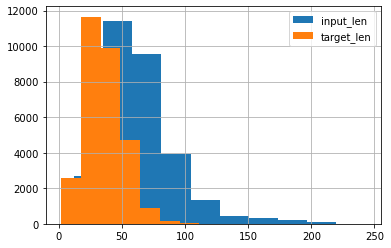

In [24]:
df['input_len'].hist(legend=True)
df['target_len'].hist(legend=True)

In [6]:
from rdkit import Chem
def canonicalize(mol):
    mol = Chem.MolToSmiles(Chem.MolFromSmiles(mol),True)
    return mol
i = 40
canonicalize(df['target'][i]),Chem.CanonSmiles(df['target'][i])

('COC(=O)CC(=O)c1cccnc1Cc1ccccc1', 'COC(=O)CC(=O)c1cccnc1Cc1ccccc1')

In [5]:
row = df.iloc[0]
[row[f'{i}th'] for i in range(5)]

['COc1ccc(S(=O)[O-])cc1',
 'COc1ccc(S(=O)[O-])cc1',
 'COc1ccc(S(=O)[O-])cc1S',
 'COc1ccc(S(=O)[O-])cc1 CS',
 'COc1ccc(S(=O)[O-])cc1[']

In [6]:
def canonicalize2(mol):
    try:
        return canonicalize(mol)
    except:
        return None

In [7]:
top1, top3, top5 = [], [], []
invalidity = []

for idx, row in df.iterrows():
    target = canonicalize(row['target'])
    if canonicalize2(row['0th']) == target:
        top1.append(1)
        top3.append(1)
        top5.append(1)
    elif canonicalize2(row['1th']) == target:
        top1.append(0)
        top3.append(1)
        top5.append(1)
    elif canonicalize2(row['2th']) == target:
        top1.append(0)
        top3.append(1)
        top5.append(1)
    elif canonicalize2(row['3th']) == target:
        top1.append(0)
        top3.append(0)
        top5.append(1)
    elif canonicalize2(row['4th']) == target:
        top1.append(0)
        top3.append(0)
        top5.append(1)
    else:
        top1.append(0)
        top3.append(0)
        top5.append(0)

        
    input_compound = row['input']
#     min_length = min(input_compound.find('CATALYST') - input_compound.find(':') - 10, 0)################# min_length, max_lengthの調節は要注意
#     inp = tokenizer(input_compound, return_tensors='pt').to(device)
#     output = model.generate(**inp, num_beams=CFG.num_beams, num_return_sequences=CFG.num_return_sequences, return_dict_in_generate=True, output_scores=True)
#     output = [tokenizer.decode(i, skip_special_tokens=True).replace('. ', '.').rstrip('.') for i in output['sequences']]
    output = [row[f'{i}th'] for i in range(5)]
    inval_score = 0
    for ith, out in enumerate(output):
        mol = Chem.MolFromSmiles(out.rstrip('.'))
        if type(mol) != rdkit.Chem.rdchem.Mol:
            inval_score += 1
    invalidity.append(inval_score)
# output_df = pd.DataFrame(outputs, columns=['input'] + [f'{i}th' for i in range(CFG.num_beams)] + ['valid compound'] + [f'{i}th score' for i in range(CFG.num_beams)] + ['valid compound score'])
# output_df.to_csv('output.csv', index=False)
df['top1_accuracy'] = top1
df['top3_accuracy'] = top3
df['top5_accuracy'] = top5
df['invalidity'] = invalidity

[11:27:43] SMILES Parse Error: syntax error while parsing: COc1ccc(S(=O)[O-])cc1[
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(S(=O)[O-])cc1[' for input: 'COc1ccc(S(=O)[O-])cc1['
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(N)nc(OCc2ccccn'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(Cl)nc(OCc2ccccn'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(N)nc(Oc2ccccn2'
[11:27:43] SMILES Parse Error: syntax error while parsing: N#Cc1c(OCc2ccccn2)nc(
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'N#Cc1c(OCc2ccccn2)nc(' for input: 'N#Cc1c(OCc2ccccn2)nc('
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(N)nc(Cc2ccccn2'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(N)nc(OCc2ccccn'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(Cl)nc(OCc2ccccn'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'N#Cc1c(N)

[11:27:43] SMILES Parse Error: Failed parsing SMILES 'COC(C)(C)C(=O)COc1ccc(' for input: 'COC(C)(C)C(=O)COc1ccc('
[11:27:43] SMILES Parse Error: syntax error while parsing: COc1cc(Cl)ccc1OCC(=O)C(
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'COc1cc(Cl)ccc1OCC(=O)C(' for input: 'COc1cc(Cl)ccc1OCC(=O)C('
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)cc(Cl)cc1C(=O'
[11:27:43] SMILES Parse Error: syntax error while parsing: Cc1cc(C(=O)CCc2nc(-
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'Cc1cc(C(=O)CCc2nc(-' for input: 'Cc1cc(C(=O)CCc2nc(-'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)CCc2oc(-c'
[11:27:43] SMILES Parse Error: syntax error while parsing: COc1cc(Cl)ccc1-c1nc(CCC(=
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'COc1cc(Cl)ccc1-c1nc(CCC(=' for input: 'COc1cc(Cl)ccc1-c1nc(CCC(='
[11:27:43] SMILES Parse Error: unclosed ring for input: 'Cc1cc(O)ccc1C(=O)CCc1'
[11:27:43] SMILES Parse Error: extra 

[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COc1ncnc2sc(NC(=O)N3CCC(C'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COCCCNC(=O)N1CCC(NC(=O)c2'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COc1ncnc2sc(NC(=O)N3CCC(N'
[11:27:43] SMILES Parse Error: syntax error while parsing: Nc1ncnc2sc(NC(=O)N3CCC(
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'Nc1ncnc2sc(NC(=O)N3CCC(' for input: 'Nc1ncnc2sc(NC(=O)N3CCC('
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COc1ncnc2sc(NC(=O)C3CCN(C'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COc1ncnc2sc(NC(=O)N3CCC(C'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'COCCCNC(=O)N1CCC(NC(=O)c2'
[11:27:43] SMILES Parse Error: extra open parentheses for input: 'O=C(NCc1cc(Br)c2[nH]'
[11:27:43] SMILES Parse Error: syntax error while parsing: Cl.O=C(NCc1cc(Br)c2[
[11:27:43] SMILES Parse Error: Failed parsing SMILES 'Cl.O=C(NCc1cc(Br)c2['

[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1Cn1cc(N2CCCN'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1Cn1cc2c(n'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1Cn1cc(NC2'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1Cn1cc(N=C'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'O=C1NCCCN1c1cnn(Cc2c(C)no'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CNc1nc(Nc2ccc(C(=O)O)c'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CNc1nc(Nc2ccc(CO)cc2OC'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CCNc1nc(Nc2ccc(C(=O)O)c'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CNc1nc(Nc2ccc(C(=O)OC)'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CNc1nc(N(C)c2ccc(C(=O)'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CNc1nc(Nc2ccc(C(=O)O)c'
[11:27:44] 

[11:27:44] SMILES Parse Error: extra open parentheses for input: 'O=C(CCCN1CCC(c2ccc(Cc3ccc(F)'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(CCCN1CCC(c2ccc(Cc3ccc'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'O=C(CCCCN1CCC(c2ccc(Cc3ccc(F'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(Cc2ccc(C3CCN(CCCC(=O'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'O=C(CCN1CCC(c2ccc(Cc3ccc(F)'
[11:27:44] SMILES Parse Error: unclosed ring for input: 'CSc1nc(Cl)c(-c2ccccc2F)c'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CSc1nc(NC2CCCC2)c(-c2ccccc'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CSc1nc2c(c(-c3ccccc3F)c'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CSc1nc(Cl)c(-c2cc(F)ccc'
[11:27:44] SMILES Parse Error: unclosed ring for input: 'CSc1nc(=O)c(-c2ccccc2F)'
[11:27:44] SMILES Parse Error: unclosed ring for input: 'CSc1nc(Cl)c(-c2ccccc2F)

[11:27:44] SMILES Parse Error: extra open parentheses for input: 'COC(CCn1cc(-c2nc(C)oc2'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(c2'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'c1ccc(COCCCc2ccc(C3CCN(Cc4'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'OCCCc1ccc(C2CCN(C(=O)OC(C'
[11:27:44] SMILES Parse Error: syntax error while parsing: CC(C)(CCO)c1ccc(C2CCN(C(
[11:27:44] SMILES Parse Error: Failed parsing SMILES 'CC(C)(CCO)c1ccc(C2CCN(C(' for input: 'CC(C)(CCO)c1ccc(C2CCN(C('
[11:27:44] SMILES Parse Error: syntax error while parsing: c1ccc(COCCCc2ccc(C3CCN(C(=
[11:27:44] SMILES Parse Error: Failed parsing SMILES 'c1ccc(COCCCc2ccc(C3CCN(C(=' for input: 'c1ccc(COCCCc2ccc(C3CCN(C(='
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(c2'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'c1ccc(COCCCc2ccc(C3CCN(Cc4'
[11:27:44] SMILES Parse Error: extra op

[11:27:44] SMILES Parse Error: syntax error while parsing: Cl.CC(=O)c1cn(S(=O)(
[11:27:44] SMILES Parse Error: Failed parsing SMILES 'Cl.CC(=O)c1cn(S(=O)(' for input: 'Cl.CC(=O)c1cn(S(=O)('
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'C=C(C)c1cn(S(=O)(=O'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'C=C(OS(=O)(=O)c1ccccc1'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1c(S(=O)(=O)c'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1cn(S(=O)(=O)'
[11:27:44] SMILES Parse Error: syntax error while parsing: Cl.CC(=O)c1cn(S(=O)(
[11:27:44] SMILES Parse Error: Failed parsing SMILES 'Cl.CC(=O)c1cn(S(=O)(' for input: 'Cl.CC(=O)c1cn(S(=O)('
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'C=C(C)c1cn(S(=O)(=O'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'C=C(OS(=O)(=O)c1ccccc1'
[11:27:44] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1c(S(=O)(=O)c'
[1

[11:27:45] SMILES Parse Error: unclosed ring for input: 'C(=Cc1cccc2[nH]ccc12)c1c'
[11:27:45] SMILES Parse Error: syntax error while parsing: O=Cc1cccc2nc(Cc3cccs3)[n
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'O=Cc1cccc2nc(Cc3cccs3)[n' for input: 'O=Cc1cccc2nc(Cc3cccs3)[n'
[11:27:45] SMILES Parse Error: unclosed ring for input: 'C(=O)c1cccc2c1ccn2Cc1c'
[11:27:45] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)NCCn1ccc'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'CNCCn1ccc2ncnc(Nc3ccc(Oc4cccc'
[11:27:45] SMILES Parse Error: syntax error while parsing: NCCn1ccc2ncnc(Nc3ccc(Oc4cccc(
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'NCCn1ccc2ncnc(Nc3ccc(Oc4cccc(' for input: 'NCCn1ccc2ncnc(Nc3ccc(Oc4cccc('
[11:27:45] SMILES Parse Error: syntax error while parsing: CS(=O)(=O)NCCn1ccc2ncnc(
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'CS(=O)(=O)NCCn1ccc2ncnc(' for input: 'CS(=O)(=O)NCCn1ccc2ncnc('
[11:27:45] SMILES Parse Error: unclos

[11:27:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)C1c2ccccc2-c2c(-c3'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)C(c1ccccc1)c1c(-c2'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC(c1ccccc1)c1c(-c'
[11:27:45] SMILES Parse Error: unclosed ring for input: 'CN(C)C1c2ccccc2-c2[nH]c'
[11:27:45] SMILES Parse Error: syntax error while parsing: CN(C)C1c2ccccc2-c2c1c(-
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'CN(C)C1c2ccccc2-c2c1c(-' for input: 'CN(C)C1c2ccccc2-c2c1c(-'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)C1c2ccccc2-c2c(-c3'
[11:27:45] SMILES Parse Error: unclosed ring for input: 'COC(=O)OC1CC2=CC=C3C4'
[11:27:45] SMILES Parse Error: unclosed ring for input: 'CC(C1OCC(C)(C)CO1)C1'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'C=CC1CCC2C3=CC=C4CC(O'
[11:27:45] SMILES Parse Error: syntax error while parsing: COC(=O)OC1CC(O)C2=CC=
[11:27:45] SMILES Parse Er

[11:27:45] SMILES Parse Error: extra open parentheses for input: 'OC1CN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'O=C1CCN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'C1=CN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: syntax error while parsing: c1ccc(C(c2ccccc2)N2CC(=
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'c1ccc(C(c2ccccc2)N2CC(=' for input: 'c1ccc(C(c2ccccc2)N2CC(='
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'O=C1CN(C(c2ccccc2)c2ccccc'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'OC1CN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'O=C1CCN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'C1=CN(C(c2ccccc2)c2ccccc2'
[11:27:45] SMILES Parse Error: syntax error while parsing: c1ccc(C(c2ccccc2)N2CC(=
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'c1ccc(C(c

[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(O)=O)c(-c2'
[11:27:45] SMILES Parse Error: syntax error while parsing: Nc1nc(-c2cccc(F)c2)c(
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'Nc1nc(-c2cccc(F)c2)c(' for input: 'Nc1nc(-c2cccc(F)c2)c('
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(=O)C2CC3CC'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)c2nc(N'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(=O)N2C(CNC'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(O)=O)c(-c2'
[11:27:45] SMILES Parse Error: syntax error while parsing: Nc1nc(-c2cccc(F)c2)c(
[11:27:45] SMILES Parse Error: Failed parsing SMILES 'Nc1nc(-c2cccc(F)c2)c(' for input: 'Nc1nc(-c2cccc(F)c2)c('
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(=O)C2CC3CC'
[11:27:45] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)c2nc(N'
[11:27:45] S

[11:27:46] SMILES Parse Error: syntax error while parsing: Cl.c1ccc(-c2nc(CN3CCN(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'Cl.c1ccc(-c2nc(CN3CCN(' for input: 'Cl.c1ccc(-c2nc(CN3CCN('
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2noc(CN3CCN(C(c'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CC(=O)NC(C)c1noc2cc(O'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CCN(C(C)=O)C(C)c1noc2c'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CC(=O)NCc1noc2cc(O)ccc1'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CC(=O)NC(C)c1noc2cc(O'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CCN(C(C)=O)C(C)c1noc2c'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CC(=O)NCc1noc2cc(O)ccc1'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'O=Cc1cc(F)c(Br)c(F)c'
[11:27:46] SMILES Parse Error: syntax error while parsing: CCC(c1nn2cccc2c(=O)n1CC(
[11:27:46] SMILES Parse Error: Failed parsing 

[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)C(C)CCC4'
[11:27:46] SMILES Parse Error: syntax error while parsing: COC1CCC2C3CCC4CC(O)CC(C)(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'COC1CCC2C3CCC4CC(O)CC(C)(' for input: 'COC1CCC2C3CCC4CC(O)CC(C)('
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)CC4(C)'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)CC(C)C'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)CCC4(C)C'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)C(C)CCC4'
[11:27:46] SMILES Parse Error: syntax error while parsing: COC1CCC2C3CCC4CC(O)CC(C)(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'COC1CCC2C3CCC4CC(O)CC(C)(' for input: 'COC1CCC2C3CCC4CC(O)CC(C)('
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)CC4(C)'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'COC1CCC2C3CCC4CC(O)CC(C

[11:27:46] SMILES Parse Error: syntax error while parsing: CN(Cc1csc2c1c(=O)c(C(=
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'CN(Cc1csc2c1c(=O)c(C(=' for input: 'CN(Cc1csc2c1c(=O)c(C(='
[11:27:46] SMILES Parse Error: syntax error while parsing: CN(C(=O)c1cc2c(s1)c(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'CN(C(=O)c1cc2c(s1)c(' for input: 'CN(C(=O)c1cc2c(s1)c('
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CN(Cc1cc2c(s1)c(=O)c'
[11:27:46] SMILES Parse Error: syntax error while parsing: CNC(COCc1cc2c(s1)c(=
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'CNC(COCc1cc2c(s1)c(=' for input: 'CNC(COCc1cc2c(s1)c(='
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'Cn1cc(C(=O)NCc2ccc(Cl)'
[11:27:46] SMILES Parse Error: syntax error while parsing: CN(Cc1csc2c1c(=O)c(C(=
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'CN(Cc1csc2c1c(=O)c(C(=' for input: 'CN(Cc1csc2c1c(=O)c(C(='
[11:27:46] SMILES Parse Error: syntax error while 

[11:27:46] SMILES Parse Error: Failed parsing SMILES 'O=Cc1cc(-c2ccccc2)n(S(' for input: 'O=Cc1cc(-c2ccccc2)n(S('
[11:27:46] SMILES Parse Error: unclosed ring for input: 'O=Cc1cc(-c2ccc(Cl)nc2)'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'Cl.O=Cc1cc(-c2ccccc2)n'
[11:27:46] SMILES Parse Error: syntax error while parsing: O=Cc1cc(-c2ccccc2)c(S(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'O=Cc1cc(-c2ccccc2)c(S(' for input: 'O=Cc1cc(-c2ccccc2)c(S('
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(-c2ccccc2)n(S(=O'
[11:27:46] SMILES Parse Error: syntax error while parsing: O=C(NCCN1CCCCC1)c1nc(NCC(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'O=C(NCCN1CCCCC1)c1nc(NCC(' for input: 'O=C(NCCN1CCCCC1)c1nc(NCC('
[11:27:46] SMILES Parse Error: syntax error while parsing: O=C(NCCN1CCOCC1)c1nc(NCC(
[11:27:46] SMILES Parse Error: Failed parsing SMILES 'O=C(NCCN1CCOCC1)c1nc(NCC(' for input: 'O=C(NCCN1CCOCC1)c1nc(NCC('
[11:27:46] SMILES Parse Erro

[11:27:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)CN2CC(C)'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2CC(C)N(C(c3ccc'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(CC(=O)N2CC(C'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)N2CC(C)N'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)CN2C(C)C'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'BrCCCCCCOc1ccc(OCc2ccccc2)cc'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CC(=O)NC1CC(C)N(C(=O'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CC(=O)N(c1ccc(Cl)cc1)C1'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CC1CC(NC(=O)c2ccc(F)cc'
[11:27:46] SMILES Parse Error: unclosed ring for input: 'CC1CC(Nc2ccc(Cl)cc2)c2c'
[11:27:46] SMILES Parse Error: extra open parentheses for input: 'CC1CC(NC(=O)c2ccc(Cl)cc'
[11:27:46] SMILES Parse Erro

[11:27:47] SMILES Parse Error: Failed parsing SMILES 'CCC(O)(c1cn(Cc2ccc3c(-' for input: 'CCC(O)(c1cn(Cc2ccc3c(-'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'OC(c1cn(Cc2ccc3c(-c4ccc'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CCC(O)(c1cn(Cc2ccc3c(C'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC(O)(c1cn(Cc2ccc3c(-c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CCC(O)(c1cn(Cc2ccc3c(O'
[11:27:47] SMILES Parse Error: syntax error while parsing: CCC(O)(c1cn(Cc2ccc3c(-
[11:27:47] SMILES Parse Error: Failed parsing SMILES 'CCC(O)(c1cn(Cc2ccc3c(-' for input: 'CCC(O)(c1cn(Cc2ccc3c(-'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'OC(c1cn(Cc2ccc3c(-c4ccc'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CCC(O)(c1cn(Cc2ccc3c(C'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC(O)(c1cn(Cc2ccc3c(-c'
[11:27:47] SMILES Parse Error: extra open parentheses for 

[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1=Cc2c(c(Br)cc2C(C)'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'COCCn1nc(C)cc1C(=O)Nc1'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'COCCn1nc(C)cc1CNc1cc(O'
[11:27:47] non-ring atom 14 marked aromatic
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'COCCn1nc(C)cc1-c1ccc(Oc2'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'COCCn1nc(C)cc1C(=O)Cc1'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'COCCn1nc(C)cc1C(=O)Nc1'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'COCCn1nc(C)cc1CNc1cc(O'
[11:27:47] non-ring atom 14 marked aromatic
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'COCCn1nc(C)cc1-c1ccc(Oc2'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'COCCn1nc(C)cc1C(=O)Cc1'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'CON=Cc1ccc2c(c1)ncn2-c1cccc'
[11:27:47] SMILES Parse Error: syntax error while

[11:27:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc([N+](=O)[' for input: 'COC(=O)c1cc([N+](=O)['
[11:27:47] SMILES Parse Error: syntax error while parsing: O=C(Nc1ccccc1F)c1cc([N
[11:27:47] SMILES Parse Error: Failed parsing SMILES 'O=C(Nc1ccccc1F)c1cc([N' for input: 'O=C(Nc1ccccc1F)c1cc([N'
[11:27:47] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc([N+](=O)[
[11:27:47] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc([N+](=O)[' for input: 'CCOC(=O)c1cc([N+](=O)['
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc2c(c(F)c1N'
[11:27:47] SMILES Parse Error: syntax error while parsing: NC(=O)c1cc([N+](=O)[
[11:27:47] SMILES Parse Error: Failed parsing SMILES 'NC(=O)c1cc([N+](=O)[' for input: 'NC(=O)c1cc([N+](=O)['
[11:27:47] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc([N+](=O)[
[11:27:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc([N+](=O)[' for input: 'COC(=O)c1cc([N+](=O)['
[11:27:47] SMILES Parse 

[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(N2C(=O)c3ccccc3'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(N)C(=O)N1C(c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NC(c2ccccc2)(c2'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NNC(c2ccccc2)(c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NN(c2ccccc2)C(c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(N2C(=O)c3ccccc3'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(N)C(=O)N1C(c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NC(c2ccccc2)(c2'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NNC(c2ccccc2)(c'
[11:27:47] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CCCC(NN(c2ccccc2)C(c'
[11:27:47] SMILES Parse Error: unclosed ring for input: 'CC(O)c1nn

[11:27:48] Explicit valence for atom # 8 O, 4, is greater than permitted
[11:27:48] Explicit valence for atom # 9 O, 4, is greater than permitted
[11:27:48] Explicit valence for atom # 8 O, 4, is greater than permitted
[11:27:48] Explicit valence for atom # 8 O, 5, is greater than permitted
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'C=C(CC)CO(=O)([O-]'
[11:27:48] Explicit valence for atom # 8 O, 4, is greater than permitted
[11:27:48] Explicit valence for atom # 9 O, 4, is greater than permitted
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#CCCCCN1CCN(c2ccc(Cl)c(Cl)c'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#CCCCN1CCN(c2ccc(Cl)c(Cl)c'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#CCCCCCN1CCN(c2ccc(Cl)c(Cl)'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#CCCCCCN1CCN(c2ccc(Cl)c(Cl)c'
[11:27:48] SMILES Parse Error: syntax error while parsing: Cl.N#CCCCCN1CCN(c2ccc(Cl)c(
[11:2

[11:27:48] SMILES Parse Error: syntax error while parsing: Cc1ccccc1-n1c(CN2CCC(C3(
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'Cc1ccccc1-n1c(CN2CCC(C3(' for input: 'Cc1ccccc1-n1c(CN2CCC(C3('
[11:27:48] SMILES Parse Error: unclosed ring for input: 'Cc1cccc2c1nc(N1CCOCC1)c1nc'
[11:27:48] SMILES Parse Error: unclosed ring for input: 'CC(C)OC(=O)N1CCCC(=O)c2'
[11:27:48] SMILES Parse Error: syntax error while parsing: CC(C)OC(=O)N1CCCCc2ccc3c(
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'CC(C)OC(=O)N1CCCCc2ccc3c(' for input: 'CC(C)OC(=O)N1CCCCc2ccc3c('
[11:27:48] SMILES Parse Error: syntax error while parsing: CC(C)OC(=O)N(CCCCO)c1c(
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'CC(C)OC(=O)N(CCCCO)c1c(' for input: 'CC(C)OC(=O)N(CCCCO)c1c('
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)OC(=O)N1CCCC2(CCc3'
[11:27:48] SMILES Parse Error: unclosed ring for input: 'CC(C)OC(=O)N1CCCC(=O)c2'
[11:27:48] SMILES Parse Error: syntax error while pars

[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(Nc2ccc(O)c(C(=O)'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)c2cc(Cl)ccc'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(NC(=O)c2cc(Cl)ccc'
[11:27:48] SMILES Parse Error: unclosed ring for input: 'COc1cccc(NCc2cc(Cl)ccc2O)c'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(Nc2ccc(Cl)cc2C(=O'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(Nc2ccc(O)c(C(=O)'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)c2cc(Cl)ccc'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(NC2CC3CCC2C3'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(C2CC3CCC2C3)'
[11:27:48] SMILES Parse Error: syntax error while parsing: O=C(Nc1ccc([N+](=O)[O
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'O=C(Nc1ccc([N+](=O)[O' for input: 'O=C

[11:27:48] SMILES Parse Error: Failed parsing SMILES 'CC(=O)OCc1cc(-c2ncc(' for input: 'CC(=O)OCc1cc(-c2ncc('
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CCC(=O)N2CCCc3c'
[11:27:48] SMILES Parse Error: syntax error while parsing: N#Cc1ccc(CCN2CCCc3cc(NC(
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'N#Cc1ccc(CCN2CCCc3cc(NC(' for input: 'N#Cc1ccc(CCN2CCCc3cc(NC('
[11:27:48] SMILES Parse Error: syntax error while parsing: N#Cc1ccc(CCCN2CCCc3cc(NC(
[11:27:48] SMILES Parse Error: Failed parsing SMILES 'N#Cc1ccc(CCCN2CCCc3cc(NC(' for input: 'N#Cc1ccc(CCCN2CCCc3cc(NC('
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CCC(=O)Nc2ccc3c'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CC(=O)N2CCCc3'
[11:27:48] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CCC(=O)N2CCCc3c'
[11:27:48] SMILES Parse Error: syntax error while parsing: N#Cc1ccc(CCN2CCCc3cc(NC(
[11:27:48] SMILES Parse Error: Fa

[11:27:49] SMILES Parse Error: syntax error while parsing: c1ccc(Nc2csc(CC3=Nc4cccc(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'c1ccc(Nc2csc(CC3=Nc4cccc(' for input: 'c1ccc(Nc2csc(CC3=Nc4cccc('
[11:27:49] SMILES Parse Error: syntax error while parsing: Nc1cccc(CC(=O)Nc2nc(-
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'Nc1cccc(CC(=O)Nc2nc(-' for input: 'Nc1cccc(CC(=O)Nc2nc(-'
[11:27:49] SMILES Parse Error: syntax error while parsing: NCCNc1cccc(CC(=O)Nc2nc(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'NCCNc1cccc(CC(=O)Nc2nc(' for input: 'NCCNc1cccc(CC(=O)Nc2nc('
[11:27:49] SMILES Parse Error: syntax error while parsing: NCCNC(=O)Cc1cccc([N+](=
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'NCCNC(=O)Cc1cccc([N+](=' for input: 'NCCNC(=O)Cc1cccc([N+](='
[11:27:49] SMILES Parse Error: syntax error while parsing: Nc1cc(CC(=O)Nc2nc(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'Nc1cc(CC(=O)Nc2nc(' for input: 'Nc1cc(CC(=O)Nc2nc('
[11:27:49] SMILES Pa

[11:27:49] SMILES Parse Error: syntax error while parsing: CN1C(=O)n2c(nn(CCCN3CCN(C(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CN1C(=O)n2c(nn(CCCN3CCN(C(' for input: 'CN1C(=O)n2c(nn(CCCN3CCN(C('
[11:27:49] SMILES Parse Error: syntax error while parsing: CN1C(=O)n2c(n(CCCN3CCN(C(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CN1C(=O)n2c(n(CCCN3CCN(C(' for input: 'CN1C(=O)n2c(n(CCCN3CCN(C('
[11:27:49] SMILES Parse Error: syntax error while parsing: CNC(=O)n1c(=O)n(CCCN2CCN(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CNC(=O)n1c(=O)n(CCCN2CCN(' for input: 'CNC(=O)n1c(=O)n(CCCN2CCN('
[11:27:49] SMILES Parse Error: syntax error while parsing: CNC(=O)n1c2ccccc2n(CCCN2CCN(
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CNC(=O)n1c2ccccc2n(CCCN2CCN(' for input: 'CNC(=O)n1c2ccccc2n(CCCN2CCN('
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CN1C(=O)n2c(nc3ccccc32)'
[11:27:49] SMILES Parse Error: syntax error while parsing: CN1C(=O)n2c(nn(CCCN3CCN(C(


[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CCCCCCCCCCCCCC(=O)OC(CCCCCCCCCCCCCCC)CC(=O'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCCC1CNc2cc(C(=O)O)ccc'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCC1CNc2cc(C(=O)O)ccc2'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCCC1CNc2cc(C(=O)OC)'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCC1CNc2cc(C(=O)O)ccc'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCCC1CNc2cc(C(=O)O)ccc'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCC1CNc2cc(C(=O)O)ccc2'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCCC1CNc2cc(C(=O)OC)'
[11:27:49] SMILES Parse Error: unclosed ring for input: 'CCCCCCCCCCC1CNc2cc(C(=O)O)ccc'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C1CC(=O)N(Cc2c'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'O=C(O)C1CC(=O)N(Cc2'
[11:27:49] S

[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CC(C)c1n[nH]c(C(=O)O'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1n[nH]c(C(C)C'
[11:27:49] SMILES Parse Error: syntax error while parsing: CC(C)c1[nH]nc(CO)c1[
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CC(C)c1[nH]nc(CO)c1[' for input: 'CC(C)c1[nH]nc(CO)c1['
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CC(C)c1[nH]nc(C(=O)O'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CC(C)c1n[nH]c(C(=O)O'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1n[nH]c(C(C)C'
[11:27:49] SMILES Parse Error: syntax error while parsing: CC(C)c1[nH]nc(CO)c1[
[11:27:49] SMILES Parse Error: Failed parsing SMILES 'CC(C)c1[nH]nc(CO)c1[' for input: 'CC(C)c1[nH]nc(CO)c1['
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CCOc1cc(C(=O)N2CCC3(CC2'
[11:27:49] SMILES Parse Error: extra open parentheses for input: 'CCc1cc(C(=O)N2CCC3(CC

[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CN(C)CCOc1n[nH]c2ncnc(' for input: 'CN(C)CCOc1n[nH]c2ncnc('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CNCCOc1nn(CCN(C)C(=O)CO'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CN(CCOc1n[nH]c2ncnc(Nc'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CNCCOc1n[nH]c2ncnc(Nc3'
[11:27:50] SMILES Parse Error: unclosed ring for input: 'CNCCOc1nn(CCNC(=O)CO)c2'
[11:27:50] SMILES Parse Error: syntax error while parsing: CN(C)CCOc1n[nH]c2ncnc(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CN(C)CCOc1n[nH]c2ncnc(' for input: 'CN(C)CCOc1n[nH]c2ncnc('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CNCCOc1nn(CCN(C)C(=O)CO'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(NC(=O)OC(C)(C'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(NC(=O)N(C)CCN(C'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'Cc1c

[11:27:50] SMILES Parse Error: syntax error while parsing: COC(=O)c1ccc(OC)c(-c2ccc(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1ccc(OC)c(-c2ccc(' for input: 'COC(=O)c1ccc(OC)c(-c2ccc('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'COCc1ccc(OC)c(-c2ccc(C(F)'
[11:27:50] SMILES Parse Error: unclosed ring for input: 'COC(=O)Cc1ccc(OC)c2c1CN'
[11:27:50] SMILES Parse Error: syntax error while parsing: COC=Cc1ccc(OC)c(-c2ccc(C(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'COC=Cc1ccc(OC)c(-c2ccc(C(' for input: 'COC=Cc1ccc(OC)c(-c2ccc(C('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Cc1ccc(OC)c(-c2ccc'
[11:27:50] SMILES Parse Error: syntax error while parsing: COC(=O)c1ccc(OC)c(-c2ccc(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1ccc(OC)c(-c2ccc(' for input: 'COC(=O)c1ccc(OC)c(-c2ccc('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'COCc1ccc(OC)c(-c2ccc(C(F)'
[11:27:50] SMILES Parse 

[11:27:50] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(Oc2ccnc(N)n2)c(F'
[11:27:50] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(Oc2cc(N)ncn2)cc'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CNc1ccc(Oc2cc(N)ncn2)c(F'
[11:27:50] SMILES Parse Error: syntax error while parsing: Nc1ccc(Oc2cc(N)ncn2)c(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'Nc1ccc(Oc2cc(N)ncn2)c(' for input: 'Nc1ccc(Oc2cc(N)ncn2)c('
[11:27:50] SMILES Parse Error: unclosed ring for input: 'Nc1cc(Oc2ccc(N)cc2F)'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(Oc2ccnc(N)n2)c(F'
[11:27:50] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(Oc2cc(N)ncn2)cc'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CNc1ccc(Oc2cc(N)ncn2)c(F'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'C#CCNC(=O)N1CC(Oc2ccc(Br'
[11:27:50] SMILES Parse Error: syntax error while parsing: C#CCN(C(=O)N1CC(Oc2ccc(
[11:27:50] SMILES Pars

[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(CCCNCCc2c(CCNS(' for input: 'CCOC(=O)c1ccc(CCCNCCc2c(CCNS('
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(CCCc2c(CCNS(=O'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(CCCN(CCc2cc3c'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(CCCNCCc2cc3cc'
[11:27:50] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(CCCNCCc2c(S(=
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(CCCNCCc2c(S(=' for input: 'CCOC(=O)c1ccc(CCCNCCc2c(S(='
[11:27:50] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(CCCNCCc2c(CCNS(
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(CCCNCCc2c(CCNS(' for input: 'CCOC(=O)c1ccc(CCCNCCc2c(CCNS('
[11:27:50] SMILES Parse Error: syntax error while parsing: CCN1CCN(c2ccc([N+](=O)[O-
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CCN1CCN(c2ccc([N+](

[11:27:50] SMILES Parse Error: syntax error while parsing: CCNC(C)c1nc(-c2ccccc2)c(-
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'CCNC(C)c1nc(-c2ccccc2)c(-' for input: 'CCNC(C)c1nc(-c2ccccc2)c(-'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'C#CCC(NC(=O)Cc1ccc(C(=O'
[11:27:50] SMILES Parse Error: syntax error while parsing: C#CCC(NCC(=O)Cc1ccc(C(=
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'C#CCC(NCC(=O)Cc1ccc(C(=' for input: 'C#CCC(NCC(=O)Cc1ccc(C(='
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'C#CCC(C(=O)NC(CCc1ccc(C'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'C#CCC(NCc1ccc(C(=O)OCC)'
[11:27:50] SMILES Parse Error: extra open parentheses for input: 'C#CCC(NC(=O)Cc1ccc(C(=O'
[11:27:50] SMILES Parse Error: syntax error while parsing: C#CCC(NCC(=O)Cc1ccc(C(=
[11:27:50] SMILES Parse Error: Failed parsing SMILES 'C#CCC(NCC(=O)Cc1ccc(C(=' for input: 'C#CCC(NCC(=O)Cc1ccc(C(='
[11:27:50] SMILES Parse Error: ex

[11:27:51] SMILES Parse Error: Failed parsing SMILES 'C=CCOc1ccc(F)cc1C(C)(' for input: 'C=CCOc1ccc(F)cc1C(C)('
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'C=CCOC(=O)C(O)(CC(C)(C'
[11:27:51] SMILES Parse Error: syntax error while parsing: CC=CCOc1ccc(F)cc1C(C)(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'CC=CCOc1ccc(F)cc1C(C)(' for input: 'CC=CCOc1ccc(F)cc1C(C)('
[11:27:51] SMILES Parse Error: syntax error while parsing: C=CCc1cc(F)ccc1OC(C)(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'C=CCc1cc(F)ccc1OC(C)(' for input: 'C=CCc1cc(F)ccc1OC(C)('
[11:27:51] SMILES Parse Error: syntax error while parsing: C=CCOc1ccc(F)cc1C(C)(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'C=CCOc1ccc(F)cc1C(C)(' for input: 'C=CCOc1ccc(F)cc1C(C)('
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'C=CCOC(=O)C(O)(CC(C)(C'
[11:27:51] SMILES Parse Error: syntax error while parsing: CC=CCOc1ccc(F)cc1C(C)(
[11:27:51] SMILES Parse Error: Failed parsin

[11:27:51] SMILES Parse Error: syntax error while parsing: Cc1cccc(CNCc2cccc(I)c2C(=
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(CNCc2cccc(I)c2C(=' for input: 'Cc1cccc(CNCc2cccc(I)c2C(='
[11:27:51] SMILES Parse Error: unclosed ring for input: 'O=C1c2c(I)cccc2CN1Cc1cccc'
[11:27:51] SMILES Parse Error: syntax error while parsing: Cc1cccc(C2Cc3cccc(I)c3C(=
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(C2Cc3cccc(I)c3C(=' for input: 'Cc1cccc(C2Cc3cccc(I)c3C(='
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(OC'
[11:27:51] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)N1CCC(C(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)N1CCC(C(' for input: 'CC(C)(C)OC(=O)N1CCC(C('
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCOC(OC'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)N1CCC(O)'
[11:27:51] SMILES Parse Error: extra open parent

[11:27:51] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CCCCCCC(=O)OCC(=O'
[11:27:51] non-ring atom 15 marked aromatic
[11:27:51] non-ring atom 17 marked aromatic
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2(C#N)CCC(=O)CC'
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C1CCC(C#N)(c2ccc(O'
[11:27:51] SMILES Parse Error: syntax error while parsing: COC(=O)C1CC(C#N)(c2ccc(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C1CC(C#N)(c2ccc(' for input: 'COC(=O)C1CC(C#N)(c2ccc('
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'C=C1CCC(C#N)(c2ccc(OC)c'
[11:27:51] SMILES Parse Error: syntax error while parsing: COC(=O)C1=C(c2ccc(OC)c(
[11:27:51] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C1=C(c2ccc(OC)c(' for input: 'COC(=O)C1=C(c2ccc(OC)c('
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2(C#N)CCC(=O)CC'
[11:27:51] SMILES Parse Error: extra open parentheses f

[11:27:51] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(Cl)cc1Nc1ccc(Cl'
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(Cl)ccc1Nc1ccc(Cl'
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(Cl)cc1Nc1ccc(Cl'
[11:27:51] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(Cl)ccc1Nc1ccc(Cl'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC1CCCC(C)C1Oc1ccc2c(n1)O'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC(C)C(O)c1ccc2c(n1)OCCN'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC(C)CCCC(C)Oc1ccc2c(n1)O'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC1CCCC(C)C1Nc1ccc2c(n1)O'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC1CCCC(C)C1Oc1ccc2c(n1)N'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC1CCCC(C)C1Oc1ccc2c(n1)O'
[11:27:51] SMILES Parse Error: unclosed ring for input: 'CC(C)C(O)c1ccc2c(n1)OCCN'
[11:27:51] SMILES Parse Error: unclosed ring f

[11:27:52] SMILES Parse Error: Failed parsing SMILES 'CCN(C)C(=O)c1cc(F)cc(' for input: 'CCN(C)C(=O)c1cc(F)cc('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(NC2CCC3(CCNCC3)CC'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(NC2CCC3(CC2)CCNCC'
[11:27:52] SMILES Parse Error: syntax error while parsing: Clc1ccc(NC2CCC3(CC[NH2+
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc(NC2CCC3(CC[NH2+' for input: 'Clc1ccc(NC2CCC3(CC[NH2+'
[11:27:52] SMILES Parse Error: syntax error while parsing: Clc1ccc(NC2CCC3(CCC(Nc4ccc(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc(NC2CCC3(CCC(Nc4ccc(' for input: 'Clc1ccc(NC2CCC3(CCC(Nc4ccc('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCC'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(NC2CCC3(CCNCC3)CC'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(NC2CCC3(CC2)CCNCC'
[11:27:52] SMI

[11:27:52] SMILES Parse Error: syntax error while parsing: CCOc1ccc(NCc2cncc(Br)c2)c([
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'CCOc1ccc(NCc2cncc(Br)c2)c([' for input: 'CCOc1ccc(NCc2cncc(Br)c2)c(['
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(NC(=O)c2cncc(Br)c2'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(Nc2cncc(C(=O)O)c2'
[11:27:52] SMILES Parse Error: syntax error while parsing: CCOc1ccc(Nc2cncc(Br)c2)c([N
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'CCOc1ccc(Nc2cncc(Br)c2)c([N' for input: 'CCOc1ccc(Nc2cncc(Br)c2)c([N'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NC(=O)c2cncc(Br)c2'
[11:27:52] SMILES Parse Error: syntax error while parsing: CCOc1ccc(NCc2cncc(Br)c2)c([
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'CCOc1ccc(NCc2cncc(Br)c2)c([' for input: 'CCOc1ccc(NCc2cncc(Br)c2)c(['
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(-c2nc3cc(F

[11:27:52] SMILES Parse Error: syntax error while parsing: N#CCCn1nccc1-c1ccc(Oc2ccc(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'N#CCCn1nccc1-c1ccc(Oc2ccc(' for input: 'N#CCCn1nccc1-c1ccc(Oc2ccc('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1ccnn1-c1ccc(Oc2ccc'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(=O)CCn1ncc(-c2ccc(O'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(O)CCn1nccc1-c1ccc(Oc2'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(=O)CCn1nccc1-c1ccc(Oc'
[11:27:52] SMILES Parse Error: syntax error while parsing: N#CCCn1nccc1-c1ccc(Oc2ccc(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'N#CCCn1nccc1-c1ccc(Oc2ccc(' for input: 'N#CCCn1nccc1-c1ccc(Oc2ccc('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1ccnn1-c1ccc(Oc2ccc'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'NC(=O)CCn1ncc(-c2ccc(O'
[11:27:52] SMILES Parse Error: e

[11:27:52] SMILES Parse Error: unclosed ring for input: 'O=C(NCCCl)NCCOc1cccc2ncnc'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2cccc3ncnc(Nc4ccc(OCc'
[11:27:52] SMILES Parse Error: unclosed ring for input: 'CN1CCN(C(=O)NCCCl)c2cccc3ncn'
[11:27:52] SMILES Parse Error: syntax error while parsing: COc1ccc(NC(C)=O)c(OCC(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(NC(C)=O)c(OCC(' for input: 'COc1ccc(NC(C)=O)c(OCC('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N)c(OCC(O)CN2CCC'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N)c(OCC(Br)CN2CCC'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N)c(OCC(CN2CCC(n'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'COc1cc(NC(C)=O)c(OCC'
[11:27:52] SMILES Parse Error: syntax error while parsing: COc1ccc(NC(C)=O)c(OCC(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(NC(C)=O)c(OCC(' for input: 

[11:27:52] SMILES Parse Error: extra open parentheses for input: 'c1ccc(CN2CC3CCC(NCC(C4'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'C(=C1CCC2CN(Cc3ccccc3)CC'
[11:27:52] SMILES Parse Error: syntax error while parsing: O=C(NC1CCC2CN(C(=O)C(
[11:27:52] SMILES Parse Error: Failed parsing SMILES 'O=C(NC1CCC2CN(C(=O)C(' for input: 'O=C(NC1CCC2CN(C(=O)C('
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(NC(=O)C(=O)c2'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N(C(=O)C(=O)c'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N=C(C(=O)O)c2'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N(C)C(=O)C(=O'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1nn(C)c(NC(=O)C(=O'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(NC(=O)C(=O)c2'
[11:27:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N(C(=O)C(=O)c'
[11:27:52] SMIL

[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CC(Br)c1ccc(Br)c(S(C)(=O'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)Cc1ccc(Br)c(S'
[11:27:53] SMILES Parse Error: syntax error while parsing: CC1(C)C(C=C(Br)Br)C1C(
[11:27:53] SMILES Parse Error: Failed parsing SMILES 'CC1(C)C(C=C(Br)Br)C1C(' for input: 'CC1(C)C(C=C(Br)Br)C1C('
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CC1(C)C(C#CCBr)C1C(=O'
[11:27:53] SMILES Parse Error: syntax error while parsing: CC1(C)C(C=C(Br)Br)C1C(
[11:27:53] SMILES Parse Error: Failed parsing SMILES 'CC1(C)C(C=C(Br)Br)C1C(' for input: 'CC1(C)C(C=C(Br)Br)C1C('
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CC1(C)C(C#CCBr)C1C(=O'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CNC(=O)Oc1cc(C)c(Sc2'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1c(C)cc(O)cc'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CNC(=O)c1cc(C)

[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C1Cc2cc(NC(=O)c3ccs'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C1Cc2cc(-c3ccc4cc(N'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C1Cc2cc(-c3ccc4c(c3'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc2cc(-c3ccc4c(c3)'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1ccsc1-c1ccc2cc(N'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C1Cc2cc(NC(=O)c3ccs'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'Cc1nc2c(N)cc(Br)cc2o'
[11:27:53] SMILES Parse Error: syntax error while parsing: CC(=O)Cc1c([N+](=O)[
[11:27:53] SMILES Parse Error: Failed parsing SMILES 'CC(=O)Cc1c([N+](=O)[' for input: 'CC(=O)Cc1c([N+](=O)['
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C1Cc2c(ccc(OCc3ccccc3)'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(OCc2ccccc2)c(F)c'
[11:27:53] SMILES P

[11:27:53] SMILES Parse Error: extra open parentheses for input: 'OCC=Cc1ccc(C(=C2CCSCC2)'
[11:27:53] SMILES Parse Error: syntax error while parsing: O=C([O-])C=Cc1ccc(C(=
[11:27:53] SMILES Parse Error: Failed parsing SMILES 'O=C([O-])C=Cc1ccc(C(=' for input: 'O=C([O-])C=Cc1ccc(C(='
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C=Cc1ccc(C(=C2CC'
[11:27:53] SMILES Parse Error: extra open parentheses for input: 'O=C(C=Cc1ccc(C(=C2CCSCC'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CNC(=S)NCCNCc1ncoc1Cc1c'
[11:27:53] non-ring atom 15 marked aromatic
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CNC1=NCCN1Cc1ncoc1Cc1ccccc'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CN1CCNC1=NCCNCc1ncoc1Cc1c'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CN1CCN=C1NCCNCc1ncoc1Cc1c'
[11:27:53] SMILES Parse Error: unclosed ring for input: 'CNC(=S)NCCNCc1ncoc1Cc1c'
[11:27:53] non-ring atom 15 marked aromatic
[11:27:53] SMILES Parse Error:

[11:27:54] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ncc3c(Oc4cccc(
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ncc3c(Oc4cccc(' for input: 'COc1ccc(Cn2ncc3c(Oc4cccc('
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(Cn2ncc3c(N4CCNCC'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(Cn2ncc3c4c(cnc'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCN(c2'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOC(=O)N1N=C(c2ccc'
[11:27:54] SMILES Parse Error: syntax error while parsing: CCN(CC)CCOC(=O)N1N=C(
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'CCN(CC)CCOC(=O)N1N=C(' for input: 'CCN(CC)CCOC(=O)N1N=C('
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOCC(=O)N1N=C(c2ccc'
[11:27:54] SMILES Parse Error: unclosed ring for input: 'CCN(CC)CCOC(=O)N1C(=O)SC'
[11:27:54] SMILES Parse Error: extra open parentheses for 

[11:27:54] SMILES Parse Error: Failed parsing SMILES 'N#CCOc1cc(O)cc2cc(' for input: 'N#CCOc1cc(O)cc2cc('
[11:27:54] SMILES Parse Error: syntax error while parsing: N#CCc1cc(F)cc2cc(-
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'N#CCc1cc(F)cc2cc(-' for input: 'N#CCc1cc(F)cc2cc(-'
[11:27:54] SMILES Parse Error: syntax error while parsing: Cc1cc(O)cc2cc(-c3ccc(
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'Cc1cc(O)cc2cc(-c3ccc(' for input: 'Cc1cc(O)cc2cc(-c3ccc('
[11:27:54] SMILES Parse Error: syntax error while parsing: N#CCc1cc(O)cc2cc(-
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'N#CCc1cc(O)cc2cc(-' for input: 'N#CCc1cc(O)cc2cc(-'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(O)cc2cc(-c'
[11:27:54] SMILES Parse Error: syntax error while parsing: N#CCOc1cc(O)cc2cc(
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'N#CCOc1cc(O)cc2cc(' for input: 'N#CCOc1cc(O)cc2cc('
[11:27:54] SMILES Parse Error: syntax error while parsing: N#CC

[11:27:54] SMILES Parse Error: extra open parentheses for input: 'Clc1nc(N2CCOCC2)c2sc(CN3'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'OC(c1nccs1)N1CCC(O)(c2c'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'OC1(c2cc3nc(Cl)nc(N4'
[11:27:54] SMILES Parse Error: syntax error while parsing: Clc1nc(N2CCOCC2)c2sc(C3(
[11:27:54] SMILES Parse Error: Failed parsing SMILES 'Clc1nc(N2CCOCC2)c2sc(C3(' for input: 'Clc1nc(N2CCOCC2)c2sc(C3('
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(O)(c2cc3nc(Cl)nc'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'Clc1nc(N2CCOCC2)c2sc(CN3'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'OC(c1nccs1)N1CCC(O)(c2c'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'Cn1cc(CC2CCC3CN(c4ncccn4'
[11:27:54] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(CC2CCC3CN(c4ncccn4'
[11:27:54] SMILES Parse Error: syntax error while parsing: CN1CCN(c2

[11:27:55] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)NCCCOCCOC(
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)NCCCOCCOC(' for input: 'CC(C)(C)OC(=O)NCCCOCCOC('
[11:27:55] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)NCCOCCONC(
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)NCCOCCONC(' for input: 'CC(C)(C)OC(=O)NCCOCCONC('
[11:27:55] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)NCCOCCOCCOC(=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)NCCOCCOCCOC(=' for input: 'CC(C)(C)OC(=O)NCCOCCOCCOC(='
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(-c2cc(C(F)F)n3'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(-c2cc(C(F)F)c3'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(-c2cc(C(F)F)nc'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(-c2cc(C(F)F)n3'
[11:27:55] SMILES 

[11:27:55] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(CNc1c(F)cc(F'
[11:27:55] SMILES Parse Error: syntax error while parsing: Nc1c(F)cc(F)c(CC(=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'Nc1c(F)cc(F)c(CC(=' for input: 'Nc1c(F)cc(F)c(CC(='
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'O=C(CNc1c(F)cc(F)cc'
[11:27:55] SMILES Parse Error: unclosed ring for input: 'O=C(CCl)Nc1c(F)cc(F)'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(CNc1c(F)cc(F'
[11:27:55] SMILES Parse Error: syntax error while parsing: Nc1c(F)cc(F)c(CC(=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'Nc1c(F)cc(F)c(CC(=' for input: 'Nc1c(F)cc(F)c(CC(='
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(C2=Nc3ccccc3Sc3sc4c'
[11:27:55] SMILES Parse Error: unclosed ring for input: 'CN1CCNCC1=C1Nc2ccccc2Sc2sc'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CN1CCNC(=C2Nc3ccccc3Sc3sc4'
[11:27:55] SMILES P

[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCN=C(N)Nc1nc(-c2cccc(C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCNC(=Nc1nc(-c2cccc(CNC'
[11:27:55] SMILES Parse Error: syntax error while parsing: CCCCNc1nc(-c2cccc(CNC(C)=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'CCCCNc1nc(-c2cccc(CNC(C)=' for input: 'CCCCNc1nc(-c2cccc(CNC(C)='
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCNC(N)=Nc1nc(-c2cccc(C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCNC(=N)Nc1nc(-c2cccc(C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCN=C(N)Nc1nc(-c2cccc(C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CCCCNC(=Nc1nc(-c2cccc(CNC'
[11:27:55] SMILES Parse Error: syntax error while parsing: CCCCNc1nc(-c2cccc(CNC(C)=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'CCCCNc1nc(-c2cccc(CNC(C)=' for input: 'CCCCNc1nc(-c2cccc(CNC(C)='
[11:27:55] SMILES Parse Error: e

[11:27:55] SMILES Parse Error: unclosed ring for input: 'CCCN(CC)C(=O)c1cc(Cl)cc'
[11:27:55] SMILES Parse Error: unclosed ring for input: 'CN(CCC)C(=O)c1cc(Cl)ccn'
[11:27:55] SMILES Parse Error: unclosed ring for input: 'CCCN(CCC)c1cc(C(=O)O)ccn'
[11:27:55] SMILES Parse Error: syntax error while parsing: Cc1cc2c(cc1-c1cc(C=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'Cc1cc2c(cc1-c1cc(C=' for input: 'Cc1cc2c(cc1-c1cc(C='
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc2c(cc1-c1cc(CC'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(OC(F)(F)F)c(-c'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc2c(c(-c3cc(C=C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C)c2c(cc1-c1cc'
[11:27:55] SMILES Parse Error: syntax error while parsing: Cc1cc2c(cc1-c1cc(C=
[11:27:55] SMILES Parse Error: Failed parsing SMILES 'Cc1cc2c(cc1-c1cc(C=' for input: 'Cc1cc2c(cc1-c1cc(C='
[11:27:55] SMILES Parse Erro

[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC(C(=O)OC'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC2C(c3ccccc3'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC(c2ccccc2OC'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1SCC(C(=O)OC(C'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC2C(NC(=O'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC(C(=O)OC'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C1CSC2C(c3ccccc3'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CC(Nc1nc(-n2cnc3ccccc32'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CC(Nc1nc(C)cc(-n2cnc'
[11:27:55] SMILES Parse Error: extra open parentheses for input: 'CC(Nc1nc(Oc2cc(-n3cn'
[11:27:55] SMILES Parse Error: syntax error while parsing: CC(Nc1nc(Cc2ccccc2)cc(-
[1

[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)c1cc(CCC2=NC(C'
[11:27:56] SMILES Parse Error: syntax error while parsing: CC(C)(O)CCc1cc(C(C)(
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)CCc1cc(C(C)(' for input: 'CC(C)(O)CCc1cc(C(C)('
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccn(CC(O)CO)'
[11:27:56] SMILES Parse Error: syntax error while parsing: O=C(OCC(O)CO)N1CCN(C(
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'O=C(OCC(O)CO)N1CCN(C(' for input: 'O=C(OCC(O)CO)N1CCN(C('
[11:27:56] SMILES Parse Error: syntax error while parsing: O=C(OC(CO)CO)N1CCN(C(
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'O=C(OC(CO)CO)N1CCN(C(' for input: 'O=C(OC(CO)CO)N1CCN(C('
[11:27:56] SMILES Parse Error: unclosed ring for input: 'O=C(OCC(O)CO)Nc1ccn'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'C=C(CO)OC(CO)Cn1ccc(N'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccn(CC(

[11:27:56] SMILES Parse Error: Failed parsing SMILES 'Nc1ccc2c(c1)NC(C(F)(' for input: 'Nc1ccc2c(c1)NC(C(F)('
[11:27:56] SMILES Parse Error: syntax error while parsing: Nc1ccc2c(c1)NC(O)C2(
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'Nc1ccc2c(c1)NC(O)C2(' for input: 'Nc1ccc2c(c1)NC(O)C2('
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(-c2cnn(CC(F)(F)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'Cn1cc(-c2cnn(CC(F)(F)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(-c2cn(CC(F)(F'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(-c2c(C(F)(F)F'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCn1cc(-c2cnn(CC(F)(F'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(-c2cnn(CC(F)(F)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'Cn1cc(-c2cnn(CC(F)(F)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCn1cc(-c2

[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCc1nn(C)c2c(N)nc(Cc'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCNc1ccc(Cc2nc3c(C(C)=O'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCc1nn(C)c2c(O)nc(Cc'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCNc1ccc(Cc2nc3c(C(=O)O'
[11:27:56] SMILES Parse Error: unclosed ring for input: 'CCCc1nn(C)c2c(=O)[nH]'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCc1nn(C)c2c(N)nc(Cc'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCNc1ccc(Cc2nc3c(C(C)=O'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCc1nn(C)c2c(O)nc(Cc'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCCNc1ccc(Cc2nc3c(C(=O)O'
[11:27:56] SMILES Parse Error: syntax error while parsing: COc1ccc2c(COc3cccc4[nH]c(
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(COc3cccc4[nH]c(' for input: 'COc1ccc2c(COc3cccc

[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCNc1ccc(CC(C(=O)NS(=O)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)C(Cc1ccc([N+](=O'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCN1C(=O)C(Cc2ccc(N)cc2'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)C(=O)C(Cc1ccc(N)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCNc1ccc(CC(C(=O)NS(=O)'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)C(Cc1ccc([N+](=O'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'CCN1C(=O)C(Cc2ccc(N)cc2'
[11:27:56] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1ccc(NCCNc'
[11:27:56] SMILES Parse Error: syntax error while parsing: FC(F)(F)c1ccc(NCCNc2ccc(-
[11:27:56] SMILES Parse Error: Failed parsing SMILES 'FC(F)(F)c1ccc(NCCNc2ccc(-' for input: 'FC(F)(F)c1ccc(NCCNc2ccc(-'
[11:27:56] SMILES Parse Error: unclosed ring for input: 'NCCNc1cc

[11:27:57] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(=O)Nc1ccc(F)'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(O)=Nc1ccc(F)'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(=O)c1ccc(F)c'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(Cl)=Nc1ccc(F)'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'Cc1cc(Oc2ccccc2)cc(C)c'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'Cc1cc(O)cc(C)c1Oc1c'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'COc1c(C)cccc1Oc1ccccc1.Cc1'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=CN(C)C)C(=O'
[11:27:57] non-ring atom 9 marked aromatic
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C(C=O)C(=O)c1ccc'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(=O)C(=CN(C)C'
[11:27:57] SMILES Parse Error: syntax error while parsing: CCOC(=O)C(C=NN(C)C)C(=
[11:27:57] SMILES Parse Error: Failed parsi

[11:27:57] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1ccc(-c2cnc(Nc3'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(-c2cnc(Nc3ccc'
[11:27:57] SMILES Parse Error: syntax error while parsing: COc1ccc(Nc2ncc(-c3ccc(C(
[11:27:57] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Nc2ncc(-c3ccc(C(' for input: 'COc1ccc(Nc2ncc(-c3ccc(C('
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'C=Cc1cnc(Nc2ccc(N3CCN(C'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ccc(Nc3ncc(-c4ccc'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1ccc(-c2cnc(Nc3'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(-c2cnc(Nc3ccc'
[11:27:57] SMILES Parse Error: syntax error while parsing: COc1ccc(Nc2ncc(-c3ccc(C(
[11:27:57] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Nc2ncc(-c3ccc(C(' for input: 'COc1ccc(Nc2ncc(-c3ccc(C('
[11:27:57] SMILES Parse Error: extra open parenthes

[11:27:57] SMILES Parse Error: Failed parsing SMILES 'CCNC(=O)Nc1cc(-c2nc(CCC(' for input: 'CCNC(=O)Nc1cc(-c2nc(CCC('
[11:27:57] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)Nc1ccc(-
[11:27:57] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)Nc1ccc(-' for input: 'CC(C)(C)OC(=O)Nc1ccc(-'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)c1ccc(-c'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N(Cc1ccc'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N(Cc1c'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)OC(=O)Nc1ccc(-c2c'
[11:27:57] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)Nc1ccc(-
[11:27:57] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)Nc1ccc(-' for input: 'CC(C)(C)OC(=O)Nc1ccc(-'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)c1ccc(-c'
[11:27:57] SMILES Parse Error: extra open 

[11:27:57] SMILES Parse Error: unclosed ring for input: 'CN1C(=S)c2[nH]cnc2N2'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'CN1C(=O)c2c(ncn2Cc2ccccc2'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CN1C(=S)c2ncn(Cc3ccccc3)c'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'CN1C(=O)c2[nH]cnc2N2'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'Clc1ccccc1CNCCCOc1cccc(-c2noc'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'c1ccc(CNCCCOc2cccc(-c3noc4ccs'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(CNCCCOc2cccc(-c3noc4'
[11:27:57] SMILES Parse Error: unclosed ring for input: 'NCCCOc1cccc(-c2noc3ccsc23)c'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'c1cc(CNCCCOc2cccc(-c3noc4'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'Clc1ccccc1CNCCCOc1cccc(-c2noc'
[11:27:57] SMILES Parse Error: extra open parentheses for input: 'c1ccc(CNCCCOc2cccc(-c3noc4ccs'
[

[11:27:58] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1nc[nH]n1)c1ccc'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'Nc1ncnn1C(=O)c1ccc2ccccc2'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1nnc[nH]1)c1ccc2c'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Nc1ncn(C(=O)c2ccc3ccccc3c'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'c1ccc2cc(CNc3nc[nH]n'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1nc[nH]n1)c1ccc'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'Nc1ncnn1C(=O)c1ccc2ccccc2'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1nnc[nH]1)c1ccc2c'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Nc1ncn(C(=O)c2ccc3ccccc3c'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'c1ccc2cc(CNc3nc[nH]n'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1sc(-c2c(Br)sc(C'
[11:27:58] SMILES Parse Error: extra open parentheses 

[11:27:58] SMILES Parse Error: unclosed ring for input: 'CC1Cc2c([nH]c3ccccc23)C'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC1(C2)Oc2ccccc2'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC(O)(C2)Oc1c'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC(C1)Oc1ccccc1-n1cccc'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC(O)(C2)Oc2c'
[11:27:58] SMILES Parse Error: syntax error while parsing: c1ccc2c(c1)OC1(CC3CCC(
[11:27:58] SMILES Parse Error: Failed parsing SMILES 'c1ccc2c(c1)OC1(CC3CCC(' for input: 'c1ccc2c(c1)OC1(CC3CCC('
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC1(C2)Oc2ccccc2'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC(O)(C2)Oc1c'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC(C1)Oc1ccccc1-n1cccc'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'NC1C2CCC1CC(O)(C2)Oc2c'
[11:27:58] SMILES Parse Error: syntax error while parsin

[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(Cl)c1C=C(Cn1cncn'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(Cl)c1C=C(OCc1c'
[11:27:58] non-ring atom 15 marked aromatic
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(Cl)c1C(=Cn1cncn1'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(Cl)c1C=C(Cn1cncn'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'Clc1cccc(Cl)c1C=C(OCc1c'
[11:27:58] non-ring atom 15 marked aromatic
[11:27:58] SMILES Parse Error: unclosed ring for input: 'CC1CCCN1CCCOc1ccc(C2CCC(O)CC2)'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'CC(O)CCCNc1ccc(C2CCC(O)CC2)'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'COC1CCC(c2ccc(OCCCN3CCCC3C)cc2)'
[11:27:58] SMILES Parse Error: unclosed ring for input: 'OC1CCC(c2ccc(OCCCN3CCCC3)cc2)'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(c2ccc(OCCCN3CCCC3C)cc2'
[

[11:27:58] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1ccc(F)cc1)NC1CCC'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)C12CCC(F'
[11:27:58] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)C1(C(=
[11:27:58] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)C1(C(=' for input: 'CC(C)(C)OC(=O)C1(C(='
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)C1(C(F'
[11:27:58] SMILES Parse Error: syntax error while parsing: O=C(OCc1ccccc1)N1CC2C(
[11:27:58] SMILES Parse Error: Failed parsing SMILES 'O=C(OCc1ccccc1)N1CC2C(' for input: 'O=C(OCc1ccccc1)N1CC2C('
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)C12CCC(C'
[11:27:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)C12CCC(F'
[11:27:58] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)C1(C(=
[11:27:58] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)C1(C(=' for input: 'CC(C)(

[11:27:59] SMILES Parse Error: unclosed ring for input: 'CNc1cc(C(=O)O)c(Br)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'Cc1cc(Br)c(C(=O)O)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1cc(Br)c(C)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CNc1cc(C(=O)O)c(Br)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'Cc1cc(Br)c(C(=O)O)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1cc(Br)c(C)cc'
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1ccc(=O)n(C2CCCCC2'
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])c1ccc(=O)n(C'
[11:27:59] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccc((=O)n(C2CCCCC
[11:27:59] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccc((=O)n(C2CCCCC' for input: 'O=C(O)c1ccc((=O)n(C2CCCCC'
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'O=C(NO)c1ccc(=O)n(C2CCCCC'
[11:27:59] SMILES Parse Error: extra open 

[11:27:59] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccc(-c2cnc3c(' for input: 'O=C(O)c1ccc(-c2cnc3c('
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(c1ccc(-c2cnc3c'
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'C=CCn1c(C)c(S(C)(=O'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'Cc1c(S(C)(=O)=O)c2ccnc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CC(=O)c1c(C)n(CCO)c2'
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1c(C)n(CCC(C)(O'
[11:27:59] SMILES Parse Error: syntax error while parsing: CC(=O)c1c(C)n(CCCO)c2c(
[11:27:59] SMILES Parse Error: Failed parsing SMILES 'CC(=O)c1c(C)n(CCCO)c2c(' for input: 'CC(=O)c1c(C)n(CCCO)c2c('
[11:27:59] SMILES Parse Error: extra open parentheses for input: 'C=CCn1c(C)c(S(C)(=O'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'Cc1c(S(C)(=O)=O)c2ccnc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CC(=O)c1c(C)n(CCO)c2'
[11:27:59] SMILE

[11:27:59] SMILES Parse Error: unclosed ring for input: 'COc1c([N+](=O)[O-])c'
[11:27:59] SMILES Parse Error: syntax error while parsing: COc1c(Cl)cc(CO)cc1[N+
[11:27:59] SMILES Parse Error: Failed parsing SMILES 'COc1c(Cl)cc(CO)cc1[N+' for input: 'COc1c(Cl)cc(CO)cc1[N+'
[11:27:59] SMILES Parse Error: syntax error while parsing: COc1cc(Cl)c(CO)cc1[N+
[11:27:59] SMILES Parse Error: Failed parsing SMILES 'COc1cc(Cl)c(CO)cc1[N+' for input: 'COc1cc(Cl)c(CO)cc1[N+'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'COc1c([N+](=O)[O-])c'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CCCOc1ccc(C(=O)CCC(=O)O)cc'
[11:27:59] SMILES Parse Error: unclosed ring for input: 'CCCc1cccc(C(=O)CCC(=O)O)c'
[11:27:59] SMILES Parse Error: syntax error while parsing: COc1c(C#N)cc2ccccc2c1C(
[11:27:59] SMILES Parse Error: Failed parsing SMILES 'COc1c(C#N)cc2ccccc2c1C(' for input: 'COc1c(C#N)cc2ccccc2c1C('
[11:27:59] SMILES Parse Error: unclosed ring for input: 'COc1c(C#N)cc2ccccc2c1C1'
[11:27

[11:28:00] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1ccc(C=C'
[11:28:00] SMILES Parse Error: syntax error while parsing: N=C(N)NS(=O)(=O)C=
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'N=C(N)NS(=O)(=O)C=' for input: 'N=C(N)NS(=O)(=O)C='
[11:28:00] SMILES Parse Error: syntax error while parsing: N=C(NS(=O)(=O)c1ccc(
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'N=C(NS(=O)(=O)c1ccc(' for input: 'N=C(NS(=O)(=O)c1ccc('
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)Oc1ncc(-c2nc(-c'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)Oc1cnc(-c2nc(-c'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)Oc1ncc(-c2noc(-c'
[11:28:00] SMILES Parse Error: unclosed ring for input: 'Cn1cc(CCC(=O)O)c2ccc(F)'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)Oc1ncc(-c2nc(C3'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)Oc1ncc(-c2nc(-c'
[11:28:00] SMI

[11:28:00] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CCc1ccc(OCCSCCOc2'
[11:28:00] SMILES Parse Error: syntax error while parsing: O=C(O)CCc1ccc(OCCSCCOC(
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'O=C(O)CCc1ccc(OCCSCCOC(' for input: 'O=C(O)CCc1ccc(OCCSCCOC('
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])CCc1ccc(OCCSCC'
[11:28:00] SMILES Parse Error: syntax error while parsing: O=C(O)CCc1ccc(OCCSCCSC(
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'O=C(O)CCc1ccc(OCCSCCSC(' for input: 'O=C(O)CCc1ccc(OCCSCCSC('
[11:28:00] SMILES Parse Error: unclosed ring for input: 'O=C(O)CCc1ccc(OCCSCCO)c'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CCc1ccc(OCCSCCOc2'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(O)CC(C)(C)NC(C)(C'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC1CC(C)(C)OC(C)(C#N'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CC(O)

[11:28:00] SMILES Parse Error: extra open parentheses for input: 'OCC=C(c1ccccc1)C(=C(CC'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'O=CCC(=C(c1ccc(F)cc1)c1'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'OCCC(=C(c1ccc(F)cc1)c1ccc'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'OCC=C(c1ccccc1)c1ccc(OCCOCc'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C=Cc2cccc3c2C(=Cc'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'C=Cc1cccc2c1C(=Cc1[nH]'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(CCc2cccc3c2C(=Cc2'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(CC=Cc2cccc3c2C(=C'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C=Cc2cccc3c2NC(=O'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C=Cc2cccc3c2C(=Cc'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'C=Cc1cccc2

[11:28:00] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1-c1c(NS(=O)(=' for input: 'COc1ccccc1-c1c(NS(=O)(='
[11:28:00] SMILES Parse Error: syntax error while parsing: COc1ccccc1Oc1c(NS(=O)(=
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1Oc1c(NS(=O)(=' for input: 'COc1ccccc1Oc1c(NS(=O)(='
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)NCCOc'
[11:28:00] SMILES Parse Error: extra open parentheses for input: 'CSc1nc(NS(=O)(=O)c2ccc'
[11:28:00] SMILES Parse Error: syntax error while parsing: CSc1nc(SC)nc(NS(=O)(
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'CSc1nc(SC)nc(NS(=O)(' for input: 'CSc1nc(SC)nc(NS(=O)('
[11:28:00] SMILES Parse Error: syntax error while parsing: COc1ccccc1-c1c(NS(=O)(=
[11:28:00] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1-c1c(NS(=O)(=' for input: 'COc1ccccc1-c1c(NS(=O)(='
[11:28:00] SMILES Parse Error: syntax error while parsing: CN1CCN(c2ccc([N+](=O)[O-
[11:28:00] SMILES Parse Error: Fa

[11:28:01] SMILES Parse Error: syntax error while parsing: O=C(O)Cn1c(=O)sc2cc(
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)Cn1c(=O)sc2cc(' for input: 'O=C(O)Cn1c(=O)sc2cc('
[11:28:01] SMILES Parse Error: syntax error while parsing: O=C(O)Cn1c(=O)oc2cc(
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)Cn1c(=O)oc2cc(' for input: 'O=C(O)Cn1c(=O)oc2cc('
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Cn1c(=O)oc2cc(S'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C(=O)O)c1ccc(SCc'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=C1Cn2c(=O)oc3cc(SC'
[11:28:01] SMILES Parse Error: syntax error while parsing: O=C(O)Cn1c(=O)sc2cc(
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)Cn1c(=O)sc2cc(' for input: 'O=C(O)Cn1c(=O)sc2cc('
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'CC1OC(=C2C(=O)Nc3ccccc3'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'CC1Oc2ccccc2C1

[11:28:01] SMILES Parse Error: syntax error while parsing: Oc1cc(-c2ccccc2)cc(C(=
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'Oc1cc(-c2ccccc2)cc(C(=' for input: 'Oc1cc(-c2ccccc2)cc(C(='
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])c1ccnc(-c2ccccc2'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])c1cc(-c2ccccc'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'OC([O-])c1ccnc(-c2ccccc2)'
[11:28:01] SMILES Parse Error: syntax error while parsing: Oc1cc(-c2ccccc2)cc(C(=
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'Oc1cc(-c2ccccc2)cc(C(=' for input: 'Oc1cc(-c2ccccc2)cc(C(='
[11:28:01] SMILES Parse Error: syntax error while parsing: COc1ccnc(CS(=O)c2nc3cc(
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'COc1ccnc(CS(=O)c2nc3cc(' for input: 'COc1ccnc(CS(=O)c2nc3cc('
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'COc1ccnc(CS(=O)c2[nH]c3'
[11:28:01] SMILES Parse Error: syntax error while p

[11:28:01] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)CCNc1cccc(-c2nc'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)CCc1nccc(-c2'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'C=CCN(c1ccccc1)[S](C)(C'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'C=CCNc1ccc([SH](C)C)cc'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'C=CCNc1ccc([S](C)(C)Cl)'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'C=CCN(c1ccccc1)[S](C)(C'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'C=CCNc1ccc([SH](C)C)cc'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'C=CCNc1ccc([S](C)(C)Cl)'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)Nc2cc'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=c1[nH]c2cccc(C(O)c3n'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=c1oc2cccc(C(O)c3ncc(Cl'
[11:28:01] SMILES Parse Error: extra o

[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=C1NS(=O)(=O)C(c2n'
[11:28:01] SMILES Parse Error: syntax error while parsing: O=C(O)C(=O)NS(=O)(=
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)C(=O)NS(=O)(=' for input: 'O=C(O)C(=O)NS(=O)(='
[11:28:01] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C1=NS(=O)(=O)C'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'O=C1C(=O)NS(=O)(=O)'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=O)NS(=O)(=O'
[11:28:01] SMILES Parse Error: extra open parentheses for input: 'O=C1NS(=O)(=O)C(c2n'
[11:28:01] SMILES Parse Error: syntax error while parsing: O=C(O)C(=O)NS(=O)(=
[11:28:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)C(=O)NS(=O)(=' for input: 'O=C(O)C(=O)NS(=O)(='
[11:28:01] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C1=NS(=O)(=O)C'
[11:28:01] SMILES Parse Error: unclosed ring for input: 'O=C1C(=O)NS(=O)(=O)'
[11:28:01] SMILES Parse Error: syntax error 

[11:28:02] SMILES Parse Error: Failed parsing SMILES 'O=C(NC(Cc1ccccc1)C(NC(' for input: 'O=C(NC(Cc1ccccc1)C(NC('
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'CCC1C(NC(=O)OC(C)(C)'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'CCC1NC(=O)C(NC(=O)OC'
[11:28:02] SMILES Parse Error: syntax error while parsing: CCC1N(OC)C(=O)C1NC(=
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'CCC1N(OC)C(=O)C1NC(=' for input: 'CCC1N(OC)C(=O)C1NC(='
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'CCC1C(NC(=O)OC(C)(C)'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'CCC1NC(=O)C(NC(=O)OC'
[11:28:02] SMILES Parse Error: syntax error while parsing: CCC1N(OC)C(=O)C1NC(=
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'CCC1N(OC)C(=O)C1NC(=' for input: 'CCC1N(OC)C(=O)C1NC(='
[11:28:02] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)N1CCC(C#
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)N1CC

[11:28:02] SMILES Parse Error: Failed parsing SMILES 'O=C1NC(=O)CC1c1c[nH' for input: 'O=C1NC(=O)CC1c1c[nH'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C1CC(c2c[nH]c3ccccc2'
[11:28:02] SMILES Parse Error: syntax error while parsing: O=C1NCC(c2c[nH]c3ccc(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'O=C1NCC(c2c[nH]c3ccc(' for input: 'O=C1NCC(c2c[nH]c3ccc('
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C1NC(=O)C(c2c[nH]'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C1CC(c2c[nH]c3ccc(O'
[11:28:02] SMILES Parse Error: syntax error while parsing: O=C1NC(=O)CC1c1c[nH
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'O=C1NC(=O)CC1c1c[nH' for input: 'O=C1NC(=O)CC1c1c[nH'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C1CC(c2c[nH]c3ccccc2'
[11:28:02] SMILES Parse Error: syntax error while parsing: O=C1NCC(c2c[nH]c3ccc(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'O=C1NCC(c2c[nH]c3ccc(

[11:28:02] SMILES Parse Error: syntax error while parsing: COCCN1CCC(c2ccc(C(O)=NC3(C(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'COCCN1CCC(c2ccc(C(O)=NC3(C(' for input: 'COCCN1CCC(c2ccc(C(O)=NC3(C('
[11:28:02] SMILES Parse Error: syntax error while parsing: COCCN1CCC(c2ccc(C(=O)NC3(C(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'COCCN1CCC(c2ccc(C(=O)NC3(C(' for input: 'COCCN1CCC(c2ccc(C(=O)NC3(C('
[11:28:02] SMILES Parse Error: syntax error while parsing: COCCN1CCC(c2ccc(C(=O)C3(NC(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'COCCN1CCC(c2ccc(C(=O)C3(NC(' for input: 'COCCN1CCC(c2ccc(C(=O)C3(NC('
[11:28:02] SMILES Parse Error: syntax error while parsing: COCC[N+]1(CC(=O)NC2(C(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'COCC[N+]1(CC(=O)NC2(C(' for input: 'COCC[N+]1(CC(=O)NC2(C('
[11:28:02] SMILES Parse Error: syntax error while parsing: COCCN1CCC(c2ccc(C(=O)OC3(C(
[11:28:02] SMILES Parse Error: Failed parsing SMILES 'COCCN1CCC(c2ccc(C(=O)OC3(C(' f

[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(C)CC2OCC(O)C'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NCC2OC(CO)C(O)'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(C)CC2OC(CO)C'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(C)CC(O)C(O)C'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(C)CC2OCC(O)C'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NCC2OC(CO)C(O)'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc2cc(Oc3nc'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc2cc(Oc3ccc4'
[11:28:02] SMILES Parse Error: extra open parentheses for input: 'O=C(c1cc2cc(Oc3nc4c'
[11:28:02] SMILES Parse Error: unclosed ring for input: 'O=C(Nc1nc2ccccc2s1)c1c'
[11:28:02] SMILES Parse Error: syntax error while parsing: O=C(c1cc2cc(O)ccc2[nH
[11:28:02] SMILES Parse Error: Fail

[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCc1c(C(=O)c2cccs2)[nH' for input: 'CCc1c(C(=O)c2cccs2)[nH'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCc1c(-c2cccs2)[nH]c(C'
[11:28:03] SMILES Parse Error: syntax error while parsing: CCc1c(C(=O)OC)[nH]c(
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCc1c(C(=O)OC)[nH]c(' for input: 'CCc1c(C(=O)OC)[nH]c('
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C=O)[nH]c(-c2c'
[11:28:03] SMILES Parse Error: syntax error while parsing: CCc1c(C)c(-c2cccs2)[nH
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCc1c(C)c(-c2cccs2)[nH' for input: 'CCc1c(C)c(-c2cccs2)[nH'
[11:28:03] SMILES Parse Error: syntax error while parsing: CCc1c(C(=O)c2cccs2)[nH
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCc1c(C(=O)c2cccs2)[nH' for input: 'CCc1c(C(=O)c2cccs2)[nH'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCc1c(OCc2ccc(C(=O)Nc'
[11:28:03] SMILES Parse Error: extra

[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1c(C)c(Cc2ccc(OCc3cccn'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(OCc2cccnc2)ccc'
[11:28:03] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc(Cc2c(C)c(
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(Cc2c(C)c(' for input: 'CCOC(=O)c1cc(Cc2c(C)c('
[11:28:03] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(Cc2c(C)c(
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc(Cc2c(C)c(' for input: 'COC(=O)c1cc(Cc2c(C)c('
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(Cc2c(OC)c'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1c(C)c(Cc2ccc(OCc3cccn'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(OCc2cccnc2)ccc'
[11:28:03] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc(Cc2c(C)c(
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(Cc2c(C)c(' for in

[11:28:03] SMILES Parse Error: unclosed ring for input: 'CON(C)C(=O)c1cc2c(Cl)'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'CN(OC)C(=O)c1cc2c(Cl)'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(=O)Cl)cc2'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(=O)O)cc2'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(O)=S)cc2'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(=O)Cl)cc2'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(=O)O)cc2'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'CCCOCC1CCC(c2ccc(C(O)=S)cc2'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C1(C(C)=O)CC=CCC'
[11:28:03] SMILES Parse Error: syntax error while parsing: CN(CCN(C)C(=O)N1CCOCC1)C(=
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'CN(CCN(C)C(=O)N1CCOCC1)C(=' for input: 'CN(CC

[11:28:03] SMILES Parse Error: syntax error while parsing: Cc1ccnc(C(O)c2ccc([N+](=
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'Cc1ccnc(C(O)c2ccc([N+](=' for input: 'Cc1ccnc(C(O)c2ccc([N+](='
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1c(C(O)c2cc(C)ccn'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'COc1ccccc1C(O)c1cc(C)cc'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1cc(C(O)c2cc(C)cc'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'COc1cc([N+](=O)[O-])'
[11:28:03] SMILES Parse Error: syntax error while parsing: Cc1ccnc(C(O)c2ccc([N+](=
[11:28:03] SMILES Parse Error: Failed parsing SMILES 'Cc1ccnc(C(O)c2ccc([N+](=' for input: 'Cc1ccnc(C(O)c2ccc([N+](='
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1c(C(O)c2cc(C)ccn'
[11:28:03] SMILES Parse Error: unclosed ring for input: 'COc1ccccc1C(O)c1cc(C)cc'
[11:28:03] SMILES Parse Error: extra open parentheses for input: 'COc1cc(C(O)c2cc(C)cc'
[

[11:28:04] SMILES Parse Error: unclosed ring for input: 'N#Cc1ccc(OC)cc1-c1nc'
[11:28:04] SMILES Parse Error: syntax error while parsing: C#Cc1ccc(OC)cc1-c1nc(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'C#Cc1ccc(OC)cc1-c1nc(' for input: 'C#Cc1ccc(OC)cc1-c1nc('
[11:28:04] SMILES Parse Error: syntax error while parsing: N#Cc1ccc(O)cc1-c1nc(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'N#Cc1ccc(O)cc1-c1nc(' for input: 'N#Cc1ccc(O)cc1-c1nc('
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N)c(-c2nc(-c3cccc'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccccc1Nc1cc(-c2c'
[11:28:04] SMILES Parse Error: unclosed ring for input: 'CNc1ccccc1Nc1cc(-c2ccccc2)'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1cccc2c1Nc1cc(-c3'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccccc1Nc1cc(-c2ccc'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccccc1Nc1cc(

[11:28:04] SMILES Parse Error: syntax error while parsing: CNc1ncc2c(n1)c(=O)n(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CNc1ncc2c(n1)c(=O)n(' for input: 'CNc1ncc2c(n1)c(=O)n('
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CC(N)c1ncc2c(=O)n(-c'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'COc1ncc2c(=O)n(-c3cc'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CNc1ncc2c(=O)n(-c3cc'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(NC(=O)c2cccc(C(F)'
[11:28:04] SMILES Parse Error: syntax error while parsing: CNc1ncc2c(n1)c(=O)n(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CNc1ncc2c(n1)c(=O)n(' for input: 'CNc1ncc2c(n1)c(=O)n('
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CC(N)c1ncc2c(=O)n(-c'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'COc1ncc2c(=O)n(-c3cc'
[11:28:04] SMILES Parse Error: syntax error while parsing: COc1cc(N2CCOCC2)ccc1Nc1nccc(


[11:28:04] SMILES Parse Error: extra open parentheses for input: 'O=C(c1ccccc1)C(=C1C(=O'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc2c(c1)C(=C(Nc1'
[11:28:04] SMILES Parse Error: syntax error while parsing: O=C1Nc2ccc([N+](=O)[O
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'O=C1Nc2ccc([N+](=O)[O' for input: 'O=C1Nc2ccc([N+](=O)[O'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'C1=C(c2ccccc2)C(=C(Nc2'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'O=C(c1ccccc1)C(=C1C(=O'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc2c(c1)C(=C(Nc1'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)CN(Cc1ccccc1)C(=O'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)CN(CC(=O)N(Cc1'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)CN(Cc1ccccc1)C(=O'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)CN(CC(=O)N(

[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)[SH2]OC(C)(' for input: 'CC(C)(C)[SH2]OC(C)('
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CC1(C)C(C(=O)c2c[nH]'
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CC1(C)C(C(=O)c2cc3cc'
[11:28:04] SMILES Parse Error: syntax error while parsing: CC1(C)C(C(=O)c2c([S
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CC1(C)C(C(=O)c2c([S' for input: 'CC1(C)C(C(=O)c2c([S'
[11:28:04] SMILES Parse Error: syntax error while parsing: CC1(C)C(Cc2c[nH]c3ccc(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CC1(C)C(Cc2c[nH]c3ccc(' for input: 'CC1(C)C(Cc2c[nH]c3ccc('
[11:28:04] SMILES Parse Error: syntax error while parsing: CC(C)(C)[SH2]OC(C)(
[11:28:04] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)[SH2]OC(C)(' for input: 'CC(C)(C)[SH2]OC(C)('
[11:28:04] SMILES Parse Error: extra open parentheses for input: 'CC1(C)C(C(=O)c2c[nH]'
[11:28:04] SMILES Parse Error: extra open parentheses for 

[11:28:05] SMILES Parse Error: Failed parsing SMILES 'COc1cccc2c1c(Cl)c1c(O)c(' for input: 'COc1cccc2c1c(Cl)c1c(O)c('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COc1cccc2c3c(c(Cl)c(O)c1'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COc1cccc2c(Cl)c3c(c(O)c1'
[11:28:05] SMILES Parse Error: syntax error while parsing: COc1cccc2c3c(c(Cl)c12)C(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'COc1cccc2c3c(c(Cl)c12)C(' for input: 'COc1cccc2c3c(c(Cl)c12)C('
[11:28:05] SMILES Parse Error: unclosed ring for input: 'COc1cccc2c1c(Cl)c1c(c2O)'
[11:28:05] SMILES Parse Error: syntax error while parsing: COc1cccc2c1c(Cl)c1c(O)c(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'COc1cccc2c1c(Cl)c1c(O)c(' for input: 'COc1cccc2c1c(Cl)c1c(O)c('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COc1cccc2c3c(c(Cl)c(O)c1'
[11:28:05] SMILES Parse Error: unclosed ring for input: 'Clc1ccc(Oc2ccc(F)cc2)cc'
[11:28:05] SMILES Parse Error: unclos

[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(O)(C(C)c'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(-c2ccc(C(C)C'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(Oc2ccc(C(C)C'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(-c2ccc(C(C)C'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(Nc2ccc(C(C)C'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(O)(C(C)c'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CON(C)C(=O)Nc1ccc(OCc2'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'O=C=Nc1ccc(OCc2ccc(F)cc'
[11:28:05] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(OCc2ccc(F)cc2)c'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CSN(C)C(=O)Nc1ccc(OCc2'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'Cl.CON(C)C(=O)Nc1ccc(O'
[11

[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(O)c1sc(-c2cc(Cl)c(C'
[11:28:05] SMILES Parse Error: syntax error while parsing: CC(O)c1cnc(-c2[nH]c(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'CC(O)c1cnc(-c2[nH]c(' for input: 'CC(O)c1cnc(-c2[nH]c('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(O)c1sc(-c2ncc(Cl)s2'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1cnc(-c2cc(Cl)'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(O)c1cnc(-c2cc(Cl)c'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(O)c1sc(-c2cc(Cl)c(C'
[11:28:05] SMILES Parse Error: syntax error while parsing: CC(O)c1cnc(-c2[nH]c(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'CC(O)c1cnc(-c2[nH]c(' for input: 'CC(O)c1cnc(-c2[nH]c('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(O)c1sc(-c2ncc(Cl)s2'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1cnc(-c2c

[11:28:05] SMILES Parse Error: syntax error while parsing: CCN(CC)CCOc1ccc(NS(=O)(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'CCN(CC)CCOc1ccc(NS(=O)(' for input: 'CCN(CC)CCOc1ccc(NS(=O)('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc(N2C(=O)'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc(Oc2ncc3'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc2nc(Nc3ccc'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc(Nc2ncc3'
[11:28:05] SMILES Parse Error: syntax error while parsing: CCN(CC)CCOc1ccc(NS(=O)(
[11:28:05] SMILES Parse Error: Failed parsing SMILES 'CCN(CC)CCOc1ccc(NS(=O)(' for input: 'CCN(CC)CCOc1ccc(NS(=O)('
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc(N2C(=O)'
[11:28:05] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)CCOc1ccc(Oc2ncc3'
[11:28:05] SMILES Parse Error: extra open parentheses 

[11:28:06] SMILES Parse Error: syntax error while parsing: O=C(NCC1CN(c2ccc(F)c(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'O=C(NCC1CN(c2ccc(F)c(' for input: 'O=C(NCC1CN(c2ccc(F)c('
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC1CN(c2ccc(N3CCCCC3'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC1CN(c2ccc(N3CCOCC3'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'O=C1OC(CNC(=O)c2ccc(Cl'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(NCC1CN(c2ccc(N'
[11:28:06] SMILES Parse Error: syntax error while parsing: O=C(NCC1CN(c2ccc(F)c(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'O=C(NCC1CN(c2ccc(F)c(' for input: 'O=C(NCC1CN(c2ccc(F)c('
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC1CN(c2ccc(N3CCCCC3'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(-c2cncc(F)c2CO'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 

[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)S(=O)(=O)c1cc(C'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)C(=O)c1cc(NC(=O'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)C(=O)c1cc(C(=O)'
[11:28:06] SMILES Parse Error: syntax error while parsing: CCCN(CCC)C(=O)c1cc(CNCC(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CCCN(CCC)C(=O)c1cc(CNCC(' for input: 'CCCN(CCC)C(=O)c1cc(CNCC('
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)C(=O)c1cc(-c2nccn2'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)S(=O)(=O)c1cc(C'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCCN(CCC)C(=O)c1cc(NC(=O'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(C(=O)NCc1c(F)cc(C'
[11:28:06] SMILES Parse Error: syntax error while parsing: CCOC(C(=O)NCc1c(F)cc(-
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(C(=O)NCc1c(F

[11:28:06] SMILES Parse Error: extra open parentheses for input: 'O=C(CSc1cc(Cl)cc(Cl)c'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'Clc1cc(Cl)cc(SC2=NCCN2'
[11:28:06] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccc2c(c1)nc(-
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccc2c(c1)nc(-' for input: 'O=C(O)c1ccc2c(c1)nc(-'
[11:28:06] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccc2c(c1)[nH+
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccc2c(c1)[nH+' for input: 'O=C(O)c1ccc2c(c1)[nH+'
[11:28:06] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1ccc2c(c1)[nH]'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc2c(c1)nc(-c'
[11:28:06] SMILES Parse Error: syntax error while parsing: Clc1ccc(-c2ccc3cc(-c4cccc(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc(-c2ccc3cc(-c4cccc(' for input: 'Clc1ccc(-c2ccc3cc(-c4cccc('
[11:28:06] SMILES Parse Error: syntax error while parsin

[11:28:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(-c2ccc(C(=O)OCc'
[11:28:06] SMILES Parse Error: unclosed ring for input: 'Cc1cc(-c2ccc(CO)cc2)c'
[11:28:06] SMILES Parse Error: syntax error while parsing: COC(=O)c1ccc(-c2cc(C)c(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1ccc(-c2cc(C)c(' for input: 'COC(=O)c1ccc(-c2cc(C)c('
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CC(NCCOc1c(C)cc(-c2ccc'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CC1=C(C=CC#Cc2ccc(C(=O'
[11:28:06] SMILES Parse Error: syntax error while parsing: CC1=C(CC=CC#Cc2ccc(C(=
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CC1=C(CC=CC#Cc2ccc(C(=' for input: 'CC1=C(CC=CC#Cc2ccc(C(='
[11:28:06] SMILES Parse Error: unclosed ring for input: 'C[S](C)(C)CCOC(=O)c1ccc'
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CC1=C(CC#Cc2ccc(C(=O)O'
[11:28:06] SMILES Parse Error: syntax error while parsing: CC1(C)CCCC(=CC#Cc2ccc(C(=

[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)N1CCc2[nH]c3c(' for input: 'CCOC(=O)N1CCc2[nH]c3c('
[11:28:06] SMILES Parse Error: syntax error while parsing: CCOC(=O)N1CCc2[nH]c3cccc(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)N1CCc2[nH]c3cccc(' for input: 'CCOC(=O)N1CCc2[nH]c3cccc('
[11:28:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)N1CCc2c([nH]c3'
[11:28:06] SMILES Parse Error: syntax error while parsing: CN1CCc2[nH]c3c([N+](
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CN1CCc2[nH]c3c([N+](' for input: 'CN1CCc2[nH]c3c([N+]('
[11:28:06] SMILES Parse Error: syntax error while parsing: CC(=O)N1CCc2[nH]c3c(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CC(=O)N1CCc2[nH]c3c(' for input: 'CC(=O)N1CCc2[nH]c3c('
[11:28:06] SMILES Parse Error: syntax error while parsing: CCOC(=O)N1CCc2[nH]c3c(
[11:28:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)N1CCc2[nH]c3c(' for input: 'CCOC(=O)N1CCc2[nH]c3c('
[11:28:06] SMIL

[11:28:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)Cc1cc([SH](=O)'
[11:28:07] SMILES Parse Error: extra close parentheses while parsing: CCOC(=O)Cc1ccS)n2ncnc2n1
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)Cc1ccS)n2ncnc2n1' for input: 'CCOC(=O)Cc1ccS)n2ncnc2n1'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Cc1cc([SH])n2ncn'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Cc1cc(S)n2ncnc2n'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Cc1cc(=S)n2ncnc2'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)Cc1cc([SH](=O)'
[11:28:07] SMILES Parse Error: extra close parentheses while parsing: CCOC(=O)Cc1ccS)n2ncnc2n1
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)Cc1ccS)n2ncnc2n1' for input: 'CCOC(=O)Cc1ccS)n2ncnc2n1'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Cc1cc([SH])n2ncn'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCOC(

[11:28:07] SMILES Parse Error: Failed parsing SMILES 'COCOC1CC2=CC=C3C4CCC(C(' for input: 'COCOC1CC2=CC=C3C4CCC(C('
[11:28:07] SMILES Parse Error: unclosed ring for input: 'C=C(C)C1CCC2C3=CC=C4C'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'C=CC1CCC2C3=CC=C4CC(O'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'C=C(C)C(=O)OC1CC2=C'
[11:28:07] SMILES Parse Error: syntax error while parsing: CC(C(=O)O)C1CCC2C3=CC=
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'CC(C(=O)O)C1CCC2C3=CC=' for input: 'CC(C(=O)O)C1CCC2C3=CC='
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CC(=O)N(CC#CC1=CCCCC1)c1'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CC(=O)N(C)c1ccccc1C#CC1'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)Oc2ccccc'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'CC(C)Nc1ccc(C(=O)O)c(F'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CC(C)c1ccc(C(=O)O)c(F)'
[11:28:07] SM

[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCCCS(=O)(=O)C1CC(=O)N'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'CCCCS(=O)C1c2ccccc2CC(=O)'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-c1nc(C(=O)NC'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-c1nc2c(c(=O)'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1cc(-c2nc(C(=O)NC'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'COc1ccccc1-c1nc(C(=O)O)'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-c1nc2c(O)c(C'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-c1nc(C(=O)NC'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-c1nc2c(c(=O)'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'COc1cc(-c2nc(C(=O)NC'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'COc1ccccc1-c1nc(C(=O)O)'
[11:28:07] SMILES Parse Error: extra ope

[11:28:07] SMILES Parse Error: unclosed ring for input: 'Cc1nn(-c2ccc(Br)nn2)c(C)'
[11:28:07] SMILES Parse Error: syntax error while parsing: BrCc1nn(-c2ccc(Cl)nn2)c(
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'BrCc1nn(-c2ccc(Cl)nn2)c(' for input: 'BrCc1nn(-c2ccc(Cl)nn2)c('
[11:28:07] SMILES Parse Error: unclosed ring for input: 'Cc1nn(-c2ccc(Cl)nn2)c(C)'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'Cc1nn(-c2ccc(Cl)nn2)c(CBr'
[11:28:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CBr)n(-c2ccc(Cl)nn'
[11:28:07] SMILES Parse Error: unclosed ring for input: 'Cc1nn(-c2ccc(Br)nn2)c(C)'
[11:28:07] SMILES Parse Error: syntax error while parsing: BrCc1nn(-c2ccc(Cl)nn2)c(
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'BrCc1nn(-c2ccc(Cl)nn2)c(' for input: 'BrCc1nn(-c2ccc(Cl)nn2)c('
[11:28:07] SMILES Parse Error: syntax error while parsing: NC(=O)C1(c2ccccc2)CCN(C(=
[11:28:07] SMILES Parse Error: Failed parsing SMILES 'NC(=O)C1(c2ccccc2)CCN(C

[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CC#N)cccc1Oc1cccc(Cl)'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CCC#N)cccc1Oc1cccc(Cl)c'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'COc1c(OCc2cccc(Oc3cccc(Cl)c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CCCC#N)cccc1Oc1cccc(Cl)c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(OCc2cccc(Cl)c2OC)cccc'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CC#N)cccc1Oc1cccc(Cl)'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CCC#N)cccc1Oc1cccc(Cl)c'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'COc1c(OCc2cccc(Oc3cccc(Cl)c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(CCCC#N)cccc1Oc1cccc(Cl)c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'COc1c(OCc2cccc(Cl)c2OC)cccc'
[11:28:08] SMILES Parse Error: syntax error while parsing: CCNC(=O)Nc1cc(-c2nc(C(
[11:28:08] SMILES Parse Error:

[11:28:08] SMILES Parse Error: Failed parsing SMILES 'O=C1c2c(OCc3ccccc3)cccc2-' for input: 'O=C1c2c(OCc3ccccc3)cccc2-'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'Cl.O=C1c2c(OCc3ccccc3)'
[11:28:08] SMILES Parse Error: syntax error while parsing: O=C1c2c(O)cccc2-c2nn(CCN(
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'O=C1c2c(O)cccc2-c2nn(CCN(' for input: 'O=C1c2c(O)cccc2-c2nn(CCN('
[11:28:08] SMILES Parse Error: syntax error while parsing: O=C(c1c(OCc2ccccc2)cccc1-
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'O=C(c1c(OCc2ccccc2)cccc1-' for input: 'O=C(c1c(OCc2ccccc2)cccc1-'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc2c3c(n(CCN(CCO)C'
[11:28:08] SMILES Parse Error: syntax error while parsing: O=C1c2c(OCc3ccccc3)cccc2-
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'O=C1c2c(OCc3ccccc3)cccc2-' for input: 'O=C1c2c(OCc3ccccc3)cccc2-'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'Cl.O=C1c2c(OCc3ccccc3)'
[11:28:08] S

[11:28:08] SMILES Parse Error: syntax error while parsing: CCC(C)(C)c1ncc(CCCO)[nH
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'CCC(C)(C)c1ncc(CCCO)[nH' for input: 'CCC(C)(C)c1ncc(CCCO)[nH'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)CCCOCCCc1c[nH]cn'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCCc1c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCc1c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCCCc1'
[11:28:08] non-ring atom 13 marked aromatic
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C1CCCCc2c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCCc1c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCc1c'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C=CCCCCCc1'
[11:28:08] non-ring atom 13 marked aromatic
[11:28:08] SMILES Parse Error: unclosed ring for inp

[11:28:08] SMILES Parse Error: Failed parsing SMILES 'OC(Cc1ccc(Cl)cc1)c1c[n' for input: 'OC(Cc1ccc(Cl)cc1)c1c[n'
[11:28:08] SMILES Parse Error: unclosed ring for input: 'O=Cc1cn(Cc2ccc(Cl)cc2)'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc(Cn2cc(C=O)c3c'
[11:28:08] SMILES Parse Error: syntax error while parsing: O=Cc1c(Cc2ccc(Cl)cc2)[
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'O=Cc1c(Cc2ccc(Cl)cc2)[' for input: 'O=Cc1c(Cc2ccc(Cl)cc2)['
[11:28:08] SMILES Parse Error: unclosed ring for input: 'OCc1cn(Cc2ccc(Cl)cc2)c'
[11:28:08] SMILES Parse Error: syntax error while parsing: OC(Cc1ccc(Cl)cc1)c1c[n
[11:28:08] SMILES Parse Error: Failed parsing SMILES 'OC(Cc1ccc(Cl)cc1)c1c[n' for input: 'OC(Cc1ccc(Cl)cc1)c1c[n'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(COc2ccc3c(N4CCCC4)c'
[11:28:08] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(COc2ccc3c(C)cc(N'
[11:28:08] SMILES Parse Error: extra open parentheses 

[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN(CCN(C)c1ccncc1)c1ccc(N)c'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN(CCN(C)c1ccccc1)c1ccc(N)c'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN1CCN(c2ccc(N)cc2)c2ccncc2'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CN(CC[NH+](C)c1ccc(N)c'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN(CCN(C)c1ccc(N)cc1)c1ccnc'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN(CCN(C)c1ccncc1)c1ccc(N)c'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN(CCN(C)c1ccccc1)c1ccc(N)c'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CN1CCN(c2ccc(N)cc2)c2ccncc2'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CN(CC[NH+](C)c1ccc(N)c'
[11:28:09] SMILES Parse Error: syntax error while parsing: COC(=O)C(CCCCCCCCCCCCCCCC(=O)O)C(
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(CCCCCCCCCCCCCCCC(=O)O)C(' for input: 'COC(=O)C(CCCCCCCCCCCCCCC

[11:28:09] SMILES Parse Error: unclosed ring for input: 'CC1(C)CNCC[C@]1(O)c1'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CC1(C)CNCC(O)(c2ccc(Cl)'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CS(=O)(=O)Nc1ccc(CO)cc'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'O=Cc1ccc(NS(C)(=O)=O)'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'OCc1ccc(NS(C)(=O)=O)c'
[11:28:09] SMILES Parse Error: syntax error while parsing: CCc1ccc(NS(C)(=O)=O)c(
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CCc1ccc(NS(C)(=O)=O)c(' for input: 'CCc1ccc(NS(C)(=O)=O)c('
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CCS(=O)(=O)Nc1ccc(CO)cc'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CS(=O)(=O)Nc1ccc(CO)cc'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'O=Cc1ccc(NS(C)(=O)=O)'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'OCc1ccc(NS(C)(=O)=O)c'
[11:28:09] SMILES Parse Error: syntax error while parsing: CCc1ccc(NS(

[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CC(O[S](C)(C)C)C1C(' for input: 'CC(O[S](C)(C)C)C1C('
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CC(O[S](C)(C)C)C(=O'
[11:28:09] SMILES Parse Error: syntax error while parsing: CC(C)O[S](C)(C)OC(=
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CC(C)O[S](C)(C)OC(=' for input: 'CC(C)O[S](C)(C)OC(='
[11:28:09] SMILES Parse Error: syntax error while parsing: CC(O)C1C(=O)N2C1C(C(
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CC(O)C1C(=O)N2C1C(C(' for input: 'CC(O)C1C(=O)N2C1C(C('
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CC(O)C1C(=O)N2C(C(=O'
[11:28:09] SMILES Parse Error: syntax error while parsing: CC(O[S](C)(C)C)C1C(
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CC(O[S](C)(C)C)C1C(' for input: 'CC(O[S](C)(C)C)C1C('
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CC(O[S](C)(C)C)C(=O'
[11:28:09] SMILES Parse Error: syntax error while parsing: CC(C)O[

[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CCCCCOC(=O)Nc1nc2c(cn1C'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CCCCCOC(=O)Nc1nc(=O)c2c'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CCCCCOC(=O)Nc1nc(=O)n(C'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CCCCCOC(=O)Nc1nc(=O)c(C'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CCCCCOC(=O)Nc1nc2c(cn1)'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CCCCCOC(=O)Nc1nc2c(cn1C'
[11:28:09] SMILES Parse Error: unclosed ring for input: 'CCCCCOC(=O)Nc1nc(=O)c2c'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)c1nc2cc(S(=O'
[11:28:09] SMILES Parse Error: syntax error while parsing: CC(C)(C)c1nc2cc(NS(=
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)c1nc2cc(NS(=' for input: 'CC(C)(C)c1nc2cc(NS(='
[11:28:09] SMILES Parse Error: syntax error while parsing: O=C(O)CC1CN(S(=O)(=
[11:28:09] SMILES Parse Error: Fa

[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C(Cc1ccccc1)NC(=O'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C(Cc1cn(C(=O)C'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C(Cc1ccccc1)NC(=O'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(Cc2cn(C(=O'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(=O)NC(c2'
[11:28:09] SMILES Parse Error: syntax error while parsing: COC(=O)c1ccc(C(=O)c2cn(
[11:28:09] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1ccc(C(=O)c2cn(' for input: 'COC(=O)c1ccc(C(=O)c2cn('
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc2c(c1)c(Cc1'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(Cc2cn(C(=O'
[11:28:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(=O)NC(c2'
[11:28:09] SMILES Parse Error: syntax error while parsing: COC(=O)c1ccc(C

[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(NCc2c(Cl)ccc3'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCCCC1)c1ccc(NCc2'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(C(=O)NC2CCCCCC'
[11:28:10] SMILES Parse Error: syntax error while parsing: Clc1ccc2c(c1CNc1ccc(C(=
[11:28:10] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc2c(c1CNc1ccc(C(=' for input: 'Clc1ccc2c(c1CNc1ccc(C(='
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(CNc2c(Cl)ccc3'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(NCc2c(Cl)ccc3'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)NC(=O'
[11:28:10] SMILES Parse Error: unclosed ring for input: 'N=C(N)NCCCOc1ccc2c(c1)N'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)CC(=O'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(

[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(O[S](C)(C)C(C)(C'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(Br)Cn1ncc2ccc(OCC3CO'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(Cn1ncc2ccc(OCC3CO3)'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(Cn1ncc2ccc(OCC(O)CBr'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(Cn1ncc2ccc(OCC(O)CO'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(O[S](C)(C)C(C)(C'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CC(Br)Cn1ncc2ccc(OCC3CO'
[11:28:10] SMILES Parse Error: unclosed ring for input: 'O=C1COc2c(C(=O)CCl)c'
[11:28:10] SMILES Parse Error: unclosed ring for input: 'CC(=O)c1cc(OCc2ccccc2)c'
[11:28:10] SMILES Parse Error: syntax error while parsing: CC(Cl)N1C(=O)COc2c(C(
[11:28:10] SMILES Parse Error: Failed parsing SMILES 'CC(Cl)N1C(=O)COc2c(C(' for input: 'CC(Cl)N1C(=O)COc2c(C('
[11:28:10] SMILES P

[11:28:10] SMILES Parse Error: syntax error while parsing: C=C(C1CCCC1)c1ccc(S(C)(=
[11:28:10] SMILES Parse Error: Failed parsing SMILES 'C=C(C1CCCC1)c1ccc(S(C)(=' for input: 'C=C(C1CCCC1)c1ccc(S(C)(='
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccccn1)C(=CC1CCCC1'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CCS(=O)(=O)c1ccc(C(=CC2'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)c1ccc(C(=O)C'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)c1ccc(C(=CC2'
[11:28:10] SMILES Parse Error: syntax error while parsing: C=C(C1CCCC1)c1ccc(S(C)(=
[11:28:10] SMILES Parse Error: Failed parsing SMILES 'C=C(C1CCCC1)c1ccc(S(C)(=' for input: 'C=C(C1CCCC1)c1ccc(S(C)(='
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccccn1)C(=CC1CCCC1'
[11:28:10] SMILES Parse Error: extra open parentheses for input: 'CCS(=O)(=O)c1ccc(C(=CC2'
[11:28:10] SMILES Parse Error: extra open parent

[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ccc(N)c(-c3sccc3C'
[11:28:11] SMILES Parse Error: unclosed ring for input: 'Cc1ccsc1-c1cc(N2CCNCC2)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'Cc1ccsc1-c1cc(N(C)C2CCN'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COCCCN1CCN(c2ccc(N)c(-c3sccc3'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'Cc1ccsc1-c1cc(N2CCN(C)C'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ccc(N)c(-c3sccc3C'
[11:28:11] SMILES Parse Error: unclosed ring for input: 'Cc1ccsc1-c1cc(N2CCNCC2)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'Cc1ccsc1-c1cc(N(C)C2CCN'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COCCCN1CCN(c2ccc(N)c(-c3sccc3'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Oc1cc(Nc2ncnc3cc'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COc1cc(Nc2ncnc3cc(OCc4'


[11:28:11] SMILES Parse Error: unclosed ring for input: 'COC(=O)N(N)C(=N)Oc1ccccc'
[11:28:11] SMILES Parse Error: syntax error while parsing: CCC12CCc3cc(OC)ccc3C1=
[11:28:11] SMILES Parse Error: Failed parsing SMILES 'CCC12CCc3cc(OC)ccc3C1=' for input: 'CCC12CCc3cc(OC)ccc3C1='
[11:28:11] SMILES Parse Error: unclosed ring for input: 'CCC12CC(=O)C=C(C)c3ccc'
[11:28:11] SMILES Parse Error: syntax error while parsing: CCC1(CC(C)=O)CCc2cc(
[11:28:11] SMILES Parse Error: Failed parsing SMILES 'CCC1(CC(C)=O)CCc2cc(' for input: 'CCC1(CC(C)=O)CCc2cc('
[11:28:11] SMILES Parse Error: unclosed ring for input: 'CCC12CC(=O)C(C)=C1c1'
[11:28:11] SMILES Parse Error: unclosed ring for input: 'CCC12CC(=O)C=C(C)C1c'
[11:28:11] SMILES Parse Error: syntax error while parsing: CCC12CCc3cc(OC)ccc3C1=
[11:28:11] SMILES Parse Error: Failed parsing SMILES 'CCC12CCc3cc(OC)ccc3C1=' for input: 'CCC12CCc3cc(OC)ccc3C1='
[11:28:11] SMILES Parse Error: unclosed ring for input: 'CCC12CC(=O)C=C(C)c3ccc'
[11:28:11] SMIL

[11:28:11] SMILES Parse Error: extra open parentheses for input: 'N#CCCC#Cc1nc(N)c2ncn(C3'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'N#CCCCC#Cc1nc(N)c2ncn(C3'
[11:28:11] SMILES Parse Error: syntax error while parsing: N#CCCCCCC#Cc1nc(N)c2ncn(
[11:28:11] SMILES Parse Error: Failed parsing SMILES 'N#CCCCCCC#Cc1nc(N)c2ncn(' for input: 'N#CCCCCCC#Cc1nc(N)c2ncn('
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'N#CCCCCCc1nc(N)c2ncn(C3O'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COC(Cc1ccc(OCCCOc2ccc(-c3ccccc3'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COC(=Cc1ccc(OCCCOc2ccc(-c3ccccc'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COCC(Cc1ccc(OCCCOc2ccc(-c3ccccc3'
[11:28:11] SMILES Parse Error: syntax error while parsing: COC(=O)C(Cc1ccc(OCCCOc2ccc(-
[11:28:11] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(Cc1ccc(OCCCOc2ccc(-' for input: 'COC(=O)C(Cc1ccc(OCCCOc2ccc(-'
[11:28:11] 

[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(N(C(=O)OCc2ccccc2)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(C)(C)C(NC(=O)OC'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CC(C)(CN1CCN(C(=O)OCc2'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(-n2c(C)c(C(=O)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)c(C(=O)N1'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(=O)N2CCC3(CC2)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(-n2c(C)c(C3=NC'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc2c(c1)c(C(=O)N1'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(-n2c(C)c(C(=O)'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)c(C(=O)N1'
[11:28:11] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(=O)N2CCC3(CC2)'
[11:2

[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(c1ccc(NS(C)(=O)=O)c'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(NCC=Cc1ccc(C(F)(F)F'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(Nc1nc(C(F)(F)F)ccc1'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(NC(C=Cc1ccc(C(F)(F)'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(NC(=O)C=Cc1ccc(C(F)'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(c1ccc(NS(C)(=O)=O)c'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(NCC=Cc1ccc(C(F)(F)F'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(Nc1nc(C(F)(F)F)ccc1'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CC(NC(C=Cc1ccc(C(F)(F)'
[11:28:12] SMILES Parse Error: syntax error while parsing: CC(=O)N1CCN(c2ccc(Nc3nc(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'CC(=O)N1CCN(c2ccc(Nc3nc(' for input: 'CC(=O)N1CCN(c2

[11:28:12] SMILES Parse Error: extra open parentheses for input: 'Nc1cccc(Oc2ncc(F)c(Nc'
[11:28:12] SMILES Parse Error: syntax error while parsing: Cl.Oc1cccc(Nc2ncc(F)c(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'Cl.Oc1cccc(Nc2ncc(F)c(' for input: 'Cl.Oc1cccc(Nc2ncc(F)c('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(Nc2ncc(F)c(Nc3'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'Oc1cccc(Nc2nc(Cl)ncc2F)'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'Oc1cccc(Nc2ncc(F)c(Nc3'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'Nc1cccc(Oc2ncc(F)c(Nc'
[11:28:12] SMILES Parse Error: syntax error while parsing: Cl.Oc1cccc(Nc2ncc(F)c(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'Cl.Oc1cccc(Nc2ncc(F)c(' for input: 'Cl.Oc1cccc(Nc2ncc(F)c('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(Nc2ncc(F)c(Nc3'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'Oc1cccc(Nc2nc(Cl)nc

[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(C(=O)c2cc(-c3sccc'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'O=C(c1cc(-c2sccc2C(F)'
[11:28:12] SMILES Parse Error: syntax error while parsing: CC(=O)N1CCN(C(=O)c2cc(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'CC(=O)N1CCN(C(=O)c2cc(' for input: 'CC(=O)N1CCN(C(=O)c2cc('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'CCN1CCN(C(=O)c2cc(-c3sccc'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'NCCC(O)(c1ccc(Br)cc1)c1'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'OCCC(O)(c1ccc(Br)cc1)c1cccn'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'NCCCC(O)(c1ccc(Br)cc1)c1'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'NC(CCO)(c1ccc(Br)cc1)c1'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'NCCCOC(c1ccc(Br)cc1)c1cccnc'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'NCCC(O)(c1ccc(Br)cc1)c1'
[11:28:12] SMILES Parse Error

[11:28:12] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ncc3cc(N(C(' for input: 'COc1ccc(Cn2ncc3cc(N(C('
[11:28:12] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ncc3cc(C4CCCN(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ncc3cc(C4CCCN(' for input: 'COc1ccc(Cn2ncc3cc(C4CCCN('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(Cn2ncc3cc(NC4CCCN'
[11:28:12] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ncc3cc(N4CCCC(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ncc3cc(N4CCCC(' for input: 'COc1ccc(Cn2ncc3cc(N4CCCC('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(Cn2ncc3cc(C(=O'
[11:28:12] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ncc3cc(N(C(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ncc3cc(N(C(' for input: 'COc1ccc(Cn2ncc3cc(N(C('
[11:28:12] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ncc3cc(C4CCCN(
[11:28:12] S

[11:28:12] SMILES Parse Error: unclosed ring for input: 'COc1ccc2c(=O)nc(Cl)ncc2'
[11:28:12] SMILES Parse Error: unclosed ring for input: 'Clc1ccc2c(Cl)nncc2c1OCc1'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(NC(=O)N2CC'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(Nc2cnc(OCC'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(N2C(=O)N(C'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(Nc2ncc(OCC'
[11:28:12] SMILES Parse Error: syntax error while parsing: N#Cc1cc(Nc2ncc(NC(
[11:28:12] SMILES Parse Error: Failed parsing SMILES 'N#Cc1cc(Nc2ncc(NC(' for input: 'N#Cc1cc(Nc2ncc(NC('
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(NC(=O)N2CC'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(Nc2cnc(OCC'
[11:28:12] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cc(N2C(=O)N(C'
[11:28:12] SMILES Parse Error: extra open parenth

[11:28:13] SMILES Parse Error: Failed parsing SMILES 'COc1c(OS(C)(=O)=O)ccc(' for input: 'COc1c(OS(C)(=O)=O)ccc('
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(N)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(Nc2cc(N)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(Nc'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(Nc2cc(Br)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(=O'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(N)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(Nc2cc(N)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(Nc'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(Nc2cc(Br)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(=O)OCc1c(-c2cc(=O'
[11:

[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(C(O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(C=CC'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(CC#N'
[11:28:13] SMILES Parse Error: unclosed ring for input: 'Cc1noc(C)c1-c1c(C=O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(CC(N'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(C(O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(C=CC'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1c(CC#N'
[11:28:13] SMILES Parse Error: unclosed ring for input: 'Cc1noc(C)c1-c1c(C=O)'
[11:28:13] SMILES Parse Error: syntax error while parsing: NC(=O)NCCCCCCCCCCC(=O)OO.[O
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'NC(=O)NCCCCCCCCCCC(=O)OO.[O' for input: 'NC(=O)NCCCCCCCCCCC(=O)OO.[O'
[11:28:13] SMIL

[11:28:13] SMILES Parse Error: Failed parsing SMILES 'CC(CC(=O)NCc1cc(F)c(' for input: 'CC(CC(=O)NCc1cc(F)c('
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(Cc1nc(C(F)(F)F)ccc1'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C=Cc1ccc(C(F)(F)'
[11:28:13] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)CN1C(=
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CN1C(=' for input: 'CC(C)(C)OC(=O)CN1C(='
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'O=C1CC2(CN(Cc3ccccc3)C'
[11:28:13] SMILES Parse Error: syntax error while parsing: CC(C)(C)OCC(=O)N1C(=
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OCC(=O)N1C(=' for input: 'CC(C)(C)OCC(=O)N1C(='
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'CC(C)(COC(=O)CN1C(=O'
[11:28:13] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)CON1C(
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CON

[11:28:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc2ccsc2[n+]([' for input: 'COC(=O)c1cc2ccsc2[n+](['
[11:28:13] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc2ccsc2nc1NN=
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc2ccsc2nc1NN=' for input: 'COC(=O)c1cc2ccsc2nc1NN='
[11:28:13] Can't kekulize mol.  Unkekulized atoms: 4 5 6 7 8 10 12
[11:28:13] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc2ccsc2[n+]([
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc2ccsc2[n+]([' for input: 'COC(=O)c1cc2ccsc2[n+](['
[11:28:13] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc2ccsc2nc1NN=
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc2ccsc2nc1NN=' for input: 'COC(=O)c1cc2ccsc2nc1NN='
[11:28:13] non-ring atom 13 marked aromatic
[11:28:13] SMILES Parse Error: unclosed ring for input: 'O=C1c2ccccc2C(=O)N1Cc1'
[11:28:13] non-ring atom 13 marked aromatic
[11:28:13] SMILES Parse Error: unclosed ring for in

[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(Nc2ccc(C(=O)O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(c2ccc(C(=O)O)n'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(NC(c2ccc(C(=O)O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(Nc2ccc(CO)nc2)'
[11:28:13] SMILES Parse Error: syntax error while parsing: Cc1c(C([NH2+]c2ccc(C(
[11:28:13] SMILES Parse Error: Failed parsing SMILES 'Cc1c(C([NH2+]c2ccc(C(' for input: 'Cc1c(C([NH2+]c2ccc(C('
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(Nc2ccc(C(=O)O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(c2ccc(C(=O)O)n'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(NC(c2ccc(C(=O)O)'
[11:28:13] SMILES Parse Error: extra open parentheses for input: 'Cc1c(C(Nc2ccc(CO)nc2)'
[11:28:13] SMILES Parse Error: syntax error while parsing: Cc1c(C([NH2+]c2ccc(C(
[11:28:13] SMI

[11:28:14] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)OCCNc1ccc(' for input: 'CC(C)(C)OC(=O)OCCNc1ccc('
[11:28:14] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)NCCOc1'
[11:28:14] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)COc1ccc(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)COc1ccc(' for input: 'CC(C)(C)OC(=O)COc1ccc('
[11:28:14] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)OCCNc1ccc(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)OCCNc1ccc(' for input: 'CC(C)(C)OC(=O)OCCNc1ccc('
[11:28:14] SMILES Parse Error: syntax error while parsing: COc1ccc(OC)c(C(=O)c2cccc(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(OC)c(C(=O)c2cccc(' for input: 'COc1ccc(OC)c(C(=O)c2cccc('
[11:28:14] SMILES Parse Error: syntax error while parsing: COc1ccc(OC)c(C(=O)c2c(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(OC)c(C(=O)c2c(' for input: 'COc1ccc(OC)c(C(=O)c2c('
[11:

[11:28:14] SMILES Parse Error: extra open parentheses for input: 'Cl.O=C(c1ccncc1)c1cc(Cl'
[11:28:14] SMILES Parse Error: syntax error while parsing: O=C(c1ccc(F)cc1)c1cc(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'O=C(c1ccc(F)cc1)c1cc(' for input: 'O=C(c1ccc(F)cc1)c1cc('
[11:28:14] SMILES Parse Error: syntax error while parsing: O=C(c1ccc(Cl)cc1)c1cc(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'O=C(c1ccc(Cl)cc1)c1cc(' for input: 'O=C(c1ccc(Cl)cc1)c1cc('
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C=CCC1c2ccc(OCOC)cc2OCC'
[11:28:14] SMILES Parse Error: syntax error while parsing: C=CCC1c2ccc(OCOC)cc2OC(
[11:28:14] SMILES Parse Error: Failed parsing SMILES 'C=CCC1c2ccc(OCOC)cc2OC(' for input: 'C=CCC1c2ccc(OCOC)cc2OC('
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C=CCC1c2ccc(OCOC)cc2OCO'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C=CCC1c2ccc(O)cc2OC(=O)'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C=CCC1c2ccc(OCOC)c

[11:28:14] SMILES Parse Error: unclosed ring for input: 'CC(C)OC(c1ccc(Cl)cc1)C1'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(OC'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(O)'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(CO'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(Oc'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'BrCc1ccc(COCc2ccc(CBr)cc'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(OC'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(O)'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(CO'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C2C(CCC(O)c3ccc(Oc'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'BrCc1ccc

[11:28:14] SMILES Parse Error: unclosed ring for input: 'C#Cc1cc(F)c(OC(C)C)'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'CC(C)Oc1c(F)cc(CO)cc'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'OCc1cc(F)c(OC(C)C)c'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C=Cc1cc(F)c(OC(C)C)'
[11:28:14] SMILES Parse Error: unclosed ring for input: 'C#Cc1cc(F)c(OC(C)C)'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)c1ccc(-n2nnc(C(=O)'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'Cc1nc(C=Cc2coc(C(=O)'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'C=Cc1c(C=Cc2coc(C)n2'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)c1ccc(-n2nnc(-c3nc'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'C=Cc1coc(C(=O)NC2CC2'
[11:28:14] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)c1ccc(-n2nnc(C(=O)'
[11:28:14] SMILES Parse Error: extra open parentheses for input

[11:28:15] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cc(OCCOc'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(F)'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cc(Oc'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(Cl)'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(O)'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cc(OCCOc'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc2cc(-c3ccccc'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'Oc1cc2cc(-c3ccccc3)ccc2o'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'OCc1cc2cc(-c3ccccc3)ccc2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2ccc3oc(CO)cc3c'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2ccc3oc(C4=O)cc'
[11:28:15] SMILES Parse Error: extra open parentheses for in

[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1ccc(O)c(CC=C(C'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'CC(=O)Oc1ccc(C(=O)O)cc'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'CC(C)=CCc1cc(C(=O)O)'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'CC1(C)CCc2cc(C(=O)O)'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(=O)c1ccc(O)c(CC=C(C'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1nn(CO)c2nc(-c'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'N#Cc1nn(CO)c2nc(-c3'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1nn(-c2ccc(F)cc2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1n[nH]c2nc(-c'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'N#Cc1nn(-c2ccc(F)cc2)'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1nn(CO)c2nc(-c'
[11:28:15] SMILES Parse Error: extra open parentheses for

[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(N2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(CO'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CCOC1CCN(ON2C(=O)c3ccccc3C2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(NO'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(ON'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(N2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(CO'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CCOC1CCN(ON2C(=O)c3ccccc3C2'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(NO'
[11:28:15] SMILES Parse Error: unclosed ring for input: 'CC(=O)NCCC(=O)Nc1cnc2c'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CC(=O)NCCC(=O)N(c1cnc2'
[11:28:15

[11:28:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N)nc(CCc2nc3c'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N)nc(CCc2nc3ccc'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N)nc(CCc2nc3cccc'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N)nc(CCc2[nH]'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'Nc1cc(C)nc(CCc2nc3'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)N1CCN(C(=O)c2ccc(C'
[11:28:15] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)C1(NC(=O)c2ccc(C'
[11:28:15] SMILES Parse Error: syntax error while parsing: CCNC(=O)C1CN(C(=O)c2ccc(
[11:28:15] SMILES Parse Error: Failed parsing SMILES 'CCNC(=O)C1CN(C(=O)c2ccc(' for input: 'CCNC(=O)C1CN(C(=O)c2ccc('
[11:28:15] SMILES Parse Error: unclosed ring for input: 'CCNC(=O)C1CNCCN1C(=O)c1ccc'
[11:28:15] SMILES Parse Error: syntax error while parsing: CCNC(=O)C1NCCN(C(=O)c2ccc(
[1

[11:28:16] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(c1)NC(=O)CN(' for input: 'COc1ccc2c(c1)NC(=O)CN('
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N(C)C(=O)CN(C)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC(=O)Nc1ccc(N(C)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC(=O)Nc1cc(N(C'
[11:28:16] SMILES Parse Error: syntax error while parsing: CN(C)CC(=O)Nc1ccc(O)c(
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CN(C)CC(=O)Nc1ccc(O)c(' for input: 'CN(C)CC(=O)Nc1ccc(O)c('
[11:28:16] SMILES Parse Error: syntax error while parsing: COc1ccc2c(c1)NC(=O)CN(
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(c1)NC(=O)CN(' for input: 'COc1ccc2c(c1)NC(=O)CN('
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CCC(=NOCc1ccccc1)C(=CN1'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CCC(=NOCc1ccccc1)C(C(=O'
[11:28:16] SMILES Parse Error: extra open pa

[11:28:16] SMILES Parse Error: syntax error while parsing: CC1COC(=O)N1c1ccc(F)c(
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CC1COC(=O)N1c1ccc(F)c(' for input: 'CC1COC(=O)N1c1ccc(F)c('
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(CO)Nc1cc(F)c(C(=O'
[11:28:16] SMILES Parse Error: unclosed ring for input: 'CC(O)COC(=O)Nc1cc(F)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(O)CNc1cc(F)c(C(=O'
[11:28:16] SMILES Parse Error: unclosed ring for input: 'CC1COC(=O)N1c1cc(F)c'
[11:28:16] SMILES Parse Error: syntax error while parsing: CC1COC(=O)N1c1ccc(F)c(
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CC1COC(=O)N1c1ccc(F)c(' for input: 'CC1COC(=O)N1c1ccc(F)c('
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(CO)Nc1cc(F)c(C(=O'
[11:28:16] SMILES Parse Error: unclosed ring for input: 'CC(O)COC(=O)Nc1cc(F)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(O)CNc1cc(F)c(C(=O'
[11:28:16] SMILES P

[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CN(C)C#Cc1cnc(NC(=O)'
[11:28:16] SMILES Parse Error: syntax error while parsing: CN(C)CC#CCc1cnc(NC(=
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CN(C)CC#CCc1cnc(NC(=' for input: 'CN(C)CC#CCc1cnc(NC(='
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC=Cc1cnc(NC(=O'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CN(C)CCc1cnc(NC(=O)C'
[11:28:16] non-ring atom 11 marked aromatic
[11:28:16] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)C(CC(=
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)C(CC(=' for input: 'CC(C)(C)OC(=O)C(CC(='
[11:28:16] non-ring atom 11 marked aromatic
[11:28:16] non-ring atom 11 marked aromatic
[11:28:16] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)C(CC(=
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)C(CC(=' for input: 'CC(C)(C)OC(=O)C(CC(='
[11:28:16] non-ring atom 11 marked

[11:28:16] SMILES Parse Error: syntax error while parsing: COC(=O)Cn1c(=O)n(CC(=
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'COC(=O)Cn1c(=O)n(CC(=' for input: 'COC(=O)Cn1c(=O)n(CC(='
[11:28:16] SMILES Parse Error: unclosed ring for input: 'COC(=O)Cn1c(=O)n2c3cc'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Cn1c(=O)n2c(cc'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C)c2c(c1)n(CC'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Cn1c(=O)n(CC(N'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'O=C(O)Cc1nc(-c2ccccc2Cl'
[11:28:16] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1nc(-c2ccccc2Cl)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1ccccc1-c1noc(CBr'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'O=C(OCc1ccccc1)c1cc(-c'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-c2ccc(F)c'
[11:28:16] SMILES 

[11:28:16] SMILES Parse Error: syntax error while parsing: C=Cn1cnc2c(Nc3ccc((C
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'C=Cn1cnc2c(Nc3ccc((C' for input: 'C=Cn1cnc2c(Nc3ccc((C'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'C=Cn1cnc2c(Cl)nc(Nc3'
[11:28:16] SMILES Parse Error: syntax error while parsing: C=Cn1c(Cl)nc2c(Nc3ccc(
[11:28:16] SMILES Parse Error: Failed parsing SMILES 'C=Cn1c(Cl)nc2c(Nc3ccc(' for input: 'C=Cn1c(Cl)nc2c(Nc3ccc('
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)(=O)c1ccc(Nc2'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(O)c1ccc(Nc2nc(Cl)'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)Cc1coc(-c2ccc(OCc'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)Cc1coc(-c2ccc(Oc3'
[11:28:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)Cc1coc(-c2ccc(O)c'
[11:28:16] SMILES Parse Error: syntax error while parsing: CCOC(=O)

[11:28:17] SMILES Parse Error: syntax error while parsing: CC1=NC(CCc2ccc(Br)cc2)(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'CC1=NC(CCc2ccc(Br)cc2)(' for input: 'CC1=NC(CCc2ccc(Br)cc2)('
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CC(=O)NC(CCc1ccc(Br)cc1'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CC1=NC(C=Cc2ccc(Br)cc2)'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)NC1(C(O[SH](C)'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1cn2nc(-c3ccccc3)nc2'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1cc2nc(-c3ccccc3)nn2c'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'Cc1c(NC(=O)c2c(C(=O'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1nc2nc(-c3ccccc3)nn2c'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1cc2nn(-c3ccccc3)nc2c'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1cn2nc(-c3ccccc3)nc2'
[11:28:17] SMILES Parse Error: unclosed ring f

[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C)c2c(c(C)c1NC'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CCc1c(C)c(NCCNCCO)c(C)'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CCc1c(C)c(CNCCO)c(C)'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C)c(NCCOC(=O)NCCO'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C)c(NC(=O)NCCO'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C)c2c(c(C)c1NC'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CCc1c(C)c(NCCNCCO)c(C)'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CCc1c(C)c(CNCCO)c(C)'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(C)c(NCCOC(=O)NCCO'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'COC(=O)CCCC(C)(C)c1cc(C)'
[11:28:17] SMILES Parse Error: syntax error while parsing: COC(=O)CCCC(C)(C)c1cc(C(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CCCC(C

[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC1=NC=C(OCc2ccccc'
[11:28:17] SMILES Parse Error: syntax error while parsing: CCC1=NC=C(OCc2ccccc2)C(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'CCC1=NC=C(OCc2ccccc2)C(' for input: 'CCC1=NC=C(OCc2ccccc2)C('
[11:28:17] SMILES Parse Error: unclosed ring for input: 'C=CC1=NC=C(OCc2ccccc2)'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CN(C)CCC1=NC=C(O)C(=O)'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CN(C)CCC1=NC=C(OCc2ccccc2'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CN(C)CC1=NC=C(OCc2ccccc'
[11:28:17] SMILES Parse Error: syntax error while parsing: CCC1=NC=C(OCc2ccccc2)C(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'CCC1=NC=C(OCc2ccccc2)C(' for input: 'CCC1=NC=C(OCc2ccccc2)C('
[11:28:17] SMILES Parse Error: unclosed ring for input: 'C=CC1=NC=C(OCc2ccccc2)'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'CN(C)CCC1=NC=C(O)C(=O)'
[11

[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(=O)c2cc(Br'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(=O)c2cc(OCCO'
[11:28:17] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc(OCC)cc2c(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(OCC)cc2c(' for input: 'CCOC(=O)c1cc(OCC)cc2c('
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOc1cc(Br)c2oc(C(=O)OC'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(=O)c2cc(O'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(=O)c2cc(Br'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(=O)c2cc(OCCO'
[11:28:17] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc(OCC)cc2c(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(OCC)cc2c(' for input: 'CCOC(=O)c1cc(OCC)cc2c('
[11:28:17] SMILES Parse Error: extra open parentheses for i

[11:28:17] SMILES Parse Error: Failed parsing SMILES 'COc1cccc(OCCCOc2cccc(CC(OC)C(' for input: 'COc1cccc(OCCCOc2cccc(CC(OC)C('
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'COC(Cc1cccc(OCCCOc2cccc(OC)c2)'
[11:28:17] SMILES Parse Error: syntax error while parsing: COc1cccc(OCCCOc2ccc(CC(OC)C(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'COc1cccc(OCCCOc2ccc(CC(OC)C(' for input: 'COc1cccc(OCCCOc2ccc(CC(OC)C('
[11:28:17] SMILES Parse Error: unclosed ring for input: 'COc1cccc(OCCCC(OC)C(=O)O)c'
[11:28:17] SMILES Parse Error: syntax error while parsing: COc1ccc(OCCCOc2cccc(CC(OC)C(
[11:28:17] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(OCCCOc2cccc(CC(OC)C(' for input: 'COc1ccc(OCCCOc2cccc(CC(OC)C('
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'Cc1c(F)cc(C(=O)NC2C'
[11:28:17] SMILES Parse Error: unclosed ring for input: 'Cc1cc(C(=O)NC2CC2)c'
[11:28:17] SMILES Parse Error: extra open parentheses for input: 'Cc1c(F)cc(NC(=O)C2C'
[11:28:17

[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(C(Cl'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(CCl)'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(Cl)c'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(F)c'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(Br)c'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(C(Cl'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'CCc1nccn1-c1nc(-c2ccc(CCl)'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C(=O)c2ccc(F)cc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C(O)c2ccc(F)cc2'
[11:28:18] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(Cc2ccc(F)cc2)cc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'Nc1cc(C(=O)c2ccc

[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C1CCn2c1c(Sc1ccc(Cl)'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C(O)C1CCn2c1c(Sc1'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C(CC1CCn2c1c(Sc1ccc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C1OCC2CCn3c1c(Sc1'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC1CCn2c1c(Sc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C1CCn2c1c(Sc1ccc(Cl)'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C(O)C1CCn2c1c(Sc1'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C(CC1CCn2c1c(Sc1ccc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=C1OCC2CCn3c1c(Sc1'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1ccc(Nc2'
[11:28:18] SMILES Parse Error: syntax error while parsing: Nc1cncnc1-c1ccc([N+](=
[11:28:18] SMILES Parse Error: Faile

[11:28:18] SMILES Parse Error: extra open parentheses for input: 'NS(=O)(=O)c1nc2ccc(O'
[11:28:18] SMILES Parse Error: unclosed ring for input: 'NS(=O)(=O)c1nc2ccccc2'
[11:28:18] SMILES Parse Error: unclosed ring for input: 'NS(=O)(=O)c1ccc2sc(O)'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(O)c2ccc(C#N)cc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(c2ccc(C#N)cc2)'
[11:28:18] SMILES Parse Error: unclosed ring for input: 'COc1ccc(Cc2ccc(C#N)cc2)c'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(N)c2ccc(C#N)cc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(C(O)c2ccc(O)c'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(O)c2ccc(C#N)cc'
[11:28:18] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(c2ccc(C#N)cc2)'
[11:28:18] SMILES Parse Error: unclosed ring for input: 'COc1ccc(Cc2ccc(C#N)cc2)c'
[11:28:18] SMILES Parse Error: extra

[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)c2cn(Cc3'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1ccnc(Cn2cc(C(=O)c3ccnc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Cn2cc(C(=O)c3ccnc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(Cn2cc(C(=O)c3c'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(Cn2cc(C(=O)c3ccnc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)c2cn(Cc3'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1ccnc(Cn2cc(C(=O)c3ccnc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Cn2cc(C(=O)c3ccnc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(Cn2cc(C(=O)c3c'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCCN(C(=O)OC(C)(C)C)c1'
[11:28:19] SMILES Parse Error: syntax error while parsing: CCCn1c(N(C(=O)OC(C)(
[11:28:19] SMILES Pars

[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)C(=O)c1ccc(C(=O)N'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)c1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)C(=O)c1ccc(C(=O)O'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)Cc1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)C(=O)c1ccc(C(=O)N'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCNC(=O)c1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)C(=O)c1ccc(C(=O)O'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCN(C)Cc1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(C(=O)NCCOc'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)CC1(CCC(C=Cc

[11:28:19] SMILES Parse Error: unclosed ring for input: 'N#CC1(c2ccc3sccc3c2)CC'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'N#CC1(c2ccc3ncsc3c2)CC'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'N#CC1(c2ccc3scnc3c2)C'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'N#CC1(c2ccc3sccc3c2)CC'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1nc(-n2cnn(Cc3ccc(F)c'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Nc1ccn(-n2cnn(Cc3ccc(F'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1nc(-n2cnn(Cn3cnn(Cc4'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CCc1nc(-n2cnn(Cc3ccc(F)c'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1nc(-n2cnn(Cc3ccc(C(F'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Cc1nc(-n2cnn(Cc3ccc(F)c'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'Nc1ccn(-n2cnn(Cc3ccc(F'
[11:28:19] SMILES Parse Error: extra open

[11:28:19] SMILES Parse Error: unclosed ring for input: 'CN1CC=C(Oc2cccc(C#N)c2)'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'C1=C(C2CCNCC2)CN2CCC1CC'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCOCCOC)c(=O)'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCOC)c(=O)cc'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(OCCOC)c(=O)c'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(COCCOC)c(=O)'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCCOC)c(=O)c'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCOCCOC)c(=O)'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCOC)c(=O)cc'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(OCCOC)c(=O)c'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(COCCOC)c(=O)'
[11:28:19] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(CCCOC)c(

[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CN(C)S(=O)(=O)c1cc(C'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1c(S(=O)(=O)N'
[11:28:19] SMILES Parse Error: syntax error while parsing: Cc1c(F)c(F)c(S(=O)(
[11:28:19] SMILES Parse Error: Failed parsing SMILES 'Cc1c(F)c(F)c(S(=O)(' for input: 'Cc1c(F)c(F)c(S(=O)('
[11:28:19] SMILES Parse Error: syntax error while parsing: C[N-]S(=O)(=O)c1cc(
[11:28:19] SMILES Parse Error: Failed parsing SMILES 'C[N-]S(=O)(=O)c1cc(' for input: 'C[N-]S(=O)(=O)c1cc('
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(S(=O)(=O)'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'CN(C)S(=O)(=O)c1cc(C'
[11:28:19] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1c(S(=O)(=O)N'
[11:28:19] SMILES Parse Error: syntax error while parsing: Cc1c(F)c(F)c(S(=O)(
[11:28:19] SMILES Parse Error: Failed parsing SMILES 'Cc1c(F)c(F)c(S(=O)(' for input: 'Cc1c(F)c(F)c(S(=O

[11:28:20] SMILES Parse Error: syntax error while parsing: NCC(O)c1ccc2[nH]c(=O)[
[11:28:20] SMILES Parse Error: Failed parsing SMILES 'NCC(O)c1ccc2[nH]c(=O)[' for input: 'NCC(O)c1ccc2[nH]c(=O)['
[11:28:20] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C=Cc1ccc(OCOC)cc'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=Cc1ccc(OCOC)c'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'C=Cc1ccc(OCOC)cc1OCc1'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'C#Cc1ccc(OCOC)cc1OCc1'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C=Cc1ccc(OCOC)cc'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=Cc1ccc(OCOC)c'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'C=Cc1ccc(OCOC)cc1OCc1'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'C#Cc1ccc(OCOC)cc1OCc1'
[11:28:20] SMILES Parse Error: unclosed ring for input: 'CC(=O)Cc1ccc(OC=CC#N)c'
[11:28:20] SMILES Parse Error: extra open parentheses

[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=C(N=C(c1ccccc1'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=C(c1ccccc1)c1c'
[11:28:20] SMILES Parse Error: syntax error while parsing: CCOC(=O)C(=Cc1cc(C)nc(
[11:28:20] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)C(=Cc1cc(C)nc(' for input: 'CCOC(=O)C(=Cc1cc(C)nc('
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(N=C(c1ccccc1)c1'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=CN=C(c1ccccc1)'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=C(N=C(c1ccccc1'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=C(c1ccccc1)c1c'
[11:28:20] SMILES Parse Error: syntax error while parsing: N#Cc1cc([N+](=O)[O
[11:28:20] SMILES Parse Error: Failed parsing SMILES 'N#Cc1cc([N+](=O)[O' for input: 'N#Cc1cc([N+](=O)[O'
[11:28:20] SMILES Parse Error: syntax error while parsing: N#C

[11:28:20] SMILES Parse Error: syntax error while parsing: COC(=O)c1cnc(Cl)c2ccn(
[11:28:20] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cnc(Cl)c2ccn(' for input: 'COC(=O)c1cnc(Cl)c2ccn('
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'Cn1ccc2c(Cl)ncc(C(=O)N'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(C)C'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(CCc'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C=CCCc3'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(=O)'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(CCCc3'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(C)C'
[11:28:20] SMILES Parse Error: extra open parentheses for input: 'CCCOc1ccccc1-c1nc2c(C(CCc'
[11:28:20] SMILES Parse Error: extra open parentheses for i

[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(Br)c1csc(C(=NO)c2ccccc2'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(Br)c1csc(ON=C(c2ccccc2)'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(Br)c1csc(N=C(c2ccccc2)c'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(Br)c1csc(C(=NOC(C)c2'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1sc(C=N'
[11:28:21] SMILES Parse Error: syntax error while parsing: N#Cc1cc(Br)c([N+](=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'N#Cc1cc(Br)c([N+](=' for input: 'N#Cc1cc(Br)c([N+](='
[11:28:21] SMILES Parse Error: unclosed ring for input: '[N-]=[N+]=Cc1cc(Br)'
[11:28:21] SMILES Parse Error: syntax error while parsing: NCc1cc(Br)c([N+](=O)[
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'NCc1cc(Br)c([N+](=O)[' for input: 'NCc1cc(Br)c([N+](=O)['
[11:28:21] SMILES Parse Error: extra open parentheses for input: '[N-]=[N+]=NCc1c

[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1ncc(Nc2ncc(C(C)C'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1nc(N)c(-c2cc(C(C'
[11:28:21] SMILES Parse Error: syntax error while parsing: COc1ncc(Nc2ncc(F)c(-
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'COc1ncc(Nc2ncc(F)c(-' for input: 'COc1ncc(Nc2ncc(F)c(-'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1ncc(Nc2ncc(F)cc2'
[11:28:21] SMILES Parse Error: unclosed ring for input: 'COc1nc(N)c(F)cc1-c1c'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1ncc(Nc2ncc(C(C)C'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1nc(N)c(-c2cc(C(C'
[11:28:21] SMILES Parse Error: syntax error while parsing: COc1ncc(Nc2ncc(F)c(-
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'COc1ncc(Nc2ncc(F)c(-' for input: 'COc1ncc(Nc2ncc(F)c(-'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1ncc(Nc2ncc(F)cc2'
[11:28:21] SM

[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(O)c(C=C2CCC2'
[11:28:21] SMILES Parse Error: syntax error while parsing: CC(O)CNC(=O)C(C)NC(=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'CC(O)CNC(=O)C(C)NC(=' for input: 'CC(O)CNC(=O)C(C)NC(='
[11:28:21] SMILES Parse Error: syntax error while parsing: CC(CN)OC(=O)C(C)NC(=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'CC(CN)OC(=O)C(C)NC(=' for input: 'CC(CN)OC(=O)C(C)NC(='
[11:28:21] SMILES Parse Error: syntax error while parsing: CC(C)CNC(=O)C(C)NC(=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)CNC(=O)C(C)NC(=' for input: 'CC(C)CNC(=O)C(C)NC(='
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)NC(=O)C(C)NC(=O'
[11:28:21] SMILES Parse Error: syntax error while parsing: CC(CO)NC(=O)C(C)NC(=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'CC(CO)NC(=O)C(C)NC(=' for input: 'CC(CO)NC(=O)C(C)NC(='
[11:28:21] SMILES Parse Error: syntax error while parsing: 

[11:28:21] SMILES Parse Error: unclosed ring for input: 'COc1ccc(Cn2cccc(C)c2=O)cc'
[11:28:21] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ccc(C)c(N)c2=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ccc(C)c(N)c2=' for input: 'COc1ccc(Cn2ccc(C)c(N)c2='
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(Cn2ccc(C)c(NO)c2'
[11:28:21] SMILES Parse Error: unclosed ring for input: 'COc1ccc(Cn2ccc(C)cc2=O)c'
[11:28:21] SMILES Parse Error: syntax error while parsing: COc1ccc(Cn2ccc(C)c([N+](
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(Cn2ccc(C)c([N+](' for input: 'COc1ccc(Cn2ccc(C)c([N+]('
[11:28:21] SMILES Parse Error: unclosed ring for input: 'COc1ccc(Cn2cccc(C)c2=O)cc'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)c1ccc(OCC(=O)NCc2'
[11:28:21] SMILES Parse Error: syntax error while parsing: CC(C)c1ccc(OCCNCc2nc(C(=
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)c1ccc(OCCNCc2nc(C(='

[11:28:21] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)NCC(CCCN'
[11:28:21] SMILES Parse Error: syntax error while parsing: Nc1cccc(CNCCCC(CNCc2cccc([N
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'Nc1cccc(CNCCCC(CNCc2cccc([N' for input: 'Nc1cccc(CNCCCC(CNCc2cccc([N'
[11:28:21] SMILES Parse Error: extra open parentheses for input: '[N-]=[N+]=NCCCC(CNCc1'
[11:28:21] SMILES Parse Error: syntax error while parsing: NCC(CCCNCc1cccc([N+](=O)[O
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'NCC(CCCNCc1cccc([N+](=O)[O' for input: 'NCC(CCCNCc1cccc([N+](=O)[O'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'Nc1cccc(CNCCCC(CNC(=O)c2'
[11:28:21] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)NCC(CCCN'
[11:28:21] SMILES Parse Error: syntax error while parsing: Nc1cccc(CNCCCC(CNCc2cccc([N
[11:28:21] SMILES Parse Error: Failed parsing SMILES 'Nc1cccc(CNCCCC(CNCc2cccc([N' for input: 'Nc1cccc(CNCCCC(CNCc2cccc([N'
[11:2

[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(Oc2cnc(-c3ccc(Cl)'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'Fc1ccc(Oc2ccc(F)c(F)c2)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(-c2cnc(Oc3ccc(F)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(F)c(Oc2ncc(-c3'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(Oc2ncc(-c3ccc(Cl)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(Oc2cnc(-c3ccc(Cl)'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'Fc1ccc(Oc2ccc(F)c(F)c2)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(-c2cnc(Oc3ccc(F)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(F)c(Oc2ncc(-c3'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'O=C(N(c1ccccc1)C1CCN(CCc'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'O=C(C12CC3CC(CC(C3)'
[11:28:22] SMILES Par

[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1c2ccccc2S(=O)(=O)C(C'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1C(COC(=O)Nc2cncc(Cl)n'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1S(=O)(=O)c2ccccc2C(O'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1c2ncccc2C(O)=C(C(=O)'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'CN1C(C(=O)Nc2cncc(Cl)n2)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1c2ccccc2S(=O)(=O)C(C'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1C(COC(=O)Nc2cncc(Cl)n'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1S(=O)(=O)c2ccccc2C(O'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CN1c2ncccc2C(O)=C(C(=O)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CC(C'
[11:28:22] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)N1CC(=
[11:28:22] SMILES P

[11:28:22] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(N2CCCC2=O)cc'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(C(N)=O)cc'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(NC(C)=O)c'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(N)cc(N2CCCC2'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(C#N)cc(N2'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(N2CCCC2=O)cc'
[11:28:22] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(C(N)=O)cc'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CNC(=O)COC(=O)N1CCN(c2'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'O=C(O)COC(=O)N1CCN(c2'
[11:28:22] SMILES Parse Error: syntax error while parsing: O=C(COC(=O)N1CCN(c2ccc(
[11:28:22] SMILES Parse Error: Failed parsing SMILES 'O=C(COC(=O)N1CCN(c2ccc(' for input: 'O=C(COC(=O)N1CCN(c2ccc('
[11:28:22] SMILES Parse Error: extr

[11:28:22] SMILES Parse Error: syntax error while parsing: Clc1ccc2[nH]cc(CN3CCC(=
[11:28:22] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc2[nH]cc(CN3CCC(=' for input: 'Clc1ccc2[nH]cc(CN3CCC(='
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc2[nH]cc(C3=CCNCC'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'Clc1ccc2[nH]cc(C3CCNCC3'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'C1=C(c2c[nH]c3ccc(Cl)c'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'c1cc2[nH]cc(C3=CCNCC'
[11:28:22] SMILES Parse Error: syntax error while parsing: Clc1ccc2[nH]cc(CN3CCC(=
[11:28:22] SMILES Parse Error: Failed parsing SMILES 'Clc1ccc2[nH]cc(CN3CCC(=' for input: 'Clc1ccc2[nH]cc(CN3CCC(='
[11:28:22] SMILES Parse Error: unclosed ring for input: 'COc1c(N)c(C)c(C)c(Cl)'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CNC(=O)c1ccc(C(=O)NN=C'
[11:28:22] SMILES Parse Error: extra open parentheses for input: 'CC(=NN

[11:28:23] SMILES Parse Error: unclosed ring for input: 'COc1cc(N)ccc1C(=O)NC1CCN'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(N)c(Cl)cc1C(=O'
[11:28:23] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N)cc1C(=O)NC1CCN'
[11:28:23] SMILES Parse Error: unclosed ring for input: 'COc1cc(N)c(Cl)cc1CNC1'
[11:28:23] SMILES Parse Error: unclosed ring for input: 'COc1cc(N)ccc1C(=O)NC1CCN'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)N1CCc2cc(-c3cn'
[11:28:23] SMILES Parse Error: syntax error while parsing: CCOC(=O)N1CCc2cc(-c3ccc(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)N1CCc2cc(-c3ccc(' for input: 'CCOC(=O)N1CCc2cc(-c3ccc('
[11:28:23] SMILES Parse Error: syntax error while parsing: CCOC(=O)N1CCc2cc(-c3cncc(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)N1CCc2cc(-c3cncc(' for input: 'CCOC(=O)N1CCc2cc(-c3cncc('
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'CC(=O)N1CCc2cc(-c3c

[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(OC)c(-c2cccc3c2CCN'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(OC)c(CNc2cccc3c2'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(OC)c(NC(=O)c2'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(OC)c(C(=O)N2C'
[11:28:23] SMILES Parse Error: syntax error while parsing: COc1ccccc1C(=O)NS(=O)(=
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1C(=O)NS(=O)(=' for input: 'COc1ccccc1C(=O)NS(=O)(='
[11:28:23] SMILES Parse Error: syntax error while parsing: COc1ccccc1C(O)=NS(=O)(=
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1C(O)=NS(=O)(=' for input: 'COc1ccccc1C(O)=NS(=O)(='
[11:28:23] SMILES Parse Error: unclosed ring for input: 'COc1ccccc1CNS(=O)(=O)c1'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1C(=NS(=O)(=O)'
[11:28:23] SMILES Parse Error: syntax error while parsing: COc1ccccc1

[11:28:23] SMILES Parse Error: syntax error while parsing: COc1ccc(CC(=O)NCCOc2ccc(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(CC(=O)NCCOc2ccc(' for input: 'COc1ccc(CC(=O)NCCOc2ccc('
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(CCNC(=O)Cc2ccc(OC)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(OCC(=O)NCCOc2ccc'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(NCCOC(=O)Cc2ccc(OC)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(OCCNC(=O)Cc2ccc(OC'
[11:28:23] SMILES Parse Error: syntax error while parsing: COc1ccc(CC(=O)NCCOc2ccc(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(CC(=O)NCCOc2ccc(' for input: 'COc1ccc(CC(=O)NCCOc2ccc('
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(CCNC(=O)Cc2ccc(OC)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(OCC(=O)NCCOc2ccc'
[11:28:23] SMILES Parse Error: extr

[11:28:23] SMILES Parse Error: syntax error while parsing: O=C(O)C(=CC1CCCCC1)c1ccc(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'O=C(O)C(=CC1CCCCC1)c1ccc(' for input: 'O=C(O)C(=CC1CCCCC1)c1ccc('
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'O=C(C(=CC1CCCCC1)c1ccc(-n'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1nccs1)C(=CC1CCCCCC'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1nccs1)C(=CC1=CCCCC'
[11:28:23] SMILES Parse Error: syntax error while parsing: Cc1ccc(C)c(C(Cl)S(=O)(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc(C)c(C(Cl)S(=O)(' for input: 'Cc1ccc(C)c(C(Cl)S(=O)('
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(C)c(C=S(=O)(=O'
[11:28:23] SMILES Parse Error: syntax error while parsing: Cc1ccc(C)c(C(Cl)S(=O)(
[11:28:23] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc(C)c(C(Cl)S(=O)(' for input: 'Cc1ccc(C)c(C(Cl)S(=O)('
[11:28:23] SMILES Parse Error: extr

[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc(C3CNCCN3)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc(C3CCNCC3)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc([N+]3=CCCC'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCNc2cncc(N3CCNCC3)n2'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc(N3CCNCC3)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc(C3CNCCN3)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc(C3CCNCC3)'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCOc2cncc([N+]3=CCCC'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(CCNc2cncc(N3CCNCC3)n2'
[11:28:23] SMILES Parse Error: extra open parentheses for input: 'COc1cc(NS(=O)(=O)N2CCC'
[11:28:23] SMILES Parse Error: extra ope

[11:28:24] SMILES Parse Error: Failed parsing SMILES 'Cc1cccnc1CNC(=O)c1cc(-' for input: 'Cc1cccnc1CNC(=O)c1cc(-'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(-c2ccco2)nc'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(=O)NCc2ncccc2'
[11:28:24] SMILES Parse Error: syntax error while parsing: NCc1ncccc1CNC(=O)c1cc(-
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'NCc1ncccc1CNC(=O)c1cc(-' for input: 'NCc1ncccc1CNC(=O)c1cc(-'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cccnc1CNc1cc(-c2ccco2'
[11:28:24] SMILES Parse Error: syntax error while parsing: Cc1cccnc1CNC(=O)c1cc(-
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'Cc1cccnc1CNC(=O)c1cc(-' for input: 'Cc1cccnc1CNC(=O)c1cc(-'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1cc(-c2ccco2)nc'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(C(=O)NCc2ncccc2'
[11:28:24] SMILES Parse Error: syntax error while parsing

[11:28:24] SMILES Parse Error: syntax error while parsing: COC(=O)CCCN1CC(C(=O)NCS(
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CCCN1CC(C(=O)NCS(' for input: 'COC(=O)CCCN1CC(C(=O)NCS('
[11:28:24] SMILES Parse Error: syntax error while parsing: COC(=O)CCCN1CC(C(=O)NS(=
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CCCN1CC(C(=O)NS(=' for input: 'COC(=O)CCCN1CC(C(=O)NS(='
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCN1CC(C(=NS(=O)'
[11:28:24] SMILES Parse Error: syntax error while parsing: COC(=O)CCCN1CC(C(NS(=O)(
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CCCN1CC(C(NS(=O)(' for input: 'COC(=O)CCCN1CC(C(NS(=O)('
[11:28:24] SMILES Parse Error: syntax error while parsing: COC(=O)CCCN1CC(C(=O)N(S(
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CCCN1CC(C(=O)N(S(' for input: 'COC(=O)CCCN1CC(C(=O)N(S('
[11:28:24] SMILES Parse Error: syntax error while parsing: COC(=O)CCCN1CC(C(=O)NCS(
[11:28:24] SMILE

[11:28:24] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cn2c3c(c(F)c'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(C(C)CO)c2'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cn(C2COS(=O)'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cn(C2COS2=O)'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCNC1=Nc2cccnc2N(CC)c2cccnc'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCNC1=Nc2cccnc2N(CC)c2ncccc'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCN=C1Nc2cccnc2N(CC)c2cccnc'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCN=C1Nc2cccnc2N(CC)c2ncccc'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCNC1=Nc2cccnc2N2CCN(CC)c3'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCNC1=Nc2cccnc2N(CC)c2cccnc'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'CCCNC1=Nc2cccnc2N(CC)c2ncccc'
[11:28:24] SMILES Parse Error: unclosed ring for i

[11:28:24] SMILES Parse Error: unclosed ring for input: 'COc1c(C)c(C)c2c(c1C)'
[11:28:24] SMILES Parse Error: unclosed ring for input: 'COc1c(C)c(C)c(C)c2c1'
[11:28:24] SMILES Parse Error: syntax error while parsing: Cc1ccc(S(=O)(=O)OCCN2CCN(
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc(S(=O)(=O)OCCN2CCN(' for input: 'Cc1ccc(S(=O)(=O)OCCN2CCN('
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)OCCC2(C'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'COc1c(C)c(C)c(N2CCN(CC'
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'CC(C(=O)O)c1cccc(C(=O)C'
[11:28:24] SMILES Parse Error: syntax error while parsing: CC(CNS(C)(=O)=O)c1cccc(
[11:28:24] SMILES Parse Error: Failed parsing SMILES 'CC(CNS(C)(=O)=O)c1cccc(' for input: 'CC(CNS(C)(=O)=O)c1cccc('
[11:28:24] SMILES Parse Error: extra open parentheses for input: 'CC(C(=O)O)c1cccc(C(=O)C'
[11:28:24] SMILES Parse Error: syntax error while parsing: CC(CNS(C)(=O)=O)

[11:28:25] SMILES Parse Error: unclosed ring for input: 'Cl.COC(=O)C1CCCN1C(=O)c1'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCN'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(C'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1cc(N2CCC3(CCN(c4ccncc4)'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCC'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCCN'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCN'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(C'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1cc(N2CCC3(CCN(c4ccncc4)'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCC'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC2(CCC

[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)CC1NC(C(=O)O'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C=NC(CC(=O)O'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)CC=NC(CC(=O)'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)CC1NC(C(=O)O'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C=NC(CC(=O)O'
[11:28:25] SMILES Parse Error: unclosed ring for input: 'N#CC12CC3CCC(C1)N2CC'
[11:28:25] SMILES Parse Error: syntax error while parsing: N#CC12CC3CCC(C1)N3C(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'N#CC12CC3CCC(C1)N3C(' for input: 'N#CC12CC3CCC(C1)N3C('
[11:28:25] SMILES Parse Error: syntax error while parsing: N#CC1CC2CCC(C1)N2CC(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'N#CC1CC2CCC(C1)N2CC(' for input: 'N#CC1CC2CCC(C1)N2CC('
[11:28:25] SMILES Parse Error: unclosed ring for input: 'N#CC12CC3CCC(C1)N2CC'
[11:28:25] SMILES Pars

[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(CCC(C)c2'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(SCCN2CCC(F'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(C(C)=O'
[11:28:25] SMILES Parse Error: syntax error while parsing: COc1ccc(C(C)=O)c(OCCN2CCC(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(C(C)=O)c(OCCN2CCC(' for input: 'COc1ccc(C(C)=O)c(OCCN2CCC('
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(CCC(C)(F'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(CCC(C)c2'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'COc1c(Cl)c(C)c(SCCN2CCC(F'
[11:28:25] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCc1ccc(Nc2ccc([N+
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCc1ccc(Nc2ccc([N+' for input: 'CCOC(=O)CCc1ccc(Nc2ccc([N+'
[11:28:25] SMILES Parse Error: extra

[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2ccccc2Oc2cccc(NCc'
[11:28:25] SMILES Parse Error: syntax error while parsing: c1ccc(CN(Cc2cccnc2)c2cccc(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'c1ccc(CN(Cc2cccnc2)c2cccc(' for input: 'c1ccc(CN(Cc2cccnc2)c2cccc('
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2ccccc2OCCNc2cccc(Br)'
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1ccc(CNc2cccc(Oc3ccccc3-c'
[11:28:25] SMILES Parse Error: syntax error while parsing: Brc1cccc(N(Cc2cccnc2)c2cccc(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'Brc1cccc(N(Cc2cccnc2)c2cccc(' for input: 'Brc1cccc(N(Cc2cccnc2)c2cccc('
[11:28:25] SMILES Parse Error: extra open parentheses for input: 'c1ccc(-c2ccccc2Oc2cccc(NCc'
[11:28:25] SMILES Parse Error: syntax error while parsing: c1ccc(CN(Cc2cccnc2)c2cccc(
[11:28:25] SMILES Parse Error: Failed parsing SMILES 'c1ccc(CN(Cc2cccnc2)c2cccc(' for input: 'c1ccc(CN(Cc2cccnc2)

[11:28:26] SMILES Parse Error: unclosed ring for input: 'BrCC1(c2ccc(Br)cc2)COC'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(COC(c2ccccc2)(c2c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(CCOC(c2ccccc2)(c2ccccc2'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(CC(OC(c2ccccc2)(c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OCC1CCC(OC(c2ccccc2)(c2c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC(COC1CCC(COC(c2ccccc2)'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(COC(c2ccccc2)(c2c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(CCOC(c2ccccc2)(c2ccccc2'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC1CCC(CC(OC(c2ccccc2)(c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OCC1CCC(OC(c2ccccc2)(c2c'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'OC(COC1CCC(CO

[11:28:26] SMILES Parse Error: Failed parsing SMILES 'CN(C)c1cccc(C(=O)Nc2ccc3[' for input: 'CN(C)c1cccc(C(=O)Nc2ccc3['
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(c2c[nH]c3ccc(NCc4'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'CN1CC=C(c2c[nH]c3ccc(N'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(c2c[nH]c3ccc(N)cc'
[11:28:26] SMILES Parse Error: syntax error while parsing: CN1CCC(c2c[nH]c3ccc(NC(=
[11:28:26] SMILES Parse Error: Failed parsing SMILES 'CN1CCC(c2c[nH]c3ccc(NC(=' for input: 'CN1CCC(c2c[nH]c3ccc(NC(='
[11:28:26] SMILES Parse Error: syntax error while parsing: CN(C)c1cccc(C(=O)Nc2ccc3[
[11:28:26] SMILES Parse Error: Failed parsing SMILES 'CN(C)c1cccc(C(=O)Nc2ccc3[' for input: 'CN(C)c1cccc(C(=O)Nc2ccc3['
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'CN1CCC(c2c[nH]c3ccc(NCc4'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'CN1CC=C(c2c[nH]c3ccc(N'
[11:28:26] SMILES

[11:28:26] SMILES Parse Error: extra open parentheses for input: 'NC(=S)Sc1nc(NCc2ccccc2Br'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cnc(N'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'Cl.N#CSc1nc(NCc2ccccc'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'N#CSc1nc2c([N+](=O'
[11:28:26] SMILES Parse Error: unclosed ring for input: 'N#CSc1nc(NCc2ccccc2Br)'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'NC(=S)Sc1nc(NCc2ccccc2Br'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cnc(N'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'Cl.N#CSc1nc(NCc2ccccc'
[11:28:26] SMILES Parse Error: extra open parentheses for input: 'N#CSc1nc2c([N+](=O'
[11:28:26] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1nc(C=O)sc1-c1'
[11:28:26] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1nc(C(=O)OCC)'
[11:28:26] SMILES Parse Error: unclosed ring for

[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CCc1c(OCc2ccccc2)cc(OCc'
[11:28:27] SMILES Parse Error: unclosed ring for input: 'CCc1c(O)cc(OCc2ccccc2)c'
[11:28:27] SMILES Parse Error: unclosed ring for input: 'CCc1c(OCc2ccccc2)cc(O)c'
[11:28:27] SMILES Parse Error: unclosed ring for input: 'C=Cc1nn(CCOC2CCCCO2)c(=O)o'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'O=c1oc(Cc2c(OCc3ccccc3)'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCC=CCn2ccnc2)'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCCOCCn2ccnc2)CC1'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCCn2ccnc2)CC1'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCC=CCn2ccnc2)'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCCOCCn2ccnc2)CC1'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CN(CC1CCC(COCCn2ccnc2)CC1'
[11:2

[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(NC(=O)C2=' for input: 'CCOC(=O)c1cc(NC(=O)C2='
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(C(=O)Nc2ccc'
[11:28:27] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(N=C(O)C2=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc(N=C(O)C2=' for input: 'COC(=O)c1cc(N=C(O)C2='
[11:28:27] SMILES Parse Error: syntax error while parsing: CC1=C(C(=O)Nc2ccc(Cl)c(
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CC1=C(C(=O)Nc2ccc(Cl)c(' for input: 'CC1=C(C(=O)Nc2ccc(Cl)c('
[11:28:27] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(NC(=O)C2=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc(NC(=O)C2=' for input: 'COC(=O)c1cc(NC(=O)C2='
[11:28:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1cc(NC(=O)C2=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1cc(NC(=O)C2=' for input: 'CCOC(=O)c1cc(NC(=O)C2='
[11:28:27] SMI

[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CN(C)N=C(C(=O)O)c1ccc(' for input: 'CN(C)N=C(C(=O)O)c1ccc('
[11:28:27] SMILES Parse Error: unclosed ring for input: 'O=C(O)C(=NN(C)C)c1ccc'
[11:28:27] SMILES Parse Error: unclosed ring for input: 'CON=C(C(=O)O)c1ccc(Br)c'
[11:28:27] SMILES Parse Error: extra open parentheses for input: '[N-]=[N+]=C(C(=O)O'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'C[NH+](C)N=C(C(=O)O'
[11:28:27] SMILES Parse Error: syntax error while parsing: CN(C)N=C(C(=O)O)c1ccc(
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CN(C)N=C(C(=O)O)c1ccc(' for input: 'CN(C)N=C(C(=O)O)c1ccc('
[11:28:27] SMILES Parse Error: unclosed ring for input: 'O=C(O)C(=NN(C)C)c1ccc'
[11:28:27] SMILES Parse Error: unclosed ring for input: 'CON=C(C(=O)O)c1ccc(Br)c'
[11:28:27] SMILES Parse Error: extra open parentheses for input: '[N-]=[N+]=C(C(=O)O'
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'C[NH+](C)N=C(C(=O)O'
[11:28:27] SMILES Pa

[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(N(C(=O)Nc2'
[11:28:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(Oc2cc(NC(=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(Oc2cc(NC(=' for input: 'CCOC(=O)c1ccc(Oc2cc(NC(='
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(N(C(=O)c2c'
[11:28:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(Nc2cc(NC(=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(Nc2cc(NC(=' for input: 'CCOC(=O)c1ccc(Nc2cc(NC(='
[11:28:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(-c2cc(NC(=
[11:28:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)c1ccc(-c2cc(NC(=' for input: 'CCOC(=O)c1ccc(-c2cc(NC(='
[11:28:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(N(C(=O)Nc2'
[11:28:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)c1ccc(Oc2cc(NC(=
[11:28:27] SMILES Parse Error: Fai

[11:28:28] SMILES Parse Error: syntax error while parsing: COc1cc(C=CC(=O)NC2CCC(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'COc1cc(C=CC(=O)NC2CCC(' for input: 'COc1cc(C=CC(=O)NC2CCC('
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'CC1CCC(NC(=O)COc2ccc(C=C'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CC(=O)OCC(=O)NC1CCC(C)'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Brc1cccc(Nc2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Clc1cccc(Nc2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Brc1ccc(Nc2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Brc1cccc(-c2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Brc1cccc(N=c2ncnc3cnccc23)'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Brc1cccc(Nc2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'Clc1cccc(Nc2ncnc3cnccc23)c'
[11:28:28] SMILES Parse Error: unclos

[11:28:28] SMILES Parse Error: unclosed ring for input: 'O=Cc1ccnc2c1NC(=O)c1cccnc'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'O=Cc1ccnc2c1N=C(O)c1cccnc'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'O=Cc1ccnc2c1Nc1ncccc1C(=O'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'O=Cc1ccnc2c1N=C(N1CC1)'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'O=Cc1ccnc2c1Nc1cccnc1N(C1'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'C=CCOc1ccc(C(=O)OC)cc'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'COC(=O)c1ccc(OCCC=C(C)C)c'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CC=CCOc1ccc(C(=O)OC)cc'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'OC(COc1ccc(-c2noc3cc(F'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'OC(CCl)CN1CCC(Cc2ccccc2)C'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'OC(CF)CN1CCC(Cc2ccccc2)C'
[11:28:28] SMILES Parse Error: extra open parentheses for input

[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(OC(c2ccc(C(C)C)'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(Oc2cc(CC'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(Oc2cc(C)'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COCc1ccc(C(Oc2cc(C)c(-c'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(Oc2cc(OC'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(OC(c2ccc(C(C)C)'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1ccc(C(Oc2cc(CC'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(N(Cc2cnccc2C)C2CCN'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1ccncc1CN(c1ccc(OCC)cc'
[11:28:28] SMILES Parse Error: syntax error while parsing: Cc1ccnc(Cl)c1C(=O)NCCC1CCN(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'Cc1ccnc(Cl)c1C(=O)NCCC1CCN(' for input:

[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(C)n1ncnc1-c1cn2c(n1'
[11:28:28] SMILES Parse Error: syntax error while parsing: Nc1ccc2c(c1)OCCn1cc(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'Nc1ccc2c(c1)OCCn1cc(' for input: 'Nc1ccc2c(c1)OCCn1cc('
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Nc1ccc2c(c1)OCCn'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CCn1ncnc1-c1cn2c(n1)-c'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'CC(C)n1ncnc1-c1cn2c(n1'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'COC(C)n1ncnc1-c1cn2c(n1'
[11:28:28] SMILES Parse Error: syntax error while parsing: Nc1ccc2c(c1)OCCn1cc(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'Nc1ccc2c(c1)OCCn1cc(' for input: 'Nc1ccc2c(c1)OCCn1cc('
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)Nc1ccc2c(c1)OCCn'
[11:28:28] SMILES Parse Error: unclosed ring for input: 'CCn1ncnc1-c1cn2c(n1)-c'
[11:28:28] SMILES Pa

[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1nn(C)c(NC(=O)c2ccccc'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1nn(C)c(N2C(=O)N(c'
[11:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1nn(C)c(N=C(=O)Nc2'
[11:28:28] SMILES Parse Error: syntax error while parsing: CNS(=O)(=O)c1ccc(-c2cccc(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'CNS(=O)(=O)c1ccc(-c2cccc(' for input: 'CNS(=O)(=O)c1ccc(-c2cccc('
[11:28:28] SMILES Parse Error: syntax error while parsing: CNS(=O)(=O)c1ccc(-c2ccc(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'CNS(=O)(=O)c1ccc(-c2ccc(' for input: 'CNS(=O)(=O)c1ccc(-c2ccc('
[11:28:28] SMILES Parse Error: syntax error while parsing: CNS(=O)(=O)c1ccc(Cc2cccc(
[11:28:28] SMILES Parse Error: Failed parsing SMILES 'CNS(=O)(=O)c1ccc(Cc2cccc(' for input: 'CNS(=O)(=O)c1ccc(Cc2cccc('
[11:28:28] SMILES Parse Error: syntax error while parsing: CNS(=O)(=O)c1ccc(Nc2cccc(
[11:28:28] SMILES Parse Error: Faile

[11:28:29] SMILES Parse Error: syntax error while parsing: O=C(NC1CC1)N1CC(OC(
[11:28:29] SMILES Parse Error: Failed parsing SMILES 'O=C(NC1CC1)N1CC(OC(' for input: 'O=C(NC1CC1)N1CC(OC('
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCC1)N1CC(OC(c'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCCC1)C1CN(C(c2'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(OC1CN(C(=O)NC2CCCCC'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCCC1)N1CC(OC(c'
[11:28:29] SMILES Parse Error: syntax error while parsing: O=C(NC1CC1)N1CC(OC(
[11:28:29] SMILES Parse Error: Failed parsing SMILES 'O=C(NC1CC1)N1CC(OC(' for input: 'O=C(NC1CC1)N1CC(OC('
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCC1)N1CC(OC(c'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NC1CCCCC1)C1CN(C(c2'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'O=C(OC1CN(C(=O)N

[11:28:29] SMILES Parse Error: Failed parsing SMILES 'Cc1nccn1Cc1cc(-c2cccc(OC(' for input: 'Cc1nccn1Cc1cc(-c2cccc(OC('
[11:28:29] SMILES Parse Error: syntax error while parsing: Cc1nccn1Cc1cc(Oc2cccc(OC(
[11:28:29] SMILES Parse Error: Failed parsing SMILES 'Cc1nccn1Cc1cc(Oc2cccc(OC(' for input: 'Cc1nccn1Cc1cc(Oc2cccc(OC('
[11:28:29] SMILES Parse Error: syntax error while parsing: Cc1nccn1Cc1cc(Nc2cccc(OC(
[11:28:29] SMILES Parse Error: Failed parsing SMILES 'Cc1nccn1Cc1cc(Nc2cccc(OC(' for input: 'Cc1nccn1Cc1cc(Nc2cccc(OC('
[11:28:29] SMILES Parse Error: unclosed ring for input: 'Cc1nccn1Cc1cc(Cl)cnn1-c1cccc'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'Cc1nccn1Cc1cc(C(c2cccc(OC'
[11:28:29] SMILES Parse Error: unclosed ring for input: 'Cc1cc(C)cc(N2CCCC2=O)c'
[11:28:29] SMILES Parse Error: unclosed ring for input: 'Cc1cc(C)cc(C2CCCNC2=O)'
[11:28:29] SMILES Parse Error: unclosed ring for input: 'Cc1cc(C)cc(C2CCNC2=O)'
[11:28:29] SMILES Parse Error: unclosed ring for

[11:28:29] SMILES Parse Error: syntax error while parsing: [N-]=[N+]=NCC(CC(=
[11:28:29] SMILES Parse Error: Failed parsing SMILES '[N-]=[N+]=NCC(CC(=' for input: '[N-]=[N+]=NCC(CC(='
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CC(CN)S(=O)(=O'
[11:28:29] SMILES Parse Error: syntax error while parsing: [N-]=[N+]=NCC1CC(=
[11:28:29] SMILES Parse Error: Failed parsing SMILES '[N-]=[N+]=NCC1CC(=' for input: '[N-]=[N+]=NCC1CC(='
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'NCC(CC(=O)O)S(=O)(=O'
[11:28:29] SMILES Parse Error: unclosed ring for input: 'O=C1CC(S(=O)(=O)O)C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCCCO(=O)(CO(=O)(OCC)'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCCCO(=O)(C(=O)(OCC)O'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCCCO(=O)(Cc1ccc(OCC)c(O'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCCCO(=O)(Cc1c(OCC)cccc1'
[11:28:29] SMIL

[11:28:29] SMILES Parse Error: Failed parsing SMILES 'CCOC1(c2ccc(CC#C[S](C)(' for input: 'CCOC1(c2ccc(CC#C[S](C)('
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(CCC[S](C)(C)C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(C[S](C)(C)C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(C#C[S](C)(C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(CC[S](C)(C)'
[11:28:29] SMILES Parse Error: syntax error while parsing: CCOC1(c2ccc(CC#C[S](C)(
[11:28:29] SMILES Parse Error: Failed parsing SMILES 'CCOC1(c2ccc(CC#C[S](C)(' for input: 'CCOC1(c2ccc(CC#C[S](C)('
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(CCC[S](C)(C)C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'CCOC1(c2ccc(C[S](C)(C)C'
[11:28:29] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCc1ccc(OCc2cccc(Cc'
[11:28:29] SMILES Parse Error: extra open

[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccc2ncc(C#N)c(N'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CC(C)Nc1ccc(Nc2c(C#N)c'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccc(Nc2c(C#N)cn'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccc(Nc2c(CN)cnc'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CN(C)c1ccc2ncc(C#N)c(N'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'CC(C)Nc1ccc(Nc2c(C#N)c'
[11:28:30] SMILES Parse Error: syntax error while parsing: CCCCCC=CCC=CCCCCCCCCOC(COC(=O)CCC(
[11:28:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCC=CCC=CCCCCCCCCOC(COC(=O)CCC(' for input: 'CCCCCC=CCC=CCCCCCCCCOC(COC(=O)CCC('
[11:28:30] SMILES Parse Error: syntax error while parsing: CCCCCC=CCC=CCCCCCCCCOC(CN(C)C)C(
[11:28:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCC=CCC=CCCCCCCCCOC(CN(C)C)C(' for input: 'CCCCCC=CCC=CCCCCCCCCOC(CN(C)C)C('
[1

[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cl.COc1ccccc1Oc1c(NS(=O'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1Oc1c(OCCOc2ccc(Br)c'
[11:28:30] SMILES Parse Error: syntax error while parsing: CCOc1ccccc1Oc1c(NS(=O)(=
[11:28:30] SMILES Parse Error: Failed parsing SMILES 'CCOc1ccccc1Oc1c(NS(=O)(=' for input: 'CCOc1ccccc1Oc1c(NS(=O)(='
[11:28:30] SMILES Parse Error: syntax error while parsing: COc1ccccc1Oc1c(NS(=O)(=
[11:28:30] SMILES Parse Error: Failed parsing SMILES 'COc1ccccc1Oc1c(NS(=O)(=' for input: 'COc1ccccc1Oc1c(NS(=O)(='
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1Oc1c(Cl)nc(-c2'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cl.COc1ccccc1Oc1c(NS(=O'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1Oc1c(OCCOc2ccc(Br)c'
[11:28:30] SMILES Parse Error: syntax error while parsing: CCOc1ccccc1Oc1c(NS(=O)(=
[11:28:30] SMILES Parse Error: Failed parsing S

[11:28:30] SMILES Parse Error: extra open parentheses for input: 'N#CC1(c2cccc(Nc3ccc(S)c'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'N#CC1(c2cccc(SSc3ccc(N)'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'N#CC1(c2cccc(CSc3ccc(N)'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'COc1cccc(C(C#N)=CCCN(C)C)c'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'COc1cccc(C(C#N)(CCCN(C)C)C'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'COc1cccc([SH](C)CCCN(C)C)c'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'COC(=O)COc1ccc(CC(=O)O)'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'O=C(O)COc1ccc(CC(=O)O'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1ccc(CC(=O)OC'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)COc1ccc(CC(=O)O)'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'COC(=O)COc1ccc(CC(=O)O)'
[11:28:30] SMILES Parse Error: extra

[11:28:30] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(-c2[nH]c(Cc3ccc(' for input: 'Cc1cccc(-c2[nH]c(Cc3ccc('
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(-c2[nH]c(C(=O)'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(-c2[nH]c(Cc3cc'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(-c2[nH]c(CO)nc'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(-c2c(-c3ccc4ncccc4c'
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC(F)(F)CNC(=O'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'O=C(NCC(F)(F)CO)c1ccc'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'O=C(NCC(F)(F)CF)c1ccc'
[11:28:30] non-ring atom 11 marked aromatic
[11:28:30] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC(F)(F)CNC(=O'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'O=C(NCC(F)(F)CO)c1ccc'
[11:28:30] SMILES Parse Error: unclosed ring for input: 'O=

[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cnc2c(Cl)cc(Cl)n'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'Clc1ccn2c(-c3ccccc3)nc'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cn2c(-c3ccccc3)nc'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cnc2c(Cl)cc(Cl)nn'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Clc1cc(Cl)n2c(-c3ccccc3'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cnc2c(Cl)cc(Cl)n'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'Clc1ccn2c(-c3ccccc3)nc'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cn2c(-c3ccccc3)nc'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'ClCc1cnc2c(Cl)cc(Cl)nn'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(COC2CN(C(=O)OC'
[11:28:31] SMILES Parse Error: syntax error while parsing: COc1ccc(OC2CN(C(=O)OC(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(OC2CN(C(=O)OC(' for input: 'C

[11:28:31] SMILES Parse Error: extra open parentheses for input: 'CC(=O)N1CCN(c2ccc(C(=O)N'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'CC(=O)N1CCN(c2ccc(NC(=O)'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'CC(=O)Nc1ccc(NC(=O)Cc2'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCN(c2ccc(NC(=O)'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'CC(=O)N1CCN(c2ccc(C(=O)N'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C2=NNC(=O)C(Cl'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C2=NNC(=O)Cc3'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C2=NNC(=O)C(N'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc(C23NNC(=O)C(Cl'
[11:28:31] SMILES Parse Error: syntax error while parsing: Nc1n[nH]c(C2=NNC(=
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Nc1n[nH]c(C2=NNC(=' for input: 'Nc1n[nH]c(C2=NNC(='
[11:

[11:28:31] SMILES Parse Error: unclosed ring for input: 'c1cc2c(cc1N1CCCC1)CNC'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'c1cc2c(c(N3CCCC3)c1)C'
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'c1cc(N2CCCC2)c2cc(N3CCCC'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'c1cc(N2CCCC2)c2cc1CNC'
[11:28:31] non-ring atom 15 marked aromatic
[11:28:31] SMILES Parse Error: syntax error while parsing: O=Cc1cc(OCc2ccccc2)nn1-
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'O=Cc1cc(OCc2ccccc2)nn1-' for input: 'O=Cc1cc(OCc2ccccc2)nn1-'
[11:28:31] Can't kekulize mol.  Unkekulized atoms: 2 3 12
[11:28:31] SMILES Parse Error: unclosed ring for input: 'Cc1cc(OCc2ccccc2)nn1-c1'
[11:28:31] SMILES Parse Error: unclosed ring for input: 'Oc1cc(OCc2ccccc2)nn1-c1'
[11:28:31] non-ring atom 15 marked aromatic
[11:28:31] SMILES Parse Error: syntax error while parsing: O=Cc1cc(OCc2ccccc2)nn1-
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'O=Cc1cc(OCc2ccccc2)nn1

[11:28:31] SMILES Parse Error: Failed parsing SMILES 'NCc1nc(-c2ncn3c2C2CCN2C(' for input: 'NCc1nc(-c2ncn3c2C2CCN2C('
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'NC(C(=O)O)c1nc(-c2ncn3'
[11:28:31] SMILES Parse Error: syntax error while parsing: NCc1noc(-c2ncn3c2C2CCN2C(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'NCc1noc(-c2ncn3c2C2CCN2C(' for input: 'NCc1noc(-c2ncn3c2C2CCN2C('
[11:28:31] SMILES Parse Error: syntax error while parsing: NCc1cc(-c2ncn3c2C2CCN2C(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'NCc1cc(-c2ncn3c2C2CCN2C(' for input: 'NCc1cc(-c2ncn3c2C2CCN2C('
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'NC(CO)c1nc(-c2ncn3c2C2'
[11:28:31] SMILES Parse Error: syntax error while parsing: NCc1nc(-c2ncn3c2C2CCN2C(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'NCc1nc(-c2ncn3c2C2CCN2C(' for input: 'NCc1nc(-c2ncn3c2C2CCN2C('
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'NC(C(=O)O)c1nc(-c2ncn3'
[11

[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Cc1c(S(C)=O)c(C(F)(' for input: 'Cc1c(S(C)=O)c(C(F)('
[11:28:31] SMILES Parse Error: syntax error while parsing: Cc1c(C(F)(F)F)ccc(C(=
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Cc1c(C(F)(F)F)ccc(C(=' for input: 'Cc1c(C(F)(F)F)ccc(C(='
[11:28:31] SMILES Parse Error: extra open parentheses for input: 'Cc1c(S(C)=O)ccc(C(=O)'
[11:28:31] SMILES Parse Error: syntax error while parsing: Cc1c(S(C)=O)ccc(C(F)(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Cc1c(S(C)=O)ccc(C(F)(' for input: 'Cc1c(S(C)=O)ccc(C(F)('
[11:28:31] SMILES Parse Error: syntax error while parsing: Cc1c(C(=O)O)ccc(C(F)(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Cc1c(C(=O)O)ccc(C(F)(' for input: 'Cc1c(C(=O)O)ccc(C(F)('
[11:28:31] SMILES Parse Error: syntax error while parsing: Cc1c(S(C)=O)c(C(F)(
[11:28:31] SMILES Parse Error: Failed parsing SMILES 'Cc1c(S(C)=O)c(C(F)(' for input: 'Cc1c(S(C)=O)c(C(F)('
[11:28:31] SMILES Parse Error: syntax

[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C=Cc1ccc[nH]1)[N' for input: 'CC(C)(C=Cc1ccc[nH]1)[N'
[11:28:32] non-ring atom 7 marked aromatic
[11:28:32] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])C=Cc1ccc[
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])C=Cc1ccc[' for input: 'O=[N+]([O-])C=Cc1ccc['
[11:28:32] SMILES Parse Error: syntax error while parsing: CC(C)(C=Cc1ccc[nH]1)[N
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C=Cc1ccc[nH]1)[N' for input: 'CC(C)(C=Cc1ccc[nH]1)[N'
[11:28:32] non-ring atom 7 marked aromatic
[11:28:32] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])C=Cc1ccc[
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])C=Cc1ccc[' for input: 'O=[N+]([O-])C=Cc1ccc['
[11:28:32] SMILES Parse Error: syntax error while parsing: CC(C)(C)[S](OCCOCCOCCOCCCl)(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)[S](OCCOCCOCCOCCCl)(' for input: 'CC(C)(C)[S](OCCOCCOCCOCCCl)('
[11:

[11:28:32] SMILES Parse Error: Failed parsing SMILES 'Cc1nc2c(cc1F)cc(CC#' for input: 'Cc1nc2c(cc1F)cc(CC#'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'Cc1nc2c(cc1F)cc1n2C'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'Cc1nc2cc(F)cc3c2n1C'
[11:28:32] SMILES Parse Error: syntax error while parsing: Cc1nc2c(cc(F)cn2CC(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'Cc1nc2c(cc(F)cn2CC(' for input: 'Cc1nc2c(cc(F)cn2CC('
[11:28:32] SMILES Parse Error: syntax error while parsing: Cc1nc2c(cc1F)cc(CC#
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'Cc1nc2c(cc1F)cc(CC#' for input: 'Cc1nc2c(cc1F)cc(CC#'
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc2c(c1)CCC(c1ccc(C(F'
[11:28:32] SMILES Parse Error: syntax error while parsing: Oc1ccc2c(c1)CC(c1ccc(C(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'Oc1ccc2c(c1)CC(c1ccc(C(' for input: 'Oc1ccc2c(c1)CC(c1ccc(C('
[11:28:32] SMILES Parse Error: syntax error while parsing: Oc1ccc(C2CC

[11:28:32] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1cc2ccccc2nc1C(' for input: 'O=C(O)c1cc2ccccc2nc1C('
[11:28:32] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc2ccccc2[nH]c'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'O=C(O)Cc1nc2ccccc2c(Cl)'
[11:28:32] SMILES Parse Error: syntax error while parsing: O=C(O)c1cc2ccccc2nc1C(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1cc2ccccc2nc1C(' for input: 'O=C(O)c1cc2ccccc2nc1C('
[11:28:32] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc2ccccc2[nH]c'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'O=C(O)Cc1nc2ccccc2c(Cl)'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'CON(C)C(=O)C1C2CCC(C2)'
[11:28:32] SMILES Parse Error: syntax error while parsing: CNC(=O)C1C2CCC(C2)N1C(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CNC(=O)C1C2CCC(C2)N1C(' for input: 'CNC(=O)C1C2CCC(C2)N1C('
[11:28:32] SMILES Parse Error: unclosed ring for input: 'C=C(C(=O)N(C)OC)C1C'
[11:28:32

[11:28:32] SMILES Parse Error: syntax error while parsing: CCc1cccc(CC)c1NC(=O)[NH
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CCc1cccc(CC)c1NC(=O)[NH' for input: 'CCc1cccc(CC)c1NC(=O)[NH'
[11:28:32] SMILES Parse Error: unclosed ring for input: 'CCc1cccc(CC)c1NC(=O)OC1'
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)c1ccc(C=C2CCCS2'
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)c1ccc(C#CC2CCCS'
[11:28:32] SMILES Parse Error: syntax error while parsing: CCOC(=O)C(C)c1ccc(CC2CCCS2(
[11:28:32] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)C(C)c1ccc(CC2CCCS2(' for input: 'CCOC(=O)C(C)c1ccc(CC2CCCS2('
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)c1ccc(C#C2CCCS2'
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)c1ccc(C=C2CCCS2'
[11:28:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)c1ccc(C#CC2CCCS'
[11:28:32] SMILES Parse Error: sy

[11:28:33] SMILES Parse Error: unclosed ring for input: 'CCCC1(c2ccccc2)[NH+]=C(C)'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCCC1(c2ccccc2)N=C(C)N(CC'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCCN1C(=O)C(C)N(CC(=O)'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'Cc1noc(C)c1NC(=O)Nc1'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCCC1(c2ccccc2)N=C(CC(=O)'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'CCCC1(c2ccccc2)[NH+]=C(C)'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCc1cc(-c2noc(-c3cc(C'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCN(CC)c1cc(-c2noc(-c3'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCNc1cc(-c2noc(-c3cc(C'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(-c2noc(-c3cc(C'
[11:28:33] SMILES Parse Error: syntax error while parsing: CCNCC(=O)NCCOc1c(C)cc(
[11:28:33] SMILES Parse Error: Failed 

[11:28:33] SMILES Parse Error: Failed parsing SMILES 'O=C1CCN(c2ccc(N3CC(CNC(' for input: 'O=C1CCN(c2ccc(N3CC(CNC('
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'O=C1C=CN(c2ccc(N3CC(N'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'NCC1CN(c2ccc(N3C=CC(=O'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'O=C1C=CN(c2ccc(N3CC(C'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)NCC1CN'
[11:28:33] SMILES Parse Error: syntax error while parsing: O=C1CCN(c2ccc(N3CC(CNC(
[11:28:33] SMILES Parse Error: Failed parsing SMILES 'O=C1CCN(c2ccc(N3CC(CNC(' for input: 'O=C1CCN(c2ccc(N3CC(CNC('
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'O=C1C=CN(c2ccc(N3CC(N'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'NCC1CN(c2ccc(N3C=CC(=O'
[11:28:33] SMILES Parse Error: syntax error while parsing: Cc1ccccc1S(=O)(=O)NC(=
[11:28:33] SMILES Parse Error: Failed parsing SMILES 'Cc1ccccc1S(=O)(=O)NC(='

[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(CCCCCCO'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(COc'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCNC(=O)OCCCCOc1ccc2'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(CCCCOc'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCNC(=O)OCCCCCCOc1ccc'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(CCCCCCO'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(COc'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCNC(=O)OCCCCOc1ccc2'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CCO[S](CCCN1C(=O)OC(CCCCOc'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(=O)Oc1ccc(O)'
[11:28:33] SMILES Parse Error: syntax error while parsing: CC(C)(C)c1c

[11:28:33] SMILES Parse Error: unclosed ring for input: 'CNC(CO)Cc1cc(Br)ccc1Oc1'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'OCCc1cccc(Oc2ccc(Br)cc2CN'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cccc(Oc2ccc(Br)cc2'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CNC(CO)Cc1ccccc1Oc1cccc(Oc'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'COC(=O)Cc1cccc(Oc2ccc(Br)cc'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'CNC(CO)Cc1cc(Br)ccc1Oc1'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'OCCc1cccc(Oc2ccc(Br)cc2CN'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cccc(Oc2ccc(Br)cc2'
[11:28:33] SMILES Parse Error: extra open parentheses for input: 'CNC(CO)Cc1ccccc1Oc1cccc(Oc'
[11:28:33] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)S(=O)NC1(N)CCCCC'
[11:28:33] SMILES Parse Error: syntax error while parsing: COC(=S)c1cc(Nc2ccc(C)c(
[11:28:33] 

[11:28:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(-c2ccc(NC(=O)C#C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(-c2ccc(NCC#CC(=O'
[11:28:34] SMILES Parse Error: syntax error while parsing: COc1ccc(-c2ccc(NC(C)=CC(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(-c2ccc(NC(C)=CC(' for input: 'COc1ccc(-c2ccc(NC(C)=CC('
[11:28:34] SMILES Parse Error: syntax error while parsing: COc1ccc(-c2ccc(N)c(C#CC(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 'COc1ccc(-c2ccc(N)c(C#CC(' for input: 'COc1ccc(-c2ccc(N)c(C#CC('
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'C#CC(=O)Nc1ccc(-c2ccc(O'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(-c2ccc(NC(=O)C#C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(-c2ccc(NCC#CC(=O'
[11:28:34] SMILES Parse Error: syntax error while parsing: COc1ccc(-c2ccc(NC(C)=CC(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 

[11:28:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(S(=O)(=O)Nc2cc'
[11:28:34] SMILES Parse Error: unclosed ring for input: 'Cc1ccccc1S(=O)(=O)Nc1c'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)Nc2cc'
[11:28:34] SMILES Parse Error: unclosed ring for input: 'Cc1ncccc1S(=O)(=O)Nc1c'
[11:28:34] SMILES Parse Error: unclosed ring for input: 'Cc1ccsc1S(=O)(=O)Nc1c'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cccc(S(=O)(=O)Nc2cc'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)NCCc1ccc(-c2'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CC(C[N-]S(=O)(=O)C(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CS(=O)(=O)NCCc1ccc(-c2'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CC(C[N-]S(=O)(=O)C(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CCCC1CCC(C(=O)OCC(C)(C)C'
[11:28:34] SMILES Parse Error: extra open

[11:28:34] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C1(C(C)=O)CC=C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1(C(C)=O)CC(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C(CC=C(C)C)C(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'c1ccc2c(NCCN3CCN(c4cccc5ccccc4'
[11:28:34] non-ring atom 19 marked aromatic
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CN(CCNS(=O)(=O)'
[11:28:34] SMILES Parse Error: syntax error while parsing: O=C(Nc1ccn(CC(=O)N(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 'O=C(Nc1ccn(CC(=O)N(' for input: 'O=C(Nc1ccn(CC(=O)N('
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'O=C1CN(CCNS(=O)(=O)c2'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'O=C1CN(S(=O)(=O)c2c'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CN(CCNS(=O)(=O)'
[11:28:34] SMILES Parse Error: syntax error while parsing:

[11:28:34] SMILES Parse Error: unclosed ring for input: 'CCN(CC(OC)OC)C(=O)Nc1'
[11:28:34] SMILES Parse Error: syntax error while parsing: CCOC(CNC(=O)Nc1ccc(Oc2ccc(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 'CCOC(CNC(=O)Nc1ccc(Oc2ccc(' for input: 'CCOC(CNC(=O)Nc1ccc(Oc2ccc('
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(CNc1ccc(Oc2ccc(Cl)c(Cl)'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)N(C)c1ccc(Oc2ccc(Cl'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CC(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C1CN(C(=O)OC(C'
[11:28:34] SMILES Parse Error: syntax error while parsing: O=C(Cl)C1CN(C(=O)OC(
[11:28:34] SMILES Parse Error: Failed parsing SMILES 'O=C(Cl)C1CN(C(=O)OC(' for input: 'O=C(Cl)C1CN(C(=O)OC('
[11:28:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1CN(C(=O)OC(C'
[11:28:34] SMILES Parse Error: extra open parentheses for input:

[11:28:35] SMILES Parse Error: syntax error while parsing: COC(=O)C(CC(C)C)C(C(=
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(CC(C)C)C(C(=' for input: 'COC(=O)C(CC(C)C)C(C(='
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'O=C1NC2(CCN(C(=O)OCc3'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C(=O)NN1C(=O)NC2'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'COC(=O)N1CCC2(CC1)NC(=O'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CC(C)CC(C(=O)NN1C(=O'
[11:28:35] SMILES Parse Error: syntax error while parsing: COC(=O)C(CC(C)C)C(C(=
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(CC(C)C)C(C(=' for input: 'COC(=O)C(CC(C)C)C(C(='
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'O=C1NC2(CCN(C(=O)OCc3'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C(=O)NN1C(=O)NC2'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'COC(=O)N1CC

[11:28:35] SMILES Parse Error: unclosed ring for input: 'Brc1cnc(C#CCCn2ccnn2)nc'
[11:28:35] SMILES Parse Error: unclosed ring for input: 'Brc1ncc(C#CCCn2ccnn2)cn'
[11:28:35] non-ring atom 11 marked aromatic
[11:28:35] SMILES Parse Error: unclosed ring for input: 'Brc1cnc(CC#CCCn2ccnn2)n'
[11:28:35] SMILES Parse Error: syntax error while parsing: COC(=O)C1CCC(C(=O)OC)N(
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C1CCC(C(=O)OC)N(' for input: 'COC(=O)C1CCC(C(=O)OC)N('
[11:28:35] SMILES Parse Error: syntax error while parsing: COC(=O)C1CCC(C(=O)OC)[N
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C1CCC(C(=O)OC)[N' for input: 'COC(=O)C1CCC(C(=O)OC)[N'
[11:28:35] SMILES Parse Error: syntax error while parsing: CCOC(=O)C1CCC(C(=O)OC)N(
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)C1CCC(C(=O)OC)N(' for input: 'CCOC(=O)C1CCC(C(=O)OC)N('
[11:28:35] SMILES Parse Error: syntax error while parsing: COC(=O)C1CCC(C(=O)OC)C(
[11:28:35] SMILES Parse Err

[11:28:35] SMILES Parse Error: Failed parsing SMILES 'CCc1cc(C)ccc1S(N)(=O)=' for input: 'CCc1cc(C)ccc1S(N)(=O)='
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(N)(=O)=O)c(C'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(S(=O)(=O)NC(C)'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(Nc2cc(C(F)(F)F'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1ccc(Nc2cc(C(F)(F)F'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(Nc2nc(C(F)(F)F'
[11:28:35] SMILES Parse Error: syntax error while parsing: Cl.CCOc1cccc(Nc2cc(C(F)(
[11:28:35] SMILES Parse Error: Failed parsing SMILES 'Cl.CCOc1cccc(Nc2cc(C(F)(' for input: 'Cl.CCOc1cccc(Nc2cc(C(F)('
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(-c2cc(C(F)(F)F'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1cccc(Nc2cc(C(F)(F)F'
[11:28:35] SMILES Parse Error: extra open paren

[11:28:35] SMILES Parse Error: Failed parsing SMILES 'CC1(C)Oc2ccc(CCC(=O)c3ccc(' for input: 'CC1(C)Oc2ccc(CCC(=O)c3ccc('
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)c1ccc(Nc2ncnc3c'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Cl.FC(F)(F)c1ccc(Nc2ncn'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)c1ccc(N2CCc3c'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)Oc1ccc(Nc2ncnc3'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'c1ccc(CN2CCc3c(ncnc3Nc'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)c1ccc(Nc2ncnc3c'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Cl.FC(F)(F)c1ccc(Nc2ncn'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)c1ccc(N2CCc3c'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)Oc1ccc(Nc2ncnc3'
[11:28:35] SMILES Parse Error: extra open parentheses for input:

[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Nc1cc(C(=O)O)c(NC2'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'Nc1cc(C(=O)OCCNC2CCC(C'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c(N2CCN(c3ccc(F)'
[11:28:35] SMILES Parse Error: unclosed ring for input: 'CCOc1c(C)c(Br)c(C)c2c1'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c(C2CN(c3ccc(F'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c2c(c(C)c1N1'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c(C2CNCCN2)c(C'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c(N2CCN(c3ccc(F)'
[11:28:35] SMILES Parse Error: unclosed ring for input: 'CCOc1c(C)c(Br)c(C)c2c1'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c(C2CN(c3ccc(F'
[11:28:35] SMILES Parse Error: extra open parentheses for input: 'CCOc1c(C)c2c(c(C)c1N1'
[11:28:35] SMILES Parse E

[11:28:36] SMILES Parse Error: unclosed ring for input: 'C=CCC1(c2ccccc2)CCN1CCc1ccccc'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'C=CCC1(c2ccccc2)CCN(CCc2ccccc'
[11:28:36] SMILES Parse Error: unclosed ring for input: 'C=CCC(O)(CCNCCc1ccccc1)c1c'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'C=CCC1(c2ccccc2)CCN(Cc2ccccc2'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC=CCC1(c2ccccc2)CCN(CCc2ccccc'
[11:28:36] SMILES Parse Error: unclosed ring for input: 'C=CCC1(c2ccccc2)CCN1CCc1ccccc'
[11:28:36] SMILES Parse Error: syntax error while parsing: CCCCc1nc2c(O)cccc2n1Cc1ccc(
[11:28:36] SMILES Parse Error: Failed parsing SMILES 'CCCCc1nc2c(O)cccc2n1Cc1ccc(' for input: 'CCCCc1nc2c(O)cccc2n1Cc1ccc('
[11:28:36] SMILES Parse Error: unclosed ring for input: 'CCCCCc1nc2c(O)cccc2n1Cc1ccc'
[11:28:36] SMILES Parse Error: syntax error while parsing: CCCCc1nc2c(O)cccc2n1-c1ccc(
[11:28:36] SMILES Parse Error: Failed parsing SMILES 'CCCCc1nc2

[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)NC(Cc1'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(O)c1cccc(CNCC(O)C'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(O)OC(=O)NC(Cc1'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC1(C)OC(=O)NC(Cc2ccccc'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)NC(CNC'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)NC(Cc1'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(O)c1cccc(CNCC(O)C'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(O)OC(=O)NC(Cc1'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC1(C)OC(=O)NC(Cc2ccccc'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)NC(CNC'
[11:28:36] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2N=C(CCc2ccccc2)'
[11:28:36] SMILES Parse

[11:28:36] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cnc(Nc2cc(N)'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ncc(C(=O)O)'
[11:28:36] SMILES Parse Error: syntax error while parsing: Cc1ccc2c(c1)Nc1ncc([N
[11:28:36] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc2c(c1)Nc1ncc([N' for input: 'Cc1ccc2c(c1)Nc1ncc([N'
[11:28:36] SMILES Parse Error: unclosed ring for input: 'Cc1ccc([N+](=O)[O-])c'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cnc(Nc2cc(N)'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cnc(Nc2cc(N)'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ncc(C(=O)O)'
[11:28:36] SMILES Parse Error: syntax error while parsing: Cc1ccc2c(c1)Nc1ncc([N
[11:28:36] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc2c(c1)Nc1ncc([N' for input: 'Cc1ccc2c(c1)Nc1ncc([N'
[11:28:36] SMILES Parse Error: extra open parentheses for input: 'NNC(=O)C1CCN(C(=O)c2'


[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCN1CC=C(c2c[nH]c3ccc(N'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCN1CC=C(c2c[nH]c3ccc(C'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCN1C=C(c2c[nH]c3ccc(NC'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCN1CC=C(c2c[nH]c3ccc(O'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCN1CC=C(c2cn(C(=O)c3'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(Cl)'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])Nc1cc(Cl'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1c(Cl)ccc'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(Br)'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'O=[N+]([O-])c1cc(Cl)'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])Nc1cc(Cl'
[11:28:37] SMILES Parse Error: unclosed ring for inpu

[11:28:37] SMILES Parse Error: syntax error while parsing: Cn1ncc(N(C(=O)CNC(=
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'Cn1ncc(N(C(=O)CNC(=' for input: 'Cn1ncc(N(C(=O)CNC(='
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cn1ncc(C(=O)CNC(=O)'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cnn(NC(=O)CNC(=O)O'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cl.Cn1ncc(NC(=O)CNC'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cn1ncc(NC(=O)CNC(=O'
[11:28:37] SMILES Parse Error: syntax error while parsing: Cn1ncc(N(C(=O)CNC(=
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'Cn1ncc(N(C(=O)CNC(=' for input: 'Cn1ncc(N(C(=O)CNC(='
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cn1ncc(C(=O)CNC(=O)'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cnn(NC(=O)CNC(=O)O'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cl.Cn1ncc(NC(=O)CNC'
[11:28:37] SM

[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCC(C)c1nn(C)c(=S)n(N'
[11:28:37] SMILES Parse Error: syntax error while parsing: CCC(C)c1n[nH]c(=S)n(
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'CCC(C)c1n[nH]c(=S)n(' for input: 'CCC(C)c1n[nH]c(=S)n('
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2N=C(CCc2ccccc2)'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2NC(CCc2ccccc2)c'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CN1c2ccncc2N=Cc2ccc(CCc3c'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2N(CCc2ccccc2)Cc'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2N=C(c2ccccc2)c2'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2N=C(CCc2ccccc2)'
[11:28:37] SMILES Parse Error: unclosed ring for input: 'CN1c2ccncc2NC(CCc2ccccc2)c'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CN1c2ccncc2N=Cc2ccc(CCc3c'
[11:28:37] SMILES Parse E

[11:28:37] SMILES Parse Error: syntax error while parsing: CCc1cc(-c2ccc(
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'CCc1cc(-c2ccc(' for input: 'CCc1cc(-c2ccc('
[11:28:37] SMILES Parse Error: syntax error while parsing: CCc1cc(-c2ccc(S(=O)C3=
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'CCc1cc(-c2ccc(S(=O)C3=' for input: 'CCc1cc(-c2ccc(S(=O)C3='
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCc1cc(-c2ccc(S(=O)(=O'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'Cl.CCc1cc(-c2ccc(S(=O)'
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'CCc1cc(-c2ccc(S(N)(=O)'
[11:28:37] SMILES Parse Error: syntax error while parsing: CCc1cc(-c2ccc(
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'CCc1cc(-c2ccc(' for input: 'CCc1cc(-c2ccc('
[11:28:37] SMILES Parse Error: syntax error while parsing: CCc1cc(-c2ccc(S(=O)C3=
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'CCc1cc(-c2ccc(S(=O)C3=' for input: 'CCc1cc(-c2ccc(S(=O

[11:28:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)NC(CCC(F)(F)F)C(' for input: 'COC(=O)NC(CCC(F)(F)F)C('
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'COC(=O)NC(C(=O)N1CCCC1c1'
[11:28:37] SMILES Parse Error: syntax error while parsing: COC(=O)NC(CCCNC(=O)C(NC(
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)NC(CCCNC(=O)C(NC(' for input: 'COC(=O)NC(CCCNC(=O)C(NC('
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'COC(=O)NC(CCC(F)(F)C(=O'
[11:28:37] SMILES Parse Error: syntax error while parsing: COC(=O)NC(CCCN1CCCC1c1ncc(-
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)NC(CCCN1CCCC1c1ncc(-' for input: 'COC(=O)NC(CCCN1CCCC1c1ncc(-'
[11:28:37] SMILES Parse Error: syntax error while parsing: COC(=O)NC(CCC(F)(F)F)C(
[11:28:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)NC(CCC(F)(F)F)C(' for input: 'COC(=O)NC(CCC(F)(F)F)C('
[11:28:37] SMILES Parse Error: extra open parentheses for input: 'COC(=O)NC(C(=O)N1CCCC1c

[11:28:38] SMILES Parse Error: unclosed ring for input: 'Cc1oc2ccccc2c1-c1nc(Cl)c'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'Cc1oc2ccccc2c1-c1nc(N2CCOCC'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'Cc1oc2ccccc2c1-c1nc2c(N'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'Cc1oc2ccccc2c1-c1nc(N2CCN'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'Cc1oc2ccccc2c1-c1nc(OC2'
[11:28:38] SMILES Parse Error: unclosed ring for input: 'Cc1oc2ccccc2c1-c1nc(Cl)c'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=c1[nH]nc(Cl)c2cc(N'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=c1[nH]nc(O)c2cc(N'
[11:28:38] SMILES Parse Error: syntax error while parsing: Clc1cccc(CNc2ccc3c(=O)[n
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'Clc1cccc(CNc2ccc3c(=O)[n' for input: 'Clc1cccc(CNc2ccc3c(=O)[n'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=c1n[nH]c(Cl)c2cc(N'

[11:28:38] SMILES Parse Error: syntax error while parsing: CN(CCc1ccc(-c2ccc3cc(C(=
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CN(CCc1ccc(-c2ccc3cc(C(=' for input: 'CN(CCc1ccc(-c2ccc3cc(C(='
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1ccc2cc(-c3ccc(CCN'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N(CCOc'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)N(CCc1ccc'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N(CCc1'
[11:28:38] SMILES Parse Error: syntax error while parsing: CN(CCc1ccc(-c2ccc3cc(C(=
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CN(CCc1ccc(-c2ccc3cc(C(=' for input: 'CN(CCc1ccc(-c2ccc3cc(C(='
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1ccc2cc(-c3ccc(CCN'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N(CCOc'
[11:28:38] SMILES Parse Error: extra open parentheses fo

[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CC(C(=' for input: 'CC(C)(C)OC(=O)CC(C(='
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)CC(CCO'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)CC(CCCCN1'
[11:28:38] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)CC(CC(
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CC(CC(' for input: 'CC(C)(C)OC(=O)CC(CC('
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)N(C)CCOc1ccc(-n2ccc'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)N(CCOc1ccc(-n2ccc(O'
[11:28:38] SMILES Parse Error: syntax error while parsing: CC(C)[N+](C)(CCOc1ccc(
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(C)[N+](C)(CCOc1ccc(' for input: 'CC(C)[N+](C)(CCOc1ccc('
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CCN(C)CCOc1ccc(-n2ccc(OCc'
[11:28:38] SMILES Parse Error: extra open parent

[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(Cc1ccc(O)c(OC(C(N)=' for input: 'CC(Cc1ccc(O)c(OC(C(N)='
[11:28:38] SMILES Parse Error: syntax error while parsing: CC(Cc1ccc(O)c(OC(=O)C(
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(Cc1ccc(O)c(OC(=O)C(' for input: 'CC(Cc1ccc(O)c(OC(=O)C('
[11:28:38] SMILES Parse Error: unclosed ring for input: 'CC(Cc1ccc(O)c(O)c1)N1C'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'CC(Cc1cc(O)c(O)c(Br)c'
[11:28:38] SMILES Parse Error: syntax error while parsing: CC(Cc1ccc(O)c(OC(C(N)=
[11:28:38] SMILES Parse Error: Failed parsing SMILES 'CC(Cc1ccc(O)c(OC(C(N)=' for input: 'CC(Cc1ccc(O)c(OC(C(N)='
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=C(N1CCCC1)C1(c2ccc(I)c'
[11:28:38] SMILES Parse Error: unclosed ring for input: 'O=C(O)C1(c2ccc(I)cc2)'
[11:28:38] SMILES Parse Error: extra open parentheses for input: 'O=C1CCN(C(=O)C2(c3ccc(I'
[11:28:38] SMILES Parse Error: extra open parentheses for inp

[11:28:39] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc2cc(NC(C)=
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc2cc(NC(C)=' for input: 'COC(=O)c1cc2cc(NC(C)='
[11:28:39] SMILES Parse Error: syntax error while parsing: C=CCC1(c2ccc(F)cc2)CCN(N(
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'C=CCC1(c2ccc(F)cc2)CCN(N(' for input: 'C=CCC1(c2ccc(F)cc2)CCN(N('
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'C=CCC1(c2ccc(F)cc2)CCN(c2'
[11:28:39] non-ring atom 16 marked aromatic
[11:28:39] SMILES Parse Error: unclosed ring for input: 'C=CCC1(c2ccc(F)cc2)CCN(C)'
[11:28:39] SMILES Parse Error: unclosed ring for input: 'C=CCC(O)(CCN(C)c1ccccc1)c1'
[11:28:39] SMILES Parse Error: syntax error while parsing: C=CCC1(c2ccc(F)cc2)CCN(N(
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'C=CCC1(c2ccc(F)cc2)CCN(N(' for input: 'C=CCC1(c2ccc(F)cc2)CCN(N('
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'C=CCC1(c2ccc(F)cc2)CCN(c2

[11:28:39] SMILES Parse Error: syntax error while parsing: CCCC(O)CNc1ccc(S(N)(=O)=
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'CCCC(O)CNc1ccc(S(N)(=O)=' for input: 'CCCC(O)CNc1ccc(S(N)(=O)='
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)Oc1ccc2c(C(=O)N'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)c1ccc2c(C(=O)NC'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)COc1ccc2c(C(=O)'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)c1cc2c(C(=O)N'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)Nc1ccc2c(C(=O)N'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)Oc1ccc2c(C(=O)N'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)c1ccc2c(C(=O)NC'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)COc1ccc2c(C(=O)'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CCC(=O)c1cc2c(

[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)C(CC(Nc'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)NCCC(Nc1c'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)C(NCCC(Nc'
[11:28:39] non-ring atom 16 marked aromatic
[11:28:39] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C1=NCCC(c2ccccc2)'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)C(CC(Nc'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2nccc(C(O)CN3CCCC(CN'
[11:28:39] SMILES Parse Error: syntax error while parsing: COc1ccc2nccc(C3CN4CCCC(CNC(
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2nccc(C3CN4CCCC(CNC(' for input: 'COc1ccc2nccc(C3CN4CCCC(CNC('
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2nccc(CC(O)CN3CCCC(C'
[11:28:39] SMILES Parse Error: syntax error while parsing: COc1ccc2nccc(CC3CCCN(CC(N)=
[11:28:39] SMILES Parse Erro

[11:28:39] SMILES Parse Error: unclosed ring for input: 'O=Cc1cnn2ccc(-c3ccccc3F)nc'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'O=C(O)C(=Cc1cnn2ccc(-c3'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'NC(=O)C(=Cc1cnn2ccc(-c3c'
[11:28:39] SMILES Parse Error: unclosed ring for input: 'NC(=O)c1cnn2ccc(-c3ccccc3F)'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'O=C1NC(=O)C(=Cc2cnn3ccc'
[11:28:39] SMILES Parse Error: unclosed ring for input: 'O=Cc1cnn2ccc(-c3ccccc3F)nc'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'O=C(O)C(=Cc1cnn2ccc(-c3'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'NC(=O)C(=Cc1cnn2ccc(-c3c'
[11:28:39] SMILES Parse Error: unclosed ring for input: 'NC(=O)c1cnn2ccc(-c3ccccc3F)'
[11:28:39] SMILES Parse Error: syntax error while parsing: CCCCCCCCCOc1ccccc1C[+](c1ccccc1
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCOc1ccccc1C[+](c1ccccc1' for input: 'CCCCCCCCCOc

[11:28:39] SMILES Parse Error: Failed parsing SMILES 'COC(C)(C)C1CCN(Cc2nc3c(' for input: 'COC(C)(C)C1CCN(Cc2nc3c('
[11:28:39] SMILES Parse Error: syntax error while parsing: COc1c(C)cccc1-n1c(CN2CCC(
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'COc1c(C)cccc1-n1c(CN2CCC(' for input: 'COc1c(C)cccc1-n1c(CN2CCC('
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'COc1c(C)cccc1Nc1nc(N2CCOCC2'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'COc1ccccc1-n1c(CN2CCC(C(C'
[11:28:39] SMILES Parse Error: unclosed ring for input: 'COc1c(C(C)(C)OC)cccc1N1'
[11:28:39] SMILES Parse Error: syntax error while parsing: Fc1ccc(-c2ccc3nc(NCc4cccc(
[11:28:39] SMILES Parse Error: Failed parsing SMILES 'Fc1ccc(-c2ccc3nc(NCc4cccc(' for input: 'Fc1ccc(-c2ccc3nc(NCc4cccc('
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'Fc1ccc(-c2ccc3nc(NCC(F)'
[11:28:39] SMILES Parse Error: extra open parentheses for input: 'O=C(NCc1cccc(-n2cncn2)c1'
[11:28:39] SMILES 

[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(Sc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(CS'
[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)N1CCC(C(
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)N1CCC(C(' for input: 'CC(C)(C)OC(=O)N1CCC(C('
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(SCCc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)C1CCN(Sc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(Sc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)N1CCC(CS'
[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)N1CCC(C(
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)N1CCC(C(' for input: 'CC(C)(C)OC(=O)N1CCC(C('
[11:28:40] SMILES Parse Error: extra open parentheses for input: '

[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCCOCCOc1ccc(-c2ccc3c(c2)C=' for input: 'CCCOCCOc1ccc(-c2ccc3c(c2)C='
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCCOCCCOc1ccc(-c2ccc3c(c2)C'
[11:28:40] SMILES Parse Error: syntax error while parsing: CCCOCCOc1ccc(N2CCC(C(=O)O)=
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCCOCCOc1ccc(N2CCC(C(=O)O)=' for input: 'CCCOCCOc1ccc(N2CCC(C(=O)O)='
[11:28:40] SMILES Parse Error: syntax error while parsing: CCCOCCOc1ccc(-c2ccc3c(c2)N(
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCCOCCOc1ccc(-c2ccc3c(c2)N(' for input: 'CCCOCCOc1ccc(-c2ccc3c(c2)N('
[11:28:40] SMILES Parse Error: syntax error while parsing: CCCOc1ccc(-c2ccc3c(c2)C=C(
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCCOc1ccc(-c2ccc3c(c2)C=C(' for input: 'CCCOc1ccc(-c2ccc3c(c2)C=C('
[11:28:40] SMILES Parse Error: syntax error while parsing: CCCOCCOc1ccc(-c2ccc3c(c2)C=
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCCOCCOc1c

[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)c1[nH]c2c([n
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)c1[nH]c2c([n' for input: 'CC(C)(C)c1[nH]c2c([n'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)n1c(C2CCCc3c2n'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)c1nc2c(n1Cc1'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)c1nc2c([nH]1'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)c1nc2n(c1Cc1'
[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)c1[nH]c2c([n
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)c1[nH]c2c([n' for input: 'CC(C)(C)c1[nH]c2c([n'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)n1c(C2CCCc3c2n'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'C=CCC1C=CC(O)(c2ccc(C(C'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'C=CCC1CCC(O)(c2ccc(

[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CNc1cccc(' for input: 'CC(C)(C)OC(=O)CNc1cccc('
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CNc1cccc(Nc2nc(Nc3cccc(N)c'
[11:28:40] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C[n+]1'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)Nc1cccc(N'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'Nc1cccc(Nc2nc(Nc3cccc(N)'
[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)OC(=O)CNc1cccc(
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)OC(=O)CNc1cccc(' for input: 'CC(C)(C)OC(=O)CNc1cccc('
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CNc1cccc(Nc2nc(Nc3cccc(N)c'
[11:28:40] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)OC(=O)C[n+]1'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)OC(=O)Nc1cccc(N'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 

[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1=C(NC(=O)c2cccc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1(NC(=O)c2cccc(C'
[11:28:40] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)C1(N)Cc2ccc(F)cc'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1(NCc2cccc(C)c2O'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1(Nc2cccc(C)c2OC'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C1=C(NC(=O)c2cccc'
[11:28:40] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(=O)Nc1ncccc1-
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(=O)Nc1ncccc1-' for input: 'CC(C)(C)C(=O)Nc1ncccc1-'
[11:28:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(-c2cccnc2NC(=O)C'
[11:28:40] SMILES Parse Error: syntax error while parsing: CCN(CC)CCN1CCc2[nH]c(C=
[11:28:40] SMILES Parse Error: Failed parsing SMILES 'CCN(CC)CCN1CCc2[nH]c(C=' f

[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)NN(C(=O)c1ccc(' for input: 'CC(C)(C)NN(C(=O)c1ccc('
[11:28:41] SMILES Parse Error: syntax error while parsing: CC(C)(C)N(NC(=O)c1cccc(
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)N(NC(=O)c1cccc(' for input: 'CC(C)(C)N(NC(=O)c1cccc('
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)N(NC(=O)c1ccccc'
[11:28:41] SMILES Parse Error: syntax error while parsing: CC(C)(C)N(NC(=O)c1ccc(
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)N(NC(=O)c1ccc(' for input: 'CC(C)(C)N(NC(=O)c1ccc('
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)NN(C(=O)c1ccccc'
[11:28:41] SMILES Parse Error: syntax error while parsing: CC(C)(C)NN(C(=O)c1ccc(
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)NN(C(=O)c1ccc(' for input: 'CC(C)(C)NN(C(=O)c1ccc('
[11:28:41] SMILES Parse Error: syntax error while parsing: CC(C)(C)N(NC(=O)c1cccc(
[11:28:41] SMILES Parse Error:

[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(OC(C)COc2c'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(Oc2cc(O)cc'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1ccc(OCC(C)Oc2c'
[11:28:41] SMILES Parse Error: syntax error while parsing: CCOc1cccc(Cl)c1CNH3+].[Cl
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CCOc1cccc(Cl)c1CNH3+].[Cl' for input: 'CCOc1cccc(Cl)c1CNH3+].[Cl'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C1CCCCC1)C(O)(c1'
[11:28:41] SMILES Parse Error: syntax error while parsing: CCOC(=O)C(c1ccc(F)cc1)C(
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)C(c1ccc(F)cc1)C(' for input: 'CCOC(=O)C(c1ccc(F)cc1)C('
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(=C(c1ccc(F)cc1'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C(C)C1CCCCC1)C(O'
[11:28:41] SMILES Parse Error: extra 

[11:28:41] SMILES Parse Error: extra open parentheses for input: 'OCc1cn(C(c2ccccc2)(c2c'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=Cc1nc(C(c2ccccc2)(c2'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cn(C(c2ccccc2)'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=Cc1ncn(C(c2ccccc2)(c2c'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=Cc1cn(C(c2ccccc2)(c2'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'OCc1cn(C(c2ccccc2)(c2c'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=Cc1nc(C(c2ccccc2)(c2'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cn(C(c2ccccc2)'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'O=Cc1ncn(C(c2ccccc2)(c2c'
[11:28:41] SMILES Parse Error: unclosed ring for input: 'CSc1ccc2c(c1)CN(C(C)C)'
[11:28:41] SMILES Parse Error: unclosed ring for input: 'CCSc1ccc2c(c1)CN(C(C)C)'
[11:28:41] SMILES Parse

[11:28:41] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)C(O)(CC#N'
[11:28:41] SMILES Parse Error: syntax error while parsing: COc1ccc2c(c1)C1(CC1(C#
[11:28:41] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(c1)C1(CC1(C#' for input: 'COc1ccc2c(c1)C1(CC1(C#'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)C1(CCC(C#N)'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)C1(CC1c1c'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'COc1ccc2c(c1)C(CC#N)(c'
[11:28:41] SMILES Parse Error: unclosed ring for input: 'CCCCC(C)C(O)C=CC1CC(O)'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C)C(O)C=CC1CC(OC'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C)C(O)CCC1CC(O)C(O'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C)C(=O)C=CC1CC(O'
[11:28:41] SMILES Parse Error: extra open parentheses for input: 'CCCCC(C)C(O)CC=CC1CC(O'

[11:28:42] SMILES Parse Error: syntax error while parsing: CN1CCN(c2ncc(-c3cnc4c(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'CN1CCN(c2ncc(-c3cnc4c(' for input: 'CN1CCN(c2ncc(-c3cnc4c('
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ncc(-c3c(-c4c'
[11:28:42] SMILES Parse Error: syntax error while parsing: CN1CCN(c2ncc(-c3cc4c(-
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'CN1CCN(c2ncc(-c3cc4c(-' for input: 'CN1CCN(c2ncc(-c3cc4c(-'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'Cn1cc(-c2ccnc3c2cc(-c2'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ncc(-c3cn(C)n'
[11:28:42] SMILES Parse Error: syntax error while parsing: CN1CCN(c2ncc(-c3cnc4c(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'CN1CCN(c2ncc(-c3cnc4c(' for input: 'CN1CCN(c2ncc(-c3cnc4c('
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'CN1CCN(c2ncc(-c3c(-c4c'
[11:28:42] SMILES Parse Error: unclosed ring for inp

[11:28:42] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(CCOc2ccc(C=C3SC(' for input: 'Cc1cccc(CCOc2ccc(C=C3SC('
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'O=C1NC(=O)C(=Cc2ccc(O'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C(=Cc1ccc(OCCc2cccc'
[11:28:42] SMILES Parse Error: syntax error while parsing: Nc1cccc(CCOc2ccc(CC3SC(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'Nc1cccc(CCOc2ccc(CC3SC(' for input: 'Nc1cccc(CCOc2ccc(CC3SC('
[11:28:42] SMILES Parse Error: syntax error while parsing: Cc1cccc(CCOc2ccc(CC3SC(=
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(CCOc2ccc(CC3SC(=' for input: 'Cc1cccc(CCOc2ccc(CC3SC(='
[11:28:42] SMILES Parse Error: syntax error while parsing: Cc1cccc(CCOc2ccc(C=C3SC(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'Cc1cccc(CCOc2ccc(C=C3SC(' for input: 'Cc1cccc(CCOc2ccc(C=C3SC('
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'O=C1NC(=O)C(=Cc2ccc(O'
[11:28:

[11:28:42] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CC(O)C(=O)O'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(C=C(O)C(=O)'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CC(=O)C(=O)'
[11:28:42] SMILES Parse Error: unclosed ring for input: 'N#Cc1ccc(C=CC(=O)O)c'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(CC(O)C(=O)O'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'N#Cc1ccc(C=C(O)C(=O)'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'NCC1CC(c2nc(-c3cccc(O)c'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'NCC1CC(c2nc(-c3cccc(OCc'
[11:28:42] SMILES Parse Error: extra open parentheses for input: '[N-]=[N+]=NCC1CC(c'
[11:28:42] SMILES Parse Error: syntax error while parsing: NCCNCC1CC(c2nc(-c3cccc(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'NCCNCC1CC(c2nc(-c3cccc(' for input: 'NCCNCC1CC(c2nc(-c3cccc('
[11:28:42] SMI

[11:28:42] SMILES Parse Error: extra open parentheses for input: 'C=C(c1ccccc1)C(C(=O)OC'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C(=O)O)C(c1c'
[11:28:42] SMILES Parse Error: extra open parentheses for input: 'C=C(C(C(=O)OCC)C(=O'
[11:28:42] SMILES Parse Error: syntax error while parsing: O=Cc1ccc2c(ccn2S(=O)(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'O=Cc1ccc2c(ccn2S(=O)(' for input: 'O=Cc1ccc2c(ccn2S(=O)('
[11:28:42] SMILES Parse Error: syntax error while parsing: Cl.O=Cc1ccc2c(ccn2S(=
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'Cl.O=Cc1ccc2c(ccn2S(=' for input: 'Cl.O=Cc1ccc2c(ccn2S(='
[11:28:42] SMILES Parse Error: syntax error while parsing: C=Cc1ccc2c(ccn2S(=O)(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'C=Cc1ccc2c(ccn2S(=O)(' for input: 'C=Cc1ccc2c(ccn2S(=O)('
[11:28:42] SMILES Parse Error: syntax error while parsing: ClCc1ccc2c(ccn2S(=O)(
[11:28:42] SMILES Parse Error: Failed parsing SMILES 'ClCc1ccc2c(ccn2S(=O

[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(C)Sc1ccc(S)c(C(=O)O'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(C)Sc1ccc(SC(C)C)c(C'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(C)c2cc(-c'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(C)c2ccc(-c3'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOCc1cc(C)c2cc(-c3ccc(O'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(O)c1cc(C)c2cc(-c3'
[11:28:43] SMILES Parse Error: syntax error while parsing: Cc1cc(C(=O)O)nc2ccc(-
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'Cc1cc(C(=O)O)nc2ccc(-' for input: 'Cc1cc(C(=O)O)nc2ccc(-'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(C)c2cc(-c'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cc(C)c2ccc(-c3'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCOCc1cc(C)c2cc

[11:28:43] SMILES Parse Error: syntax error while parsing: CCCNC(=O)C(C)=Cc1ccc2[nH
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'CCCNC(=O)C(C)=Cc1ccc2[nH' for input: 'CCCNC(=O)C(C)=Cc1ccc2[nH'
[11:28:43] SMILES Parse Error: syntax error while parsing: CCCNC(=O)C(C)=Cc1ccc2nc(
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'CCCNC(=O)C(C)=Cc1ccc2nc(' for input: 'CCCNC(=O)C(C)=Cc1ccc2nc('
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCNC(=O)c1ccc(Cn2ccc3cc(C'
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CCCNC(=O)C(C)=Cc1ccc2ccn'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCNC(=O)C(C)=Cc1ccc2c(c'
[11:28:43] SMILES Parse Error: syntax error while parsing: CCCNC(=O)C(C)=Cc1ccc2[nH
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'CCCNC(=O)C(C)=Cc1ccc2[nH' for input: 'CCCNC(=O)C(C)=Cc1ccc2[nH'
[11:28:43] SMILES Parse Error: syntax error while parsing: CCCNC(=O)C(C)=Cc1ccc2nc(
[11:28:43] SMILES Parse Error: Failed par

[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCC1N(Cc1ccc(-c2'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCCC1N(Cc1ccc(-c2'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCCC1NCc1ccc(-c2n'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCCC1CN(Cc1ccc(-c'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCCC1N(c1ccc(-c2n'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(=O)C1CCCC1N(Cc1ccc(-c2'
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CC(Oc1cc(CN)cnc1N)c1'
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CC(Nc1cc(CN)cnc1N)c1'
[11:28:43] non-ring atom 13 marked aromatic
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CC(c1c(Cl)ccc(F)c1Cl)c1c'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CC(NCc1cnc(N)c(OC(C)'
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CC(Oc1cc

[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCC(CSCc1ccccc1)(CSCc1ccccc'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCC1(CSCc2ccccc2)CC(C)(O'
[11:28:43] non-ring atom 18 marked aromatic
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CCCC1(CSCc2ccccc2)CC(C)NC'
[11:28:43] SMILES Parse Error: syntax error while parsing: CCCC1(CSCc2ccccc2)CSC(C)(
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'CCCC1(CSCc2ccccc2)CSC(C)(' for input: 'CCCC1(CSCc2ccccc2)CSC(C)('
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCC(CSCc1ccccc1)(CSCc1ccccc'
[11:28:43] SMILES Parse Error: extra open parentheses for input: 'CCCC1(CSCc2ccccc2)CC(C)(O'
[11:28:43] non-ring atom 18 marked aromatic
[11:28:43] SMILES Parse Error: unclosed ring for input: 'CCCC1(CSCc2ccccc2)CC(C)NC'
[11:28:43] SMILES Parse Error: syntax error while parsing: CCCC1(CSCc2ccccc2)CSC(C)(
[11:28:43] SMILES Parse Error: Failed parsing SMILES 'CCCC1(CSCc2ccccc2)CSC(

[11:28:44] SMILES Parse Error: syntax error while parsing: Brc1cn(C2CCCC2)c(=O)c(
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'Brc1cn(C2CCCC2)c(=O)c(' for input: 'Brc1cn(C2CCCC2)c(=O)c('
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)N(C)C(CO'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)CN(C)C(C'
[11:28:44] SMILES Parse Error: syntax error while parsing: Cc1cc(C(=O)NC(CO)C(
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'Cc1cc(C(=O)NC(CO)C(' for input: 'Cc1cc(C(=O)NC(CO)C('
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C2=NC(C(C)C)C'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)C(CO)N(C'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)N(C)C(CO'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)CN(C)C(C'
[11:28:44] SMILES Parse Error: syntax error while parsing: Cc1cc(C(=O)NC(CO)C(
[11:28:44] SMILE

[11:28:44] SMILES Parse Error: syntax error while parsing: COc1ccc2c(c1)CN(C1CCCN(C=
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(c1)CN(C1CCCN(C=' for input: 'COc1ccc2c(c1)CN(C1CCCN(C='
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2Cc3cnc(-c4ccccc'
[11:28:44] SMILES Parse Error: syntax error while parsing: CCN1CCCC(N2C(=O)N(c3ncc(
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'CCN1CCCC(N2C(=O)N(c3ncc(' for input: 'CCN1CCCC(N2C(=O)N(c3ncc('
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(CN2Cc3cnc(Nc4c'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2Cc3cnc(Nc4ccccc'
[11:28:44] SMILES Parse Error: syntax error while parsing: COc1ccc2c(c1)CN(C1CCCN(C=
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'COc1ccc2c(c1)CN(C1CCCN(C=' for input: 'COc1ccc2c(c1)CN(C1CCCN(C='
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2Cc3cnc(-c4ccccc'
[11:28:44] SMILES P

[11:28:44] SMILES Parse Error: unclosed ring for input: 'CN(Cc1ccncc1)c1nc(Cl)nc2'
[11:28:44] SMILES Parse Error: unclosed ring for input: 'CN(Cc1ccncc1)c1nc(Cl)ncc'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(-c2cc(SCCNC'
[11:28:44] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(-c2cc(SCC(=
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc(-c2cc(SCC(=' for input: 'COC(=O)c1cc(-c2cc(SCC(='
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(-c2cc(SCC(N'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(-c2cc(NCC'
[11:28:44] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(-c2cc(SCCS(
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1cc(-c2cc(SCCS(' for input: 'COC(=O)c1cc(-c2cc(SCCS('
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(-c2cc(SCCNC'
[11:28:44] SMILES Parse Error: syntax error while parsing: COC(=O)c1cc(-c2

[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc([SH](c2ccccc2)c'
[11:28:44] SMILES Parse Error: unclosed ring for input: 'Nc1ccc([SH]c2ccccc2)cc'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Nc1ccc([SH](c2ccccc2)c'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N(Cc2ccccc2)Cc2c'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN(Cc2ccccc2)Cc2'
[11:28:44] SMILES Parse Error: syntax error while parsing: Cc1cc(NCc2ccccc2)ncc1[
[11:28:44] SMILES Parse Error: Failed parsing SMILES 'Cc1cc(NCc2ccccc2)ncc1[' for input: 'Cc1cc(NCc2ccccc2)ncc1['
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C2CN(Cc3ccccc3)C'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])c1cc(CN'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(N(Cc2ccccc2)Cc2c'
[11:28:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN(Cc2ccccc2)Cc2'
[11:28

[11:28:45] SMILES Parse Error: syntax error while parsing: O=C(COc1ccccc1)NC1CON(
[11:28:45] SMILES Parse Error: Failed parsing SMILES 'O=C(COc1ccccc1)NC1CON(' for input: 'O=C(COc1ccccc1)NC1CON('
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)OCOC(=O'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)C(=O)OCC1(N2'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'CC(C)(C)C(=O)OC[n+]1'
[11:28:45] SMILES Parse Error: syntax error while parsing: O=C(COc1ccccc1)NC1CON(
[11:28:45] SMILES Parse Error: Failed parsing SMILES 'O=C(COc1ccccc1)NC1CON(' for input: 'O=C(COc1ccccc1)NC1CON('
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CNC(=O)c1ccc(NCCCC'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(C(=O)NCCCCCCCCC2CCCCC2)c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'NC(=O)CNC(=O)c1ccc(NCCCCCCCCC'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'Nc1ccc(C(=O)NCCCC

[11:28:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)CCN1CCN(CCS(=O)(=O)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'CN(C)CCN1CCN(CS(=O)(=O)c'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CCNC3)CC2)c'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CC2)CCNC3)c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2CCC3(CNCC3)CC2'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CNC3)CC2)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2CCC3(CCN(C)C3)CC'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CCNC3)CC2)c'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CC2)CCNC3)c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(N2CCC3(CNCC3)CC2'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1ccc(N2CCC3(CNC3)CC2)'
[11:28:45] SMILES Parse Error: e

[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COCC(Oc1cc(-n2cnc3ccncc32'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1cc(-n2cnc3ccncc32)sc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COC(c1cc(-n2cnc3ccncc32)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'CC(Oc1cc(-n2cnc3ccncc32'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COCC(Oc1cc(-n2cnc3ccncc32'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'COc1cc(-n2cnc3ccncc32)sc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COC(c1cc(-n2cnc3ccncc32)'
[11:28:45] SMILES Parse Error: unclosed ring for input: 'Cc1cc2c(c(C)c1Cl)C=C'
[11:28:45] SMILES Parse Error: syntax error while parsing: Cc1cc2c(c(C)c1Cl)OC(
[11:28:45] SMILES Parse Error: Failed parsing SMILES 'Cc1cc2c(c(C)c1Cl)OC(' for input: 'Cc1cc2c(c(C)c1Cl)OC('
[11:28:45] SMILES Parse Error: unclosed ring for input: 'Cc1cc2c(c(Cl)c1C)C=C'
[11:28:45] SMILES Parse E

[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CN=C(NCc1cccc(OCc2c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=Nc1cccc(COc2ccccc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=Nc1cccc(OCc2ccccc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=NCCc1cccc(OCc2'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=NCc1cccc(OCc2c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CN=C(NCc1cccc(OCc2c'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=Nc1cccc(COc2ccccc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=Nc1cccc(OCc2ccccc'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'N#CNC(=NCCc1cccc(OCc2'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1ccc2oc(CCN3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'Cc1noc(C)c1-c1ccc2oc(CCCN'
[

[11:28:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)Nc2ccc(-c3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(COc2ccc(-c3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(-c2ccc(OC(F)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(CNc2ccc(-c3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(C(=O)Nc2ccc(-c3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(COc2ccc(-c3'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'O=C(Nc1ccc(-c2ccc(OC(F)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'O=S(=O)(CF)c1ccc(C(O)'
[11:28:45] SMILES Parse Error: extra open parentheses for input: 'O=S(=O)(CF)c1ccc(C=NC'
[11:28:45] SMILES Parse Error: syntax error while parsing: NC(CF)C(O)c1ccc(S(=O)(
[11:28:45] SMILES Parse Error: Failed parsing SMILES 'NC(CF)C(O)c1ccc(S(=O)(' for input: 'NC(CF)C(O)c1ccc(S

In [8]:
df.head()

,input,0th,1th,2th,3th,4th,valid compound,0th score,1th score,2th score,3th score,4th score,valid compound score,target,top1_accuracy,top3_accuracy,top5_accuracy,invalidity
0,REACTANT:COc1ccc(S(=O)(=O)Cl)cc1.[Na+]REAGENT:...,COc1ccc(S(=O)[O-])cc1,COc1ccc(S(=O)[O-])cc1,COc1ccc(S(=O)[O-])cc1S,COc1ccc(S(=O)[O-])cc1 CS,COc1ccc(S(=O)[O-])cc1[,COc1ccc(S(=O)[O-])cc1,-0.010281,-0.128594,-0.179293,-0.249270,-0.256064,-0.010281,COc1ccc(S(=O)[O-])cc1,1,1,1,1
1,REACTANT:N#Cc1c(N)nc(Cl)c(C#N)c1-c1ccccc1.OCc1...,N#Cc1c(N)nc(OCc2ccccn,N#Cc1c(Cl)nc(OCc2ccccn,N#Cc1c(N)nc(Oc2ccccn2,N#Cc1c(OCc2ccccn2)nc(,N#Cc1c(N)nc(Cc2ccccn2,-0.00017364733503200114,-0.313538,-0.373744,-0.411579,-0.426455,NaN,NaN,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,0,0,0,5
2,REACTANT:CN1CCC(CCO)CC1.Cc1ccc(N2CCN(C(=O)Oc3c...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(,Cc1ccc(N2CCN(C(=O)N3CCC(C,Cc1ccc(N2CCN(C(=O)C(CCO,Cc1ccc(N2CCN(C(=O)C3CCN(C,Cc1ccc(N2CCN(C(=O)N3CCC(CCOC,-0.00012679293286055326,-0.369777,-0.386065,-0.408865,-0.423930,NaN,NaN,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,0,0,0,5
3,REACTANT:CC(C)(C)OC(=O)N1CCC(COC(=O)C2CCC3CN2C...,O=C(OCC1CCNCC1)C1CCC2CN,O=C1N2CC(C(=O)OCC3CCN,O=C1N2C(C(=O)OCC3CCNC,O=C1N2C3CCC(C2)C(C(=O,O=C1N2CC1CCC2C(=O)OCC,O=C1N2CC1CCC2C(=O)OCC,-0.022929,-0.136645,-0.147195,-0.166804,-0.193005,-0.193005,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,0,0,0,4
4,REACTANT:CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O...,CCC12CCC3C4CCC(=O)C=C4CCC3,CCC12CCC(OC(=O)c3ccccc3)=,CCC12CCC3C4CCCC(=O)C=C4CCC3,CCC12CCC3C(CCC4=CC(=O)CCC4,CCC12CCC3C4CC(=O)C=C4CCC,-1.9024928405997343e-05,-0.525252,-0.531107,-0.541752,-0.544141,NaN,NaN,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,0,0,0,5


In [9]:
print(sum(df['top1_accuracy']) / len(df), sum(df['top3_accuracy']) / len(df), sum(df['top5_accuracy']) / len(df))
print(sum(invalidity)/(len(invalidity)*5))

# 0.6882333333333334 0.7435666666666667 0.7571666666666667
# 0.22938

0.11343333333333333 0.1257 0.1295
0.8241866666666666


In [12]:
df1 = pd.read_csv('multiinput_prediction_output.csv')
df2 = pd.read_csv('multiinput_prediction_output-これまで通り.csv')
display(df1.head())
df2.head()

,input,0th,1th,2th,3th,4th,valid compound,0th score,1th score,2th score,3th score,4th score,valid compound score
0,REACTANT:COc1ccc(S(=O)(=O)Cl)cc1.[Na+]REAGENT:...,COc1ccc(S(=O)[O-])cc1,COc1ccc(S(=O)[O-])cc1.[Cl-],COc1ccc(S(=O)[O-])cc1S(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)(=O)[O-],COc1ccc(S(=O)[O-])cc1,-0.010281,-0.103704,-0.128949,-0.183502,-0.219532,-0.010281
1,REACTANT:N#Cc1c(N)nc(Cl)c(C#N)c1-c1ccccc1.OCc1...,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(Cl)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(Oc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1.Cl,N#Cc1c(OCc2ccccn2)nc(N)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,-0.000104,-0.174189,-0.213583,-0.225637,-0.228663,-0.000104
2,REACTANT:CN1CCC(CCO)CC1.Cc1ccc(N2CCN(C(=O)Oc3c...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)C(CCO)CC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N3CCC(CCOC4CCN(C)CC4)CC3)CC2...,Cc1ccc(N2CCN(C(=O)N3CCC(CCO)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N(CCC3CCN(C)CC3)c3ccc(C)cc3)...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,-0.000084,-0.199598,-0.215241,-0.217530,-0.218550,-0.000084
3,REACTANT:CC(C)(C)OC(=O)N1CCC(COC(=O)C2CCC3CN2C...,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,O=C1N2C3CCC(C2)C(C(=O)OCC2CCNCC2)N1OS(=O)(=O)O,O=C1N2CC(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C3CCC(C(=O)OCC3COC(=O)C3CCNCC3)C2CN1O,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,-0.011967,-0.081184,-0.085646,-0.092266,-0.119618,-0.011967
4,REACTANT:CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2OC(=O)c1ccccc1,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OCc1ccccc1)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)C(C(=O)c1ccccc...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,-0.000042,-0.197336,-0.238197,-0.241134,-0.243750,-0.000042


,input,0th,1th,2th,3th,4th,valid compound,0th score,1th score,2th score,3th score,4th score,valid compound score
0,REACTANT:COc1ccc(S(=O)(=O)Cl)cc1.[Na+]REAGENT:...,COc1ccc(S(=O)[O-])cc1,COc1ccc(S(=O)[O-])cc1.[Cl-],COc1ccc(S(=O)[O-])cc1S(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)[O-],COc1ccc(S(=O)[O-])cc1 CS(=O)(=O)[O-],COc1ccc(S(=O)[O-])cc1,-0.010281,-0.103704,-0.128949,-0.183502,-0.219532,-0.010281
1,REACTANT:N#Cc1c(N)nc(Cl)c(C#N)c1-c1ccccc1.OCc1...,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(Cl)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(Oc2ccccn2)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1.Cl,N#Cc1c(OCc2ccccn2)nc(N)c(C#N)c1-c1ccccc1,N#Cc1c(N)nc(OCc2ccccn2)c(C#N)c1-c1ccccc1,-0.000104,-0.174189,-0.213583,-0.225637,-0.228663,-0.000104
2,REACTANT:CN1CCC(CCO)CC1.Cc1ccc(N2CCN(C(=O)Oc3c...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)C(CCO)CC3CCN(C)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N3CCC(CCOC4CCN(C)CC4)CC3)CC2...,Cc1ccc(N2CCN(C(=O)N3CCC(CCO)CC3)CC2)cc1,Cc1ccc(N2CCN(C(=O)N(CCC3CCN(C)CC3)c3ccc(C)cc3)...,Cc1ccc(N2CCN(C(=O)OCCC3CCN(C)CC3)CC2)cc1,-0.000084,-0.199598,-0.215241,-0.217530,-0.218550,-0.000084
3,REACTANT:CC(C)(C)OC(=O)N1CCC(COC(=O)C2CCC3CN2C...,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,O=C1N2C3CCC(C2)C(C(=O)OCC2CCNCC2)N1OS(=O)(=O)O,O=C1N2CC(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C(C(=O)OCC3CCNCC3)CCC2CN1OS(=O)(=O)O,O=C1N2C3CCC(C(=O)OCC3COC(=O)C3CCNCC3)C2CN1O,O=C(OCC1CCNCC1)C1CCC2CN1C(=O)N2OS(=O)(=O)O,-0.011967,-0.081184,-0.085646,-0.092266,-0.119618,-0.011967
4,REACTANT:CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2OC(=O)c1ccccc1,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OCc1ccccc1)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)CC2=O,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(O)C(C(=O)c1ccccc...,CCC12CCC3C4CCC(=O)C=C4CCC3C1C(OC(=O)c1ccccc1)C...,-0.000042,-0.197336,-0.238197,-0.241134,-0.243750,-0.000042


In [19]:
!nvidia-smi

Unable to determine the device handle for GPU 0000:1A:00.0: Unknown Error


In [15]:
len(set(train['input']) & set(df['input']))

5714

In [18]:
dfc = df[~df.input.isin(set(train['input']) & set(df['input']))]
dfc

,input,0th,1th,2th,3th,4th,valid compound,0th score,1th score,2th score,3th score,4th score,valid compound score,target,top1_accuracy,top3_accuracy,top5_accuracy,invalidity
0,REACTANT:N#Cc1ccsc1N.O=[N+]([O-])c1cc(F)c(F)cc...,N#Cc1ccsc1Nc1cc(F)c(F)cc1[N+](=O)[O-],N#Cc1ccsc1Nc1cc(F)c([N+](=O)[O-])cc1F,N#Cc1ccsc1Nc1cc(F)c(Cl)cc1[N+](=O)[O-],N#Cc1ccsc1Nc1cc(F)c(-c2cc(F)c([N+](=O)[O-])cc2...,N#Cc1ccsc1Nc1cc(F)c(-c2cc([N+](=O)[O-])c([N+](...,N#Cc1ccsc1Nc1cc(F)c(F)cc1[N+](=O)[O-],-0.001687,-0.084651,-0.137624,-0.147349,-0.165279,-0.001687,N#Cc1ccsc1Nc1cc(F)c(F)cc1[N+](=O)[O-],1,1,1,2
1,REACTANT:COC(=O)Cc1cn(C)c2cc(O)ccc12.Cc1nn(-c2...,COC(=O)Cc1cn(C)c2cc(OCC(C)c3cn(-c4ccc(C(F)(F)F...,Cc1nn(-c2ccc(C(F)(F)F)cc2)cc1C(C)COc1ccc2c(CC(...,Cc1nn(-c2ccc(C(F)(F)F)cc2)cc1C(C)COc1ccc2c(CC(...,COC(=O)c1cn(C)c2cc(OCC(C)c3cn(-c4ccc(C(F)(F)F)...,COC(=O)Cc1cn(C)c2cc(OC(C)Cc3cn(-c4ccc(C(F)(F)F...,-4.626539157470688e-05,-0.145133,-0.153533,-0.176030,-0.182014,NaN,NaN,COC(=O)Cc1cn(C)c2cc(OCC(C)c3cn(-c4ccc(C(F)(F)F...,0,0,0,5
2,REACTANT:Cl.NC1CCN(CC2Cn3c(=O)ccc4ncc(F)c2c43)...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O-]),COc1ccc(C(OCC(O)CN(C)C)(c2ccccc2)c2ccc(OC)cc2)cc1,CCCCC/C=C\C/C=C\CCCCCCCCOS(C)(=O)=O,COC(=O)c1nc(Br)cc(Br)c1OCc1ccccc1,Cc1cc(Cc2cc(C)c(O)c(C=O)c2)cc(C=O)c1O,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O-]),-0.003852,-0.048716,-0.141612,-0.154888,-0.176654,-0.003852,O=c1ccc2ncc(F)c3c2n1CC3CN1CCC(NCc2cc3c(cn2)OCS...,0,0,0,0
3,REACTANT:C=C(C)C(=O)Cl.CC(C)=C1C(=O)N(c2ccc(O)...,C=C(C)C(=O)Oc1ccc(N2C(=O)C(=C(C)C)C(=C(C)c3cc(...,CCCCCCCCCCCCCCCCCCOC(=O)c1ccccc1N,CC(C)=C1C(=O)N(c2ccc(OC(=O)C(=C(C)C)=C3C(=O)N(...,CC(C)=C1C(=O)N(c2ccc(OC(=O)C(C)=C3C(=O)N(c4ccc...,CC(C)=C1C(=O)N(c2ccc(OC(=O)C(C)=C3C(=C(C)c4cc(...,CCCCCCCCCCCCCCCCCCOC(=O)c1ccccc1N,-0.014206,-0.056352,-0.099525,-0.103246,-0.106878,-0.056352,C=C(C)C(=O)Oc1ccc(N2C(=O)C(=C(C)C)C(=C(C)c3cc(...,0,0,0,4
4,REACTANT:O=Cc1cncc(Cl)c1COC1CCCCO1REAGENT:OCc1...,Clc1cncc(COCc2c(Cl)cncc2Cl)c1COC1CCCCO1,OCc1cncc(Cl)c1COC1CCCCO1,OC(Cc1cncc(Cl)c1COC1CCCCO1)c1cncc(Cl)c1COC1CCCCO1,O=C(O)c1cccc(Cl)c1,O=Cc1cncc(Cl)c1COCc1c(Cl)cncc1Cl,Clc1cncc(COCc2c(Cl)cncc2Cl)c1COC1CCCCO1,-0.066244,-0.081557,-0.082152,-0.084051,-0.147049,-0.066244,OCc1cncc(Cl)c1COC1CCCCO1,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39992,REACTANT:CC(C)I.O=c1nc(-c2ccccc2)c2cc3c(cc2[nH...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O-]),C=CCC1(CC)C(=O)NC(=O)NC1=O,Cc1cc(Cc2cc(C)c(O)c(C=O)c2)cc(C=O)c1O,Cc1cc(Cc2cc(C)c(O)c(C=O)c2C)c(C)c(C=O)c1O,CCS(=O)(=O)OCCBr,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O-]),-0.024644,-0.084959,-0.085521,-0.094332,-0.117670,-0.024644,CC(C)Oc1nc(-c2ccccc2)c2cc3c(cc2n1)OCCO3,0,0,0,0
39995,REACTANT:COC(=O)NCC1Cc2c(Cl)cc3c(c2O1)CCC3REAG...,CNCC1Cc2c(Cl)cc3c(c2O1)CCC3,CCNCC1Cc2c(Cl)cc3c(c2O1)CCC3,CNCC1Cc2c(Cl)cc3c(c2O1)CCC3.Cl,CN(C)CC1Cc2c(Cl)cc3c(c2O1)CCC3,Clc1cc2c(c3c1CCC3)OC(CNCCCl)C2,CNCC1Cc2c(Cl)cc3c(c2O1)CCC3,-0.000022,-0.355406,-0.394714,-0.402772,-0.413364,-0.000022,CNCC1Cc2c(Cl)cc3c(c2O1)CCC3,1,1,1,0
39996,REACTANT:COc1cccc(C(=O)Cl)c1.COc1ccccc1OCREAGE...,CC(C)CN=C1C(c2ccccc2)=C(c2ccccc2)C(c2ccccc2)=C...,COc1ccc(C(=O)c2ccc(OC)c(OC)c2)c(OC)c1,COc1ccc(C(=O)c2ccc(OC)c(OC)c2)cc1OC,COc1ccc(C(=O)c2ccc(OC)c(OC)c2)c(C(Cl)(Cl)Cl)c1,COc1ccc(C(=O)c2ccc(OC)c(OC)c2)c(C(=O)c2ccc(OC)...,CC(C)CN=C1C(c2ccccc2)=C(c2ccccc2)C(c2ccccc2)=C...,-0.037791,-0.047564,-0.058208,-0.062762,-0.071397,-0.037791,COc1cccc(C(=O)c2ccc(OC)c(OC)c2)c1,0,0,0,0
39997,REACTANT:C#Cc1cccc(C2C(C(=O)OC)=C(C)NC(C(OC)OC...,C#Cc1cccc(C2C(C(=O)OC)=C(C)NC(C=O)=C2C(=O)OC)c1,C#Cc1cccc(C2C(C(=O)OC)=C(C)NC(C=O)=C2C(=O)OC)c...,O=[N+]([O-])c1cc([N+](=O)[O-])c(OCCO)c(C(F)(F)...,O=[N+]([O-])C(F)(COC(Cl)OCC(F)([N+](=O)[O-])[N...,O=C(O)c1cc(-n2c(=O)cc(C(F)(F)F)[nH]c2=O)ccc1Cl,C#Cc1cccc(C2C(C(=O)OC)=C(C)NC(C=O)=C2C(=O)OC)c1,-0.001546,-0.093585,-0.108228,-0.113445,-0.127981,-0.001546,C#Cc1cccc(C2C(C(=O)OC)=C(C)NC(C=O)=C2C(=O)OC)c1,1,1,1,1


In [20]:
print(sum(dfc['top1_accuracy']) / len(dfc), sum(dfc['top3_accuracy']) / len(dfc), sum(dfc['top5_accuracy']) / len(dfc))
print(sum(dfc['invalidity'])/(len(dfc)*5))

0.44009801347685307 0.47694057932965783 0.4868294390478691
0.17222951489163094


In [112]:
ゼロから生成

# # # sequences_scores: cumulative log probabilities of each beams

# # # input_data = 'REACTANT:NCCO.O=C1COCC(=O)O1CATALYST: REAGENT: SOLVENT:c1ccncc1NoData: '
# # input_data = '../../multi-input-valid.csv'


# # if 'csv' not in input_data:
# #     input_compound = input_data
# #     min_length = min(input_compound.find('CATALYST') - input_compound.find(':') - 10, 0)
# #     inp = tokenizer(input_compound, return_tensors='pt').to(device)
# #     output = model.generate(**inp, num_beams=CFG.num_beams, num_return_sequences=CFG.num_return_sequences, return_dict_in_generate=True, output_scores=True)
# #     scores = output['sequences_scores'].tolist()
# #     output = [tokenizer.decode(i, skip_special_tokens=True).replace('. ', '.').rstrip('.') for i in output['sequences']]
# #     for ith, out in enumerate(output):
# #         mol = Chem.MolFromSmiles(out.rstrip('.'))
# #         if type(mol) == rdkit.Chem.rdchem.Mol:
# #             output.append(out.rstrip('.'))
# #             scores.append(scores[ith])
# #             break
# #     if type(mol) == None:
# #         output.append(None)
# #         scores.append(None)
# #     output += scores
# #     output = [input_compound] + output
# #     output_df = pd.DataFrame(np.array(output).reshape(1, -1), columns=['input'] + [f'{i}th' for i in range(CFG.num_beams)] + ['valid compound'] + [f'{i}th score' for i in range(CFG.num_beams)] + ['valid compound score'])
# #     output_df.to_csv('output.csv', index=False)

# # elif 'csv' in input_data:
# #     input_data = pd.read_csv(input_data)
# #     input_data = input_data[:100]
# #     outputs = []
# #     for idx, row in dataset.iterrows():
# #         input_compound = row['input']
# #         min_length = min(input_compound.find('CATALYST') - input_compound.find(':') - 10, 0)################# min_length, max_lengthの調節は要注意
# #         inp = tokenizer(input_compound, return_tensors='pt').to(device)
# #         output = model.generate(**inp, num_beams=CFG.num_beams, num_return_sequences=CFG.num_return_sequences, return_dict_in_generate=True, output_scores=True)
# #         scores = output['sequences_scores'].tolist()
# #         output = [tokenizer.decode(i, skip_special_tokens=True).replace('. ', '.').rstrip('.') for i in output['sequences']]
# #         for ith, out in enumerate(output):
# #             mol = Chem.MolFromSmiles(out.rstrip('.'))
# #             if type(mol) == rdkit.Chem.rdchem.Mol:
# #                 output.append(mol)
# #                 scores.append(scores[ith])
# #                 break
# #         if type(mol) == None:
# #             output.append(None)
# #             scores.append(None)
# #         output += scores
# #         output = [input_compound] + output
# #         outputs.append(output)
# #     output_df = pd.DataFrame(outputs, columns=['input'] + [f'{i}th' for i in range(CFG.num_beams)] + ['valid compound'] + [f'{i}th score' for i in range(CFG.num_beams)] + ['valid compound score'])
# #     output_df.to_csv('output.csv', index=False)



# # sequences_scores: cumulative log probabilities of each beams

# # input_data = 'REACTANT:NCCO.O=C1COCC(=O)O1CATALYST: REAGENT: SOLVENT:c1ccncc1NoData: '
# input_data = '../../multi-input-valid.csv'




# top1, top3, top5 = [], [], []
# invalidity = []

# for idx, row in df.iterrows():
#     if row['0th'] == row['target']:
#         top1.append(1)
#         top3.append(1)
#         top5.append(1)
#     elif row['1th'] == row['target']:
#         top1.append(0)
#         top3.append(1)
#         top5.append(1)
#     elif row['2th'] == row['target']:
#         top1.append(0)
#         top3.append(1)
#         top5.append(1)
#     elif row['3th'] == row['target']:
#         top1.append(0)
#         top3.append(0)
#         top5.append(1)
#     elif row['4th'] == row['target']:
#         top1.append(0)
#         top3.append(0)
#         top5.append(1)
#     else:
#         top1.append(0)
#         top3.append(0)
#         top5.append(0)

        
#     input_compound = row['input']
#     min_length = min(input_compound.find('CATALYST') - input_compound.find(':') - 10, 0)################# min_length, max_lengthの調節は要注意
#     inp = tokenizer(input_compound, return_tensors='pt').to(device)
#     output = model.generate(**inp, num_beams=CFG.num_beams, num_return_sequences=CFG.num_return_sequences, return_dict_in_generate=True, output_scores=True)
#     output = [tokenizer.decode(i, skip_special_tokens=True).replace('. ', '.').rstrip('.') for i in output['sequences']]
#     inval_score = 0
#     for ith, out in enumerate(output):
#         mol = Chem.MolFromSmiles(out.rstrip('.'))
#         if type(mol) != rdkit.Chem.rdchem.Mol:
#             inval_score += 1
#     invalidity.append(inval_score)
# # output_df = pd.DataFrame(outputs, columns=['input'] + [f'{i}th' for i in range(CFG.num_beams)] + ['valid compound'] + [f'{i}th score' for i in range(CFG.num_beams)] + ['valid compound score'])
# # output_df.to_csv('output.csv', index=False)
# df['top1_accuracy'] = top1
# df['top3_accuracy'] = top3
# df['top5_accuracy'] = top5
# df['invalidity'] = invalidity

[11:35:36] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:35:36] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:35:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:35:36] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:35:36] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:35:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:35:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:35:37] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:35:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:35:37] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:35:37] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCC

[11:35:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:35:47] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[11:35:48] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:35:48] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:35:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:35:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:35:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:35:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:35:49] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:35:49] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:35:49] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:35:49] SMI

[11:35:58] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:35:58] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:35:58] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:35:58] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:35:59] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:35:59] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:35:59] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:35:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:35:59] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:35:59] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:35:59] SMILES Parse Error: syntax error while pa

[11:36:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:08] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:36:08] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:36:08] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:36:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:36:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:36:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:36:09] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:36:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:09] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:36:09] SMILES 

[11:36:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:36:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:36:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:36:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:36:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:36:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:36:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:36:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:36:19] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:36:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11

[11:36:29] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:36:29] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:36:29] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:36:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:36:29] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[11:36:29] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:36:29] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:36:30] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:36:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:36:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:36:30] SMILES Parse Error: extra open parentheses for input: 'C[C@

[11:36:40] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:36:40] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[11:36:40] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[11:36:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:40] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:36:40] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:36:40] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:36:40] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[11:36:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:36:41] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:36:41] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(

[11:36:50] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:36:50] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:36:50] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:36:50] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:36:50] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:36:50] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:36:50] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:36:50] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:36:50] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:36:50] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:36:50] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('


[11:37:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:37:00] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:37:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:37:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:37:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:37:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:37:01] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:37:01] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:37:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:01] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:37:01] SMILES Parse Error: syntax error while 

[11:37:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:11] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCOC(c1ccccc1)(c1c'
[11:37:12] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:12] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:37:12] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:12] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:37:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:13] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C

[11:37:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:37:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:22] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:37:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:37:22] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:37:23] SMILES

[11:37:33] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:33] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:33] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:33] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:37:34] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:37:34] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:37:34] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:37:34] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:37:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:37:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-

[11:37:44] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:37:44] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:37:44] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:37:44] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:37:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:37:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:37:44] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:37:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:37:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:37:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:37:45] SMILES

[11:37:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:37:55] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:37:55] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:37:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:37:55] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:37:55] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:37:55] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:37:55] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:37:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:37:55] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:37:55] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O

[11:38:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:05] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:38:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:38:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[11:38:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for input: 'Cn1nnnc1-c1cc(Cl)cc([N'
[11:38:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:38:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:06] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1nc

[11:38:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:15] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[11:38:15] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:38:15] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:38:15] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:38:15] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:38:15] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:38:15] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:38:15] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:38:15] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:38:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@

[11:38:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:38:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:38:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:38:24] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:38:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:38:24] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[1

[11:38:35] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:38:35] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:38:35] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[11:38:35] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:38:35] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:38:35] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:38:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:38:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:35] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:38:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:36] SMILES Parse Error: unclosed 

[11:38:46] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[11:38:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:38:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:38:47] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:38:47] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:38:47] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:38:47] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:38:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2

[11:38:55] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:38:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:38:56] non-ring atom 16 marked aromatic
[11:38:56] SMILES Parse Error: unclosed ring for input: 'Cc1ccc2[nH]ncc2c1-c1ccc'
[11:38:56] non-ring atom 16 marked aromatic
[11:38:56] SMILES Parse Error: unclosed ring for input: 'Cc1ccc2nc(-c3ccc4ncccc4c3)'
[11:38:56] non-ring atom 16 marked aromatic
[11:38:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:38:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:38:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:38:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:38:56] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:38:56] SMILES Parse Error: extra open parentheses for inpu

[11:39:06] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:39:06] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:39:06] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:39:07] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:39:07] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:39:07] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:39:07] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:39:07] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:39:07] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:39:07] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:39:07] SMILES Parse Error: Failed parsing SMILES

[11:39:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:39:15] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:39:15] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:39:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:39:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:39:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:39:16] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:39:16] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:39:16] SMILE

[11:39:26] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:39:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:39:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:39:26] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:39:26] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:39:26] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:39:26] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:39:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:

[11:39:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:39:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:35] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:39:36] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:39:36] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:39:36] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:39:36] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:39:36] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:39:36] SMILES Parse Error: unclosed ring for 

[11:39:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:45] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:39:46] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:39:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:39:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:39:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:39:47]

[11:39:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:39:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:39:56] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:39:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:39:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:39:57] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:39:57] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:39:57] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:39:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:39:57] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:39:57] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:39:57] SMILES Parse Error: extra op

[11:40:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:40:05] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:40:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:40:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:40:06] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C

[11:40:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:40:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:40:15] SMILES Parse Error: unclosed ring for input: 'COc1ccc([N+](=O)[O-])c'
[11:40:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:40:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[11:40:15] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCCNC(=O)N(C)C[C@H](
[11:40:15] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCCNC(=O)N(C)C[C@H](' for input: 'CCCCCCCCCCCCNC(=O)N(C)C[C@H]('
[11:40:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:15] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:40:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:40:16] SMILES Parse Error: unclosed ri

[11:40:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:40:24] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:40:25] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:40:25] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:25] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:40:25] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:40:25] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:40:25] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:40:26] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:40:26] SM

[11:40:35] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:40:35] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:40:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:35] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:40:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:40:35] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:40:35] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:40:35] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:40:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:36] SMILES Parse Error: F

[11:40:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:40:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:40:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:40:47] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:40:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:40:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:40:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:40:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:40:47] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:40:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:47] SMILES Parse Error: syntax error 

[11:40:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:40:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:40:57] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:40:57] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:40:57] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:40:57] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:40:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:40:57] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:40:57] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:40:57] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:40:57] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for inpu

[11:41:06] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:41:06] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:41:06] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:41:06] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:41:06] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:41:06] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:41:06] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:41:07] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:41:07] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:41:07] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:41:07] SMILES Parse Error: unclosed ring for input: 'NN=C(

[11:41:15] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:41:15] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:41:15] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:41:15] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:41:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:41:15] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:41:16] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:41:16] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:41:16] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:41:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:41:16] SMILES Parse Error: extra open parent

[11:41:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:41:25] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:41:25] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[11:41:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:41:25] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:41:25] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:41:25] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:41:25] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:41:26] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:41:26] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:41:26] SMILES Parse Error: syntax error while parsing: 

[11:41:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:41:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:41:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:41:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:41:35] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:41:35] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:41:35] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:41:36] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:41:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:41:36] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:41:36] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for inpu

[11:41:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:41:45] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:41:45] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:41:45] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:41:45] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:41:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:41:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:41:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:41:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:41:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:41:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C

[11:41:54] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:41:54] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:41:54] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:41:54] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:41:54] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:41:55] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:41:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:41:55] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:41:55] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:41:55] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:41:55] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:41:5

[11:42:05] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:42:05] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:42:05] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:42:05] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:42:05] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:42:05] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:42:05] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:42:06] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:42:06] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:42:06] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:42:06] SMILES Parse Error: syntax error while parsing: Cn1n

[11:42:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:42:15] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:42:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:42:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:42:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:42:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:42:16] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:42:16] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:42:16] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:42:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:42:16] SMILES Parse Error: extra open parentheses for input: 'Cc1c

[11:42:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:42:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:42:26] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:42:26] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:42:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:42:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:42:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:42:27] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:42:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:42:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:42:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1

[11:42:37] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:42:37] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:42:37] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:42:37] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:42:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:42:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:42:37] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:42:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:42:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:42:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:42:38] SMILES Parse Error: unclosed ring

[11:42:46] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:42:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:42:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:42:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:42:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:42:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:42:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:42:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:42:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:42:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:42:47] SMILES Parse Error: syntax error while parsing

[11:42:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:42:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:42:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:42:57] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:42:57] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:42:57] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:42:57] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:42:57] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:42:57] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:42:57] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:42:58] SMILES Par

[11:43:07] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:43:07] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:43:07] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:43:07] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:43:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:08] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:43:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:43:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:43:08] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:43:08] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' 

[11:43:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:43:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:43:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:43:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:43:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:43:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:43:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:43:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn

[11:43:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:43:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:28] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:43:28] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:43:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:43:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:43:28] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[11:43:28] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[11:43:29] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:43:29] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:43:29] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH

[11:43:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:43:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:43:38] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:43:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:43:38] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:43:38] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[11:43:38] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:43:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:38] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=

[11:43:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:43:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:43:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:43:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:43:47] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:43:47] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:43:47] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:43:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:43:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:43:48] SMILES Parse Error: extra

[11:43:56] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:43:56] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:43:56] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:43:56] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:43:56] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:43:56] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:43:56] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:43:56] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:43:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:43:57] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:43:57] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' f

[11:44:06] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:44:06] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:44:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:44:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:44:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:44:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:44:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:44:06] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:44:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:44:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44

[11:44:15] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:44:15] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:44:15] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:44:15] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:44:15] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:44:15] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:44:16] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:44:16] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:44:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:44:16] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:44:16] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[11:4

[11:44:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44:25] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:44:25] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:44:26] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:44:26] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:44:26] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:44:26] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:44:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:44:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:44:26] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:44:26] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(C

[11:44:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:44:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:44:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:44:36] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:44:36] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:44:36] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[11:44:36] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:44:36] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:44:36] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:44:36] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:44:37] SMILES Parse Erro

[11:44:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:44:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:44:45] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[11:44:45] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(CC2CCc3cc(N4CCCCC4'
[11:44:45] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[11:44:46] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:44:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:44:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:44:46] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:44:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H]

[11:44:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44:55] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:44:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:44:56] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:44:56] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:44:56] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:44:56] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:44:56] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:44:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:44:57] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:44:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:44:57] SMILES Parse Error: 

[11:45:06] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:45:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:45:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:45:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:45:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:45:06] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:45:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:45:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:45:06] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:45:06] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:45:06] SMILES Parse Error: unclosed ring for

[11:45:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:45:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:45:17] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:45:17] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:45:17] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:45:17] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:45:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:45:17] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:45:17] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[11:45:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:45:17] SMILES Parse Error: synt

[11:45:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:45:25] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:45:25] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:45:25] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:45:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:45:26] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:45:26] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:45:26] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:45:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:45:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:45:26] SMILES Parse Error: unclosed ring for input

[11:45:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:45:35] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:45:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:45:36] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:45:36] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:45:36] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:45:36] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:45:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:45:36] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:45:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:45:36] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:45:37

[11:45:46] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:45:46] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:45:46] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:45:46] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:45:46] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:45:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:45:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:45:46] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:45:46] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[11:45:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:45:46] SMILES Parse Error: Failed parsing SMILES 'Cn1

[11:45:53] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:45:53] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:45:53] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:45:53] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:45:53] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:45:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:45:54] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:45:54] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[11:45:54] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:45:54] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:45:54] SMILES Parse Error: extra open par

[11:46:02] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:02] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:46:02] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:46:02] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:46:02] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:46:03] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:46:03] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:46:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:03] SMILES Parse Error: extra open par

[11:46:12] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:46:12] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:46:12] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:46:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:46:12] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:12] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:46:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:13] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:46:13] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc

[11:46:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:46:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:24] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:24] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:46:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'


[11:46:33] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:46:33] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:46:33] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:46:33] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:46:33] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:46:33] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:46:33] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:46:33] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[11:46:33] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[11:46:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:34] SMILES Parse Error

[11:46:43] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:46:43] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:46:43] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:46:43] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:46:43] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:46:43] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:43] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:43] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:46:43] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:46:43] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:46:43] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C

[11:46:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:54] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:46:54] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:46:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:46:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:46:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:46:54] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:46:54] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:46:55] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:46:55] SMI

[11:47:05] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:47:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:47:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:47:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:47:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:05] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:47:05] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:47:05] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:47:05] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:47:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:47:06] SMILES Parse E

[11:47:13] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[11:47:13] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:47:13] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:47:13] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:47:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:47:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:47:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:47:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:47:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O

[11:47:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:47:23] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:47:23] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:47:24] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:47:24] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:47:24] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:47:24] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:47:24] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:47:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:47:24] SMILES Parse Error: Failed parsing SMILES 'Cn

[11:47:32] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:47:32] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:47:32] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:47:32] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:47:33] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:47:33] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:47:33] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:47:33] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:47:33] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:47:33] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:47:33] SMILES Parse Error: Failed parsing SMILES 'C

[11:47:40] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:47:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:47:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:47:41] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:47:41] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:47:41] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:47:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:47:41] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:47:41] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[11:47:42] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:47:42] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11

[11:47:51] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:51] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:47:51] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:47:51] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:47:51] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:47:51] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:47:51] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:47:51] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:47:51] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:47:51] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:47:52] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'


[11:48:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:48:00] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:48:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:48:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:48:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:48:01] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:48:01] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:48:01] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:48:01] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[1

[11:48:12] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:48:12] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:48:12] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:48:12] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:48:12] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:48:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:48:12] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:48:12] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:48:13] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:13] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[11:48:13] SMILES Parse Error: syntax error while parsing: Cn1

[11:48:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:48:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:48:23] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:48:24] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:48:24] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:48:24] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:48:24] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:48:24] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:48:24] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:48:24] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:48:25] SMILES Parse Err

[11:48:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:36] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:48:36] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:48:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:48:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:48:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:48:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:48:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:48:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:48:37] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:48:37] SMILES P

[11:48:45] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:48:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:48:45] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[11:48:45] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[11:48:45] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[11:48:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:48:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:48:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:48:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:48:46] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:48:46] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[1

[11:48:57] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:48:57] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:48:57] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:48:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:48:57] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:48:58] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:48:58] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:48:58] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:48:58] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:48:58] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:48:58] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11

[11:49:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:08] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:49:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:49:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:49:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:49:09] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:49:09] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:49:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N

[11:49:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:20] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:49:21] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:49:21] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:49:21] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:49:21] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:49:21] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:49:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:49:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:49:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1c

[11:49:33] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:49:33] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:49:33] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:49:33] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:49:33] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:49:33] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:49:33] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:34] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:49:34] SMILES Parse Error: syntax error while parsing: COC(=

[11:49:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:49:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:49:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:44] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:49:44] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:49:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:45] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:49:45] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:49:45] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:49:45] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:49:45] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[1

[11:49:56] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:49:56] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:49:56] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:49:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:49:56] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[11:49:56] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:49:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:49:57] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[11:49:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nnc4n3CCCC4)cc'
[11:49:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:49:5

[11:50:08] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:50:09] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:50:09] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:50:09] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:50:09] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:50:09] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:50:09] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:50:09] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:50:09] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:50:09] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:50:10] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:50:10] SMILE

[11:50:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:50:19] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:50:19] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[11:50:20] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:50:20] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:50:20] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:50:20] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:50:20] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:50:20] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:50:20] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:50:20] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC

[11:50:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:50:29] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:50:29] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:50:29] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:50:30] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:50:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:50:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:50:30] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:50:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:50:30] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:50:30] SMILES Parse Error: syntax error while pars

[11:50:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:50:40] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:50:40] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:50:40] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:50:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:50:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:50:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:50:40] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:50:41] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:50:41] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:50:41] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c

[11:50:51] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:50:51] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:50:51] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:50:51] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:50:51] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:50:51] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[11:50:51] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:50:51] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:50:52] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:50:52] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:50:52] SMILES Parse Error: unclosed ring for input: 'CC(C

[11:51:03] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[11:51:03] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:51:03] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:51:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:51:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:51:04] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:04] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:51:04] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:51:04] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:51:04] SMILES Parse Error: Failed parsing S

[11:51:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:51:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:51:16] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:51:16] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:51:16] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[11:51:17] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:51:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:51:17] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:51:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:51:17] SMILES Parse Error: syntax error while pars

[11:51:27] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:51:27] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:51:27] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[11:51:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:51:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:51:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:51:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:51:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:51:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:51:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:51:28] SMILES Parse Error: syntax error while pars

[11:51:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:51:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:51:40] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:51:40] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:51:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:51:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:51:41] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:51:41] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:51:41] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:51:41] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:51:41] SMILES Parse Error: extra open p

[11:51:52] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:51:52] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:51:52] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:51:52] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:51:53] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:51:53] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:51:53] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:51:53] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:51:53] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[11:51:53] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[11:51:53] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1

[11:52:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:52:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:52:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:52:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:52:01] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:52:01] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:52:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:52:01] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:52:01] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for

[11:52:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:11] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:52:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:52:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:52:12] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:52:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:52:12] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)CCCC(=O)O'
[11:52:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:12] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:12] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:52:13] SMILES Parse Err

[11:52:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:52:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:52:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:52:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:23] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:52:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:23] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:52:24] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:52:24] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)O

[11:52:36] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:52:36] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:52:36] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:52:36] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:52:36] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:52:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:52:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:52:37] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:52:38] SMILES Parse Error: extra open parentheses for input: 'CCOC(

[11:52:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:52:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:52:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:52:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:52:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:52:50] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:52:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:52:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:52:50] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:52:51] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11

[11:52:59] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:52:59] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:53:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:00] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:53:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:53:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:53:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:00] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'

[11:53:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:53:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:53:09] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:53:09] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:53:09] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:53:09] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:53:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:09] SMILES Parse Error

[11:53:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:17] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:53:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:53:17] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:53:17] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:53:17] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:53:17] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:53:17] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:53:17] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:53:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:53:17] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N

[11:53:26] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:26] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:53:26] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:53:26] SMILES Parse Error: unclosed ring for input: 'COc1ccc([N+](=O)[O-])c'
[11:53:26] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:53:26] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[11:53:26] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:53:27] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:53:27] SMILES Parse Error: extra open parentheses for

[11:53:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:53:35] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:53:35] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:53:35] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:53:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:53:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:53:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:53:36] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:53:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc

[11:53:44] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:53:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:53:44] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:53:44] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:53:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:44] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:53:44] SMILES Parse Error: extra open parentheses for input: 'O=C(NCC(O)CO)C(F)(F'
[11:53:45] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:53:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(

[11:53:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:53:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:53:55] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:53:55] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:53:55] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:53:55] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:53:55] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:53:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:53:55] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:53:55] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:53:55] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl

[11:54:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:54:05] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:54:05] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:54:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:54:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:54:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:54:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:54:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:54:06] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:54:06] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:54:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccc

[11:54:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:54:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:54:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:54:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:54:14] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:54:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:54:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:54:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:54:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:54:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:54:15] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:54:

[11:54:22] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:54:22] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:54:22] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:54:22] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:54:22] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:54:22] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[11:54:22] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:54:22] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:54:23] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:54:23] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:54:23] SMILES Parse Error

[11:54:31] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:54:31] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:54:31] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:54:31] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:54:31] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:54:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:54:31] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:54:31] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:54:31] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:54:32] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:54:32] SMILES Parse Error: unclosed rin

[11:54:40] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:54:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:54:40] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:54:40] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:54:40] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:54:40] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:54:40] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:54:40] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:54:40] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:54:40] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:54:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)

[11:54:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:54:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:54:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:54:50] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:54:50] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:54:51] non-ring atom 16 marked aromatic
[11:54:51] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:54:51] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc2[nH]ncc2c1C(=O'
[11:54:51] non-ring atom 16 marked aromatic
[11:54:51] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc2nc(-c3c(O)ccc4ncccc'
[11:54:51] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:54:51] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:54:51] SMIL

[11:55:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:55:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:55:01] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:55:01] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:55:01] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:55:01] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:55:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:55:01] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[11:55:01] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:55:02] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:55:02] SMILES Parse Error: syntax error while parsing

[11:55:11] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[11:55:11] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:55:11] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:55:11] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:55:11] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:55:11] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:55:11] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:55:11] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:55:11] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:55:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:55:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c

[11:55:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:55:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:55:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:55:21] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:55:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:55:21] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:55:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:55:21] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[11:55:21] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:55:21] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:55:21] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=

[11:55:29] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:55:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:55:29] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:55:29] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:55:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:55:30] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:55:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:55:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:55:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:55:30] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:55:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C

[11:55:38] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:55:38] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[11:55:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:55:38] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:55:39] SMILES Parse Error: unclosed ring for input: 'COc1ccc([N+](=O)[O-])c'
[11:55:39] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:55:39] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:55:39] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])CC(=O)C(=O'
[11:55:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:55:39] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:55:39] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N'

[11:55:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:55:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:55:48] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:55:48] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:55:48] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[11:55:48] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[11:55:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:55:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:55:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:55:48] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[11:55:48] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O

[11:55:58] SMILES Parse Error: syntax error while parsing: COC(=O)c1c(OCc2ccccc2)ccc[
[11:55:58] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1c(OCc2ccccc2)ccc[' for input: 'COC(=O)c1c(OCc2ccccc2)ccc['
[11:55:58] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:55:58] non-ring atom 16 marked aromatic
[11:55:58] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:55:58] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:55:58] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[11:55:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:55:58] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:55:58] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:55:59] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1

[11:56:08] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[11:56:08] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[11:56:08] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[11:56:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:56:08] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:56:08] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:56:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:56:08] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:56:09] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:56:09] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:56:09] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11

[11:56:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:56:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:56:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:56:18] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:56:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:56:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:56:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:56:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:56:19] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[11:56:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:56:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc

[11:56:28] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:56:28] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:56:28] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:56:28] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:56:28] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:56:28] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:56:28] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:56:29] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:56:29] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:56:29] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[11:56:29] SMILES Parse Error: Fai

[11:56:38] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:56:38] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:56:38] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:56:38] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:56:38] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:56:38] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:56:39] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:56:39] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:56:39] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[11:56:39] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[11:56:39] SMILES Parse Error: extra open par

[11:56:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:56:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:56:47] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:56:47] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:56:47] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:56:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:56:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:56:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:56:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:56:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:56:48] SMILES Parse Error: syntax 

[11:56:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:56:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:56:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:56:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:56:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:56:56] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[11:56:56] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[11:56:56] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[11:56:56] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[11:56:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:56:57] SMILES Parse Error: unclo

[11:57:05] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(Cl)c(OCC2CC2(Cl)'
[11:57:05] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[11:57:05] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[11:57:05] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[11:57:05] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:57:05] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[11:57:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:57:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:57:06] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:57:06] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[11:57:06] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:57:06] SMILES Parse Error: Failed pa

[11:57:14] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:57:14] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:57:14] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:57:14] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:57:15] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[11:57:15] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[11:57:15] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:57:15] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:57:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:57:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:57:15] SMILES Parse Error: unclosed ring fo

[11:57:24] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:57:24] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:57:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:57:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:57:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:57:24] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:57:24] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:57:25] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:57:25] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:57:25] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:57:25] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='

[11:57:33] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:57:33] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[11:57:33] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:57:33] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[11:57:33] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:57:33] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:57:33] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:57:34] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:57:34] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:57:34] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[11:57:34] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'C

[11:57:43] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:57:43] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:57:43] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:57:43] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:57:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:57:44] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(Cl)c(OCC2CC2(Cl)'
[11:57:4

[11:57:52] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:57:52] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:57:52] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:57:52] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:57:52] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:57:52] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[11:57:53] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[11:57:53] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[11:57:53] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[11:57:53] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[11:57:53] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc

[11:58:02] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:58:02] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[11:58:02] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:58:02] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:58:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:58:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:58:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:58:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:03] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:58:03] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:58:03] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC

[11:58:10] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:58:10] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:58:10] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:58:11] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:58:11] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:58:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:58:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:58:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:58:12] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[11:58:12] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[11:58:12] SMILES Parse Err

[11:58:21] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:58:21] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:58:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:58:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:58:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:58:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:58:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:58:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:58:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:58:22] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc

[11:58:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:58:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:58:30] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:58:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:58:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[11:58:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[11:58:30] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:58:30] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:58:31] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:58:31] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:31] SMILES Parse Error: extra op

[11:58:40] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:58:40] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:58:40] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[11:58:40] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[11:58:40] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[11:58:40] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[11:58:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:58:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:58:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:58:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:40] SMILES Parse Error: syntax error while parsing: CCCCOC1

[11:58:50] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[11:58:50] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[11:58:50] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[11:58:50] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[11:58:50] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[11:58:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:58:50] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:58:50] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:58:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:58:50] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:58:50] SMILES Parse Error: syntax error while pars

[11:59:00] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:59:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:00] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[11:59:01] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:59:01] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:59:01] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:59:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCC

[11:59:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:10] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[11:59:10] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:59:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:10] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[11:59:10] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[11:59:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:59:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:59:10] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:11] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[11:59:11] SMILES Parse Error: extra open parentheses for input: '

[11:59:20] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:59:20] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:59:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:59:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:59:20] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:59:20] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:59:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:59:20] SMILES Parse Error: ex

[11:59:29] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:59:29] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:59:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:59:29] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[11:59:29] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:59:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:29] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)CCCC(=O)O'
[11:59:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:30] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[11:59:

[11:59:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:39] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:59:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:39] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:59:39] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[11:59:40] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[11:59:40] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[11:59:40] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[11:59:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[11:59:40] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:59:40] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[11:59:40] SMIL

[11:59:49] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[11:59:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[11:59:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[11:59:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[11:59:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[11:59:49] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[11:59:49] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[11:59:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[11:59:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[11:59:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[11:59:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3

[12:00:00] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(CC2CCc3cc(N4CCCCC4'
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[12:00:00] non-ring atom 6 marked aromatic
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:00:00] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:00:00] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:00:01] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:00:01] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:00:01] SMILES Parse Error: extra open parentheses

[12:00:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:11] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:00:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:11] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:00:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:11] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:00:12] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[12:00:12] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:00:12] SMILES Parse 

[12:00:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:00:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:00:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:20] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[12:00:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:00:21] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:00:21] SMILES Parse Error: Failed parsing 

[12:00:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:29] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:00:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:30] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:00:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:00:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:00:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:31] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc

[12:00:40] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:00:40] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:00:40] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:00:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:00:40] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:00:40] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:00:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:40] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:00:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:00:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:40] SMILES Parse Error: Failed parsing SMILES '

[12:00:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:49] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:00:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:00:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:00:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:00:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:00:50] SMILES Parse Error: extra open parenthese

[12:00:57] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:00:57] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:00:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:00:58] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:00:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:00:58] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:00:58] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:00:58] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:00:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:00:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:00:59] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCC

[12:01:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:01:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:01:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:01:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:01:07] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:01:07] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:01:07] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:01:07] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:01:07] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:01:07] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:01:08] SMILES Parse Error: extra open parentheses for 

[12:01:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:01:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:01:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:01:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:01:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:01:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:01:17] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:01:17] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:01:17] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:01:17] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:01:17] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:0

[12:01:27] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:01:27] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:01:27] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:01:27] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:01:27] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:01:27] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:01:27] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:01:27] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:01:27] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:01:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:01:27] SMILES Parse Error: extra open parentheses for

[12:01:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:01:36] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:01:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:01:36] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCOC(c1ccccc1)(c1c'
[12:01:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:01:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:01:36] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:01:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:01:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[12:01:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for input: 'Cn1nnnc1-c1cc(Cl)cc([N'
[12:01:36] SMILES Parse Error: extra open parentheses for input: '

[12:01:46] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:01:46] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:01:46] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:01:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCCNC(=O)N(C)C[C@H](
[12:01:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCCNC(=O)N(C)C[C@H](' for input: 'CCCCCCCCCCCCNC(=O)N(C)C[C@H]('
[12:01:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:01:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:01:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:01:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:01:46] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:01:47] SMILES Parse Error: extra open paren

[12:01:55] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:01:55] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:01:55] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:01:55] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:01:56] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:01:56] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:01:56] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:01:56] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:01:56] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:01:56] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:01:57] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:01:57]

[12:02:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:02:06] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:02:06] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:02:06] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:02:06] SMILES Parse Error: syntax error while parsing: CCNC(=O)c1ncn2c(C)cc(C)[
[12:02:06] SMILES Parse Error: Failed parsing SMILES 'CCNC(=O)c1ncn2c(C)cc(C)[' for input: 'CCNC(=O)c1ncn2c(C)cc(C)['
[12:02:06] SMILES Parse Error: extra open parentheses for input: 'CCCOc1cc(N=C2C=CC(=O)C'
[12:02:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:02:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:02:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:02:06] SMILES Parse Error: unc

[12:02:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:02:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:02:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:02:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:02:15] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:02:15] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:02:15] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:02:15] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:02:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:02:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:02:15] SMILES Parse Error: unclosed ring for input

[12:02:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:02:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:02:25] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:02:25] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:02:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:02:25] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:02:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:02:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:02:25] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:02:25] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:02:26] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:02:26]

[12:02:34] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:02:34] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:02:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:02:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:02:34] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:02:34] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:02:34] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:02:34] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:02:34] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:02:34] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:02:34] SMILES Parse Error: syntax error while parsing:

[12:02:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:02:45] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:02:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:02:45] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:02:45] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:02:45] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:02:45] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:02:45] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:02:45] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:02:46] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:02:46] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC

[12:02:56] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:02:56] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:02:56] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:02:56] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:02:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:02:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:02:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:02:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:02:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:02:56] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:02:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[

[12:03:05] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:03:05] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:03:05] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:03:05] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:03:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:03:05] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:03:05] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:03:06] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:03:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:03:06] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:03:06] SMILES Parse Error: Failed parsing SMILES 'CCCCC

[12:03:15] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(Cl)c(OCC2CC2(Cl)'
[12:03:15] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:03:15] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:03:16] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[12:03:16] SMILES Parse Error: syntax error while parsing: CCC(C)Nc1c([N+](=O)[
[12:03:16] SMILES Parse Error: Failed parsing SMILES 'CCC(C)Nc1c([N+](=O)[' for input: 'CCC(C)Nc1c([N+](=O)['
[12:03:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:03:16] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:03:16] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:03:16] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:03:16] SMILES Parse Error: extra open paren

[12:03:24] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:03:24] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:03:24] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:03:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:03:24] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:03:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:03:24] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:03:25] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:03:25] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:03:25] SMILES Par

[12:03:33] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:03:33] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:03:33] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:33] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:33] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:03:33] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:03:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:03:34] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:03:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:34] SMILES Parse Error: extra open parentheses for i

[12:03:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:03:43] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:03:43] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:03:43] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:03:43] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:43] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:43] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:03:43] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:03:43] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:43] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:43] SMILES Parse Error: extra 

[12:03:51] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:03:51] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:03:51] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:03:51] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[12:03:51] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:03:51] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:03:52] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:03:52] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:03:52] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:03:52] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:03:52] SMILES Parse Error: syntax error while parsing:

[12:04:01] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:04:01] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:04:01] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:04:01] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:04:01] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:04:01] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:04:01] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:04:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:04:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:04:01] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:04:01] SMILES Parse Error: extra open 

[12:04:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:04:12] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:04:12] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:04:12] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:04:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:04:12] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:04:12] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:04:12] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:04:12] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:04:12] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:04:12] SMILES Parse

[12:04:22] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:04:22] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:04:22] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[12:04:22] SMILES Parse Error: unclosed ring for input: 'COCCOc1c([N+](=O)[O-])c'
[12:04:22] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:04:22] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:04:22] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:04:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:04:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:04:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'

[12:04:31] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:31] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:04:31] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:04:32] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:04:32] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:04:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:04:32] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:04:32] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:04:32] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:04:32] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:04:32] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'


[12:04:41] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:04:41] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:04:41] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:04:41] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:04:41] Explicit valence for atom # 6 O, 3, is greater than permitted
[12:04:41] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:04:41] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:04:41] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:04:41] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:42] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:04:42] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[1

[12:04:51] SMILES Parse Error: unclosed ring for input: 'COCCOc1c([N+](=O)[O-])c'
[12:04:51] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:04:51] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:04:51] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:04:51] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[12:04:51] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:51] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:04:51] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:04:51] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:04:51] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:04:51] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:04:51] SMIL

[12:05:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:05:00] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:05:00] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:05:00] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:05:00] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:05:00] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:05:01] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:05:01] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:05:01] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:05:01] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:05:01] SMILES Parse Error: extra open parentheses for input: 'Clc

[12:05:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:05:10] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:05:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:05:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:05:11] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:05:11] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:05:12] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:05:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:12] S

[12:05:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:05:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:21] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:05:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:05:21] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:05:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:22] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:05:22] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:05:22] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O

[12:05:31] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:05:31] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:05:31] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:05:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:05:31] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:05:31] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:31] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:31] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:05:31] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:05:31] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[12:05:31] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for

[12:05:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:40] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:05:40] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:05:40] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:05:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:05:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:05:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:41] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:05:41] SMILES Parse Error: extra open parentheses for input: 

[12:05:50] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:05:50] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:05:50] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:05:50] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:05:50] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:05:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:05:50] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:05:51] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:05:51] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:05:51] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:05:51] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'

[12:06:00] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:06:00] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:06:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:06:00] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:06:00] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:06:00] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:06:00] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:06:00] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:06:01] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:06:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:06:01] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc

[12:06:10] SMILES Parse Error: syntax error while parsing: CN(C(=O)CNC(=O)[C@@H
[12:06:10] SMILES Parse Error: Failed parsing SMILES 'CN(C(=O)CNC(=O)[C@@H' for input: 'CN(C(=O)CNC(=O)[C@@H'
[12:06:10] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[12:06:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:06:11] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:06:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:06:11] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:06:11] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:06:11] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:06:11] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:06:11] SMILES Parse Error: extra open parentheses for input: 

[12:06:21] SMILES Parse Error: syntax error while parsing: O=([O-])(O)O.O=([
[12:06:21] SMILES Parse Error: Failed parsing SMILES 'O=([O-])(O)O.O=([' for input: 'O=([O-])(O)O.O=(['
[12:06:21] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:06:21] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:06:22] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:06:22] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:06:22] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:06:22] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:06:22] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:06:22] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:06:22] SMILES Parse Error: extra open parentheses for input: 'COc1c

[12:06:32] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:06:32] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:06:32] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:06:32] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:06:32] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:06:32] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:06:32] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:06:32] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:06:32] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:06:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:06:32] SMILES Parse Erro

[12:06:42] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:06:42] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:06:42] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:06:42] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:06:42] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:06:42] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:06:42] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:06:43] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:06:43] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:06:43] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:06:43] SMILES Parse Error: extra open parentheses for input: 

[12:06:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:06:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:06:54] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:06:54] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:06:54] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:06:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:06:54] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:06:54] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:06:54] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:06:54] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:06:54] SMILES Parse Error: syntax error while par

[12:07:03] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:07:03] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:07:03] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:07:03] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:07:03] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:07:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:07:04] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:07:04] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:07:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:04] SMILES Parse Error: syntax error while parsing: Cn1nnn

[12:07:13] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:07:13] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:07:13] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:07:13] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(CC=Cc2c(Cl)ccc3cc'
[12:07:13] SMILES Parse Error: syntax error while parsing: COC(CSc1nc(SCc2ccccc2)n[
[12:07:13] SMILES Parse Error: Failed parsing SMILES 'COC(CSc1nc(SCc2ccccc2)n[' for input: 'COC(CSc1nc(SCc2ccccc2)n['
[12:07:13] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:13] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:07:13] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:07:13] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:07:13] SMILES Parse Error: unclosed ring for input: '

[12:07:23] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:07:23] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:07:23] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:07:23] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:07:23] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:07:23] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:07:24] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:07:24] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:07:24] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:07:24] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:07:24] SMILES Parse Error: syntax erro

[12:07:33] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:33] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:07:33] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:07:33] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:07:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:07:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:07:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:07:34] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCOC(c1ccccc1)(c1c'
[12:07:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:07:34] SMILES Parse Error: syntax error while parsing: COC(=O)(O)[C@@H](O)[C
[12:07:

[12:07:43] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:07:43] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:07:43] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:07:43] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:07:43] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:07:43] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:07:43] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:07:43] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:07:43] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:07:43] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:07:44] SMILES Parse Error: syntax err

[12:07:52] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:07:52] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:07:52] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:07:52] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:07:52] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:07:52] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:07:52] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:07:52] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:07:52] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:07:52] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:07:52] SMILES Parse Error: Failed parsing SMIL

[12:08:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:08:01] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:08:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:08:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:01] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:01] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:08:01] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:08:01] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:08:01] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:08:02] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=

[12:08:10] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:08:10] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:08:10] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:08:10] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:08:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:10] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:10] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:08:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2s

[12:08:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:08:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:08:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:19] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:08:19] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:08:19] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:08:19] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)

[12:08:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:28] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:08:28] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:08:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:08:29] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:08:29] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:08:29] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:08:29] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:08:29] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:08:29] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:08:

[12:08:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:38] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:08:38] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:39] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:08:39] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'C

[12:08:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:47] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:08:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:47] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2c

[12:08:55] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:08:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:08:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:08:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:08:56] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:08:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:08:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:08:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12

[12:09:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:09:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:09:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:09:06] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:09:06] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:09:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:09:06] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:09:06] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:09:06] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:09:06] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC

[12:09:15] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:09:15] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:09:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:09:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:09:16] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:09:16] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:09:16] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:09:16] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:09:16] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:09:16] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:09:16] SMILES Parse Er

[12:09:25] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:09:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:25] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:09:25] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:09:25] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:09:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:09:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:25] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:09:25] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:09:25] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12

[12:09:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:09:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:09:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:09:34] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:09:34] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:09:34] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:09:34] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:09:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:09:35] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:09:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:0

[12:09:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:09:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:09:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:09:44] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:09:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:44] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:09:44] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:09:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:09:44] SMILES Parse Error: unclosed ring for input: 'CCNC(=O)c1ncn2c(C)cc(C)'
[12:09:44] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:09:44] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for inp

[12:09:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:09:55] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CCO)CO[S](c'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CN)CO[S](c1'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:09:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:09:55] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:09:55] SMILES Parse Error: syntax error while parsing: Sc1

[12:10:04] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:10:04] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:10:04] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:10:04] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:10:04] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:10:04] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:10:04] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:10:04] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:10:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:10:05] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:10:05] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:10:05] SMILES Par

[12:10:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:10:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:10:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:10:14] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:10:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:10:14] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:10:14] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:10:14] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:10:14] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:10:14] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:10:14] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:10:15] SMILES

[12:10:23] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:10:23] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:10:23] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:10:23] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:10:23] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:10:23] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:10:23] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:10:23] SMILES Parse Error: syntax error while parsing: CCC(C)Nc1c([N+](=O)[
[12:10:23] SMILES Parse Error: Failed parsing SMILES 'CCC(C)Nc1c([N+](=O)[' for input: 'CCC(C)Nc1c([N+](=O)['
[12:10:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:10:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 

[12:10:33] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:10:33] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:10:33] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:10:33] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:10:33] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:10:33] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:10:33] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:10:33] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:10:33] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:10:34] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:10:34] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H

[12:10:42] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:10:42] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:10:42] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:10:42] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:10:42] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:10:42] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:10:42] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:10:43] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:10:43] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:10:43] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:10:43] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3n

[12:10:52] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:10:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:10:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:10:53] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:10:53] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:10:53] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:10:53] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:10:53] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:10:53] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:10:53] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:10:53] SMILES Parse Error: 

[12:11:01] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:11:01] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:11:01] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:11:01] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:11:01] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:11:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:11:01] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:11:01] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:02] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:02] SM

[12:11:10] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:11:10] Explicit valence for atom # 1 O, 3, is greater than permitted
[12:11:10] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:11:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:11] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:11:11] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:11:11] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:11:11] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:11:11] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:11:12] SMILES Parse Error: unclosed ring for input: 'Cc1cn(C)c(C#N)c1-c1'
[12:11:12] SMILES Parse Error: syntax error while parsing: C[n+]1cn(-c2ccccc2F)c(
[12:11:12] SMILES P

[12:11:19] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:11:19] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:11:19] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:11:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:11:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:11:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:20] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:11:20] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)

[12:11:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:11:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:11:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:29] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:11:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:30] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:11:30] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:11:30] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:11:30] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:11:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:11:30] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC

[12:11:39] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:11:39] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:11:39] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:11:39] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:11:39] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:11:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:11:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:11:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:11:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:40] SMILES Parse Error: un

[12:11:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:11:48] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:11:48] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:11:48] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:11:48] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:11:48] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:11:48] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:11:48] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:11:48] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:11:48] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:11:48] SMILES Parse Error: syntax error while parsing: COc1nc(N2CC

[12:11:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:11:55] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:11:56] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:11:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)Oc1ccc(Oc2nnc3'
[12:11:56] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:11:56] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:11:56] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:11:56] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:11:56] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:11:56] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:11:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:11:57]

[12:12:07] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:12:07] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:12:07] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:12:07] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:12:07] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:12:07] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:12:07] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:12:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:12:07] SMILES Parse Error: unclosed ring for 

[12:12:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:17] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:12:17] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:12:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:12:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:12:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(

[12:12:27] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:12:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:12:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:28] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:12:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(

[12:12:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:37] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:12:37] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:12:37] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:12:37] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:12:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)

[12:12:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:47] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:12:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:12:47] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:12:47] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:12:47] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:12:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:48] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:12:48] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:12:48] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:12:4

[12:12:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:12:57] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:12:57] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:12:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:12:57] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:12:57] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:12:57] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:12:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:12:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:12:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:12:57] SMILES Parse Error: extra open parentheses for inp

[12:13:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:13:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:13:07] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:13:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:13:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[12:13:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for input: 'Cn1nnnc1-c1cc(Cl)cc([N'
[12:13:07] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:13:07] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:13:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:13:07] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:13:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:13:07

[12:13:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:13:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:13:16] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:13:16] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:13:17] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:13:17] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:13:17] SMILES Parse Error: unclosed ring for input: 'COCCOc1c([N+](=O)[O-])c'
[12:13:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:13:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[12:13:17] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:13:17] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccc

[12:13:26] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:13:26] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:13:26] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:13:26] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:13:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:13:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:13:26] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:13:27] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:13:27] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:13:27] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)CCCC(=O)O'
[12:13:27] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:13:27] S

[12:13:35] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:13:35] SMILES Parse Error: extra open parentheses for input: 'CC(=O)Oc1ccc(Br)c(C(Br)C'
[12:13:35] SMILES Parse Error: unclosed ring for input: 'CC(=O)CC(=O)c1cc(F)ccc'
[12:13:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:13:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:13:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:13:36] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:13:36] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:13:36] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:13:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:13:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c

[12:13:45] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:13:45] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[12:13:45] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[12:13:45] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:13:45] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:13:45] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:13:45] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:13:45] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:13:45] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:13:45] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:13:45] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=

[12:13:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:13:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:13:54] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:13:54] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:13:54] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:13:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[12:13:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for input: 'Cn1nnnc1-c1cc(Cl)cc([N'
[12:13:55] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:13:55] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:13:55] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:13:55] SMILES Parse Error: unclosed ring for input

[12:14:03] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:14:03] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:14:03] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:14:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:14:04] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:14:04] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:14:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:04] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:14:04] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:14:04] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:14:04] SMILES Parse Error: extra open par

[12:14:11] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:14:11] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:14:11] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:14:11] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:14:11] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:14:11] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:14:11] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:14:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:14:12] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:14:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c

[12:14:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:14:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:14:20] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:14:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:14:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:14:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:14:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:14:21] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:14:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12

[12:14:29] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:14:29] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:14:29] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:14:29] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:14:29] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:14:29] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:14:29] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:14:29] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:14:29] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:14:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:14:30] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc(N

[12:14:37] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:14:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:14:38] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:14:38] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:14:38] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:14:38] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:14:38] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:14:38] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:14:38] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:14:39] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:14:39] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[

[12:14:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:14:46] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:14:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:14:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:14:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:14:47] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:14:47] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:14:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:14:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:14:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc

[12:14:56] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:14:56] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:14:56] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:14:56] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:14:56] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:14:56] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:14:56] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:14:56] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:14:56] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:14:56] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:14:57] SMILES Parse Error: syntax error while parsing: CC

[12:15:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:15:06] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:15:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:15:06] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:15:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:15:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:15:06] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:15:06] S

[12:15:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:15:15] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:15] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:15] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:15:15] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:15:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:15:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:15:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:15:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br

[12:15:25] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:15:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:15:25] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:15:25] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:15:25] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:15:25] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:15:25] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:15:25] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:15:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:26] SMILES Parse Error: unclosed ring for input: '

[12:15:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:15:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:15:35] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:15:35] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:15:35] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:15:35] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[12:15:35] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:15:35] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:15:35] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:15:35] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:15:35] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1n

[12:15:44] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:15:44] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:15:44] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:15:44] Explicit valence for atom # 6 O, 3, is greater than permitted
[12:15:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:15:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:15:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:15:44] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:15:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:15:45] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:15:45] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[1

[12:15:53] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:15:53] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:15:53] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:15:53] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:15:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:15:53] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:15:53] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:15:53] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:15:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:15:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:15:53] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)

[12:16:02] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:16:02] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:16:02] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:16:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:16:03] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:16:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:16:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:16:03] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:16:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:16:04] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:16:04] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc(Cl)cc(I)c'
[12:16:04] SMILES P

[12:16:13] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:16:13] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:16:13] Explicit valence for atom # 4 O, 3, is greater than permitted
[12:16:13] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:16:13] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:16:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:16:13] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:16:13] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:16:13] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:16:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:16:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:16:14] SMILES Parse

[12:16:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:16:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:16:23] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:16:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:16:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:16:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:16:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:16:24] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:16:24] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:16:24] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:16:24] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:16:24] SMILE

[12:16:31] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:16:31] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:16:32] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:16:32] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:16:32] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:16:32] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:16:32] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:16:32] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:16:32] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:16:32] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:16:32] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O

[12:16:42] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:16:42] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:16:42] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:16:42] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:16:42] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[12:16:42] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Cl)cc([N' for input: 'Cn1nnnc1-c1cc(Cl)cc([N'
[12:16:43] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:16:43] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:16:43] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:16:43] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:16:43] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2

[12:16:51] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:16:51] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:16:51] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:16:52] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:16:52] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:16:52] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:16:52] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:16:52] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:16:52] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:16:52] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:16:52] SMILES Parse Error: Fai

[12:17:00] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:17:00] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:17:00] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:17:00] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:17:00] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:17:00] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:17:00] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:17:01] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:17:01] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:17:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:17:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1

[12:17:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:17:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:17:10] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:17:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:17:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:17:11] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:17:11] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:17:11] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'C

[12:17:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:17:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:17:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:20] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:17:20] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:17:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:20] SMILES Parse Error

[12:17:30] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:17:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:17:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:17:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:17:30] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:17:30] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:17:30] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:17:30] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:17:31] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:17:31] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:17:31] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: '

[12:17:40] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:17:40] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:17:40] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:17:40] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:17:40] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:17:40] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:17:40] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:17:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:17:40] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:17:40] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:17:40] SMILES Parse Error: extra open p

[12:17:49] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:17:49] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:17:49] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:17:49] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:17:49] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:17:49] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:17:49] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:17:49] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:17:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:17:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:17:49] SMILES Parse Error: extra open parentheses fo

[12:17:57] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:17:57] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:17:57] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:17:57] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:17:57] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:17:57] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:17:58] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:17:58] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:17:58] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)C(C)Oc1ccc(Oc2nnc3'
[12:17:58] SMILES Parse Error: syntax error while parsing: CN(C(=O)CNC(=O)[C@@H
[12:17:58] SMILES Parse

[12:18:07] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:18:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:18:07] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:18:07] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:18:07] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:18:07] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:18:07] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:18:07] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:18:07] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:18:07] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:18:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O

[12:18:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:18:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:18:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:18:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:18:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:18:17] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:18:17] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:18:17] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:18:17] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:18:17] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:18:17] SMILES Parse Error: Failed par

[12:18:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:18:25] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:18:25] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:18:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:18:25] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:18:25] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:18:25] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:18:25] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:18:25] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:18:25] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:18:26] SMILES Pars

[12:18:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:18:34] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:18:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:18:35] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:18:35] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:18:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:18:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:18:35] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:18:35] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:18:35] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:18:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(B

[12:18:44] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:18:44] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:18:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:18:45] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:18:45] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:18:45] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:18:45] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:18:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:18:45] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:18:45] SMILES Par

[12:18:56] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:18:56] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:18:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:18:56] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:18:56] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:18:56] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:18:56] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:18:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:18:56] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:18:56] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:18:56] SMILES Parse Erro

[12:19:06] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[12:19:06] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CC1CCc2cc(N3CCCCC3'
[12:19:06] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[12:19:06] SMILES Parse Error: unclosed ring for input: 'CCOC(=O)c1cnc2cc(OCC)c'
[12:19:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:19:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:19:07] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:19:07] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:19:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:19:07] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=C

[12:19:15] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:19:15] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:19:15] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:19:15] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:19:15] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:19:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:19:15] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:19:15] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:19:15] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:19:15] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCCNC(=O)N(C)C[C@H](
[12:19:15] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCC

[12:19:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:19:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:19:23] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:19:24] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:19:24] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:19:24] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:19:24] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:19:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)c

[12:19:31] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:31] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:19:31] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:31] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:19:32] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:19:32] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:19:32] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:19:32] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:19:32] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:19:32] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:19:32] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2

[12:19:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:19:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:19:40] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:40] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:19:41] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:19:41] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:19:41] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:41] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:19:41] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:19:41] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1

[12:19:49] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:19:49] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(CC=Cc2c(Cl)ccc3cc'
[12:19:49] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:19:49] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1c(Br)cnn1-c1c(Cl'
[12:19:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:49] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:19:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:19:49] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:19:49] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:19:50] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:19:50] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:19:50] SMILES Parse Error

[12:19:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:19:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:19:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:19:59] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:20:00] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:20:00] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:20:00] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:20:00] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:20:00] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:20:00] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:20:00] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:20:00] SMILES Parse Error: 

[12:20:09] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:20:09] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:20:09] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:20:09] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:20:09] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[12:20:09] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:20:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:09] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:20:09] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:20:09] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:20:09] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C(

[12:20:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:19] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:20:19] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:20:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:20:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:20:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:20:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:20:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:20:20] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:20:20] SMILES Parse Er

[12:20:28] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:20:28] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:20:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:20:28] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:20:28] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:20:28] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:20:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:20:29] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:20:29] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:20:29] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:20:29] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC

[12:20:37] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:20:37] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:20:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:20:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:20:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:20:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:20:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:20:37] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:20:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:20:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1

[12:20:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:20:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:20:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:20:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:20:46] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:20:46] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:20:46] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:20:46] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:20:47] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:20:47] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:20:47] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(

[12:20:55] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:20:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:20:55] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:20:55] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:20:55] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:20:55] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:20:56] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:20:56] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:20:56] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:20:56] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:20:56] SMILES Parse Error: syntax error while parsing: CC

[12:21:05] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:21:05] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:21:05] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:21:05] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:21:06] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:21:06] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:21:06] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:21:06] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:21:06] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:21:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:21:06] SMILES Parse Error: syntax error while

[12:21:14] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:21:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:21:15] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:21:15] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(Cl)c(OCC2CC2(Cl)'
[12:21:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:21:15] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:21:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:21:16] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:21:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:21:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:21:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:21:16] SMILES Parse Error: extra open 

[12:21:24] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:21:24] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:21:25] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:21:25] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:21:25] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:21:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:21:25] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:21:25] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:21:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:21:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:21:25] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:21:25] SMILES P

[12:21:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:21:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:21:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:21:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:21:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:21:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:21:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:21:34] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:21:34] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:21:35] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:21:35] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-

[12:21:43] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:21:43] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:21:43] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:21:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:21:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:21:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:21:44] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:21:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:21:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:21:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:21:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnn

[12:21:52] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:21:52] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:21:52] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:21:52] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:21:52] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:21:53] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:21:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:21:53] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:21:53] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:21:53] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:21:53] SMILES Parse Error: Faile

[12:22:02] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:22:02] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:22:02] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:22:02] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:22:02] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:22:02] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:22:02] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:22:02] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:22:02] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:22:02] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:22:02] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:22:02] SMILES Pars

[12:22:10] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:22:10] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:22:10] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:22:10] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:22:10] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:22:10] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:22:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:22:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:22:10] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:22:10] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:22:11] SMILES Parse Error: extra open parentheses for i

[12:22:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:22:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:22:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:22:19] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:22:19] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:22:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:22:20] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:22:20] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:22:20] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:22:20] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:22:20] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12

[12:22:29] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:22:29] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:22:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:22:29] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:22:29] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:22:29] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:22:29] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:22:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:22:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:22:30] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:22:30] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(S

[12:22:38] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:22:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:22:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:22:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:22:38] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:22:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:22:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:22:39] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:22:39] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:22:39] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:22:39] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=C

[12:22:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:22:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:22:48] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:22:48] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:22:48] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:22:48] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:22:48] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:22:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:22:49] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:22:49] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:22:49] SMILES Parse 

[12:22:57] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:22:58] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:22:58] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:22:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:22:58] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:22:58] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:22:58] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:22:58] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:22:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:22:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:22:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H

[12:23:07] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:23:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:23:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:23:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:23:07] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:23:07] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:23:07] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:23:07] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:23:07] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:23:07] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[

[12:23:18] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:23:18] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:23:18] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:23:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:23:18] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:23:18] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:23:18] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:23:18] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:23:18] Explicit valence for atom # 2 C, 5, is greater than permitted
[12:23:18] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:23:18] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:23:18]

[12:23:27] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:23:27] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:23:27] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:23:27] non-ring atom 16 marked aromatic
[12:23:27] SMILES Parse Error: syntax error while parsing: Cc1ccc2c(cnn2C2CCCCOC2)c1-
[12:23:27] SMILES Parse Error: Failed parsing SMILES 'Cc1ccc2c(cnn2C2CCCCOC2)c1-' for input: 'Cc1ccc2c(cnn2C2CCCCOC2)c1-'
[12:23:27] non-ring atom 16 marked aromatic
[12:23:27] SMILES Parse Error: unclosed ring for input: 'Cc1ccc2ncccc2c1-c1ccc2ncccc2c'
[12:23:27] non-ring atom 1 marked aromatic
[12:23:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:23:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:23:28] SMILES Parse Error: extra open parentheses

[12:23:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:23:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:23:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:23:37] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:23:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:23:37] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:23:37] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:23:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:23:37] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:23:37] SMILES Parse Error: Failed parsing SMILES 'COc1nc(

[12:23:46] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:23:46] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:23:46] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:23:47] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:23:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:23:47] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:23:47] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:23:47] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:23:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:23:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:23:47] SMILES 

[12:23:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:56] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:23:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:23:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:23:57] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:23:57] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:23:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:23:57] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:23:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:23:57] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:23:57] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:23:58] SMILES Parse Error: unclosed ring for

[12:24:05] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:24:05] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:24:05] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:24:05] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:24:05] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:24:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:24:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:06] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:24:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:06] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl

[12:24:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:24:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:24:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:24:16] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:24:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:24:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1c

[12:24:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:24:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:24:25] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:24:25] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:24:25] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:24:25] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:24:25] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:24:25] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:24:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:24:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:24:25] SMILES 

[12:24:34] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:24:34] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:24:34] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:24:34] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:24:35] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:24:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:24:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:35] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:24:35] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:24:35] SMILES Parse Error: syntax error while parsing: CC(C)(O)

[12:24:44] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:24:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:24:44] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:24:44] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:24:44] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:24:44] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:24:44] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:24:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:24:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:24:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:24:45] SMILES Parse Error: unclosed ring for input: 

[12:24:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:24:53] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:24:54] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:24:54] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:24:54] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:24:54] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:24:54] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:24:54] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:24:54] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:24:54] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:24:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'


[12:25:03] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:25:03] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:25:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25:03] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:25:03] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:25:04] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:25:04] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:25:04] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:25:04] SMILES Parse Error: syntax error while parsing: COc1nc

[12:25:13] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:25:13] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:25:13] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:25:13] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:25:14] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:25:14] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:25:14] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:25:14] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:25:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:25:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)

[12:25:22] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:25:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25:22] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:25:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:25:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:22] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:25:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:25:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:23] SMILES

[12:25:32] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:32] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:25:32] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:25:32] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:25:32] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:25:32] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:33] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:25:33] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:25:33] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:25:33] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:25:33] SMILES Parse Error: unclosed ring for input: 'NN

[12:25:41] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:41] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:25:41] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:25:41] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:25:41] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:25:41] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:42] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:25:42] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:42] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:42] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:25:42] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25

[12:25:52] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:25:52] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:25:52] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:25:52] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:25:53] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:25:53] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:25:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:25:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:25:53] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:25:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:25:53] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:25:53] SMILES Parse Error: Failed

[12:26:03] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:26:03] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:26:03] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:26:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:26:04] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:26:04] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:26:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:26:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:26:04] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:26:04] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:26:04] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC

[12:26:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:26:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:26:15] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:26:15] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:26:15] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:26:15] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:26:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:26:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:26:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:26:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:26:16] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:26

[12:26:25] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:26:25] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:26:25] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:26:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:26:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:26:26] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:26:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:26:26] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:26:26] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:26:26] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:26:26] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' 

[12:26:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:26:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:26:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:26:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:26:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:26:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:26:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:26:37] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:26:38] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:26:38] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:26:38] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:26:38] SMILES Parse Error: Failed parsing SMIL

[12:26:47] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:26:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:26:47] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:26:48] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:26:48] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:26:48] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:26:48] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:26:48] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:26:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:26:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:26:48] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:26:49] SMILES Parse Error: extra open parentheses 

[12:26:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:26:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:26:59] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:26:59] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:27:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:27:00] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:27:00] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:27:00] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:27:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:27:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:27:01] SMILES Parse Error:

[12:27:11] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:27:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:27:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:27:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:11] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:27:12] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:27:12] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:27:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:27:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27

[12:27:20] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:27:20] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:27:20] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:27:20] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:27:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:21] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:27:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:27:21] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:27:21] SMILES Parse Error: syntax error while parsing: O=([O-])

[12:27:29] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[12:27:29] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[12:27:29] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:27:29] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:27:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:29] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:27:29] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:27:29] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:27:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:30] SMILES Parse Error: unclosed ring 

[12:27:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:27:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:39] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:27:39] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:27:39] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:27:39] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:27:39] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:27:39] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:27:39] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:27:39] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1

[12:27:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:27:46] SMILES Parse Error: extra open parentheses for input: 'c1csc(-c2cnc(-c3cccs3)'
[12:27:47] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:27:47] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:27:47] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:27:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(

[12:27:57] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:27:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:57] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:27:58] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:27:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:27:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:27:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:27:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:27:59] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12

[12:28:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:07] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:28:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:28:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:08] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:28:08] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:28:08] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:28:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:08] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:28:09] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:28:09] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(

[12:28:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:28:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:28:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:28:17] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:28:17] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:28:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:28:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:28:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[

[12:28:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:28:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:28:28] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:28:28] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:28:28] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:28:28] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:28:29] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:28:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:29] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:28:29] SMILE

[12:28:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:28:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:28:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:28:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:28:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:28:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:28:38] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:28:38] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:28:38] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[12:28:38] SMILES Parse Error: extra open p

[12:28:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:28:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:28:48] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:28:48] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:28:48] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:28:48] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:28:48] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:28:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:28:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:28:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N

[12:28:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:28:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:28:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:28:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:28:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:00] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:29:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:00] SMIL

[12:29:12] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:29:12] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:29:12] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:29:12] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:29:12] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:29:12] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:29:12] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:29:12] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:29:13] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:29:13] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:29:13] SMILES Parse Error: e

[12:29:23] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:29:23] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:29:23] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:29:23] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:29:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:24] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:24] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:24] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:29:24] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:29:24] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:29:24] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C

[12:29:34] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:29:34] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:29:34] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:29:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:35] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:29:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:29:36] SMILES Parse Error: unclosed ring for 

[12:29:47] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:29:47] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:29:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:29:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:29:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:29:48] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:29:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Cl)cc([N
[

[12:29:59] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:29:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:29:59] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:29:59] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:29:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:29:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:29:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:29:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:30:00] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:30:00] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2

[12:30:09] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:30:09] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:30:09] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:30:09] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:30:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:30:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:30:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:30:09] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:30:09] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:30:09] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[12:30:10] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])

[12:30:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:30:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:30:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:30:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:30:21] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:30:21] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[12:30:21] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[12:30:21] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:30:21] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:30:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:30:22] SMILES Parse Error: Failed parsing SMILES 

[12:30:32] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:30:32] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:30:32] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:30:32] Explicit valence for atom # 4 O, 3, is greater than permitted
[12:30:33] non-ring atom 16 marked aromatic
[12:30:33] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:30:33] non-ring atom 17 marked aromatic
[12:30:33] SMILES Parse Error: unclosed ring for input: 'Cc1cc(-c2nnnn2C2CCCCO2)c'
[12:30:33] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(-c2ccc3c(cnn3C3CCCCO'
[12:30:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:30:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:30:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:30:34] SMILES Parse Error: ext

[12:30:45] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:30:45] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:30:45] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:30:45] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:30:45] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:30:45] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:30:45] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:30:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:30:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:30:46] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:30:46] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input:

[12:30:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:30:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:30:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:30:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:30:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:30:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:30:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:30:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:30:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:30:57] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:30:57] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:30:57] SMILES Parse

[12:31:09] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:31:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:31:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:31:10] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:31:10] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:31:11] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:31:11] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:31:11] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:31:11] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:31:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:31:11] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:31:12] SMILES Parse Error: extra open 

[12:31:21] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:31:21] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:31:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:31:21] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:31:21] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:31:21] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:31:22] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:31:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:31:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:31:22] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:31:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34

[12:31:33] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:31:33] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:31:33] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:31:33] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:31:33] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:31:33] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:31:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:31:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:31:34] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:31:34] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:31:34] SMILES Parse Error: Fai

[12:31:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:31:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:31:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:31:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:31:45] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:31:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:31:45] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:31:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:31:46] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:31:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:31:46] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:31:46] SMILES Pars

[12:31:59] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:31:59] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:31:59] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:31:59] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:31:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:00] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:32:00] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:32:00] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:32:00] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:32:00] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:32:00] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[n

[12:32:11] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:32:11] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:32:11] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:32:11] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:32:11] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:32:11] SMILES Parse Error: extra open parentheses for input: 'Oc1ccc(CC=Cc2c(Cl)ccc3cc'
[12:32:11] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:32:11] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:32:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:32:12] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:32:12] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc

[12:32:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:32:22] SMILES Parse Error: syntax error while parsing: CC(CCc1ccccc1)[N+](=O)[
[12:32:22] SMILES Parse Error: Failed parsing SMILES 'CC(CCc1ccccc1)[N+](=O)[' for input: 'CC(CCc1ccccc1)[N+](=O)['
[12:32:22] SMILES Parse Error: syntax error while parsing: CC(CCc1ccccc1)Nc1cccnc1.CC(
[12:32:22] SMILES Parse Error: Failed parsing SMILES 'CC(CCc1ccccc1)Nc1cccnc1.CC(' for input: 'CC(CCc1ccccc1)Nc1cccnc1.CC('
[12:32:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:23] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:32:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:32:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:23] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:32:23] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(B

[12:32:35] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:32:35] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:32:35] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:32:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:32:35] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:32:35] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:32:35] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:32:35] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:32:35] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:32:36] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:32:36]

[12:32:45] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:32:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:32:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:32:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:32:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:32:46] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:32:46] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:32:46] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:32:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=

[12:32:58] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:32:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:32:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:32:58] SMILES Parse Error: extra open parentheses for input: 'Cn1nnnc1-c1cc(CN2CCC(N3'
[12:32:58] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:32:58] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:32:58] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[12:32:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:32:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:32:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:32:58] SMILES Parse Error: unclosed ring for input:

[12:33:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:33:08] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:33:08] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:33:08] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:33:08] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:33:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:33:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:33:09] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:33:09] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:33:09] SMILES Parse Error: extra open parentheses for inp

[12:33:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:33:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:33:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:20] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:33:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:33:20] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:33:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:20] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:33:21] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:33:21] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:33:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:21] SMILES Parse Error: synt

[12:33:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:33:34] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:33:34] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:33:34] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:33:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:33:34] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:33:34] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:33:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:33:34] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:33:34] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:33:34] SMILES P

[12:33:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:33:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:33:44] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:33:44] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[12:33:44] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:33:45] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:33:45] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:33:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:33:45] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:

[12:33:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:57] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:33:57] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:33:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:33:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:33:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:33:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:33:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:33:58] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:33:58] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:33:58] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for inpu

[12:34:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:34:08] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:34:08] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:34:08] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:34:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:34:08] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:34:08] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:34:08] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:34:08] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:34:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:34:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N'

[12:34:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:34:17] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:34:17] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:34:17] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:34:17] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:34:17] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:34:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:34:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:34:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:34:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:34:18] SMILES Parse Error: sy

[12:34:27] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:34:27] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:34:27] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:34:27] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:34:27] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:34:27] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:34:27] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:34:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:34:28] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:34:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:34:28] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCOC(c1cccc

[12:34:38] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:34:38] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:34:38] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:34:38] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:34:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:34:38] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:34:38] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:34:38] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:34:38] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:34:39] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:34:39] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:34:39] SMIL

[12:34:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:34:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:34:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:34:48] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:34:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:34:48] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:34:48] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:34:49] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:34:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:34:49] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:34:49] SMILES Parse Error: extra open parentheses for inpu

[12:34:57] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:34:57] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:34:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:34:58] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:34:58] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:34:58] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:34:58] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:34:58] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:34:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:34:59] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[12:34:59] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[12:34:59] SMILES Parse Error:

[12:35:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:35:07] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:35:08] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:35:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:35:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:35:08] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:35:08] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:35:08] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:35:08] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:35:08] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:35:08] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:35:08] SMILES Par

[12:35:16] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[12:35:16] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:35:16] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)cc2Cl'
[12:35:17] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:35:17] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:35:17] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:35:17] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:35:17] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:35:17] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:35:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:35:17] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([

[12:35:25] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:35:25] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:35:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:35:25] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:35:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:35:25] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:35:25] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:35:25] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:35:25] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:35:25] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:35:26] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)

[12:35:33] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:35:33] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:35:33] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:35:33] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:35:33] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:35:33] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:35:33] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:35:33] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:35:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:35:34] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:35:34] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:35:34] SMILE

[12:35:42] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:35:42] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:35:42] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:35:42] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:35:42] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:35:43] SMILES Parse Error: syntax error while parsing: CC(CCc1ccccc1)[N+](=O)[
[12:35:43] SMILES Parse Error: Failed parsing SMILES 'CC(CCc1ccccc1)[N+](=O)[' for input: 'CC(CCc1ccccc1)[N+](=O)['
[12:35:43] SMILES Parse Error: unclosed ring for input: 'CC(CCc1ccccc1)(c1ccccc1)c1'
[12:35:43] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:35:43] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:35:43] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]

[12:35:52] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:35:52] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:35:52] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:35:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:35:52] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:35:52] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:35:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:35:53] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:35:53] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:35:53] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:35:53] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:35:5

[12:36:02] SMILES Parse Error: unclosed ring for input: 'Cc1cn(C)c(C#N)c1-c1'
[12:36:02] SMILES Parse Error: syntax error while parsing: Cn1cnc(CNc2ccccc2F)c1-
[12:36:02] SMILES Parse Error: Failed parsing SMILES 'Cn1cnc(CNc2ccccc2F)c1-' for input: 'Cn1cnc(CNc2ccccc2F)c1-'
[12:36:03] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:36:03] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:36:03] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:36:03] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:36:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:36:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:36:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c

[12:36:13] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:13] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:13] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:36:13] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:14] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:36:14] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:36:14] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:36:14] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:36:14] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:14] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:36:14] SMILES Parse Error: Failed parsing SMILES 'CC

[12:36:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:36:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:24] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:36:24] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:36:24] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:36:24] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:36:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:24] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:36:25] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:36:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:36:25] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=

[12:36:36] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:36:36] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:36:36] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:36:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:36:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:36:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:36:36] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:36:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:36:36] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:36:36] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:36:36] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for inpu

[12:36:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:36:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:45] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCCCCCCCOC(c1ccccc1)(c1'
[12:36:46] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:36:46] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:36:46] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:36:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:36:46] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:36:46] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:36:46] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'C

[12:36:55] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:36:55] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:36:55] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:36:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:55] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[12:36:56] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:36:56] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:36:56] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:36:56] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:36:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:36:56] SMILES Parse Error: extra open parenthe

[12:37:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:04] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:04] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:37:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:37:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:37:04] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:04] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:04] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:37:05] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1

[12:37:14] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:37:14] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:37:14] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:37:14] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:37:14] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:37:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:37:15] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:15] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:15] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:37:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:37:15] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c

[12:37:24] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:37:24] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[12:37:24] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[12:37:24] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[12:37:25] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:37:25] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:37:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:37:25] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:37:25] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:37:25] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:37:25] SMILES Parse Error: synta

[12:37:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:37:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:35] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:37:35] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:37:35] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:37:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:36] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'


[12:37:45] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:37:45] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:37:45] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:37:45] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:37:45] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:37:45] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:37:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:37:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:37:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:37:46] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:37:46] SMILES Parse Error: Failed parsing SMILES 'O=c1[n

[12:37:54] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:37:54] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:37:54] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:37:54] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:37:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:37:55] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:37:55] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:37:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:37:55] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:37:56] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:37:56] SMILES Parse Error: extra open p

[12:38:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:05] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:05] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:05] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:38:05] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:38:06] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[12:38:06] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CC

[12:38:13] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:38:13] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:38:13] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:38:13] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:38:13] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:38:13] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:13] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:13] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:14] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:38:14] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:38:14] SMILES Parse Error: ex

[12:38:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:22] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:22] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:22] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:22] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:22] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:22] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:38:23] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:38:23] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:23] SMILES Parse Error: extra open parentheses for input: 'CCOc1cc(N=C2C=CC(=O)C'
[12:38:23] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:23] SMILES Par

[12:38:31] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:38:31] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:31] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:38:31] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:31] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:31] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:31] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:31] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:31] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:32] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:38:32] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]


[12:38:39] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:39] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:39] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:38:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:38:40] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CC1CCc2cc(N3CCCCC3'
[12:38:40] SMILES Parse Error: extra open parentheses for input: 'COC(=O)C(CO)CO[S](c1'
[12:38:40] SMILES Parse Error: syntax error while parsing: COC(=O)C(COCCC(=O)O)NC(
[12:38:40] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(COCCC(=O)O)NC(' for input: 'COC(=O)C(COCCC(=O)O)NC('
[12:38:40] SMILES Parse Error: extra open parentheses for input: 'COC(=O)(CC1CCc2cc(N3CCCCC'
[12:38:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)

[12:38:48] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:38:48] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:38:48] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:38:48] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:38:48] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:38:48] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:38:49] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:38:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:38:49] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:38:49] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:38:49] SMILES Parse Error: unclosed ring for input: 'CC(C)C

[12:38:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:57] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:38:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:38:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:38:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:38:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:38:58] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:38:58] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:38:58] SMILES Parse Error: extra open parentheses for input: '

[12:39:06] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:39:06] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[12:39:07] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:39:07] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:39:07] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:39:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:39:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:39:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:39:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:39:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2

[12:39:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:39:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:39:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:39:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:39:16] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:39:16] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:39:16] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:39:16] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:39:16] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:39:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:39:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCC

[12:39:25] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:39:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:39:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:39:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:39:25] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:39:25] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:39:25] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:39:26] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:39:26] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:39:26] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:39:26] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[1

[12:39:35] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:39:35] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:39:35] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:39:35] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:39:35] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:39:36] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:39:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:39:36] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:39:36] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:39:36] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:39:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br

[12:39:46] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:39:46] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:39:46] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:39:46] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:39:46] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:39:46] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:39:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:39:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:39:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:39:47] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:39:47] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: '

[12:39:56] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:39:56] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:39:56] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:39:56] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:39:56] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:39:56] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:39:57] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:39:57] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:39:57] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:39:57] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:39:57] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc(Cl)cc(

[12:40:07] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:40:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:07] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:40:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:08] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:40:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:40:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:40:08] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:40:08] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:40:08] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:40:08] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:40:08] SMILES Parse Error: extra open 

[12:40:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:40:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:40:18] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:40:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:40:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:40:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:40:19] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:40:19] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:40:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:40:19] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'


[12:40:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:28] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:40:28] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:40:28] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:40:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:40:29] SMILES Parse Error: unclosed ring for input: 'Cc1cn(C)c(C#N)c1-c1'
[12:40:29] SMILES Parse Error: syntax error while parsing: Cn1cnc(CNc2ccccc2F)c1-
[12:40:29] SMILES Parse Error: Failed parsing SMILES 'Cn1cnc(CNc2ccccc2F)c1-' for input: 'Cn1cnc(CNc2ccccc2F)c1-'
[12:40:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:40:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc

[12:40:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:40:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:40:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:40:38] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:40:39] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:40:39] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:40:39] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:40:39] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:40:39] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:40:39] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:40:39] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for in

[12:40:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:40:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:40:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:40:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:40:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:40:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:40:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:40:49] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:40:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:40:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12

[12:40:58] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:40:58] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:40:58] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:40:58] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:40:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:40:58] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:40:58] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:40:58] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:40:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:40:58] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:40:58] SMILES Parse Error: unclo

[12:41:08] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:41:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:41:08] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:41:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:41:08] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:41:08] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:41:08] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:41:08] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[12:41:08] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:41:08] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:41:08] SMILES Parse Error: syntax error while parsing: CC(=O)c1cc(F)ccc1[N+](
[12:41:08] SMILES Parse Error: Fa

[12:41:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:41:17] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:41:17] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:41:17] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:41:17] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:41:17] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc(Cl)cc(I)c'
[12:41:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:41:18] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:41:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:41:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:41:18] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[1

[12:41:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:41:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:41:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:41:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:41:28] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:41:28] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:41:28] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:41:28] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:41:28] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:41:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:41:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1c

[12:41:36] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:41:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:41:36] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:41:36] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:41:36] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:41:36] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:41:36] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:41:36] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:41:36] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:41:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:41:37] SMILES Parse Error: synta

[12:41:45] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:41:45] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:41:46] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:41:46] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:41:46] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:41:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:41:46] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:41:46] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:41:46] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:41:46] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:41:46] SMILES Parse Error: extra open parentheses for input: 'CCCCCCOc1cnc(-c2ccc(OCCCCCOCC(F'
[12:41:47] SMILES Parse

[12:41:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:41:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:41:54] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:41:54] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:41:54] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:41:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:41:55] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:41:55] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:41:55] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:41:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:41:55] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[

[12:42:04] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:42:04] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:42:04] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:42:04] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:42:04] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:42:04] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:42:04] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:42:04] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:42:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:42:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:42:05] SMILES Parse Error: extra open parentheses for inpu

[12:42:12] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:42:12] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:42:12] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:42:12] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:42:12] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:42:12] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:42:12] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:42:12] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:42:12] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:42:12] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:42:12] SMILES Parse Error: sy

[12:42:20] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:42:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:42:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:42:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:42:20] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:42:20] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:42:21] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:42:21] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:42:21] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:42:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:42:21] SMILES Parse Error: 

[12:42:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:42:29] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:42:29] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:42:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:42:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:42:30] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:42:30] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:42:30] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:42:30] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:42:30] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:42:30] SMILES Parse Error: syntax err

[12:42:39] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:42:39] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:42:39] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:42:39] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:42:39] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:42:39] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[12:42:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:42:39] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:42:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:42:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:42:40] SMILES Parse Error: unclosed ring fo

[12:42:49] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:42:49] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:42:49] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:42:49] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:42:50] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:42:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:42:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:42:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:42:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:42:50] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:42:50] SMILES Parse Error: syntax error while parsing: C

[12:42:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:42:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:42:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:42:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:43:00] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:43:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:43:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:00] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:43:00] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+

[12:43:08] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:43:08] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:43:08] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:43:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:43:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:09] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:43:09] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:43:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:09] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:43:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:43:09] SMILES Par

[12:43:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:18] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:43:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:43:18] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:43:18] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:43:18] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:43:18] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:43:18] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:43:18] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:43:18] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC

[12:43:27] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:43:27] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:43:27] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:43:27] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:43:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:27] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:43:27] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:43:27] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:43:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:43:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'


[12:43:37] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:43:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:43:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:43:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:43:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:43:37] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:43:38] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:43:38] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)C

[12:43:46] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:43:46] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:43:46] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:43:47] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:43:47] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:43:47] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:43:47] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:43:47] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:43:47] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:43:47] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:43:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:48

[12:43:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:57] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:43:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:43:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:43:57] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:43:57] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:43:57] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:43:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:43:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:43:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:43

[12:44:06] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:44:06] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:44:06] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:44:06] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:44:06] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:44:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:44:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:44:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:44:07] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:44:07] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2c

[12:44:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:44:15] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:44:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:44:16] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:44:16] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:44:16] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:44:16] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:44:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:44:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:44:17] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:44:17] SMILES Parse Error: Failed pars

[12:44:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:44:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:44:26] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:44:26] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:44:26] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:44:26] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:44:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:44:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:44:26] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:44:26] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:26] SMILES Parse Error: extra open paren

[12:44:36] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:44:36] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:44:36] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:44:36] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:44:36] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:44:36] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:44:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:44:36] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:44:36] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:44:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:44:36] SMILES Parse Error: s

[12:44:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:44:45] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:44:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:45] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:44:45] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:44:45] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:44:45] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:44:45] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:44:46] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:44:46] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:44:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:44:46] SMILES

[12:44:54] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:44:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:44:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:44:55] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:44:55] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:44:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:44:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:44:55] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:44:55] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:44:55] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'

[12:45:03] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:03] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:03] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:45:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:03] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:03] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:03] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:45:04] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:45:04] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:45:04] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:45:04] SMILE

[12:45:12] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:45:12] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:45:12] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:45:12] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:45:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:45:12] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:12] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:45:12] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:45:13] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:13] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:45:13] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:45:13] 

[12:45:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:21] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:45:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:21] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:45:21] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:22] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:45:22] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)

[12:45:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:45:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:31] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:45:31] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(

[12:45:40] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:45:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:41] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:45:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:45:41] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:45:41] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:45:41] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:45:41] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:45:41] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@

[12:45:50] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:50] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:45:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:45:50] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:45:50] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:45:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:45:50] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:45:50] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:45:50] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:45:51] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:45:51] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:45:51] SMILES Parse Error: Failed 

[12:45:59] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:45:59] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:45:59] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:45:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:46:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:00] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:46:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:00] SMILES Parse Error: extra open parentheses for inpu

[12:46:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:10] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:46:10] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:46:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:11] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:46:11] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:46:11] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:4

[12:46:19] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:46:19] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:46:19] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:46:20] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:46:20] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:46:20] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:46:20] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:20] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:20] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:20] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:20] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:46:21

[12:46:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:46:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:46:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:30] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:46:30] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:46:30] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:46:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[

[12:46:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:39] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCCCCCCCOC(c1ccccc1)(c1'
[12:46:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:46:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:39] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:46:40] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:46:40] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:46:40] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:46:40] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:46:40] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:46:40]

[12:46:49] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:46:49] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:46:49] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:46:49] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:46:49] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:46:49] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:46:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:46:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:46:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:46:49] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:46:49] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)cc

[12:47:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:00] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:00] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:00] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:00] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:47:00] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:47:00] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:47:00] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[12:47:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([

[12:47:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:47:09] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:47:09] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:47:09] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:47:09] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:47:09] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:47:09] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[12:47:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:47:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:10] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:47:10] SMILES Parse 

[12:47:18] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:47:18] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:47:18] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:47:18] SMILES Parse Error: syntax error while parsing: CN(C(=O)CNC(=O)[C@@H
[12:47:18] SMILES Parse Error: Failed parsing SMILES 'CN(C(=O)CNC(=O)[C@@H' for input: 'CN(C(=O)CNC(=O)[C@@H'
[12:47:19] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:47:19] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:47:19] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:47:19] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:47:19] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:47:19] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(

[12:47:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:47:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:47:29] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:47:29] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:47:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:47:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:47:30] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:47:30] SMILES Parse Error: extra open 

[12:47:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:38] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:47:38] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:47:38] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:47:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)c

[12:47:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:47:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:48] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:47:48] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:47:48] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:47:48] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:47:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:47:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:47:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:47:49] SMILES Parse Error: e

[12:47:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:47:57] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:47:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:47:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:47:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:47:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:47:57] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:47:58] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:47:58] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:47:58] SMILES Par

[12:48:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:48:08] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:48:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:48:08] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:48:08] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:48:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:48:08] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:48:08] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48:08] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:48:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:48:09] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:48:09] SMILES Par

[12:48:18] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:48:18] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:48:18] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:48:18] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:48:18] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:48:18] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:48:18] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:48:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:48:19] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:48:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:48:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48

[12:48:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:48:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:48:28] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:48:28] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:48:28] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:48:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:48:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:48:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:48:29] SMILES Parse Error: extra open parentheses for in

[12:48:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:48:37] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:48:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:48:37] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:48:37] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:48:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:48:38] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:48:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:48:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:48:38] SMILES Parse Error: unclosed ring

[12:48:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:48:48] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:48:48] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:48:48] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:48:48] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:48:48] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:48:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:48:48] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:48:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:48:49] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:48:49] SMILES Parse Error: unclosed ring for

[12:48:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:48:58] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[12:48:58] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[12:48:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:48:59] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:48:59] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:48:59] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:48:59] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:48:59] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:48:59] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:48:59] SMILES Parse Error: extra open pare

[12:49:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:49:09] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:49:09] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:49:09] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:49:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:49:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:49:09] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:49:09] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:49:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:49:09] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:49:09] SMIL

[12:49:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:49:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:49:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:49:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:49:18] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:49:18] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:49:18] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:49:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:49:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:49:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:49:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:49:19] SMILES 

[12:49:28] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:49:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:49:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:49:28] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:49:28] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:49:28] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:49:28] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[12:49:28] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:49:28] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:49:28] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:49:28] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(

[12:49:36] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:49:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:49:36] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:49:36] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:49:36] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[12:49:36] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[12:49:36] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:49:36] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:49:37] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:49:37] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:49:37] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=C

[12:49:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:49:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:49:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:49:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:49:47] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:49:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:49:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:49:47] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[12:49:47] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:49:47] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:49:47] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 

[12:49:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:49:57] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:49:57] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:49:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:49:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:49:57] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:49:58] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:49:58] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:49:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:49:58] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:49:58] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for 

[12:50:08] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CC1CCc2cc(N3CCCCC3'
[12:50:08] SMILES Parse Error: extra open parentheses for input: 'COC(=O)(CC1CCc2cc(N3CCCCC'
[12:50:08] SMILES Parse Error: syntax error while parsing: COC(=O)CC1CCc2cccc(S(N)(
[12:50:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CC1CCc2cccc(S(N)(' for input: 'COC(=O)CC1CCc2cccc(S(N)('
[12:50:08] SMILES Parse Error: syntax error while parsing: COC(=O)C(COCCC(=O)O)NC(
[12:50:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)C(COCCC(=O)O)NC(' for input: 'COC(=O)C(COCCC(=O)O)NC('
[12:50:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:50:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:50:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:50:09] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:50:09] SMILES Parse Error: extra open parenthes

[12:50:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:50:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:50:16] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:50:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1c(Br)cnn1-c1c(Cl'
[12:50:16] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:50:16] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:50:16] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:50:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:50:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:50:17] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:50:17] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:50:18] SM

[12:50:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:50:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:50:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:50:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:50:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:50:27] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:50:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:50:28] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:50:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:50:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:50:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1n

[12:50:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:50:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:50:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:50:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:50:37] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:50:37] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:50:38] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:50:38] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:50:38] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:50:38] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:50:38] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2cc

[12:50:47] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:50:47] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:50:47] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:50:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:50:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:50:47] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:50:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:50:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:50:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:50:47] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:50:47] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:5

[12:50:55] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:50:55] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:50:55] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:50:55] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:50:55] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:50:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:50:56] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:50:56] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:50:56] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:50:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:50:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:50:56

[12:51:05] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:51:05] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:51:05] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:51:05] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:51:05] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:51:05] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:51:05] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:51:05] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:51:05] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:51:05] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[

[12:51:15] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:51:15] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:51:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:51:15] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:51:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:51:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:51:15] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:51:15] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:51:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:51:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:51:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC

[12:51:25] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:51:25] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:51:25] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:51:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:51:25] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:51:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:51:25] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:51:25] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:51:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:51:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:51:26] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:51:26] SMILES Parse Error: sy

[12:51:34] SMILES Parse Error: unclosed ring for input: 'Cc1cn(C)c(C#N)c1-c1'
[12:51:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cn(C)c(=O)c(C(=O'
[12:51:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cn(C)c(C(=O)NC(C'
[12:51:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:51:35] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:51:35] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:51:35] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:51:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:51:35] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:51:35] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:51:35] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N

[12:51:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:51:44] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:51:44] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:51:44] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:51:44] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:51:44] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:51:44] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:51:44] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:51:44] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:51:45] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:51:45] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' 

[12:51:52] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:51:52] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:51:52] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:51:52] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:51:52] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:51:52] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[12:51:53] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:51:53] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:51:53] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:51:53] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:51:53] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](

[12:52:01] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:01] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:01] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:52:01] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:52:01] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:52:01] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:52:01] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:01] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:52:02] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:52:02] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:52:02] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+]

[12:52:10] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:10] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:10] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:10] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:52:10] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:52:11] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:52:11] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:52:11] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:52:11] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:52:11] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:52:11] SMILES Parse Error: extra open parentheses for input: 'C

[12:52:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:52:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:52:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[12:52:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCC(O)C2)ccc1[N' for input: 'COc1nc(N2CCC(O)C2)ccc1[N'
[12:52:20] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:52:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCCC2)ccc1[N+](=
[12:52:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCCC2)ccc1[N+](='
[12:52:20] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:52:20] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:52:20] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[12:52:20] SMILES Parse Error: Failed parsing S

[12:52:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:52:29] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:52:30] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:52:30] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:52:30] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:52:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:52:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:30

[12:52:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:52:39] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:52:39] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:39] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:39] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:52:39] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:52:39] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:52:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:40] 

[12:52:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:48] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:52:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:52:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:52:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:52:48] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:52:48] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:52:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:52:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:49] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:52:49] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:52:49] SMILES Parse Error: Failed parsing SMILES 'CC(O)C

[12:52:58] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:52:58] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:52:58] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:52:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:52:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:52:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:52:59] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:52:59] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:52:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:52:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:52:59] SMILES Parse Erro

[12:53:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:53:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:53:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:53:07] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:53:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:53:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:53:08] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:53:08] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:53:08] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:53:08] SMILES Parse 

[12:53:19] SMILES Parse Error: syntax error while parsing: CCOC(=O)CCOCC(COCCC(=O)OCC)(
[12:53:19] SMILES Parse Error: Failed parsing SMILES 'CCOC(=O)CCOCC(COCCC(=O)OCC)(' for input: 'CCOC(=O)CCOCC(COCCC(=O)OCC)('
[12:53:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:19] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:53:19] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:53:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:53:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:53:19] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:53:19] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:53:19] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:

[12:53:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:29] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:53:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:53:29] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:53:29] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:53:29] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:53:30] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:53:30] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:30] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:53:30] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:53:30] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:53:30] SMILE

[12:53:37] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:53:37] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:53:37] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:53:37] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:53:37] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:53:37] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:53:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:53:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:53:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:38] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(

[12:53:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:47] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:53:47] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:53:47] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:53:47] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:53:47] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:53:47] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:53:47] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:53:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:53:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:53:47] SMILES Parse Er

[12:53:57] SMILES Parse Error: syntax error while parsing: COC(=O)c1c(OCc2ccccc2)ccc[
[12:53:57] SMILES Parse Error: Failed parsing SMILES 'COC(=O)c1c(OCc2ccccc2)ccc[' for input: 'COC(=O)c1c(OCc2ccccc2)ccc['
[12:53:57] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[12:53:57] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:53:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:58] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:53:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:53:58] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:53:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:53:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:53:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1

[12:54:08] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:54:08] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:54:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:54:08] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:54:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:54:08] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:54:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:54:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:09] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:54:09] SMILES Pa

[12:54:17] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:54:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:54:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:54:18] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:54:18] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:54:18] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:54:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:54:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:18] SMILES Parse Error: unclosed ring for input: 'CNC(=

[12:54:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:54:26] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:54:26] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:54:26] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:54:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:54:26] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:54:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:54:26] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:54:26] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:54:26] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:54:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O

[12:54:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:36] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:54:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:36] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:54:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:37] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:54:37] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:54:37] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:54:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:37] SMILES Parse Error: Faile

[12:54:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:54:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:54:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:54:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:54:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for in

[12:54:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:54:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:54:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:54:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:58] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:54:58] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:54:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:54:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:54:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)c

[12:55:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:55:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:07] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:55:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:07] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:55:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:55:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:55:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:07] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:55:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:08] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:08] SMILES Parse E

[12:55:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:55:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:55:17] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:55:17] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:55:17] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:55:18] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:55:18] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:55:18] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:55:18] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:55:18] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:55:18] SMILES Parse Error: unclosed ring for input: 'O=c1c(Cl)c(Cl)sn1-c1ccc'
[12:55:18] SMI

[12:55:28] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:55:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:28] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:55:28] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:55:28] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:55:29] non-ring atom 16 marked aromatic
[12:55:29] SMILES Parse Error: unclosed ring for input: 'Cc1ccc2nc(-c3ccc4ncccc4c3)'
[12:55:29] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc2[nH]ncc2c1C(=O'
[12:55:29] SMILES Parse Error: unclosed ring for input: 'Cc1ccc2ncccc2c1C(=O)c1ccccc'
[12:55:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:55:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:55:29] SMILES Parse Error: unclosed ring for inpu

[12:55:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:55:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:55:38] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:55:38] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:55:38] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:55:38] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:55:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:38] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:55:38] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' fo

[12:55:49] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:55:49] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:55:49] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:55:49] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:55:49] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:55:49] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:55:49] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:55:49] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:55:49] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:55:50] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:55:50] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:55:50] SMILE

[12:55:58] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:55:58] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:55:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:58] SMILES Parse Error: extra open parentheses for input: 'O=C([O-])CC(=O)C(=O'
[12:55:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:55:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:55:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:55:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:55:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:55:59] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:55:59] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:55:59] SMILES Parse Error

[12:56:08] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:56:08] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:56:08] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:56:08] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:56:08] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:56:08] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:56:09] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:56:09] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:56:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:56:09] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:56:09] SMILES Parse Error: unclosed ring for input: 'c1cc

[12:56:17] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:56:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:56:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:56:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:56:18] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:56:18] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[12:56:18] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:56:18] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:56:18] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:56:18] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:56:18] SMI

[12:56:26] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:56:26] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:56:26] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:56:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:56:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:56:26] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[12:56:27] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:56:27] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:56:27] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:56:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:56:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)

[12:56:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:56:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:35] SMILES Parse Error: extra open parentheses for input: 'NC(=O)c1cnn(-c2ccc(Cl)cc2'
[12:56:35] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:35] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:56:35] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:56:36] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:36] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:56:36] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:56:36] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:56:36] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:56:36] SMILES Parse Error: Failed pa

[12:56:44] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:56:44] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:56:45] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:56:45] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:56:45] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:56:45] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:56:45] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[12:56:45] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:45] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:56:45] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:56:45] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:56:45] SMILES Parse Error: extra open

[12:56:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:56:54] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:56:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:56:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:56:54] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:56:54] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:56:54] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:56:54] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:56:55] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:56:55] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:56:55] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1

[12:57:04] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:57:04] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:57:04] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:57:04] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:57:04] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:57:04] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:57:04] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[12:57:04] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[12:57:04] SMILES Parse Error: syntax error while parsing: CCOC=CC(=O)c1c(Cl)ccc2cc(
[12:57:04] SMILES Parse Error: Failed parsing SMILES 'CCOC=CC(=O)c1c(Cl)ccc2cc(' for input: 'CCOC=CC(=O)c1c(Cl)ccc2cc('
[12:57:05] SMILES Parse Error: extra open parentheses fo

[12:57:13] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:57:13] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:57:13] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:57:13] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:57:13] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:57:13] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[12:57:13] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[12:57:13] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:57:13] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:57:13] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:57:14] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[

[12:57:22] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:57:22] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:57:22] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:57:22] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:57:22] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:57:23] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:57:23] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:57:23] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:57:23] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:57:23] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:57:23] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C

[12:57:30] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:57:30] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:57:30] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:57:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:57:31] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:57:31] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:57:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:57:31] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:57:31] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[12:57:31] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:57:31] SMILES Parse Error: unclosed ri

[12:57:41] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:57:41] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:57:41] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:57:41] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:57:41] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:57:41] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:57:41] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:57:41] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:57:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:57:42] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[12:57:42] SMILES Parse Error: extra open pa

[12:57:53] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:57:53] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:57:53] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[12:57:53] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:57:53] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:57:53] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:57:53] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:57:53] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:57:53] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:57:53] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:57:53] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H

[12:58:04] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:58:05] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:58:05] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:58:05] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:58:05] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:58:05] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:58:05] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[12:58:05] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:58:05] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:58:05] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:58:05] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for

[12:58:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:58:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:58:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:58:16] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[12:58:16] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[12:58:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:58:16] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:58:16] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:58:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:58:16] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:58:16] SMILES Parse Error: syntax error while parsing:

[12:58:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:58:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:27] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:58:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:27] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[12:58:27] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[12:58:27] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[12:58:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:58:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:58:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:28] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:58:28] SMILES Parse Err

[12:58:41] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:58:41] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:58:41] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[12:58:41] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[12:58:41] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[12:58:41] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:41] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:58:41] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:58:41] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:58:42] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[12:58:42] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1

[12:58:52] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:58:52] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:58:52] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:58:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[12:58:53] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:58:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:53] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:58:53] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:58:53] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:58:53] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:58:

[12:59:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:59:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:59:05] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[12:59:05] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:59:05] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:59:05] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:59:05] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:59:05] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[12:59:05] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[12:59:06] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[12:59:06] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[12:59:06

[12:59:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:59:15] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[12:59:15] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[12:59:15] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[12:59:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:59:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:59:16] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:59:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:59:17] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:59:17] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:59:17] SMILES Parse Error: extra open parentheses

[12:59:27] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[12:59:27] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[12:59:27] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[12:59:28] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[12:59:28] SMILES Parse Error: unclosed ring for input: 'COCCOc1c([N+](=O)[O-])c'
[12:59:28] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[12:59:28] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[12:59:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:59:28] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[12:59:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:59:29] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:59:29] SMILES Parse Error: syn

[12:59:40] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:59:40] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:59:40] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:59:40] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:59:40] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:59:40] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:59:40] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[12:59:41] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[12:59:41] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[12:59:41] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[12:59:41] SMILES Parse Error: unclosed ring for input:

[12:59:51] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[12:59:51] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[12:59:51] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[12:59:51] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[12:59:51] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[12:59:51] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[12:59:52] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[12:59:52] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[12:59:52] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[12:59:52] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[12:59:52] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[12:5

[13:00:03] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:00:03] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:00:03] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:00:03] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:00:04] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:00:04] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[13:00:04] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:04] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:00:04] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[13:00:04] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[13:00:04] SMILES Parse Error: syntax error while parsing: CC(C)(O

[13:00:14] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:00:14] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:00:14] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:00:15] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:00:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:15] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[13:00:15] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:00:15] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:00:15] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:00:15] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:00:15] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H

[13:00:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:00:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:00:26] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:00:26] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:00:27] SMILES Parse Error: extra open parentheses for input: 'N#Cc1cnn(-c2ccc(Cl)c(Cl)'
[13:00:27] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[13:00:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:00:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(

[13:00:37] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:00:37] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:00:37] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:00:37] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[13:00:37] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[13:00:37] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:00:37] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:00:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:00:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:38] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:00:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[

[13:00:49] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:00:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:00:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:00:50] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:00:50] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:00:50] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[13:00:50] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:00:50] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:00:51] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:00:51] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:00:51] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:00:51] SMILES Parse Error: syntax e

[13:01:01] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:01:01] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:01:01] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:01:01] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[13:01:01] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[13:01:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:01:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:01:01] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[13:01:01] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:01:01] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:01:01] SMILES Parse Error: Failed parsing 

[13:01:10] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:01:10] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:01:10] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:01:10] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:01:10] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:01:10] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:01:10] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:01:10] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:01:10] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:01:11] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[13:01:11] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:01:11] S

[13:01:21] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:01:21] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:01:21] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:01:21] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:01:21] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:01:21] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:01:21] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:01:21] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:01:21] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:01:21] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:21] SMILES Parse Erro

[13:01:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:01:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:01:30] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:01:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:01:30] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:01:30] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:30] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:01:30] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:01:31] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:01:31] SMILES Parse Error: unclosed ri

[13:01:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:01:40] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH
[13:01:40] SMILES Parse Error: Failed parsing SMILES 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH' for input: 'O=c1[nH]cccc1CCCCCCCCCCCCc1ccc[nH'
[13:01:40] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:01:40] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:01:41] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:01:41] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:01:41] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:01:41] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[13:01:41] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C

[13:01:49] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:01:49] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:01:50] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:01:50] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:01:50] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:01:50] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:01:50] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:01:50] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:01:50] SMILES Parse Error: extra open parentheses for input: 'COC(=O)CCCCCOC(c1ccccc1)(c1c'
[13:01:50] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:50] SMIL

[13:01:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:01:59] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:01:59] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[13:01:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:01:59] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:01:59] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[13:01:59] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[13:01:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:01:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:01:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:01:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:01:59] SM

[13:02:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[13:02:09] SMILES Parse Error: syntax error while parsing: CCn1nnnc1-c1cc(Br)cc([N
[13:02:09] SMILES Parse Error: Failed parsing SMILES 'CCn1nnnc1-c1cc(Br)cc([N' for input: 'CCn1nnnc1-c1cc(Br)cc([N'
[13:02:09] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:02:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:02:09] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:02:09] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:02:09] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:02:09] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@

[13:02:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:02:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:02:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:02:19] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:02:19] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:02:20] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:02:20] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:02:20] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:02:20] 

[13:02:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:02:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:29] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[13:02:29] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[13:02:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:02:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:02:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[1

[13:02:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:02:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:02:39] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:39] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:39] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:02:39] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:02:39] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:02:39] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[13:02:39] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:02:39] SMILES Parse Error: Failed pa

[13:02:48] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[13:02:48] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SCc2ccccc2)n[nH'
[13:02:49] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:02:49] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:02:49] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:02:49] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:02:49] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:02:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:49] SMILES Parse Error: extra open paren

[13:02:58] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:02:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:02:58] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[13:02:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:02:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:02:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:02:59] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:02:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:02:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:00] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:03:00] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[13:03:00] SMILES Pa

[13:03:08] SMILES Parse Error: unclosed ring for input: 'Cc1cn(C)c(C#N)c1-c1'
[13:03:08] SMILES Parse Error: extra open parentheses for input: 'Cc1cn(C)c(=O)c(C(=O'
[13:03:08] Can't kekulize mol.  Unkekulized atoms: 1 2 7
[13:03:09] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:03:09] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:03:09] SMILES Parse Error: extra open parentheses for input: 'Nc1nc(NC(=O)CCCC(=O)O'
[13:03:09] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:03:09] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:03:09] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[13:03:09] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:03:09] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:03:09] SMILES Parse Error: Failed parsing SMILES 'COC(=

[13:03:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:03:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:18] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:03:18] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:03:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:19] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[13:03:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4

[13:03:27] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:03:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:03:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:28] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:03:28] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:03:28] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:03:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:03:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:03:28] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](

[13:03:37] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:37] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[13:03:37] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[13:03:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:03:37] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[13:03:37] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:03:37] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:03:37] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:03:38] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:03:38] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:03:38] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(

[13:03:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:03:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:03:48] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:03:48] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:03:48] SMILES Parse Error: extra open parentheses for input: 'Cc1ccc(Nc2ccc(C(F)(F)F)'
[13:03:48] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[13:03:48] SMILES Parse Error: extra open parentheses for input: 'Cccc1ccc(Nc2ccc(C(F)(F)F)'
[13:03:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c

[13:03:57] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:03:57] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:03:57] non-ring atom 16 marked aromatic
[13:03:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:03:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:57] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:57] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:03:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:03:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:03:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:03:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:03:

[13:04:07] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:04:07] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:04:07] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:04:07] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[13:04:07] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:04:07] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:04:07] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:04:07] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:04:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[13:04:08] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:04:08] SMILES Parse Error: syntax error while parsing: O=c1[nH]cccc1CCCCCCCCCCCCc1c

[13:04:16] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[13:04:16] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[13:04:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:04:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:04:16] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:04:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:04:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:04:16] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:04:16] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:04:17] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:04:17] SMILES Parse Err

[13:04:28] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:04:28] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:04:28] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:04:28] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:04:28] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:04:28] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:04:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:04:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:04:29] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:04:29] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:04:29] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C

[13:04:39] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[13:04:39] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[13:04:39] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:04:39] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:04:39] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[13:04:39] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:04:39] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:04:39] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:04:39] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:04:39] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:04:39] non-ring atom 16 marked aromatic
[13:04:39] SMILES Parse Error: ext

[13:04:48] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:04:48] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:04:48] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:04:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:04:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:04:49] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:04:49] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:04:49] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:04:49] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:04:49] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[13:04:49] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' fo

[13:04:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:04:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:04:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:04:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:04:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:04:58] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:04:58] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:04:58] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[13:04:58] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[13:04:59] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:04:59] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)c

[13:05:08] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:05:08] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:05:08] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:05:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:09] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:09] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:05:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:05:09] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:09] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:05:09] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:09] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N

[13:05:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:05:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:18] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:05:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:18] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[13:05:18] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:18] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(

[13:05:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:29] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:29] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:05:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:29] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:05:29] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:05:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:05:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:29] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:29] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:29] SMILES Parse Er

[13:05:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:37] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:05:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:38] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:05:38] SMILES Parse Error: syntax error while parsing: CC(CCc1ccccc1)[N+](=O)[
[13:05:38] SMILES Parse Error: Failed parsing SMILES 'CC(CCc1ccccc1)[N+](=O)[' for input: 'CC(CCc1ccccc1)[N+](=O)['
[13:05:38] SMILES Parse Error: syntax error while parsing: CC(CCc1ccc

[13:05:47] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:05:47] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:05:47] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:05:47] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:05:47] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:05:47] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:47] SMILES Parse Error: syntax error while parsing: O=
[13:05:47] SMILES Parse Error: Failed parsing SMILES 'O=' for input: 'O='
[13:05:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:05:47] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-]

[13:05:56] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:05:56] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:05:56] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:05:56] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:05:56] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:56] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[13:05:56] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[13:05:56] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:05:57] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:05:57] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:05:57] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:05:57

[13:06:06] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:06:06] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:06:06] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:06:06] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:06] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:06:07] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[13:06:07] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:06:07] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:06:07] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:06:07] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:06:07] SMILES Parse Error: syntax error wh

[13:06:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:06:17] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[13:06:17] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[13:06:17] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:06:17] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:06:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:06:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:06:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:06:17] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:06:18] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:06:18] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: '

[13:06:26] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:06:26] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:06:26] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:06:26] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:06:26] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:06:27] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:06:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:27] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:06:27] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[13:06:27] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:06:27] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[13:06:27] SMILES Parse Error: extra o

[13:06:37] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:06:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:06:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:06:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:06:37] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:06:37] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:06:38] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:06:38] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:38] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:06:38] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:06:38] SMILES Parse Error: extra open 

[13:06:48] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:06:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:06:48] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[13:06:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:06:48] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:06:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:06:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:49] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:06:49] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:06:49] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[13:06:49] SMILES Parse Error: unclosed rin

[13:06:57] SMILES Parse Error: extra open parentheses for input: 'C[C@H](C=O)CO[S](c'
[13:06:57] SMILES Parse Error: extra open parentheses for input: 'C=C[C@H](C)CO[S](c'
[13:06:57] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:06:58] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:06:58] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:06:58] SMILES Parse Error: extra open parentheses for input: 'CC1(C)c2cc(OS(C)(=O)'
[13:06:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:06:58] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:06:58] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:06:58] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:06:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:06:

[13:07:06] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:07:06] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:07:06] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:07:06] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[13:07:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:07] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:07:07] SMILES Parse Error: syntax error while parsing: Sc1nc(SCc2ccccc2)n[nH
[13:07:07] SMILES Parse Error: Failed parsing SMILES 'Sc1nc(SCc2ccccc2)n[nH' for input: 'Sc1nc(SC

[13:07:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:17] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:17] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:17] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:07:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:17] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:18] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:07:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13

[13:07:27] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:07:27] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:07:27] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:07:27] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:07:27] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:07:27] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:07:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:28] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:07:28] SMILES Parse Error: unclosed ri

[13:07:36] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:07:36] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:07:36] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:07:36] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:07:37] SMILES Parse Error: unclosed ring for input: 'COc1cc(Br)nc(C(=O)Cl)c'
[13:07:37] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:07:37] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:07:37] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:37] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:37] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:37] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:07:37] SMILES Pa

[13:07:48] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:07:48] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:07:48] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:07:48] SMILES Parse Error: extra open parentheses for input: 'O=C(O)CC(O)(CC(=O)O'
[13:07:48] SMILES Parse Error: unclosed ring for input: 'O=C(O)c1cc(Cl)cc(I)c'
[13:07:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:07:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:49] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:07:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:49] SMILES Parse 

[13:07:58] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:07:58] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:07:58] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:07:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:07:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:07:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:07:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:07:59] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:07:59] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:07:59] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[13:08:00] SMILES Parse Error: unclosed ring for input: 'O=C1NS(=O)(=O)CN1c1'
[13:08:00] SMILES Parse Error: extra ope

[13:08:08] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:08:08] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:08:08] SMILES Parse Error: extra open parentheses for input: 'Clc1cnc2c(C=Cc3c(Cl)'
[13:08:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:08:08] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:08:08] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:08:09] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:08:09] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[13:08:09] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:08:09] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:08:09] SMILES Parse Error: extra

[13:08:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:08:18] SMILES Parse Error: syntax error while parsing: O=C(O)c1ccccc1-c1c2ccc(=
[13:08:18] SMILES Parse Error: Failed parsing SMILES 'O=C(O)c1ccccc1-c1c2ccc(=' for input: 'O=C(O)c1ccccc1-c1c2ccc(='
[13:08:19] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:19] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:08:19] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:08:19] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:19] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:08:19] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:08:19] SMILES 

[13:08:28] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:28] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:08:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:08:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:08:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[13:08:28] SMILES Parse Error: extra open parentheses for input: 'FC(F)(F)C(Cl)=NN=C(Cl'
[13:08:29] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:08:29] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:08:29] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:29] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:08:29] SMILES Parse Erro

[13:08:39] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:39] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:40] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:08:40] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:08:40] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:08:40] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:08:40] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:08:40] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:08:40] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:08:40] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:08:40] SMILES Parse Error: extra open parent

[13:08:48] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:08:48] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:48] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:08:48] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:08:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:08:48] SMILES Parse Error: syntax error while parsing: O=([O-])([O-])[O-]
[13:08:48] SMILES Parse Error: Failed parsing SMILES 'O=([O-])([O-])[O-]' for input: 'O=([O-])([O-])[O-]'
[13:08:48] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:08:48] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:49] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:08:49] SMILES Pa

[13:08:57] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:08:57] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:08:57] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:08:57] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:08:57] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:08:58] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:08:58] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:08:58] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:08:58] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:08:58] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:08:58] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:08:58] SMILES Parse Error:

[13:09:07] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[13:09:07] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:09:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:09:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'CCc1cc(Cc2cc(C)c(O)'
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:09:07] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[13:09:08] SMILES Parse Error: unclosed ring for input: 'NN=C(C=C

[13:09:16] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:09:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:09:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:09:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:09:16] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:09:17] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:09:17] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:09:17] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[13:09:17] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:09:17] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[13:09:18] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[

[13:09:27] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:09:27] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[13:09:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:09:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:09:27] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:09:27] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:09:28] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:09:28] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:09:28] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:09:28] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:09:28] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc

[13:09:37] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:09:37] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:09:37] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:09:37] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:09:37] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:09:37] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:09:37] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:09:37] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:09:38] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:09:38] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:09:38] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(

[13:09:48] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:09:48] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:09:48] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:09:48] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:09:48] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:09:48] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:09:48] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:09:48] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:09:49] SMILES Parse Error: extra open parentheses for input: 'COc1ccc(C(OCC(O)CN(C)C'
[13:09:49] SMILES Parse Error: extra open parentheses for input: 'CCCCC/C=C\C/C=C\CCCCCCCCOCC(CN'
[13:09:49] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[

[13:09:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:09:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:09:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:09:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:09:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:09:59] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:09:59] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:09:59] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:09:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:09:59] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:09:59] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2

[13:10:07] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:10:07] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:10:07] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:10:07] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:10:07] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:10:07] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(CN2CCC(N3C(=O)CCC'
[13:10:07] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:10:07] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:10:07] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:10:08] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:10:08] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O

[13:10:17] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:10:17] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:10:17] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:10:17] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:10:17] SMILES Parse Error: extra open parentheses for input: 'C=CCN(CC=C)c1cccc(OCC(=O'
[13:10:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:10:18] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:10:18] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:10:18] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:10:18] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:10:19] SMILES Parse Error: extra open parentheses for input: 'Cl.Cl.Cl.NCCCC[C@H](N'
[13:10:19] SMILES Parse Error: extr

[13:10:27] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:10:27] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:10:27] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:10:27] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:10:27] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:10:28] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:10:28] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:10:28] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:10:28] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:10:28] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:10:28] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for inp

[13:10:36] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:10:36] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:10:36] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:10:36] SMILES Parse Error: syntax error while parsing: CC#CN1C(=O)C(C)Oc2ccc(
[13:10:36] SMILES Parse Error: Failed parsing SMILES 'CC#CN1C(=O)C(C)Oc2ccc(' for input: 'CC#CN1C(=O)C(C)Oc2ccc('
[13:10:36] SMILES Parse Error: syntax error while parsing: CC(C)(O)C(F)(F)C(F)(
[13:10:36] SMILES Parse Error: Failed parsing SMILES 'CC(C)(O)C(F)(F)C(F)(' for input: 'CC(C)(O)C(F)(F)C(F)('
[13:10:37] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:10:37] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:10:37] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:10:37] SMILES Parse Error: syntax error while parsing: CC(

[13:10:46] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:10:46] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:10:46] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:10:46] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:10:46] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:10:47] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:10:47] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:10:47] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:10:47] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:10:47] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:10:47] SMILES Parse Error: s

[13:10:55] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:10:55] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:10:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:10:55] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:10:55] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:10:56] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:10:56] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:10:56] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:10:56] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:10:56] SMILES Parse Error: extra open parentheses for input: 'COC(=O)c1cc(NC(=O)C2CCC'
[13:10:56] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34

[13:11:05] SMILES Parse Error: unclosed ring for input: 'C=CCC1(CC)C(=O)NC(=O)'
[13:11:05] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:11:05] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:11:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:11:06] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:11:06] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:11:06] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:11:06] SMILES Parse Error: extra open parentheses for input: 'C[C@H](CO)CO[S](c1'
[13:11:06] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:11:06] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:06] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:11:06] SMILES Parse 

[13:11:15] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:11:15] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:11:15] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:11:15] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:15] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:16] SMILES Parse Error: syntax error while parsing: CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=
[13:11:16] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=' for input: 'CCCCCCCCCCCC(=O)N1CCC[C@H]1C(='
[13:11:16] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:16] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:11:16] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:11:16] SMILES Parse Error: Failed parsing SMILES 'Cn1nnn

[13:11:24] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:11:24] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:25] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:25] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:11:25] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:11:25] SMILES Parse Error: syntax error while parsing: CC1(C)COCN1CC(C)(C)[
[13:11:25] SMILES Parse Error: Failed parsing SMILES 'CC1(C)COCN1CC(C)(C)[' for input: 'CC1(C)COCN1CC(C)(C)['
[13:11:25] SMILES Parse Error: syntax error while parsing: CC(C)(C)C(OC(=O)Cl)C(
[13:11:25] SMILES Parse Error: Failed parsing SMILES 'CC(C)(C)C(OC(=O)Cl)C(' for input: 'CC(C)(C)C(OC(=O)Cl)C('
[13:11:26] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:11:26] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)c

[13:11:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:34] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:11:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:34] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:11:34] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:34] SMILES Parse Error: extra open parentheses for input: 'c1ccc2sc(-c3ccc4cnc5ccccc5'
[13:11:34] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:34] SMILES Parse Error: extra open parentheses for input: 'COC(=O)COc1cccc([N+](=O)'
[13:11:35] SMILES Parse Error: unclosed ring for input: 'Cc1ccc(C#CC(C)(C)O)cc'
[13:11:35] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:11:35] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCC(O)C2)ccc1[N
[13:11:35] SMILES Parse Error: Failed parsing 

[13:11:43] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:11:43] SMILES Parse Error: unclosed ring for input: 'CNC(=O)c1ncn2c(C)cc(C)'
[13:11:44] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:11:44] SMILES Parse Error: extra open parentheses for input: 'CC(C)(C)[C@H](N)C(=O'
[13:11:44] SMILES Parse Error: extra open parentheses for input: 'O=C(O)c1cc(-n2c(=O)'
[13:11:44] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:44] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:11:44] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:11:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:44] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:11:44] SMILES Parse Error: extra open parentheses for input: 'Cc1cc(Cc2cc(C)c(O)c'
[13:11:44] SMILES Parse Error

[13:11:54] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:11:54] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:11:54] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:11:54] SMILES Parse Error: extra open parentheses for input: 'O=C(NNC(=O)C(F)(F)F'
[13:11:55] SMILES Parse Error: extra open parentheses for input: 'CCc1c(Cc2[nH]c(C(=O)'
[13:11:55] SMILES Parse Error: syntax error while parsing: CC(O)CC(=O)[O-].O=C(
[13:11:55] SMILES Parse Error: Failed parsing SMILES 'CC(O)CC(=O)[O-].O=C(' for input: 'CC(O)CC(=O)[O-].O=C('
[13:11:55] SMILES Parse Error: syntax error while parsing: O=[N+]([O-])c1cc([N
[13:11:55] SMILES Parse Error: Failed parsing SMILES 'O=[N+]([O-])c1cc([N' for input: 'O=[N+]([O-])c1cc([N'
[13:11:55] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[13:11:55] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc3

[13:12:04] SMILES Parse Error: extra open parentheses for input: 'O=[N+]([O-])C(F)(CO'
[13:12:04] SMILES Parse Error: syntax error while parsing: COc1nc(N2CCCC2)ccc1[N+](=
[13:12:04] SMILES Parse Error: Failed parsing SMILES 'COc1nc(N2CCCC2)ccc1[N+](=' for input: 'COc1nc(N2CCCC2)ccc1[N+](='
[13:12:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:12:05] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:12:05] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc'
[13:12:05] SMILES Parse Error: unclosed ring for input: 'Cn1nnnc1-c1cc(N)cc(Br)'
[13:12:05] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:12:05] SMILES Parse Error: syntax error while parsing: COC(=O)CN1CCN(CC(=O)OC(
[13:12:05] SMILES Parse Error: Failed parsing SMILES 'COC(=O)CN1CCN(CC(=O)OC(' for input: 'COC(=O)CN1CCN(CC(=O)OC('
[13:12:05] SMILES Parse Error: syntax error while parsing: Cn1nnnc1

[13:12:14] SMILES Parse Error: syntax error while parsing: Cn1nnnc1-c1cc(Br)cc([N
[13:12:14] SMILES Parse Error: Failed parsing SMILES 'Cn1nnnc1-c1cc(Br)cc([N' for input: 'Cn1nnnc1-c1cc(Br)cc([N'
[13:12:14] SMILES Parse Error: unclosed ring for input: 'c1ccc2sc(-c3nccc4ccccc34)c'
[13:12:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:12:14] SMILES Parse Error: extra open parentheses for input: 'CCOC(=O)c1cccc(-c2cn(-c3ccc'
[13:12:14] SMILES Parse Error: extra open parentheses for input: 'CCCCOc1cc(N=C2C=CC(=O)C'
[13:12:14] SMILES Parse Error: syntax error while parsing: CCCCOC1=CC(Nc2ccc(N(CC)C(
[13:12:14] SMILES Parse Error: Failed parsing SMILES 'CCCCOC1=CC(Nc2ccc(N(CC)C(' for input: 'CCCCOC1=CC(Nc2ccc(N(CC)C('
[13:12:14] SMILES Parse Error: extra open parentheses for input: 'CCCCOC1=CC(=Nc2ccc(N(CCO)'
[13:12:14] SMILES Parse Error: unclosed ring for input: 'CC(C)CN=C1C(c2ccccc2)=C'
[13:12:14] SMILES Parse Error: unclosed ring for input: 'c

KeyboardInterrupt: 

In [71]:
print(sum(df['top1_accuracy']) / len(df), sum(df['top3_accuracy']) / len(df), sum(df['top5_accuracy']) / len(df))
print(sum(invalidity)/(len(invalidity)*5))

(0.2583596143953119, 0.47954550537923013, 0.6049788633161108)

In [116]:
print(sum(invalidity)/(len(invalidity)*5))

0.6592683727034121

In [98]:
data = pd.read_csv('../../all_ord_reaction_uniq_with_attr_v3.tsv')
data

,CATALYST,REACTANT,REAGENT,SOLVENT,INTERNAL_STANDARD,NoData,PRODUCT,YIELD,TEMP
0,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.O=C(O)C1CCCN1C(=O)OCc1ccccc1,O=C([O-])[O-].[Cs+],CN(C)C=O,NaN,NaN,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,93.0,23.0
1,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CCCCC1C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,NaN,NaN,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,82.0,23.0
2,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CCOCC1C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,NaN,NaN,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,61.0,23.0
3,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)C(NC(=O)OC(C)(C)C)C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,NaN,NaN,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,72.0,23.0
4,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)NC(Cc1cn(C(=O...,O=C([O-])[O-].[Cs+],CN(C)C=O,NaN,NaN,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,83.0,23.0
...,...,...,...,...,...,...,...,...,...
2268539,NaN,CN1CCCC1=O.COc1cc(C(=O)CO)ccc1OCCCCl.Fc1ccc2c(...,NaN,O,NaN,NaN,CC(O)CC(=O)[O-].O=C([O-])CCCO,NaN,100.0
2268540,NaN,CC(O)=S.CCOC(=O)N=NC(=O)OCC.O=C1C[C@@H](O)CN1....,NaN,C1CCOC1,NaN,NaN,CC(O)CC(=O)[O-].O=C([O-])CCCO,NaN,NaN
2268541,NaN,C[C@@H](O[Si](C)(C)C(C)(C)C)[C@H]1C(=O)N2C(C(=...,NaN,CC#N,NaN,NaN,CC(O)CC(=O)[O-].O=C([O-])CCCO,NaN,NaN
2268542,CC(=O)[O-].O.[Cu+2],C=O.CC(=O)O.CC(=O)[O-].CCOC(=O)CC(=O)OCC.[K+],NaN,NaN,NaN,NaN,O=S(=O)(c1ccc(Cl)cc1)C(F)(F)F,NaN,NaN


In [ ]:
data

In [78]:
data = data[~data['REACTANT'].isna()]
data['len'] = data['REACTANT'].apply(lambda x: len(x))
data['len']

0           47
1           47
2           47
3           48
4           73
          ... 
2268539     78
2268540     75
2268541    126
2268542     45
2268543    148
Name: len, Length: 1788879, dtype: int64

In [86]:
data['len'].quantile(0.999)

267.0

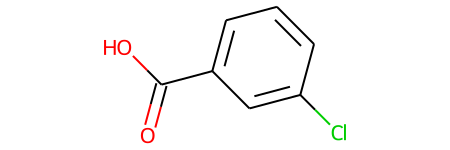

In [82]:
i = 10
output_df['valid compound'][i]

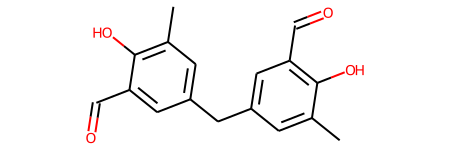

In [83]:
original['valid compound'][i]

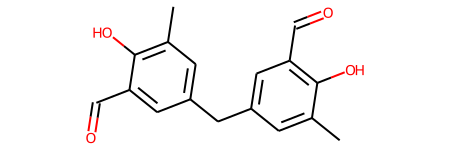

In [84]:
Chem.MolFromSmiles(dataset['PRODUCT'][i])

In [107]:
dataset = pd.concat([dataset, output_df], axis=1)

In [108]:
from rdkit import Chem
from rdkit.Chem import AllChem, Draw, PandasTools
# dataset.to_excel("aryl_halides.xlsx",index=False)
dataset.to_csv('../../generated3.csv', index=False)

[16:37:50] unsupported number of radical electrons 4
[16:37:50] unsupported number of radical electrons 4


In [39]:
PandasTools.WriteSDF(dataset.dropna(axis=0), 'sample.xls', molColName='most_probable')

In [2]:
dataset = pd.read_csv('../../generated3.csv')
dataset

,input,PRODUCT,0,1,2,3,4,most_probable
0,REACTANT:NCCO.O=C1COCC(=O)O1CATALYST: REAGENT:...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC1(C)COCN1CC(C)(C)[N+](=O)[O-],C=CCC1(CC)C(=O)NC(=O)NC1=O,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=S(=O)([O-])[...,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=C([O-])[O-]....,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=C([O-])CC(=O)O,"<img data-content=""rdkit/molecule"" src=""data:i..."
1,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CC(C)(C)OC(=O)NC1(C2CCNC2)CCC1,CC(C)(C)OC(=O)NC1(C2CCNC2)CCC1,CC(C)(C)OC(=O)NC1(C2CC[NH2+]C2)CCC1.[Br-],CC(C)(C)OC(=O)[NH+]([O-])C1(C2CCNC2)CCC1,CC(C)(C)OC(=O)NC1(C2CC[NH2+]C2)CCC1.[Cl-],CC(C)(C)OC(=O)NC1(C2CC[NH2+]C2)CCC1.[I-],"<img data-content=""rdkit/molecule"" src=""data:i..."
2,REACTANT:C1CCNCC1.Cl.NS(=O)(=O)c1cc(C(=O)O)cc(...,CCS(=O)(=O)OCCBr,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=S(=O)([O-])[...,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=C([O-])[O-]....,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=C([O-])[O-]c...,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=S(=O)([O-])[...,CC1(C)COCN1CC(C)(C)[N+](=O)[O-].O=C([O-])[O-]c...,"<img data-content=""rdkit/molecule"" src=""data:i..."
3,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)O)S(=O)(=O)...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)O)S(=O)(=O)...,CCCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)O)S(=O)(=O...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)[O-])S(=O)(...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)O)S(=O)(=O)...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)S(=O)(=O)c1ccc(OC...,"<img data-content=""rdkit/molecule"" src=""data:i..."
4,REACTANT:CCO.Cc1cc(C(=O)NC(CC(=O)O)c2ccc(NC(=O...,CCCCCCCCCCCC(=O)N1CCC[C@H]1C(=O)O,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,NaN
...,...,...,...,...,...,...,...,...
995,REACTANT:CCCNC(=O)c1ccc(Oc2ccc(Cl)cc2N)cc1.Cc1...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-]CS(=O)(=O)[...,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,"<img data-content=""rdkit/molecule"" src=""data:i..."
996,REACTANT:CN(C)C(=O)Cl.Cl.Fc1ccc(C2=CCNCC2)cc1....,CCCCCCCCCCCCNC(=O)N(C)C[C@H](O)[C@@H](O)[C@H](...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,"<img data-content=""rdkit/molecule"" src=""data:i..."
997,REACTANT:COCOc1cc(C(F)(F)F)ccc1-c1cc(Oc2ccc3cc...,C[C@H](CO)CO[Si](c1ccccc1)(c1ccccc1)C(C)(C)C,C[C@H](CO)CO[S](c1ccccc1)(c1ccccc1)C(C)(C)C.O=...,C[C@H](CO)CO[S](c1ccccc1)(c1ccccc1)C(C)(C)C.O=...,C[C@H](CO)CO[S](c1ccccc1)(c1ccccc1)C(C)(C)C.O=...,CNC(=O)c1ncn2c(C)cc(C)[n+](C)c12c1cc(Br)cnc12....,C[C@H](CO)CO[S](c1ccccc1)(c1ccccc1)C(C)(C)C.O=...,"<img data-content=""rdkit/molecule"" src=""data:i..."
998,REACTANT:C1=COCCC1.CC1(C)C2CCC1(CS(=O)(=O)O)C(...,Cn1nnnc1-c1cc(Br)cc([N+](=O)[O-])c1,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)OC....,CC(C)(C)[C@H](N)C(=O)OC.CN(C)CC(=O)O.NCC(=O)O....,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)OC.NCC(=O)O....,CC(C)(C)[C@H](N)C(=O)O.CN(C)CC(=O)O.NCC(=O)O.N...,"<img data-content=""rdkit/molecule"" src=""data:i..."


In [3]:
mols = []
for idx, row in dataset.iterrows():
    if type(row['most_probable']) != str:
        mols.append(None)
    else:
        for i in range(5):
            out = row[str(i)]
            mol = Chem.MolFromSmiles(out)
            if type(mol) == rdkit.Chem.rdchem.Mol:
                mols.append(mol)
                break
dataset['most_probable'] = mols

[19:24:50] SMILES Parse Error: unclosed ring for input: 'CCCCOc1cc(N=C2C=CC(Nc3ccc(N(CC)C(C)C)cc3)C(N)=C2C=C2N=C(N)C=C2[C@@H]2CC[C@@]2(C)[C@H]3CC[C@@H]2[C@H](C)CCCC(C)C)cc1'
[19:24:50] SMILES Parse Error: unclosed ring for input: 'CCCCOc1cc(N=C2C=CC(Nc3ccc(N(CC)C(C)C)cc3)C(N)=C2C=C2N=C(N)C=C2[C@@H]2CC[C@@]2(C)[C@H]3CC[C@@H]2[C@H](C)CCCC(C)C)c1'
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 35 36 37 51 74
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 35 36 37 51
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 35 36 37 51 75
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 18 19 20 33 57
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 18 19 20 33 56
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 18 19 20 33 58
[19:24:50] SMILES Parse Error: unclosed ring for input: 'NN=C(C=Cc1ccccc1)c1ccccc1.Cc1cc(Cc2cc(C)c(O)c(C=O)c2)[nH]c(Cc2[nH]c(C(=O)OCc3ccccc3)c(C)c2CCC(=O)OC)c1ccccc1'
[19:24:50] Can't kekulize mol.  Unkekulized atoms: 43 44 45 58 60
[19:24:50] Explicit valence

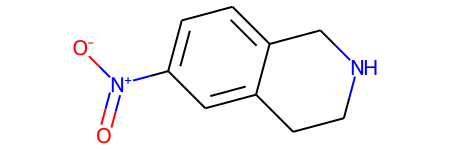

In [49]:
i = 22
dataset['most_probable'][i]

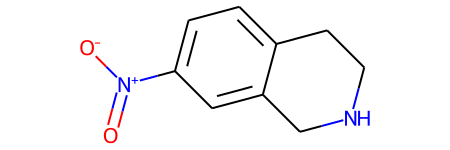

In [50]:
Chem.MolFromSmiles(dataset['PRODUCT'][i])

In [35]:
lens = df['input'].apply(lambda x: len(x))
df = df[lens <= 512]
train, test = train_test_split(df, test_size=int(len(all)*0.1))
train, valid = train_test_split(train, test_size=int(len(all)*0.1))
train.to_csv('multi-input-train.csv', index=False)
valid.to_csv('multi-input-valid.csv', index=False)
test.to_csv('multi-input-test.csv', index=False)

In [10]:
from collections import Counter
counter = Counter()
for l in df['len']:
    counter[l] += 1
counter

Counter({313: 126,
         314: 141,
         339: 36,
         325: 62,
         318: 89,
         298: 268,
         306: 215,
         307: 197,
         312: 97,
         310: 144,
         324: 86,
         315: 93,
         104: 35801,
         111: 33557,
         124: 25655,
         100: 35761,
         107: 35541,
         120: 28068,
         110: 34186,
         117: 31091,
         130: 21377,
         114: 31926,
         121: 27730,
         134: 18516,
         128: 22585,
         141: 14942,
         106: 35725,
         113: 33036,
         126: 24081,
         116: 31744,
         123: 26573,
         136: 17538,
         127: 23670,
         140: 15104,
         147: 11749,
         137: 17120,
         133: 19406,
         143: 13655,
         154: 9148,
         129: 22096,
         149: 11069,
         125: 25371,
         132: 20146,
         145: 12661,
         135: 18132,
         142: 14186,
         155: 8666,
         139: 15577,
         146: 12309,
   

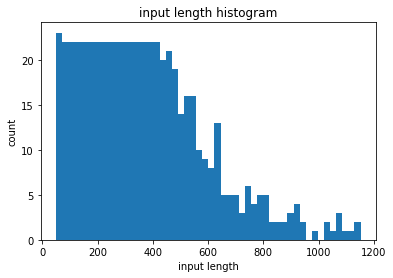

In [22]:
import matplotlib.pyplot as plt
fig = plt.hist(counter, bins=50)
plt.xlabel('input length')
plt.ylabel('count')
plt.title('input length histogram')
plt.savefig('multiinput-length-histogram.png')

,CATALYST,REACTANT,REAGENT,SOLVENT,INTERNAL_STANDARD,NoData,PRODUCT,YIELD,TEMP,input,len
28189,,CC(=O)S[C@@H]1CC2=CC(=O)C=C[C@]2(C)[C@H]2CC[C@...,,,,,CC(C)CN=C1C(c2ccccc2)=C(c2ccccc2)C(c2ccccc2)=C...,,,REACTANT:CC(=O)S[C@@H]1CC2=CC(=O)C=C[C@]2(C)[C...,1076
28194,,CC(C)C(C(=O)OC(C#N)c1cccc(Oc2ccccc2)c1)c1ccc(C...,,,,,CC(C)CN=C1C(c2ccccc2)=C(c2ccccc2)C(c2ccccc2)=C...,,,REACTANT:CC(C)C(C(=O)OC(C#N)c1cccc(Oc2ccccc2)c...,1152
28198,,C=C1/C(=C\C=C2/CCC[C@@]3(C)[C@H]2CC[C@@H]3[C@H...,,,,,CC(C)CN=C1C(c2ccccc2)=C(c2ccccc2)C(c2ccccc2)=C...,,,REACTANT:C=C1/C(=C\C=C2/CCC[C@@]3(C)[C@H]2CC[C...,1093
909023,,CC(C)=CO[Si](C)(C)C.CC1=C(/C=C/C(C)=C/C=C/C(C)...,,,,,CCOC(=O)c1cccc(-c2cn(-c3ccc(F)c(F)c3)nc2C(=O)O...,,,REACTANT:CC(C)=CO[Si](C)(C)C.CC1=C(/C=C/C(C)=C...,1137
1309960,,Cc1c(C)c(S(=O)(=O)NC(=N)NCCC[C@H](NC(=O)OCC2c3...,,,,,O=C(O)c1cccc(Cl)c1,,,REACTANT:Cc1c(C)c(S(=O)(=O)NC(=N)NCCC[C@H](NC(...,1037
1347420,,Cc1c(C)c(S(=O)(=O)NC(=N)NCCC[C@H](NC(=O)OCC2c3...,,,,,O=C(O)c1cccc(Cl)c1,,,REACTANT:Cc1c(C)c(S(=O)(=O)NC(=N)NCCC[C@H](NC(...,1037
1354904,,CC(Nc1nc(NC2(C(F)(F)F)CC2)c2nc(-c3ccc(F)cc3)cc...,,,,,O=C(O)c1cccc(Cl)c1,,,REACTANT:CC(Nc1nc(NC2(C(F)(F)F)CC2)c2nc(-c3ccc...,1084
1376301,,CC(=O)N[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C[C@H](O)C...,,,,,O=C(O)c1cccc(Cl)c1,,,REACTANT:CC(=O)N[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C...,1060
1566825,,CC(=O)S[C@@H]1CC2=CC(=O)C=C[C@]2(C)[C@H]2CC[C@...,,,,,CCCCCCCC/C=C\CCCCCCCC(=O)O,,,REACTANT:CC(=O)S[C@@H]1CC2=CC(=O)C=C[C@]2(C)[C...,1076
1566832,,C=C1/C(=C\C=C2/CCC[C@@]3(C)[C@H]2CC[C@@H]3[C@H...,,,,,CCCCCCCC/C=C\CCCCCCCC(=O)O,,,REACTANT:C=C1/C(=C\C=C2/CCC[C@@]3(C)[C@H]2CC[C...,1093


In [40]:
df = pd.read_csv('../all_ord_reaction_uniq_with_attr_v3.tsv')
df = df[~df['YIELD'].isna()]
for col in ['CATALYST', 'REACTANT', 'REAGENT', 'SOLVENT', 'INTERNAL_STANDARD', 'NoData','PRODUCT', 'YIELD', 'TEMP']:
    df[col] = df[col].fillna(' ')
# df['input'] = 'REACTANT:' + df['REACTANT'] + 'PRODUCT:' + df['PRODUCT'] + 'CATALYST:' + df['CATALYST'] + 'REAGENT:' + df['REAGENT'] + 'SOLVENT:' + df['SOLVENT'] + 'NoData:' + df['NoData']
df['input'] = 'REACTANT:' + df['REACTANT'] + 'PRODUCT:' + df['PRODUCT'] + 'CATALYST:' + df['CATALYST']
from collections import Counter
df['len'] = df['input'].apply(lambda x: len(x))
counter = Counter()
for l in df['len']:
    counter[l] += 1
counter

/tmp/ipykernel_1464/3848426775.py:1: DtypeWarning: Columns (0,1,2,3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../all_ord_reaction_uniq_with_attr_v3.tsv')
/tmp/ipykernel_1464/3848426775.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[col] = df[col].fillna(' ')


Counter({308: 90,
         309: 102,
         334: 30,
         320: 72,
         313: 76,
         293: 181,
         301: 122,
         302: 113,
         307: 119,
         305: 129,
         319: 66,
         310: 94,
         80: 1929,
         76: 1288,
         86: 3181,
         90: 4184,
         97: 5727,
         82: 2173,
         92: 4607,
         96: 5528,
         103: 7127,
         93: 4996,
         89: 3836,
         99: 6397,
         110: 8010,
         105: 7230,
         101: 6796,
         111: 8387,
         115: 8572,
         122: 8372,
         153: 5091,
         155: 4991,
         151: 5373,
         181: 2395,
         162: 4331,
         177: 2633,
         159: 4443,
         175: 2937,
         161: 4146,
         148: 5919,
         158: 4748,
         176: 2586,
         149: 5707,
         173: 3050,
         57: 63,
         45: 1,
         102: 6820,
         95: 5524,
         147: 5775,
         142: 6785,
         83: 2529,
         133: 7596

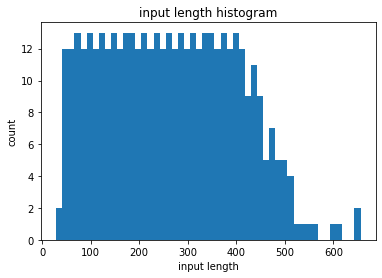

In [43]:
import matplotlib.pyplot as plt
fig = plt.hist(counter, bins=50)
plt.xlabel('input length')
plt.ylabel('count')
plt.title('input length histogram')
plt.savefig('regression-length-histogram.png')

In [42]:
df

,CATALYST,REACTANT,REAGENT,SOLVENT,INTERNAL_STANDARD,NoData,PRODUCT,YIELD,TEMP,input,len
0,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.O=C(O)C1CCCN1C(=O)OCc1ccccc1,O=C([O-])[O-].[Cs+],CN(C)C=O,,,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,93.0,23.0,REACTANT:CC(=O)c1ccc(Br)cc1.O=C(O)C1CCCN1C(=O)...,308
1,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CCCCC1C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,,,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,82.0,23.0,REACTANT:CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CC...,308
2,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CCOCC1C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,,,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,61.0,23.0,REACTANT:CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)N1CC...,308
3,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)C(NC(=O)OC(C)(C)C)C(=O)O,O=C([O-])[O-].[Cs+],CN(C)C=O,,,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,72.0,23.0,REACTANT:CC(=O)c1ccc(Br)cc1.CC(C)C(NC(=O)OC(C)...,309
4,CC(C)(C)c1ccn2->[Ir+]34(<-n5cc(C(F)(F)F)ccc5-c...,CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)NC(Cc1cn(C(=O...,O=C([O-])[O-].[Cs+],CN(C)C=O,,,CC(=O)c1ccc(C2CCCN2C(=O)OCc2ccccc2)cc1,83.0,23.0,REACTANT:CC(=O)c1ccc(Br)cc1.CC(C)(C)OC(=O)NC(C...,334
...,...,...,...,...,...,...,...,...,...,...,...
2268493,,CCOC(=O)CCBr.Cl.Fc1ccc2c(C3CCNCC3)nsc2c1.O=C([...,,CC#N.CCOC(C)=O.CCOCC.O,,,CC(O)CC(=O)[O-].O=C([O-])CCCO,64.0,,REACTANT:CCOC(=O)CCBr.Cl.Fc1ccc2c(C3CCNCC3)nsc...,115
2268494,,C1CCOC1.CCOC(=O)CCN1CCC(c2noc3cc(F)ccc23)CC1.C...,,,,,CC(O)CC(=O)[O-].O=C([O-])CCCO,61.0,,REACTANT:C1CCOC1.CCOC(=O)CCN1CCC(c2noc3cc(F)cc...,109
2268495,,CCCCCCCCCC(=O)Cl.CCN(CC)CC.O=C1c2ccccc2C(O)N1C...,,ClCCl,,,CC(O)CC(=O)[O-].O=C([O-])CCCO,83.0,,REACTANT:CCCCCCCCCC(=O)Cl.CCN(CC)CC.O=C1c2cccc...,129
2268496,,CCC(O)(CC)CCN1CCC(c2noc3cc(F)ccc23)CC1.CCCCCCC...,,ClCCl,,,CC(O)CC(=O)[O-].O=C([O-])CCCO,81.0,,REACTANT:CCC(O)(CC)CCN1CCC(c2noc3cc(F)ccc23)CC...,128


In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"
import gc
import random
import itertools
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import torch
import tokenizers
import transformers
from transformers import AutoTokenizer, EncoderDecoderModel, DataCollatorForSeq2Seq, AutoModelForSeq2SeqLM, Seq2SeqTrainingArguments, Seq2SeqTrainer
import datasets
from datasets import load_dataset, load_metric
import sentencepiece
import argparse
from datasets.utils.logging import disable_progress_bar
from rdkit import Chem
import rdkit
disable_progress_bar()

def parse_args():
    parser = argparse.ArgumentParser()
    parser.add_argument("--input_data", type=str, required=False)
#     parser.add_argument("--dataset_name", type=str, required=False)
    parser.add_argument("--model_name_or_path", type=str, required=True)
    parser.add_argument("--model", type=str, required=True)
    parser.add_argument("--debug", action='store_true', default=False, required=False)
    parser.add_argument("--num_beams", type=int, default=5, required=False)
    parser.add_argument("--num_return_sequences", type=int, default=5, required=False)
    parser.add_argument("--seed", type=int, default=42, required=False)

    return parser.parse_args()
    
# CFG = parse_args()

class CFG:
    model = 't5'
    dataset_path = '../../multi-input-valid.csv'
    model_name_or_path = '/data2/sagawa/tcrp-multiinput-archive/10-epoch-archive2/t5/checkpoint-2721180'
    num_beams = 5
    num_return_sequences = 5
    debug = True
    seed = 42
    

# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device = 'cpu'

def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
seed_everything(seed=CFG.seed)  
    

    
dataset = pd.read_csv(CFG.dataset_path)



tokenizer = AutoTokenizer.from_pretrained(CFG.model_name_or_path, return_tensors='pt')
from transformers import AutoTokenizer, AutoConfig, AutoModel, T5EncoderModel
model = T5EncoderModel.from_pretrained(CFG.model_name_or_path)

Some weights of the model checkpoint at /data2/sagawa/tcrp-multiinput-archive/10-epoch-archive2/t5/checkpoint-2721180 were not used when initializing T5EncoderModel: ['decoder.block.7.layer.0.SelfAttention.k.weight', 'decoder.block.11.layer.1.layer_norm.weight', 'decoder.block.7.layer.1.EncDecAttention.k.weight', 'decoder.block.7.layer.0.SelfAttention.q.weight', 'decoder.block.1.layer.0.SelfAttention.k.weight', 'decoder.block.6.layer.0.SelfAttention.k.weight', 'decoder.block.1.layer.2.DenseReluDense.wo.weight', 'decoder.block.2.layer.2.DenseReluDense.wi_0.weight', 'decoder.block.11.layer.1.EncDecAttention.o.weight', 'decoder.block.5.layer.1.layer_norm.weight', 'decoder.block.4.layer.2.DenseReluDense.wi_0.weight', 'decoder.block.9.layer.2.DenseReluDense.wi_1.weight', 'decoder.block.10.layer.1.layer_norm.weight', 'decoder.block.4.layer.2.DenseReluDense.wo.weight', 'decoder.block.5.layer.2.DenseReluDense.wi_0.weight', 'decoder.block.6.layer.1.EncDecAttention.v.weight', 'decoder.block.7.la

In [14]:
# outputs = []
# for input_data in dataset['input'][:5000]:
#     inp = tokenizer(input_data, return_tensors='pt', max_length=512, padding='max_length', truncation=True).to(device)
#     output = model(**inp)
# #     output[0][0].shape => torch.Size([512, 768])
#     outputs.append(output[0][0].detach().numpy())

outputs = []
for input_data in dataset['input'][:5000]:
    inp = tokenizer(input_data, return_tensors='pt', max_length=512, padding='max_length', truncation=True).to(device)
    output = model(**inp)
#     output[0][0].shape => torch.Size([512, 768])
    outputs.append(output[0][:, 0, :].detach().numpy())

In [18]:
type(outputs[0].shape)

tuple

In [19]:
np.save('embedding_5000.npy', outputs)

In [21]:
outputs = np.load('embedding_5000.npy')
outputs = outputs[:, 0, :]
outputs.shape

(5000, 768)

In [4]:
dist_matrix = np.zeros([len(outputs),len(outputs)])

for i in range(len(outputs)):
    for j in range(len(outputs)):
        dist = np.linalg.norm(outputs[i] - outputs[j])
        dist_matrix[i][j] = dist

In [11]:
# np.save('distance_5000.npy', dist_matrix)
dist_matrix = np.load('distance_5000.npy')

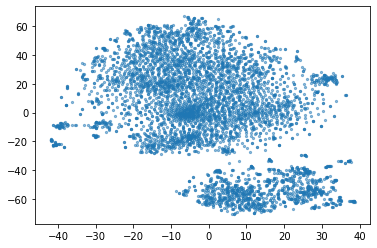

In [30]:
# from sklearn.manifold import TSNE, MDS
# tsne = TSNE(n_components=2, random_state=42, metric='precomputed')
# tsne_out = tsne.fit_transform(dist_matrix)
import matplotlib.pyplot as plt
plt.scatter(tsne_out[:, 0], tsne_out[:, 1], alpha=0.5, s=5)

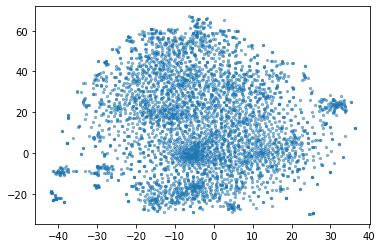

In [31]:
plt.scatter(tsne_out[tsne_out[:, 1]>-30][:, 0], tsne_out[tsne_out[:, 1]>-30][:, 1], alpha=0.5, s=5)

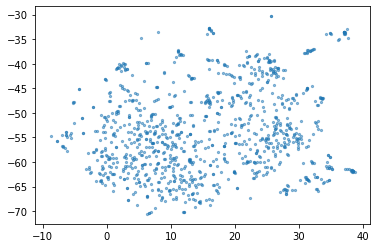

In [32]:
plt.scatter(tsne_out[tsne_out[:, 1]<-30][:, 0], tsne_out[tsne_out[:, 1]<-30][:, 1], alpha=0.5, s=5)

In [35]:
upper = dataset[:5000][out[:, 1]>-30]
upper

ValueError: Item wrong length 3937 instead of 5000.

In [25]:
lower = dataset[:5000][out[:, 1]<-30]
lower

,input,PRODUCT
1,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CC(C)(C)OC(=O)NC1(C2CCNC2)CCC1
3,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CCCC(Cc1ccc(OCCN2CCCCCC2)cc1)(C(=O)O)S(=O)(=O)...
6,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,COCCOCc1ccc(O)cc1
11,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,Cc1ccsc1C(=O)NCCCSc1ccncc1
14,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CC(=O)OCc1c(-c2cc([Si](C)(C)C)c(=O)n(C)n2)cccc...
...,...,...
4983,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:O...,O=C(Cl)c1ccc(OCc2ccccc2)cc1
4985,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CNCCC#Cc1cccnc1
4992,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,COc1ccc(-n2nc(C(=O)O)cc2-c2ccc(SC)cc2)cc1
4993,REACTANT: CATALYST: REAGENT: SOLVENT: NoData:C...,CC1(C)C(C(=O)c2cn(CCCCN)c3ccccc23)C1(C)C


In [45]:
tf = [True if i.startswith('REACTANT: CATALYST: REAGENT: SOLVENT: NoData:') else False for i in lower['input']]
print(sum(tf)/len(tf))

0.9990592662276576


In [49]:
tf = [True if i.startswith('REACTANT: CATALYST: REAGENT: SOLVENT: NoData:') else False for i in upper['input']]
print(sum(tf)/len(tf))

0.002032004064008128


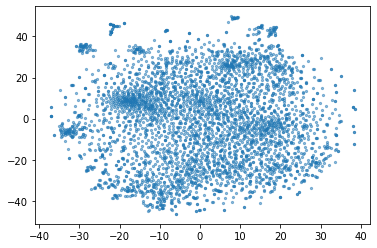

In [34]:
from umap import UMAP
# Apply the singular value decomposition
tsne = TSNE(n_components=2, random_state=42, metric='precomputed') # 512
out_up = tsne.fit_transform(dist_matrix[tsne_out[:, 1]>-30, :][:, tsne_out[:, 1]>-30])
import matplotlib.pyplot as plt
plt.scatter(out_up[:, 0], out_up[:, 1], alpha=0.5, s=5)

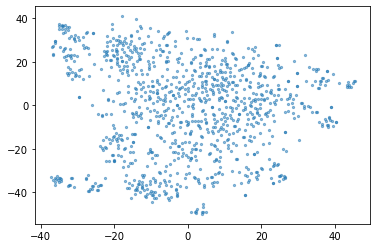

In [33]:
from umap import UMAP
# Apply the singular value decomposition
tsne = TSNE(n_components=2, random_state=42, metric='precomputed') # 512
out_down = tsne.fit_transform(dist_matrix[tsne_out[:, 1]<-30, :][:, tsne_out[:, 1]<-30])
import matplotlib.pyplot as plt
plt.scatter(out_down[:, 0], out_down[:, 1], alpha=0.5, s=5)

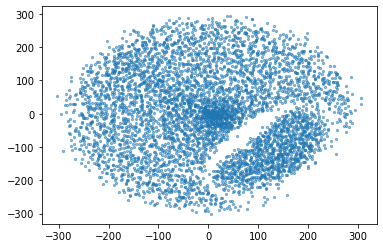

In [36]:
mds = MDS(n_components=2, random_state=42, dissimilarity='precomputed')
out_mds = mds.fit_transform(dist_matrix)
plt.scatter(out_mds[:, 0], out_mds[:, 1], alpha=0.5, s=5)

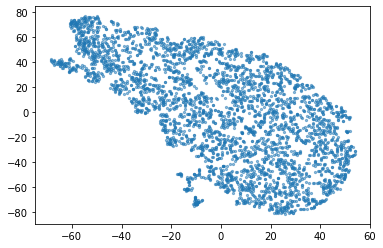

In [38]:
# tsne = TSNE(n_components=2, random_state=42)
# out_tsne2 = tsne.fit_transform(dist_matrix[tsne_out[:, 1]>-30, :][:, tsne_out[:, 1]>-30])
plt.scatter(out_tsne2[:, 0], out_tsne2[:, 1], alpha=0.5, s=5)

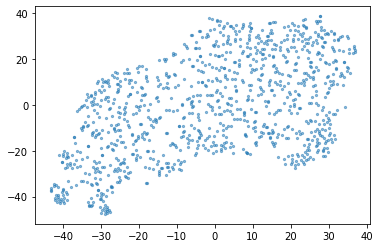

In [39]:
tsne = TSNE(n_components=2, random_state=42)
out_tsne2 = tsne.fit_transform(dist_matrix[tsne_out[:, 1]<-30, :][:, tsne_out[:, 1]<-30])
plt.scatter(out_tsne2[:, 0], out_tsne2[:, 1], alpha=0.5, s=5)

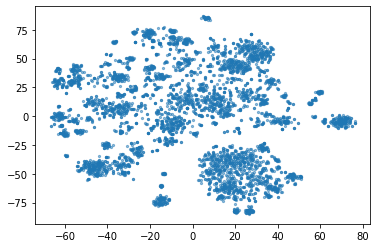

In [29]:
# cls
from sklearn.manifold import TSNE, MDS
tsne = TSNE(n_components=2, random_state=42)
tsne_out = tsne.fit_transform(outputs)
import matplotlib.pyplot as plt
plt.scatter(tsne_out[:, 0], tsne_out[:, 1], alpha=0.5, s=5)

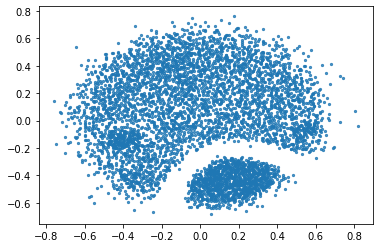

In [26]:
# cls
from sklearn.manifold import TSNE, MDS
tsne = MDS(n_components=2, random_state=42)
mds_out = tsne.fit_transform(outputs)
import matplotlib.pyplot as plt
plt.scatter(mds_out[:, 0], mds_out[:, 1], alpha=0.8, s=5)

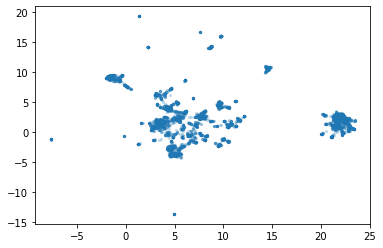

In [31]:
# cls
from umap import UMAP
umap = UMAP(n_components=2, random_state=42)
umap_out = umap.fit_transform(outputs)
plt.scatter(umap_out[:, 0], umap_out[:, 1], alpha=0.2, s=5)

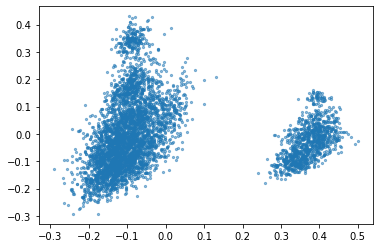

In [32]:
# cls
from sklearn.decomposition import PCA, TruncatedSVD
umap = PCA(n_components=2, random_state=42)
pca_out = umap.fit_transform(outputs)
plt.scatter(pca_out[:, 0], pca_out[:, 1], alpha=0.5, s=5)

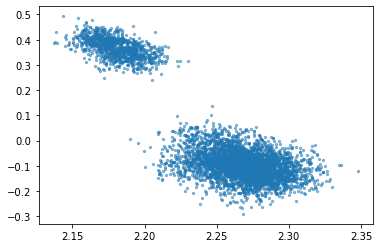

In [33]:
# cls
from sklearn.decomposition import PCA, TruncatedSVD
umap = TruncatedSVD(n_components=2, random_state=42)
svd_out = umap.fit_transform(outputs)
plt.scatter(svd_out[:, 0], svd_out[:, 1], alpha=0.5, s=5)

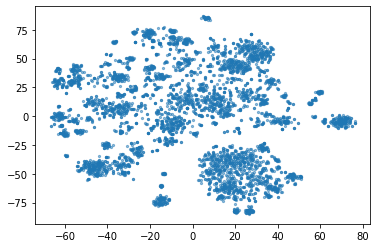

In [34]:
# # cls
# from sklearn.manifold import TSNE, MDS
# tsne = TSNE(n_components=2, random_state=42)
# tsne_out = tsne.fit_transform(outputs)
# import matplotlib.pyplot as plt
plt.scatter(tsne_out[:, 0], tsne_out[:, 1], alpha=0.5, s=5)

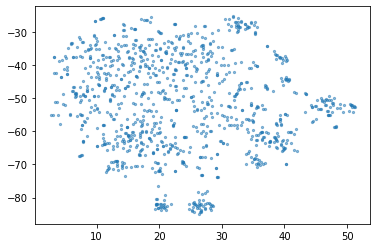

In [37]:
plt.scatter(tsne_out[(tsne_out[:, 0] > 0) & (tsne_out[:, 1] < -25)][:, 0], tsne_out[(tsne_out[:, 0] > 0) & (tsne_out[:, 1] < -25)][:, 1], alpha=0.5, s=5)

In [40]:
sum((tsne_out[:, 0] > 0) & (tsne_out[:, 1] < -25))

1062

In [41]:
sum((tsne_out[:, 0] <= 0) | (tsne_out[:, 1] >= -25))

3938

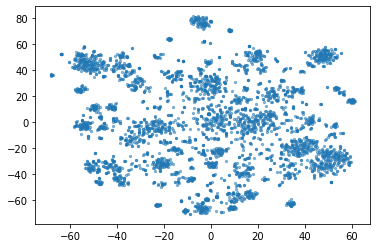

In [42]:
# cls
from sklearn.manifold import TSNE, MDS
tsne = TSNE(n_components=2, random_state=42)
tsne_out = tsne.fit_transform(outputs[(tsne_out[:, 0] <= 0) | (tsne_out[:, 1] >= -25)])
import matplotlib.pyplot as plt
plt.scatter(tsne_out[:, 0], tsne_out[:, 1], alpha=0.5, s=5)

In [57]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=42).fit(tsne_out)
labels = kmeans.labels_

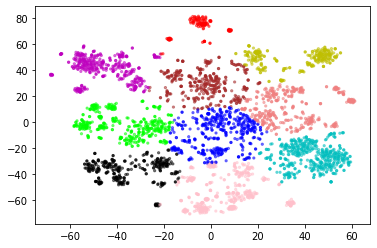

In [62]:
cd = {0:'r', 1:'b', 2:'m', 3:'y', 4:'c', 5:'k', 6:'brown', 7:'pink', 8:'lime', 9:'lightcoral'}
color = [cd[l] for l in labels]
plt.scatter(tsne_out[:, 0], tsne_out[:, 1], alpha=0.5, s=5, color=color)

In [27]:
df = pd.read_csv('yield_prediction_output.csv')
df = df[df['YIELD'] <= 100]

In [4]:
from sklearn.metrics import mean_squared_error, r2_score
print(mean_squared_error(df['YIELD'], df['prediction'], squared=False), r2_score(df['YIELD'], df['prediction']))

25.519197441039037 0.19086268719109778


In [12]:
print(mean_squared_error(df['YIELD'], df['prediction'].clip(0), squared=False), r2_score(df['YIELD'], df['prediction'].clip(0)))

25.512149509076302 0.1913095630966486


In [16]:
print(mean_squared_error(df['YIELD'], df['prediction'].clip(0, 100), squared=False), r2_score(df['YIELD'], df['prediction'].clip(0, 100)))

25.507387811072732 0.1916114098915006


In [17]:
print(mean_squared_error(df['YIELD'].clip(0, 100), df['prediction'].clip(0, 100), squared=False), r2_score(df['YIELD'].clip(0, 100), df['prediction'].clip(0, 100)))

23.01815853078627 0.22476314184270274


In [25]:
df['prediction'].min(), df['prediction'].max()

(-20.780594, 113.22212)

In [26]:
df['YIELD'].min(), df['YIELD'].clip(0).max()

(0.0, 99.0)

,CATALYST,REACTANT,REAGENT,SOLVENT,INTERNAL_STANDARD,NoData,PRODUCT,YIELD,TEMP,input,prediction
555,,C#Cc1cccc(C2(NCC(O)C(Cc3cc(F)cc(F)c3)NC(=O)OC(...,,,,,O=S(=O)([O-])[O-].O=S(=O)([O-])[O-].O=S(=O)([O...,106.0,,REACTANT:C#Cc1cccc(C2(NCC(O)C(Cc3cc(F)cc(F)c3)...,64.638600
673,,C1CCNCC1.CCOC(OCC)[C@H](C)N(Cc1csc2ccc(Cl)nc12...,,,,,c1ccc2sc(-c3nccc4ccccc34)cc2c1,119.0,,REACTANT:C1CCNCC1.CCOC(OCC)[C@H](C)N(Cc1csc2cc...,73.549220
967,,COC(=O)C(CNCC(F)(F)F)c1ccc(Cl)cc1.C[Si](C)(C)O[K],,C1CCOC1.CCOCC,,,c1ccc2sc(-c3nccc4ccccc34)cc2c1,118.0,,REACTANT:COC(=O)C(CNCC(F)(F)F)c1ccc(Cl)cc1.C[S...,86.737630
1143,,CC(=O)N1CCOCC1.CC(C)[N-]C(C)C.COC(=O)c1scc(Br)...,,C1CCOC1,,,O=C(O)c1cccc(Cl)c1,138.0,0.0,REACTANT:CC(=O)N1CCOCC1.CC(C)[N-]C(C)C.COC(=O)...,65.063070
1261,,CCCCOCc1ccc(C#N)cc1.N.[Al+3].[H-].[Li+],,C1CCOC1,,,Cc1cc(Cc2cc(C)c(O)c(C=O)c2)cc(C=O)c1O,101.0,,REACTANT:CCCCOCc1ccc(C#N)cc1.N.[Al+3].[H-].[Li...,78.941440
...,...,...,...,...,...,...,...,...,...,...,...
67635,,Nc1ccncc1.O=C(Cl)Oc1ccccc1,,,,,c1ccc2sc(-c3nccc4ccccc34)cc2c1,534.0,,REACTANT:Nc1ccncc1.O=C(Cl)Oc1ccccc1PRODUCT:c1c...,60.926212
67803,,O=C(OO)c1cccc(Cl)c1.c1cnc2[nH]ccc2c1,,CCOCC,,,O=C(O)c1cccc(Cl)c1,125.0,,REACTANT:O=C(OO)c1cccc(Cl)c1.c1cnc2[nH]ccc2c1P...,70.931320
67884,,O=[N+]([O-])c1cc(F)c(F)c(F)c1.Oc1ccc(F)cc1,,CN(C)C=O,,,CNC(=O)c1ncn2c(C)cc(C)[n+](C)c12.[Cl-],105.0,,REACTANT:O=[N+]([O-])c1cc(F)c(F)c(F)c1.Oc1ccc(...,78.260000
67995,,CC(C)(C)OC(=O)NNC1CCCN(Cc2ccccc2)C1.Cl,,,,,O=C(O)c1cccc(Cl)c1,112.0,,REACTANT:CC(C)(C)OC(=O)NNC1CCCN(Cc2ccccc2)C1.C...,87.196810


In [28]:
from sklearn.metrics import mean_squared_error, r2_score
print(mean_squared_error(df['YIELD'], df['prediction'], squared=False), r2_score(df['YIELD'], df['prediction']))

22.99412361655959 0.2244167382320139


In [29]:
print(mean_squared_error(df['YIELD'], df['prediction'].clip(0), squared=False), r2_score(df['YIELD'], df['prediction'].clip(0)))

22.98627915689757 0.2249458293969845


In [30]:
print(mean_squared_error(df['YIELD'], df['prediction'].clip(0, 100), squared=False), r2_score(df['YIELD'], df['prediction'].clip(0, 100)))

22.98099079506296 0.22530241563472198
